In [1]:
%load_ext autoreload
%autoreload 2

In [1]:
import numpy as np
import pandas as pd
import torch
import glob
import pickle
import matplotlib.pyplot as plt
#from keras.models import load_model
""" from interpretation.interpret import compute_tn5_bias

from interpretation.interpret import compute_importance_score_c_type, compute_importance_score_bias, visualize_sequence_imp
from models.models import CATAC_wo_bias, CATAC_w_bias, CATAC_w_bias_increase_filter
from data_processing.utils_data_preprocessing import one_hot_encode """

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

# Load model

In [3]:

path_model = '../results/train_res/128_10_model.pkl'
all_c_type = ['Immature', 'Mesenchymal', 'Myoblast', 'Myogenic', 'Neuroblast',
       'Neuronal', 'Somite']

#Load the model
first_kernel = 21
nb_conv = 10
size_final_conv = 4096 - (first_kernel - 1)
cropped = [2**l for l in range(0,nb_conv-1)] * (2*(3-1))

for c in cropped:
       size_final_conv -= c

model = CATAC_w_bias(nb_conv=nb_conv, nb_filters=128, first_kernel=first_kernel, 
                      rest_kernel=3, out_pred_len=1024, 
                      nb_pred=4, size_final_conv = size_final_conv)
model.load_state_dict(torch.load(path_model, map_location=torch.device('cpu')))

path_model_bias = "../data/Tn5_NN_model.h5"
model_bias = load_model(path_model_bias)    


# Look at weight of convolutions (cell type specificity)

In [105]:
import pandas as pd
weights_c_type = pd.DataFrame({"PKNOX1":[0.6602, 0.6652, 0.6586, 0.6699, 0.6650, 0.6830, 0.6668],
                                "MEIS": [1.0438, 0.3594, 0.4119, 0.3834, 0.8995, 0.6571, 0.4098],
                                "RFX": [0.5810, 0.4204, 0.4802, 0.4619, 0.6449, 0.7342, 0.4963],
                                "SP/KLF": [0.5864, 0.6471, 0.5799, 0.6732, 0.6196, 0.6590, 0.6168],
                                "TEAD": [-2.0795,  0.6422,  0.6214,  0.6611,  0.1821,  0.6131,  0.6301],
                                "MYOD1": [-1.6327, -1.8696,  0.6313,  0.3021, -1.8061, -1.6700, -1.6204],
                                "JUNB": [-0.0201,  0.5939,  0.3706,  0.5476, -0.0394,  0.4575,  0.6130],
                                "E-box": [0.7612, 0.8200, 0.7737, 0.8326, 0.7953, 0.7626, 0.8133] }, index=all_c_type)
weights_c_type

,PKNOX1,MEIS,RFX,SP/KLF,TEAD,MYOD1,JUNB,E-box
Immature,0.6602,1.0438,0.5810,0.5864,-2.0795,-1.6327,-0.0201,0.7612
Mesenchymal,0.6652,0.3594,0.4204,0.6471,0.6422,-1.8696,0.5939,0.8200
Myoblast,0.6586,0.4119,0.4802,0.5799,0.6214,0.6313,0.3706,0.7737
Myogenic,0.6699,0.3834,0.4619,0.6732,0.6611,0.3021,0.5476,0.8326
Neuroblast,0.6650,0.8995,0.6449,0.6196,0.1821,-1.8061,-0.0394,0.7953
Neuronal,0.6830,0.6571,0.7342,0.6590,0.6131,-1.6700,0.4575,0.7626
Somite,0.6668,0.4098,0.4963,0.6168,0.6301,-1.6204,0.6130,0.8133


In [113]:
weights_c_type = pd.DataFrame({ "E-box": [0.7612, 0.8200, 0.7737, 0.8326, 0.7953, 0.7626, 0.8133],
                                "MYOD1": [-1.6327, -1.8696,  0.6313,  0.3021, -1.8061, -1.6700, -1.6204],
                                "SP/KLF": [0.5864, 0.6471, 0.5799, 0.6732, 0.6196, 0.6590, 0.6168],
                                "TEAD": [-2.0795,  0.6422,  0.6214,  0.6611,  0.1821,  0.6131,  0.6301],
                                "JUNB": [-0.0201,  0.5939,  0.3706,  0.5476, -0.0394,  0.4575,  0.6130],
                                 }, index=all_c_type)

order_c_type = ['Somite', 'Mesenchymal', 'Myogenic', 'Myoblast', 'Neuronal', 'Neuroblast','Immature']
weights_c_type = weights_c_type.loc[order_c_type]

<Axes: >

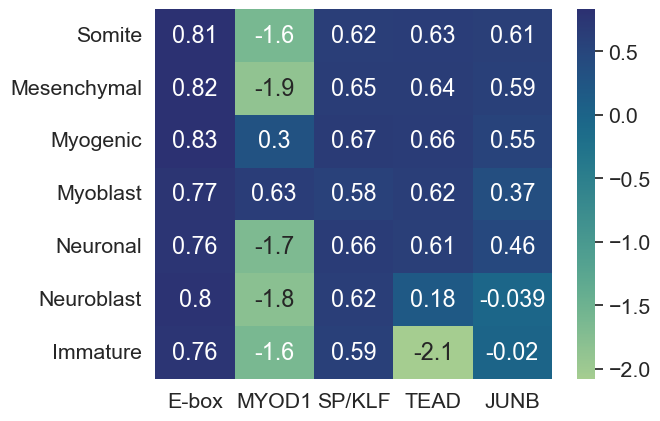

In [115]:
import seaborn as sns

sns.set_theme(font_scale=1.4)
sns.heatmap(weights_c_type, annot=True, cmap="crest")

In [94]:
model.convlayers[0][0].weight.data[108,4:,:].sum(dim=1) + model.convlayers[0][0].weight.data[3,4:,:].sum(dim=1) 

tensor([0.7612, 0.8200, 0.7737, 0.8326, 0.7953, 0.7626, 0.8133])

# Inspect predictions

In [61]:
with open('../results/predictions/test_pred.pkl', 'rb') as file:
    test_pred = pickle.load(file)

with open('../results/predictions/test_target.pkl', 'rb') as file:
    test_target = pickle.load(file)

test_target.shape, test_pred.shape

(torch.Size([248346, 1024, 4]), torch.Size([248346, 4, 1024]))

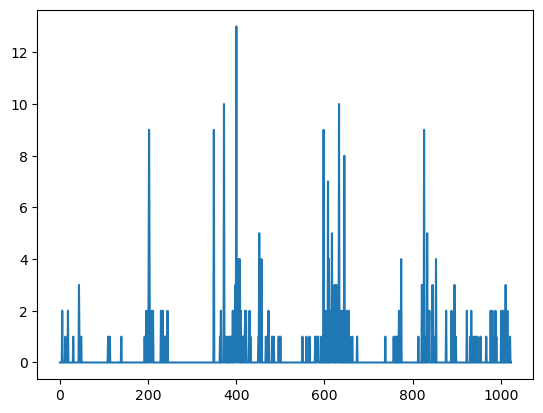

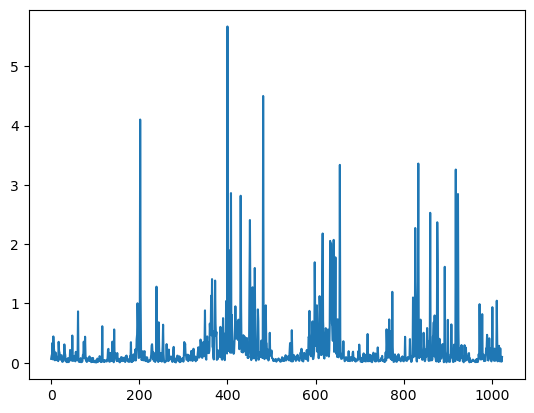

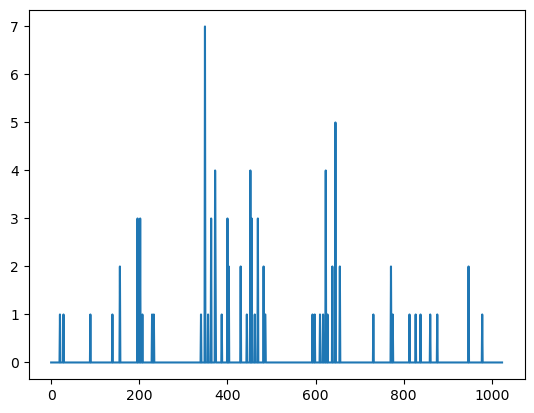

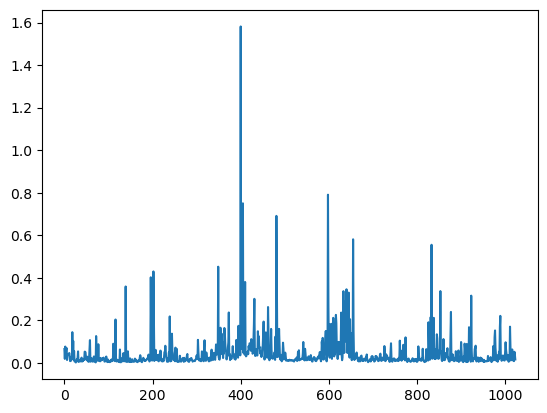

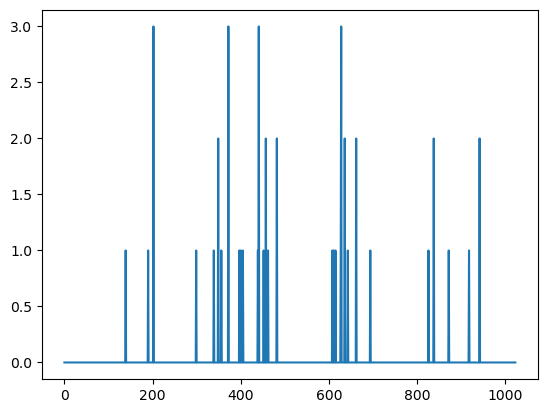

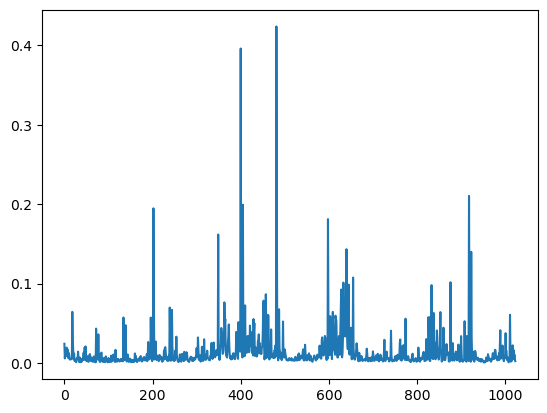

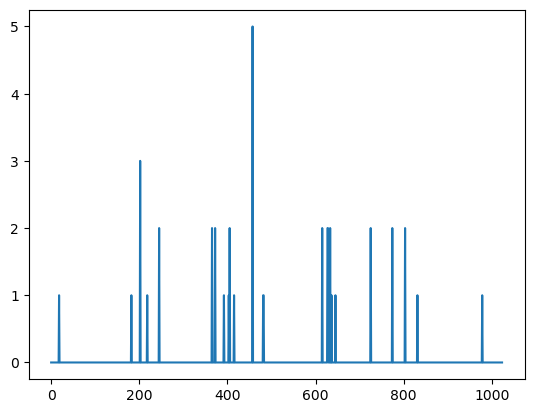

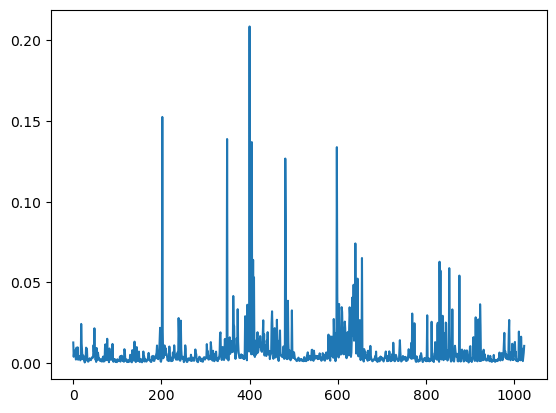

In [65]:
for i in range(0,4):

    plt.plot(np.arange(0,1024),test_target[10,:,i])
    plt.show()
    plt.plot(np.arange(0,1024), test_pred[10,i,:])
    plt.show()

# How similar are predictions between time point and cell type?

In [58]:
all_c_type = ['Immature', 'Mesenchymal', 'Myoblast', 'Myogenic', 'Neuroblast',
       'Neuronal', 'Somite']

In [62]:
with open('../results/predictions/profile_pred.pkl', 'rb') as file:
    profile_pred = pickle.load(file)

with open('../results/predictions/count_pred.pkl', 'rb') as file:
    count_pred = pickle.load(file)

profile_pred[0].shape, count_pred[0].shape

(torch.Size([13064, 1024, 4]), torch.Size([13064, 4]))

In [97]:
import scipy
corr_time = []
for i in range(4):
    corr = []
    for j in range(4):
        corr.append(scipy.stats.spearmanr(count_pred[3][:,i].numpy(), count_pred[3][:,j].numpy()).statistic)
    corr_time.append(corr)

corr_time = pd.DataFrame(corr_time, index=["D8","D12","D20","D22"], columns=["D8","D12","D20","D22"])
corr_time

,D8,D12,D20,D22
D8,1.000000,0.983236,0.960128,0.971158
D12,0.983236,1.000000,0.987701,0.989834
D20,0.960128,0.987701,1.000000,0.992093
D22,0.971158,0.989834,0.992093,1.000000


In [79]:
corr_c_type = []
for i in range(len(all_c_type)):
    corr = []
    for j in range(len(all_c_type)):
        corr.append(scipy.stats.spearmanr(count_pred[i][:,2].numpy(), count_pred[j][:,2].numpy()).statistic)
    corr_c_type.append(corr)

corr_c_type = pd.DataFrame(corr_c_type, index=all_c_type
                           , columns=all_c_type)
corr_c_type

,Immature,Mesenchymal,Myoblast,Myogenic,Neuroblast,Neuronal,Somite
Immature,1.000000,0.809578,0.859687,0.844379,0.971748,0.863556,0.797860
Mesenchymal,0.809578,1.000000,0.909191,0.971089,0.822245,0.975331,0.989319
Myoblast,0.859687,0.909191,1.000000,0.963637,0.869953,0.916064,0.904649
Myogenic,0.844379,0.971089,0.963637,1.000000,0.857300,0.964692,0.966093
Neuroblast,0.971748,0.822245,0.869953,0.857300,1.000000,0.873136,0.809491
Neuronal,0.863556,0.975331,0.916064,0.964692,0.873136,1.000000,0.969585
Somite,0.797860,0.989319,0.904649,0.966093,0.809491,0.969585,1.000000


## Compare to correlation in ATAC tracks

In [84]:
with open('../results/predictions/ATAC_signal.pkl', 'rb') as file:
    ATAC_signal = pickle.load(file)

for i in range(len(ATAC_signal)):
    ATAC_signal[i] = ATAC_signal[i].sum(dim=0)

ATAC_signal[0].shape

torch.Size([1024, 4])

In [96]:
corr_time = []
for i in range(4):
    corr = []
    for j in range(4):
        corr.append(scipy.stats.spearmanr(ATAC_signal[3][:,i].numpy(), ATAC_signal[3][:,j].numpy(), nan_policy='omit').statistic)
    corr_time.append(corr)

corr_time = pd.DataFrame(corr_time, index=["D8","D12","D20","D22"], columns=["D8","D12","D20","D22"])
corr_time

,D8,D12,D20,D22
D8,1.000000,0.981907,0.982323,0.982522
D12,0.981907,1.000000,0.995160,0.995117
D20,0.982323,0.995160,1.000000,0.995508
D22,0.982522,0.995117,0.995508,1.000000


In [98]:
corr_c_type = []
for i in range(len(all_c_type)):
    corr = []
    for j in range(len(all_c_type)):
        corr.append(scipy.stats.spearmanr(ATAC_signal[i][:,2].numpy(), ATAC_signal[j][:,2].numpy()).statistic)
    corr_c_type.append(corr)

corr_c_type = pd.DataFrame(corr_c_type, index=all_c_type
                           , columns=all_c_type)
corr_c_type

,Immature,Mesenchymal,Myoblast,Myogenic,Neuroblast,Neuronal,Somite
Immature,1.000000,0.995064,0.992317,0.994536,0.992924,0.995775,0.991903
Mesenchymal,0.995064,1.000000,0.994240,0.996481,0.993308,0.997500,0.994369
Myoblast,0.992317,0.994240,1.000000,0.993645,0.991155,0.994454,0.991107
Myogenic,0.994536,0.996481,0.993645,1.000000,0.992516,0.996218,0.993341
Neuroblast,0.992924,0.993308,0.991155,0.992516,1.000000,0.994168,0.990921
Neuronal,0.995775,0.997500,0.994454,0.996218,0.994168,1.000000,0.993863
Somite,0.991903,0.994369,0.991107,0.993341,0.990921,0.993863,1.000000


## Correlation in regulatory regions

In [ ]:
corr_time = []
for i in range(4):
    corr = []
    for j in range(4):
        corr.append(scipy.stats.spearmanr(ATAC_signal[3][:,i].numpy(), ATAC_signal[3][:,j].numpy(), nan_policy='omit').statistic)
    corr_time.append(corr)

corr_time = pd.DataFrame(corr_time, index=["D8","D12","D20","D22"], columns=["D8","D12","D20","D22"])
corr_time

# Inspect pred for peaks in active enhancer regions 

As defined by histone marks data (H3K4ME1 and H3K27AC)

### Load the predictions + ground truth

In [ ]:
import pickle
import torch
import matplotlib.pyplot as plt
import numpy as np
from scipy.spatial import distance

with open("../results/pred_profile_active_enhancer.pkl", 'rb') as file:
    profile = pickle.load(file)
with open("../results/pred_count_active_enhancer.pkl", 'rb') as file:
    count = pickle.load(file)

with open("../results/alt_pred_profile_active_enhancer.pkl", 'rb') as file:
    alt_profile = pickle.load(file)
with open("../results/alt_pred_count_active_enhancer.pkl", 'rb') as file:
    alt_count = pickle.load(file)    

profile = torch.nn.functional.softmax(profile, dim=1).detach().numpy()
alt_profile = torch.nn.functional.softmax(alt_profile, dim=1).detach().numpy()

""" count = torch.exp(count)-1
alt_count = torch.exp(alt_count)-1 """

In [ ]:
with open("../results/target_active_enhancer.pkl", 'rb') as file:
    target = pickle.load(file)    

### Compare the observed versus prediction of reference

--------------------
76   2   0.3831477636337188   -0.29325979000443336
Target
7.555381944240273


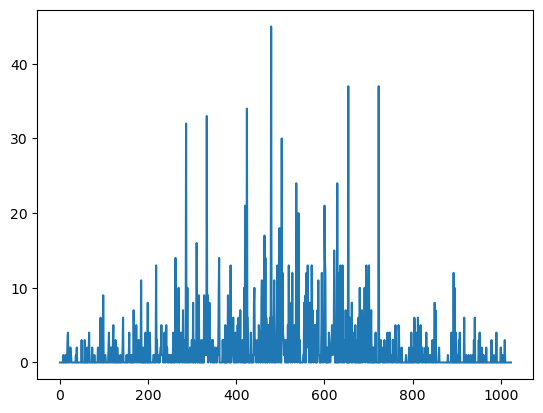

Prediction
tensor(7.2621, grad_fn=<SelectBackward0>)


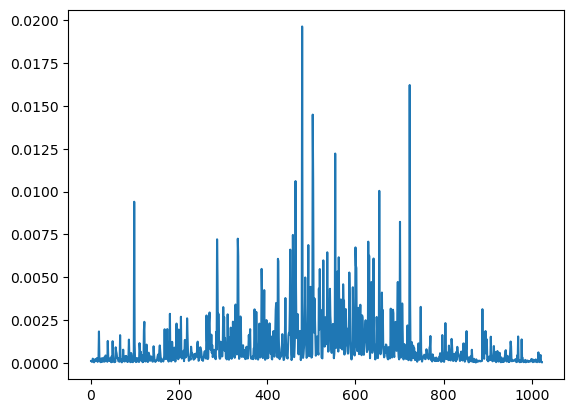

--------------------
76   3   0.3706699247950088   -0.4173615422457022
Target
7.880804344674901


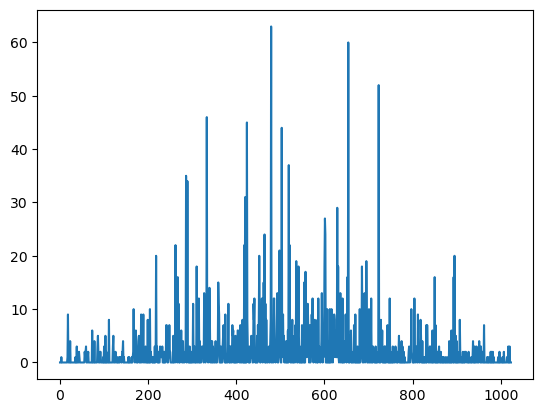

Prediction
tensor(7.4634, grad_fn=<SelectBackward0>)


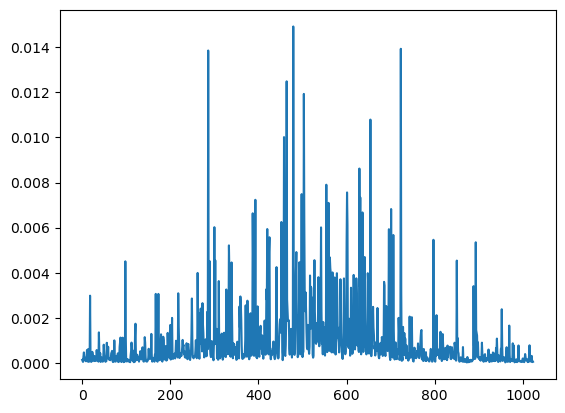

--------------------
115   1   0.3912639268300563   -0.30251442371733805
Target
7.4645098346365275


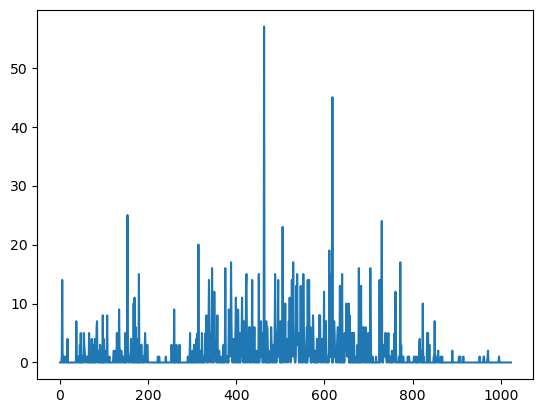

Prediction
tensor(7.1620, grad_fn=<SelectBackward0>)


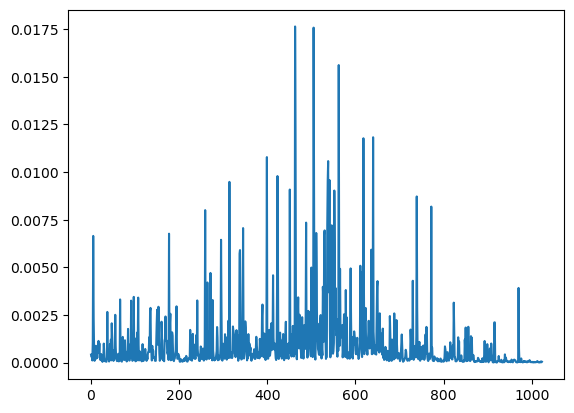

--------------------
253   3   0.39471092855385426   -0.45776696673710937
Target
7.181591944611865


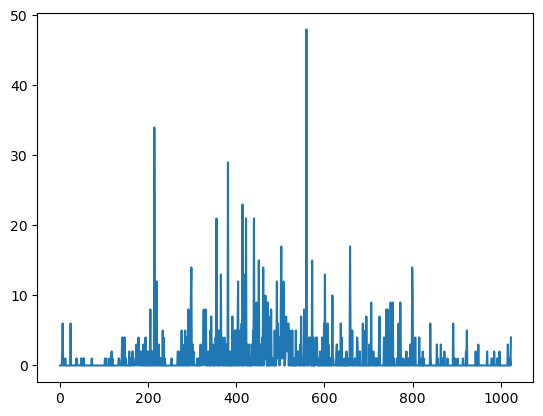

Prediction
tensor(6.7238, grad_fn=<SelectBackward0>)


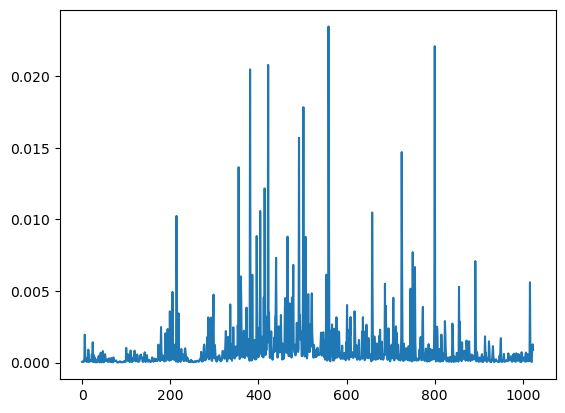

--------------------
476   1   0.38963983873094116   -0.9682684266413935
Target
7.424165281042028


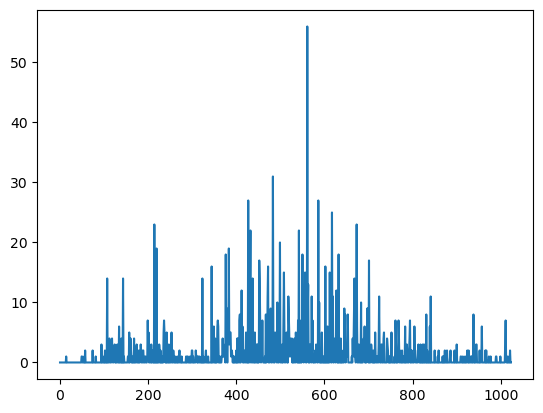

Prediction
tensor(6.4559, grad_fn=<SelectBackward0>)


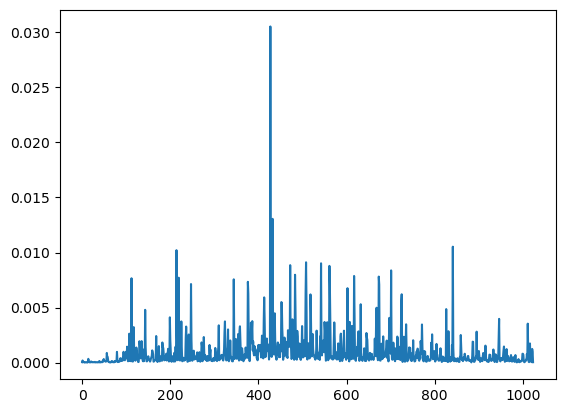

--------------------
476   2   0.3793893586721335   -1.1403626952071289
Target
7.45182223652793


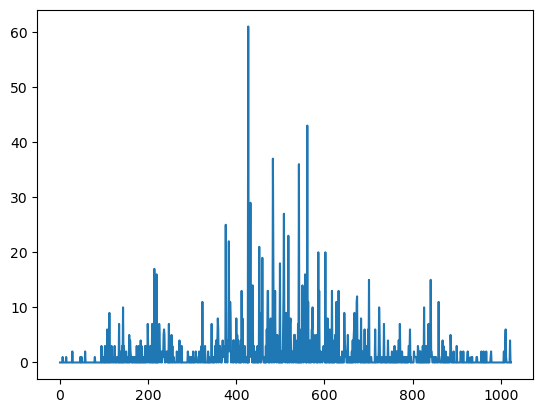

Prediction
tensor(6.3115, grad_fn=<SelectBackward0>)


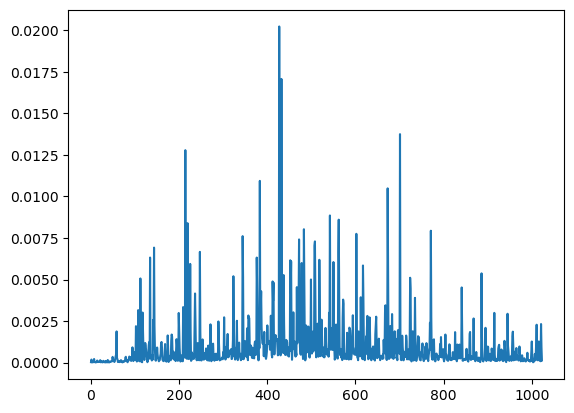

--------------------
476   3   0.3827553034769074   -1.2043832159049206
Target
7.638679823876112


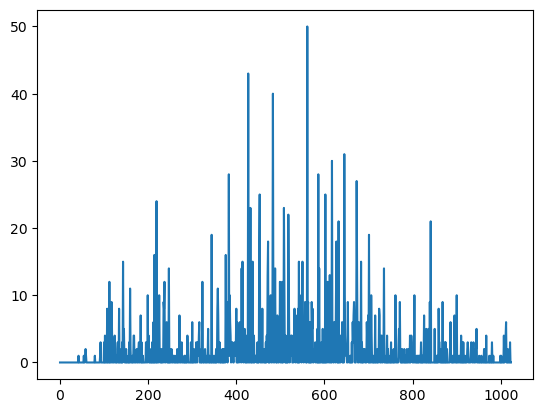

Prediction
tensor(6.4343, grad_fn=<SelectBackward0>)


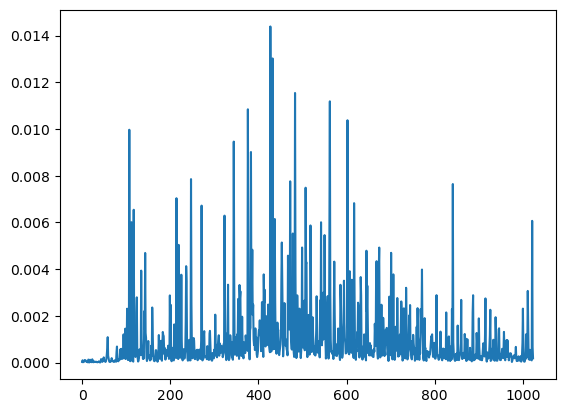

--------------------
486   1   0.3835434840404731   0.18499725765880637
Target
7.5740450053721995


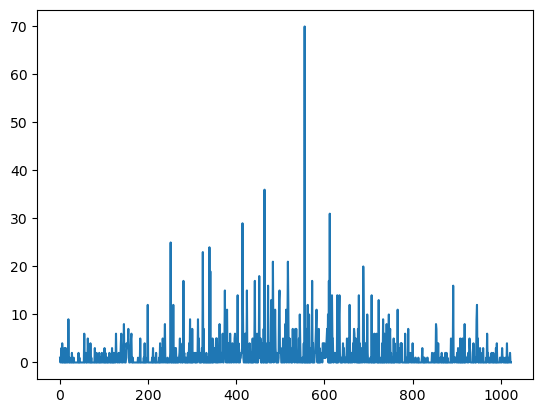

Prediction
tensor(7.7590, grad_fn=<SelectBackward0>)


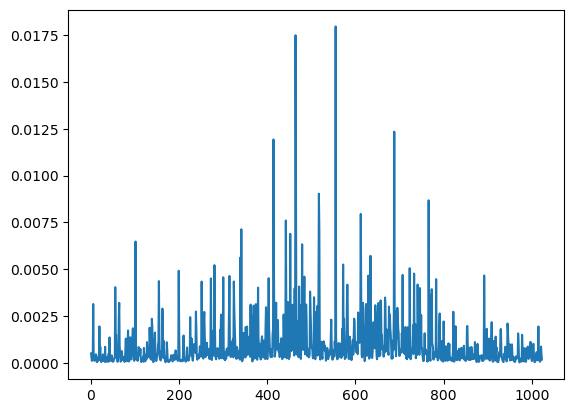

--------------------
486   2   0.3806436338730486   0.1462498420483529
Target
7.454719949364001


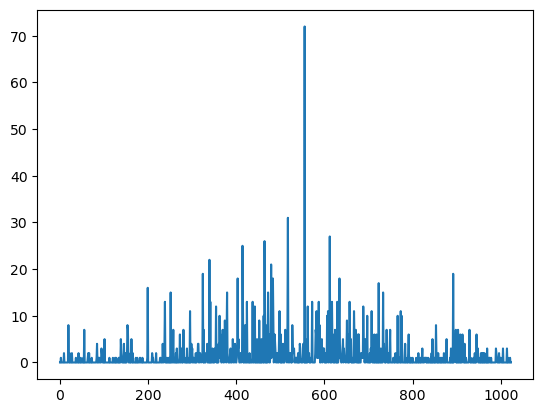

Prediction
tensor(7.6010, grad_fn=<SelectBackward0>)


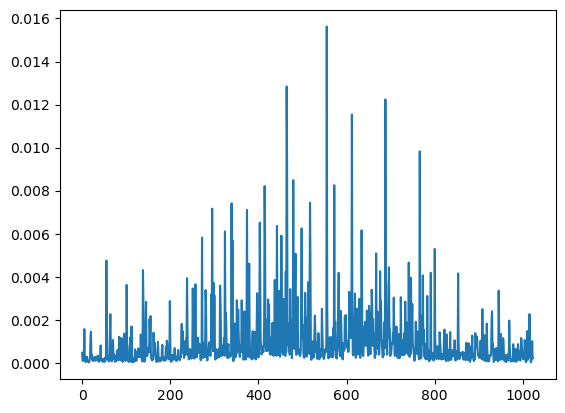

--------------------
486   3   0.3952233633405196   0.1334472830975617
Target
7.696667081526462


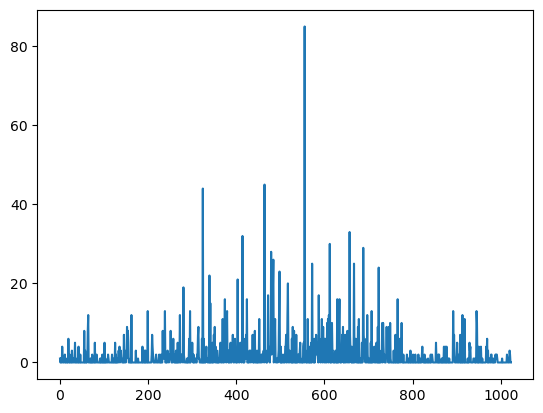

Prediction
tensor(7.8301, grad_fn=<SelectBackward0>)


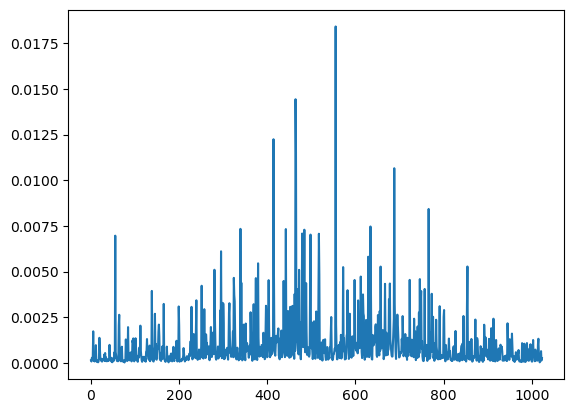

--------------------
507   1   0.3995459679105506   -0.04625465444092747
Target
7.405495663199472


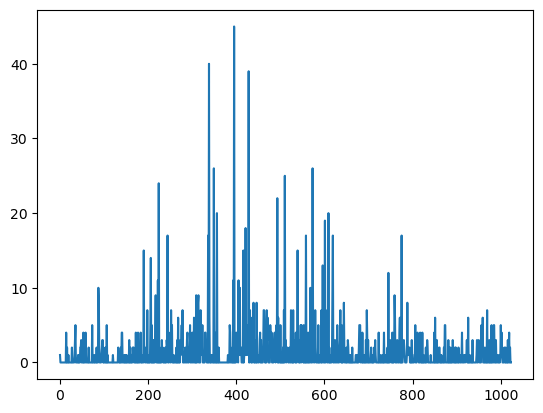

Prediction
tensor(7.3592, grad_fn=<SelectBackward0>)


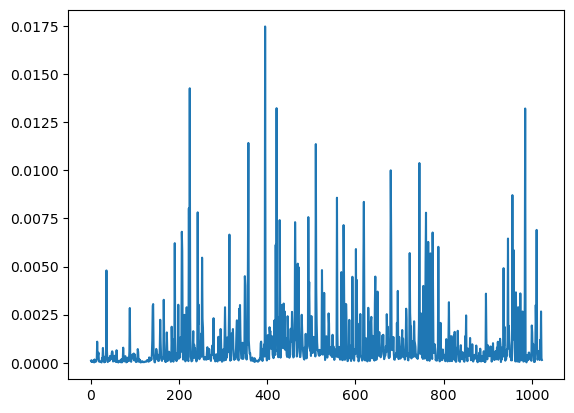

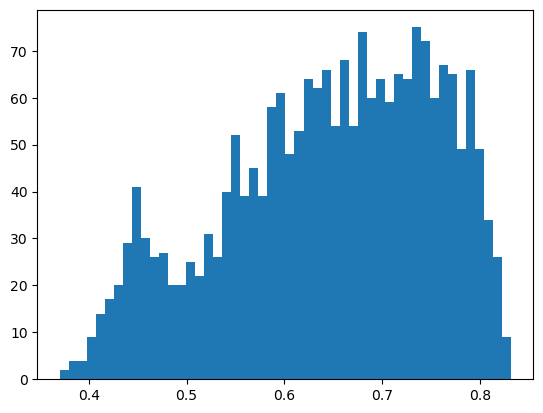

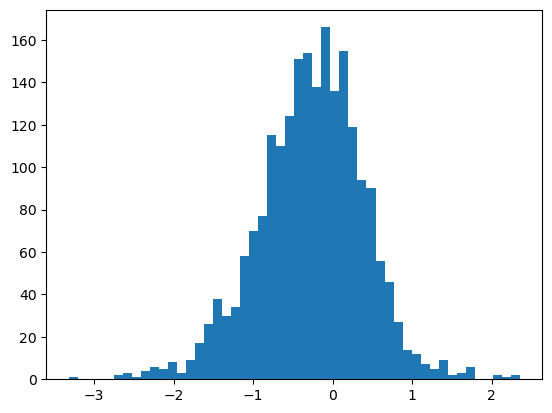

[SignificanceResult(statistic=0.7817447413938474, pvalue=3.425412991647019e-111), SignificanceResult(statistic=0.8503390567832788, pvalue=1.8905244747747338e-150), SignificanceResult(statistic=0.8304833255929789, pvalue=2.7044910160172683e-137), SignificanceResult(statistic=0.7960912837705783, pvalue=3.968483917095776e-118)]


In [ ]:
jsds, diffs = [], []
for i in range (count.size(0)):
    for t in range(4):
        
        target_prob = target[i,:,t]/target[i,:,t].sum()
        jsd = distance.jensenshannon(profile[i,:,t], target_prob)
        jsds.append(jsd)

        diff =  count[i,t].detach().numpy() - np.log(target[i,:,t].sum().numpy()+1)
        diffs.append(diff)

        if jsd < 0.4:
            print("--------------------")
            print(i, " ", t, " ", jsd, ' ', diff)
            print("Target")
            print(np.log(target[i,:,t].sum().numpy()+1))
            plt.plot(np.arange(0,1024),target[i,:,t])
            plt.show()

            print("Prediction")
            print(count[i,t])
            plt.plot(np.arange(0,1024),profile[i,:,t])
            plt.show()

plt.hist(jsds, bins=50)
plt.show()
plt.hist(diffs, bins=50)
plt.show()

corrs=[]
for i in range(4):
    corr = scipy.stats.spearmanr(count[:,i].detach().numpy(), np.log(target.sum(dim=1).numpy() +1)[:,i])
    corrs.append(corr)

print(corrs)

## Compare ref versus alt

--------------------
22   0   0.1544956122499838   0.8245468
Reference
tensor(4.6562, grad_fn=<SelectBackward0>)


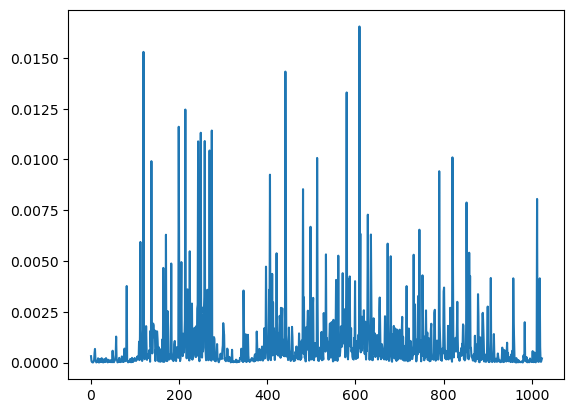

Alt
tensor(5.4808, grad_fn=<SelectBackward0>)


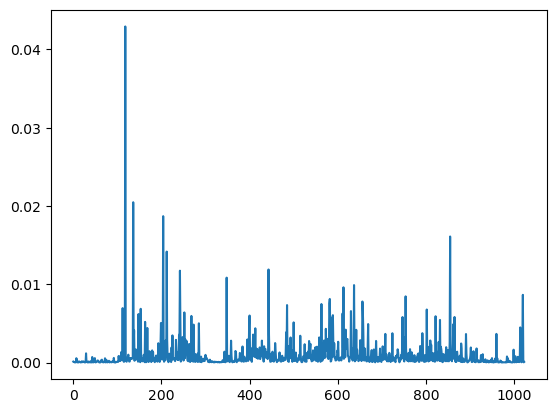

--------------------
22   1   0.2127478409454759   0.9403467
Reference
tensor(6.8462, grad_fn=<SelectBackward0>)


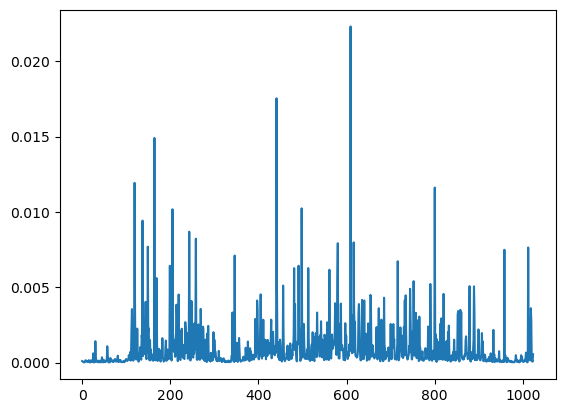

Alt
tensor(7.7866, grad_fn=<SelectBackward0>)


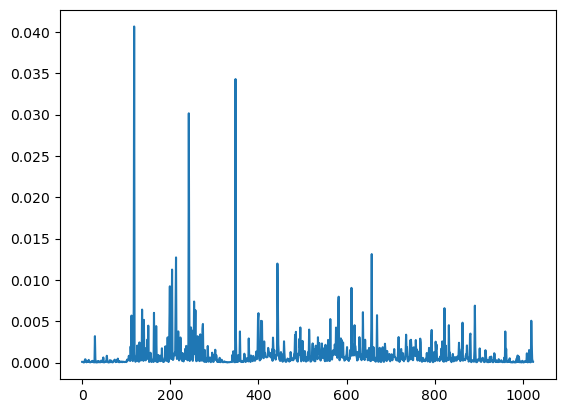

--------------------
22   2   0.35729367401107825   0.9802847
Reference
tensor(6.5440, grad_fn=<SelectBackward0>)


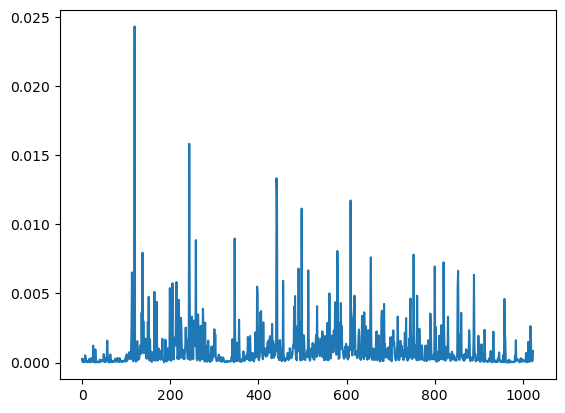

Alt
tensor(7.5242, grad_fn=<SelectBackward0>)


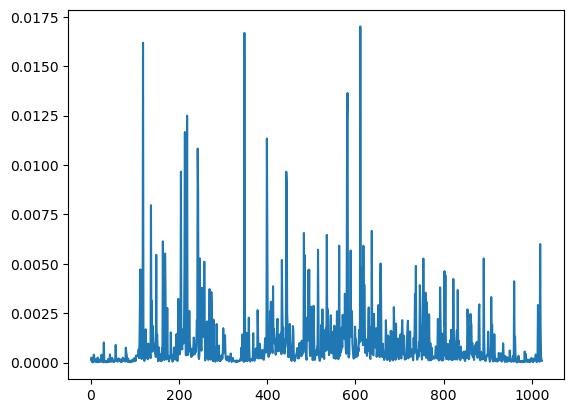

--------------------
22   3   0.08293578725600806   1.0418267
Reference
tensor(6.7243, grad_fn=<SelectBackward0>)


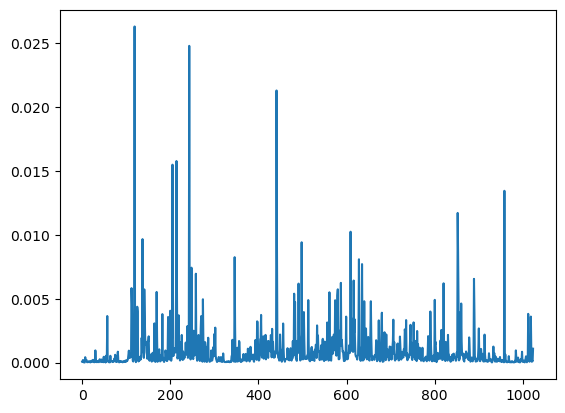

Alt
tensor(7.7662, grad_fn=<SelectBackward0>)


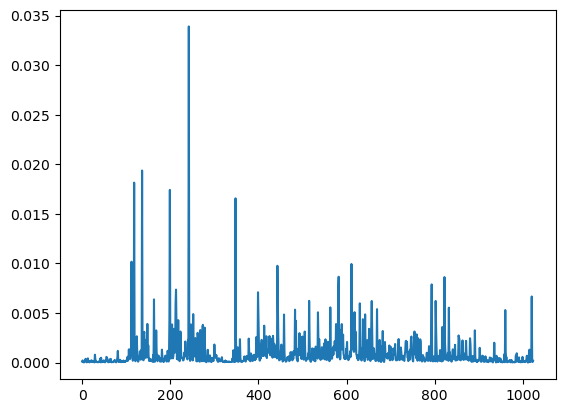

--------------------
65   2   0.016355307997575688   -0.26790142
Reference
tensor(3.9102, grad_fn=<SelectBackward0>)


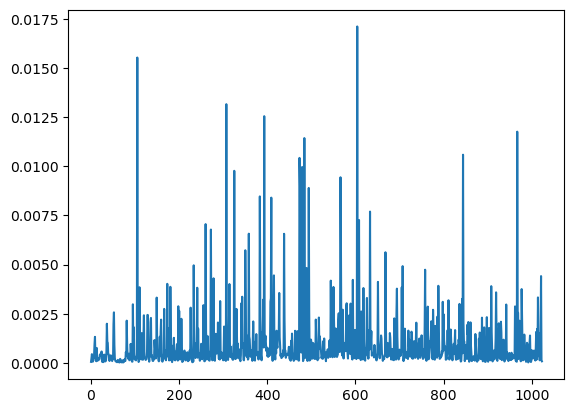

Alt
tensor(3.6423, grad_fn=<SelectBackward0>)


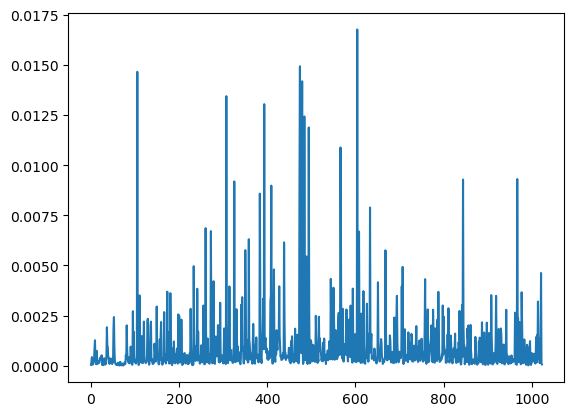

--------------------
65   3   0.006016918018639401   -0.27785206
Reference
tensor(4.2120, grad_fn=<SelectBackward0>)


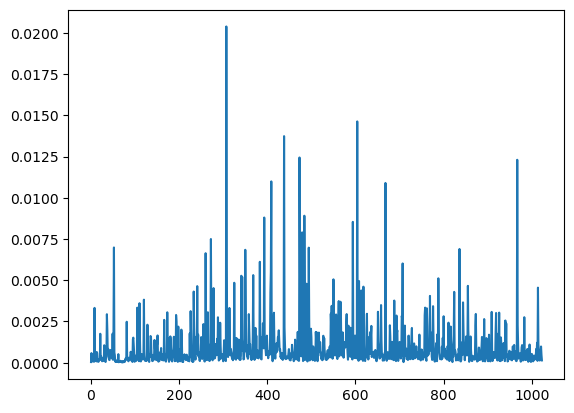

Alt
tensor(3.9341, grad_fn=<SelectBackward0>)


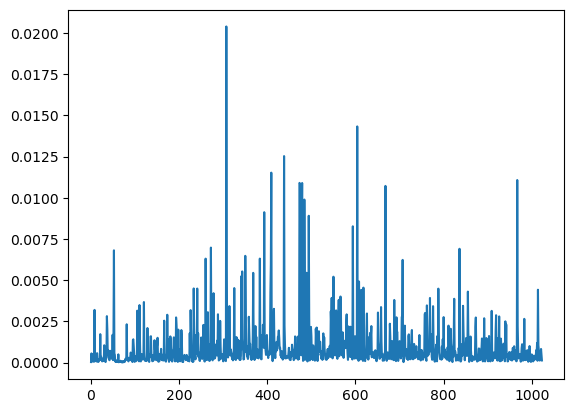

--------------------
112   0   0.008117431981147158   0.34428573
Reference
tensor(2.7319, grad_fn=<SelectBackward0>)


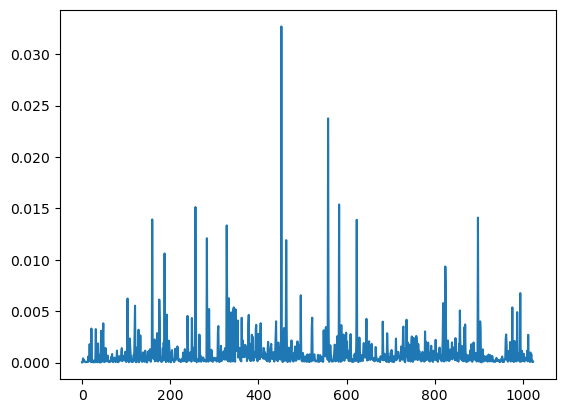

Alt
tensor(3.0762, grad_fn=<SelectBackward0>)


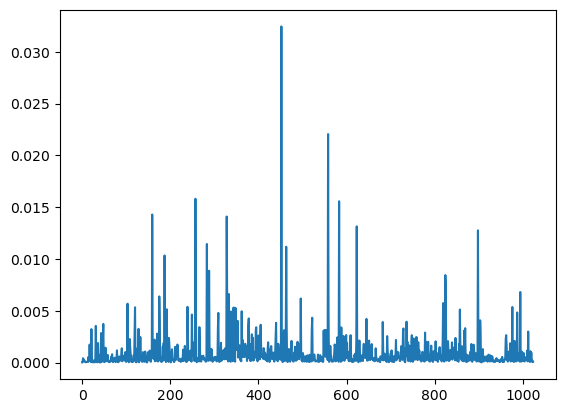

--------------------
112   1   0.005855386961318981   0.37507343
Reference
tensor(4.7878, grad_fn=<SelectBackward0>)


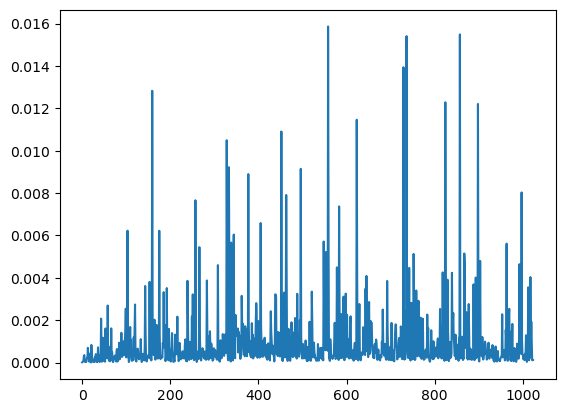

Alt
tensor(5.1629, grad_fn=<SelectBackward0>)


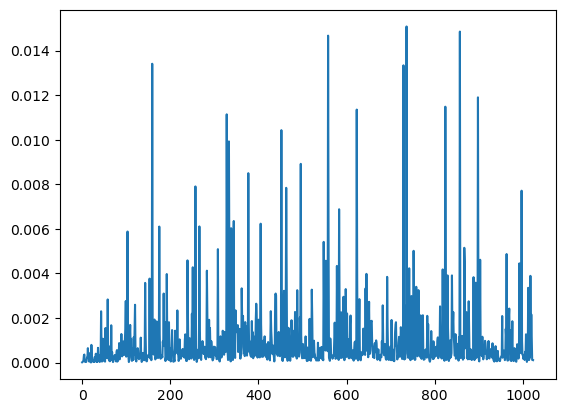

--------------------
112   2   0.005143581400451186   0.43477154
Reference
tensor(4.7079, grad_fn=<SelectBackward0>)


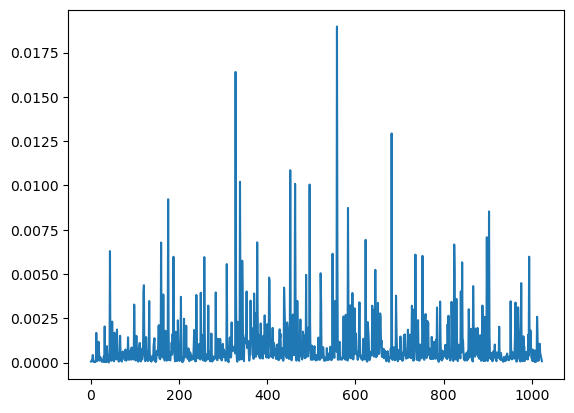

Alt
tensor(5.1427, grad_fn=<SelectBackward0>)


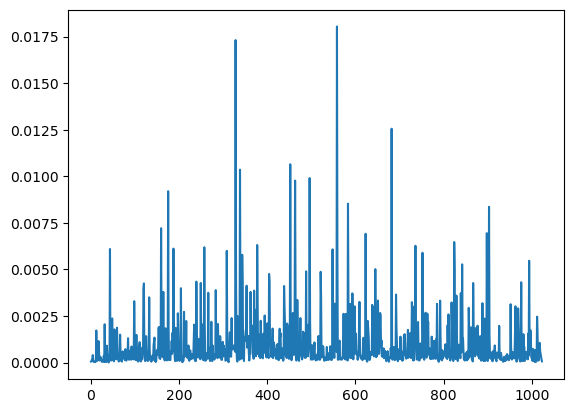

--------------------
112   3   0.014590003767246743   0.44516468
Reference
tensor(4.9955, grad_fn=<SelectBackward0>)


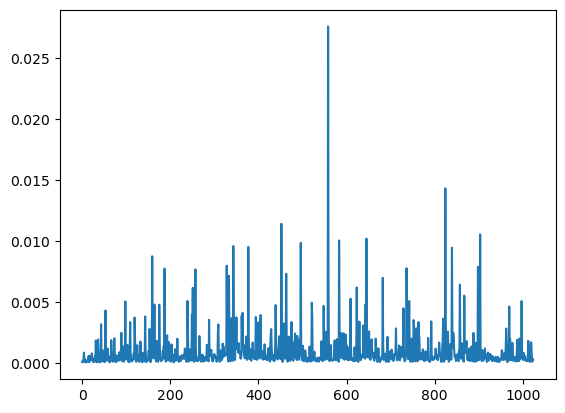

Alt
tensor(5.4406, grad_fn=<SelectBackward0>)


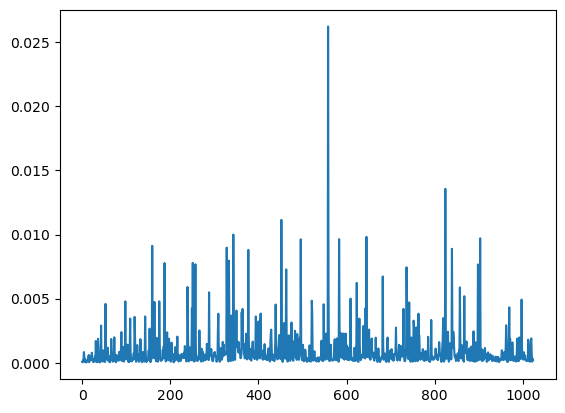

--------------------
128   0   0.016232526146116987   -0.43205357
Reference
tensor(4.6149, grad_fn=<SelectBackward0>)


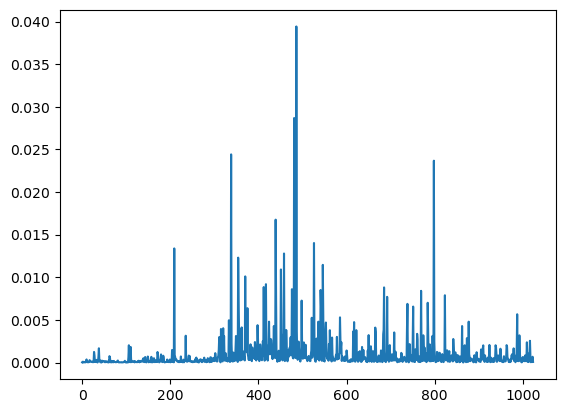

Alt
tensor(4.1829, grad_fn=<SelectBackward0>)


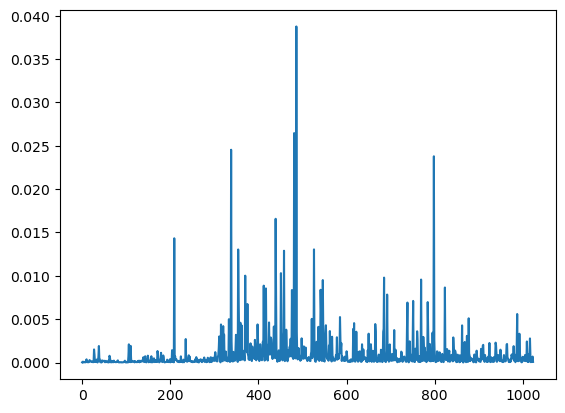

--------------------
128   1   0.010450510586894292   -0.46166754
Reference
tensor(6.8495, grad_fn=<SelectBackward0>)


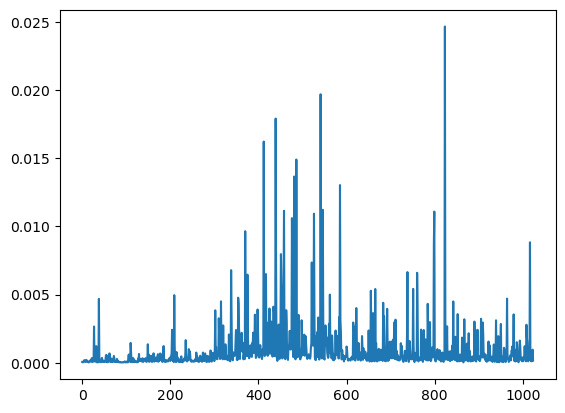

Alt
tensor(6.3879, grad_fn=<SelectBackward0>)


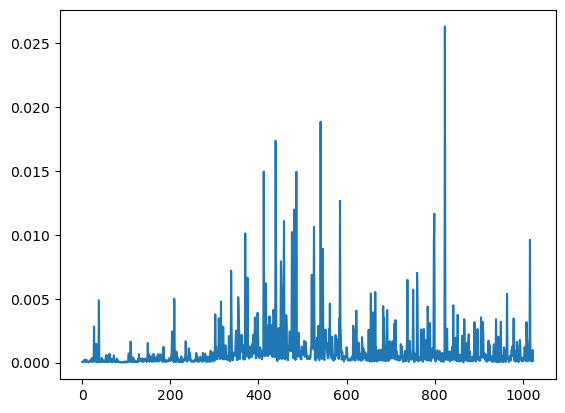

--------------------
128   2   0.007145643834853576   -0.49952507
Reference
tensor(6.6788, grad_fn=<SelectBackward0>)


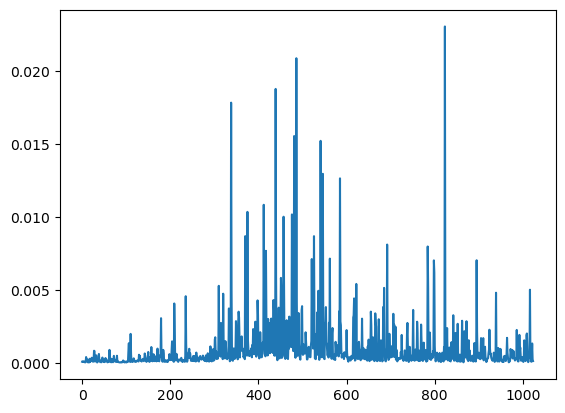

Alt
tensor(6.1793, grad_fn=<SelectBackward0>)


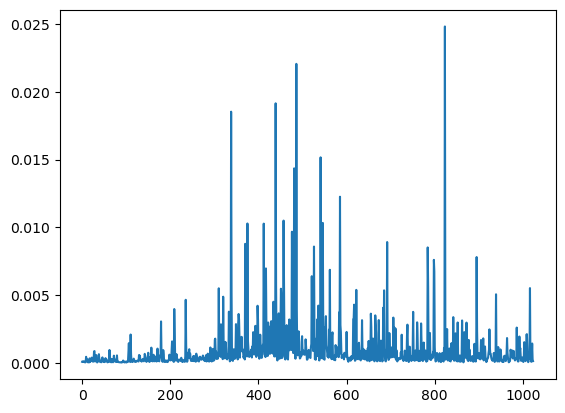

--------------------
128   3   0.017688918632223515   -0.5293274
Reference
tensor(6.8940, grad_fn=<SelectBackward0>)


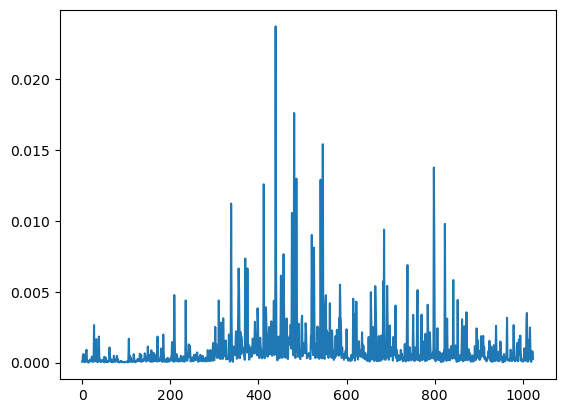

Alt
tensor(6.3647, grad_fn=<SelectBackward0>)


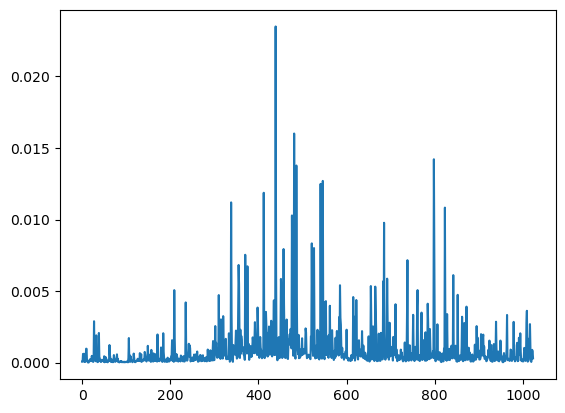

--------------------
134   0   0.0104495998785442   0.2983427
Reference
tensor(2.6055, grad_fn=<SelectBackward0>)


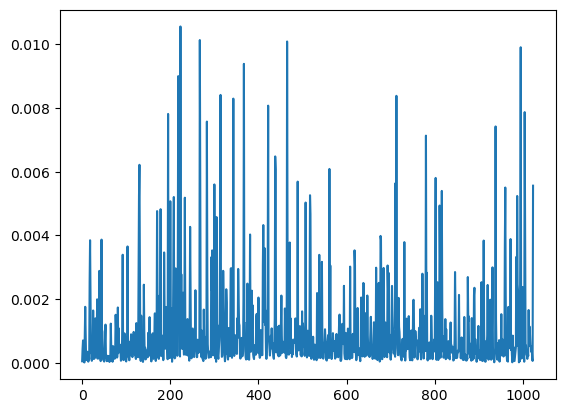

Alt
tensor(2.9039, grad_fn=<SelectBackward0>)


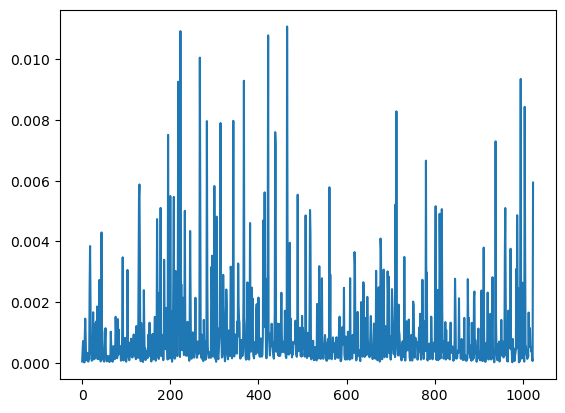

--------------------
134   1   0.013181664184366126   0.3201723
Reference
tensor(4.6631, grad_fn=<SelectBackward0>)


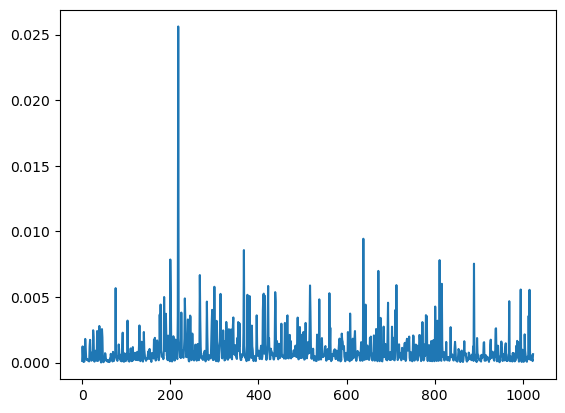

Alt
tensor(4.9833, grad_fn=<SelectBackward0>)


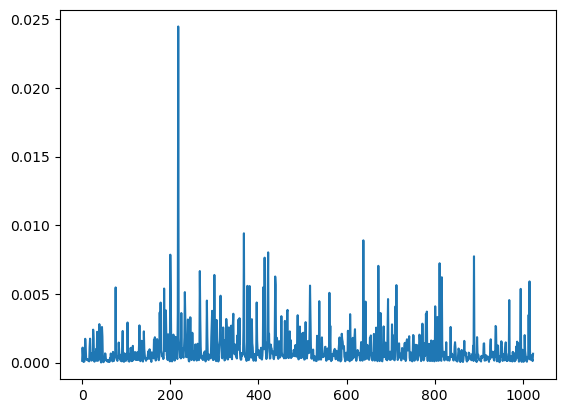

--------------------
134   2   0.008660506286405972   0.32539272
Reference
tensor(4.5050, grad_fn=<SelectBackward0>)


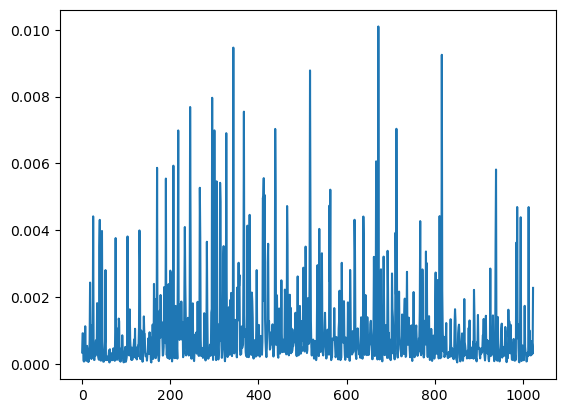

Alt
tensor(4.8304, grad_fn=<SelectBackward0>)


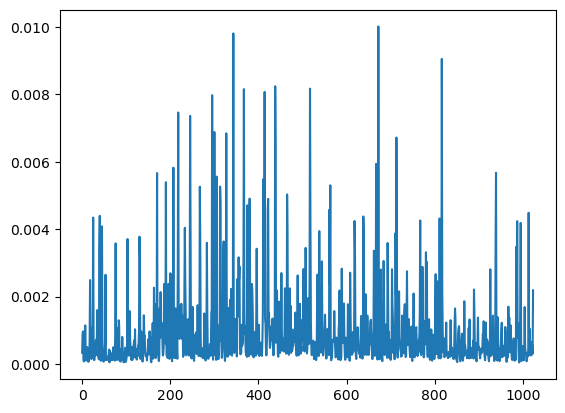

--------------------
134   3   0.01247673589255105   0.33869362
Reference
tensor(4.7061, grad_fn=<SelectBackward0>)


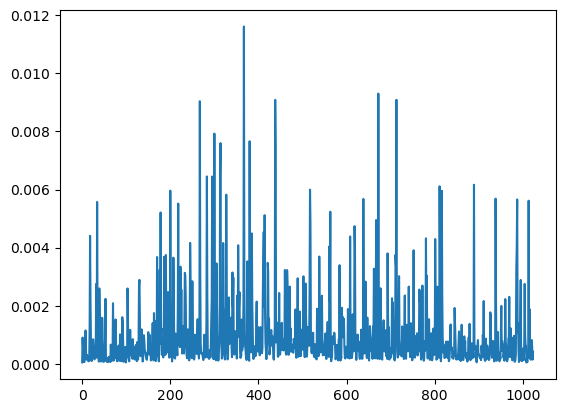

Alt
tensor(5.0448, grad_fn=<SelectBackward0>)


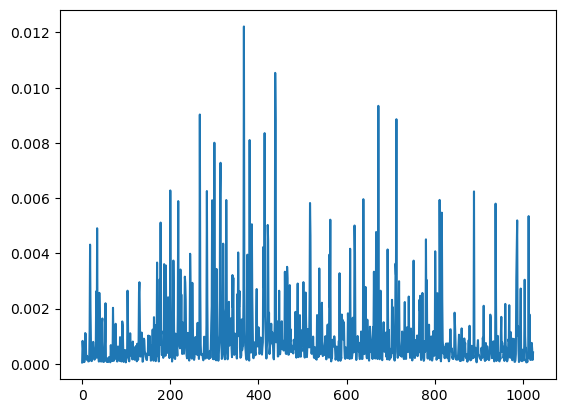

--------------------
230   1   0.014773315367781372   0.266078
Reference
tensor(3.8954, grad_fn=<SelectBackward0>)


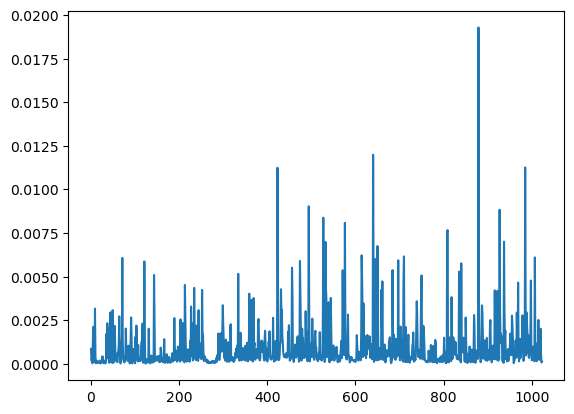

Alt
tensor(4.1614, grad_fn=<SelectBackward0>)


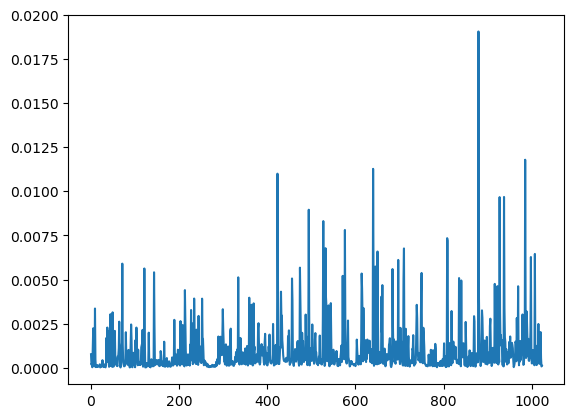

--------------------
230   2   0.017948675604023225   0.25839376
Reference
tensor(3.8326, grad_fn=<SelectBackward0>)


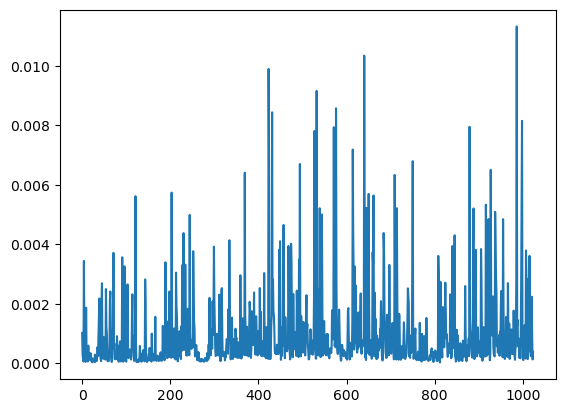

Alt
tensor(4.0910, grad_fn=<SelectBackward0>)


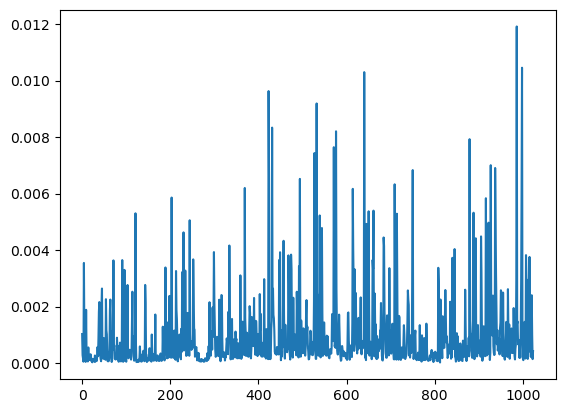

--------------------
230   3   0.014306976197248833   0.26694727
Reference
tensor(3.9442, grad_fn=<SelectBackward0>)


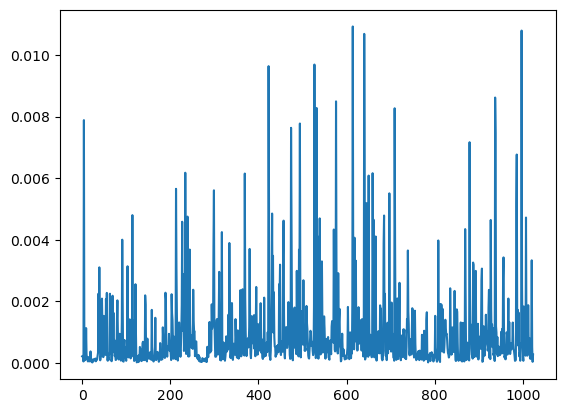

Alt
tensor(4.2112, grad_fn=<SelectBackward0>)


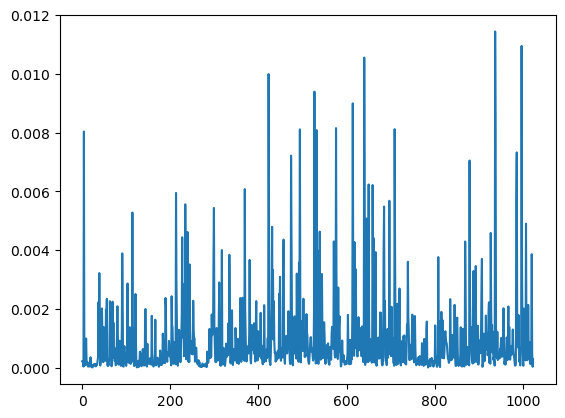

--------------------
232   0   0.01082678558204011   -0.36919403
Reference
tensor(2.5754, grad_fn=<SelectBackward0>)


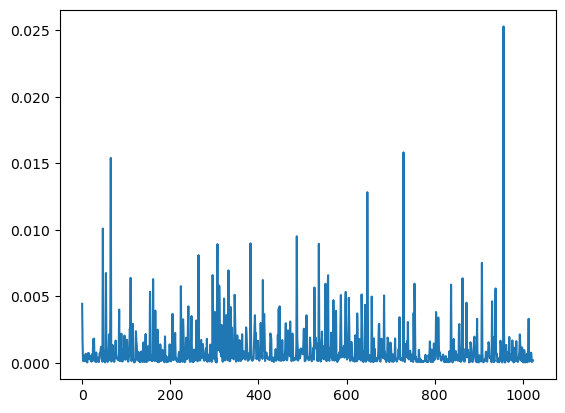

Alt
tensor(2.2062, grad_fn=<SelectBackward0>)


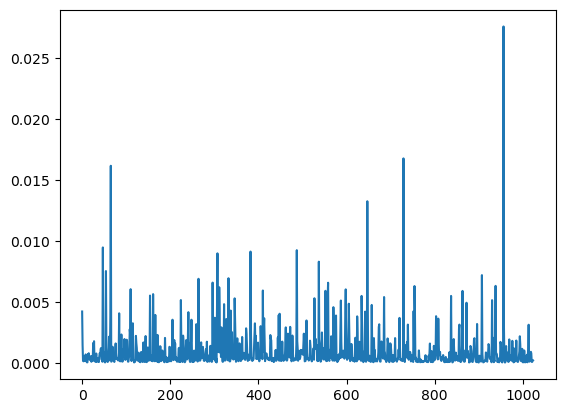

--------------------
232   1   0.015143746621127191   -0.3970995
Reference
tensor(4.6867, grad_fn=<SelectBackward0>)


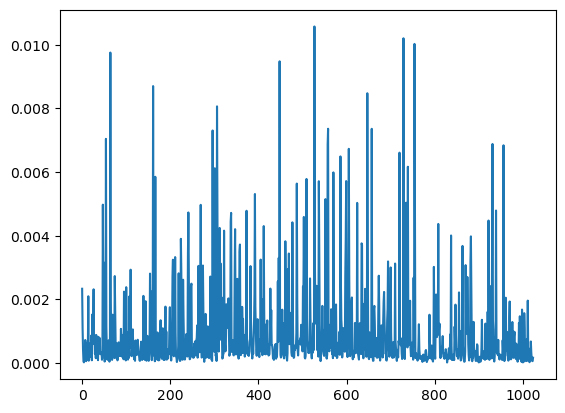

Alt
tensor(4.2896, grad_fn=<SelectBackward0>)


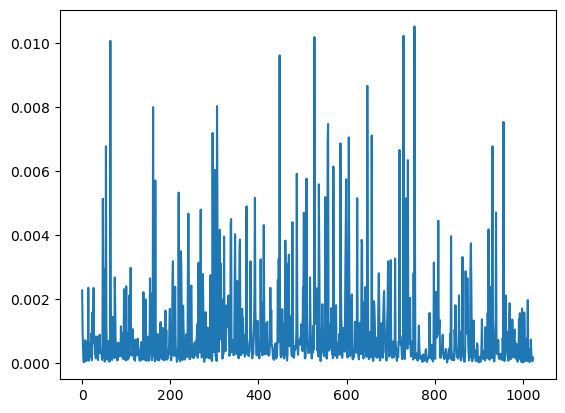

--------------------
232   2   0.010363268081880983   -0.40415716
Reference
tensor(4.5954, grad_fn=<SelectBackward0>)


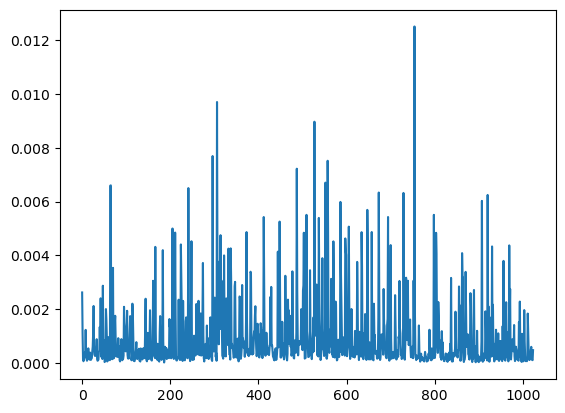

Alt
tensor(4.1913, grad_fn=<SelectBackward0>)


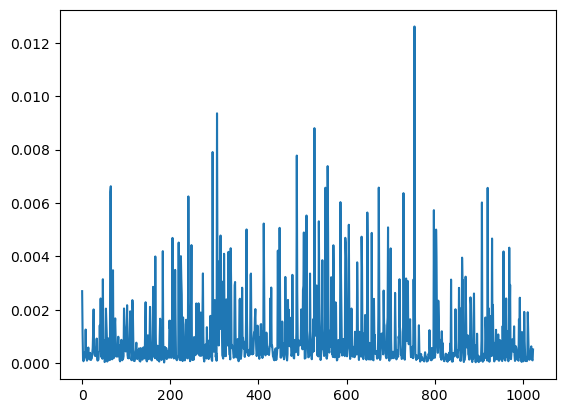

--------------------
232   3   0.0075382085857650894   -0.41689777
Reference
tensor(4.7157, grad_fn=<SelectBackward0>)


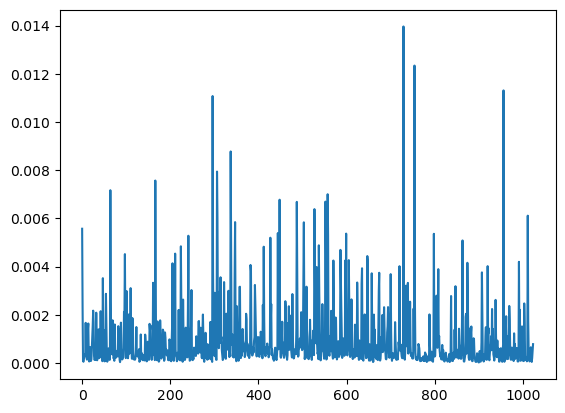

Alt
tensor(4.2988, grad_fn=<SelectBackward0>)


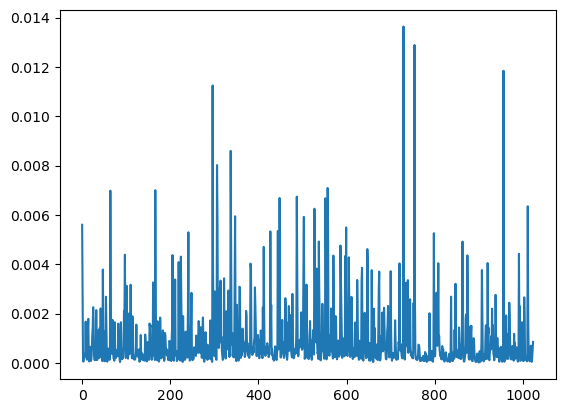

--------------------
248   0   0.02155719885738833   -0.50956297
Reference
tensor(3.2537, grad_fn=<SelectBackward0>)


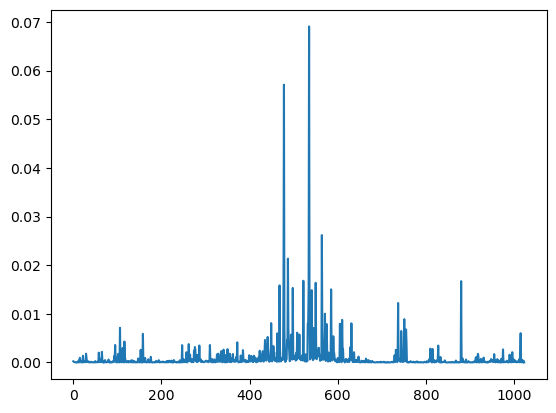

Alt
tensor(2.7441, grad_fn=<SelectBackward0>)


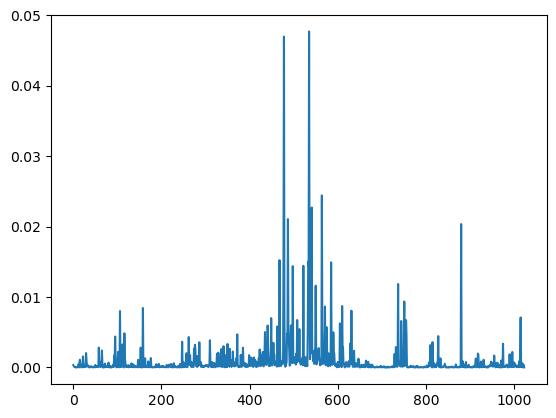

--------------------
248   1   0.012907519612315888   -0.57122374
Reference
tensor(5.5825, grad_fn=<SelectBackward0>)


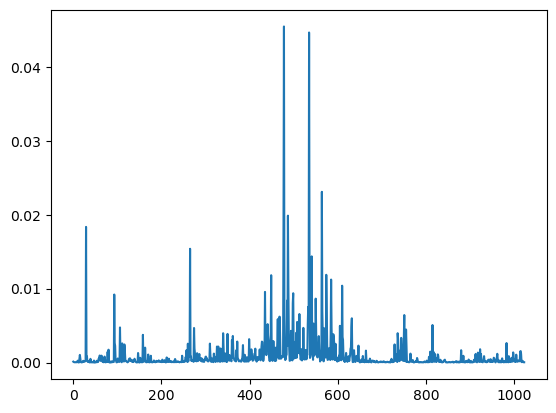

Alt
tensor(5.0113, grad_fn=<SelectBackward0>)


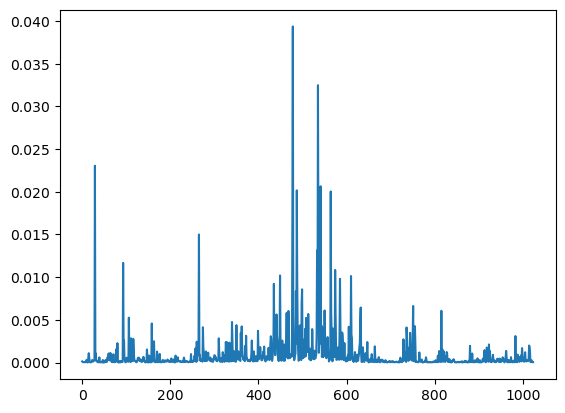

--------------------
248   2   0.03375054090229794   -0.57778835
Reference
tensor(5.5460, grad_fn=<SelectBackward0>)


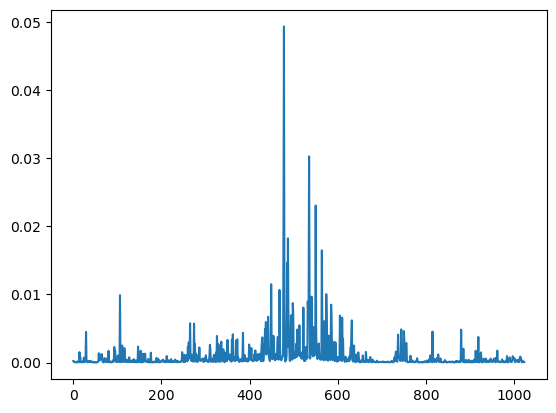

Alt
tensor(4.9682, grad_fn=<SelectBackward0>)


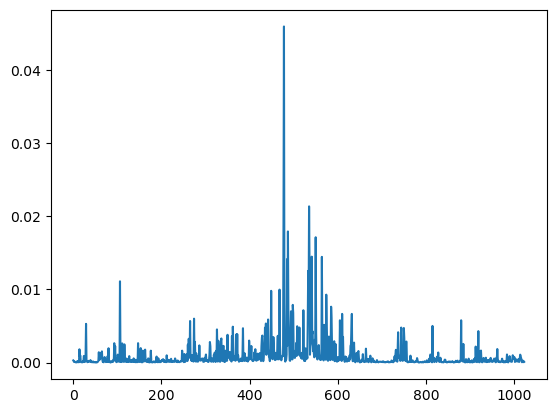

--------------------
248   3   0.03309260585448782   -0.6056738
Reference
tensor(5.7367, grad_fn=<SelectBackward0>)


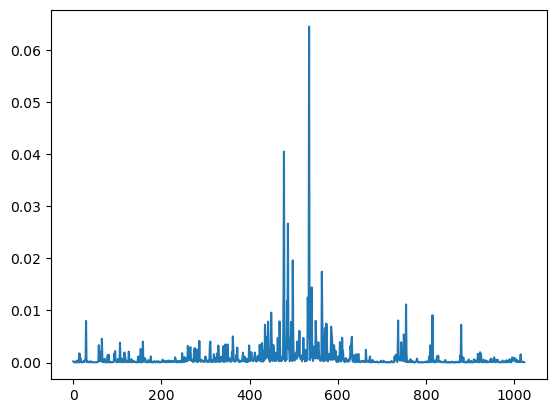

Alt
tensor(5.1310, grad_fn=<SelectBackward0>)


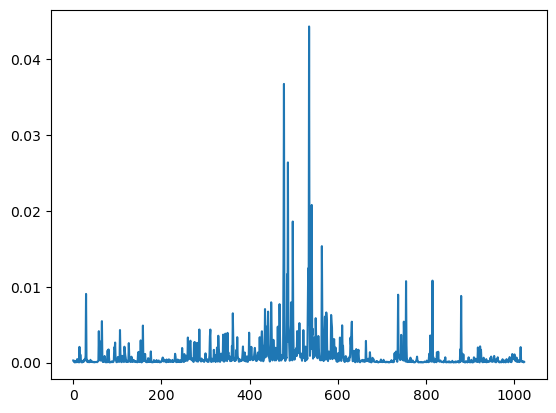

--------------------
253   0   0.031099568330622333   0.5534253
Reference
tensor(4.3579, grad_fn=<SelectBackward0>)


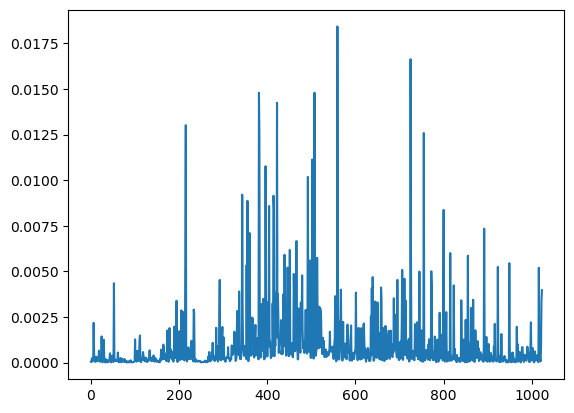

Alt
tensor(4.9114, grad_fn=<SelectBackward0>)


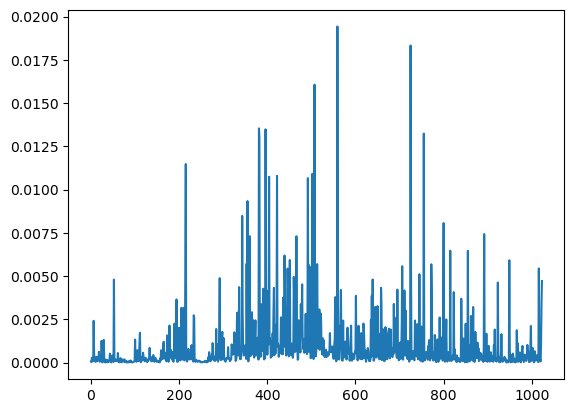

--------------------
253   1   0.022701401566662217   0.5972614
Reference
tensor(6.7586, grad_fn=<SelectBackward0>)


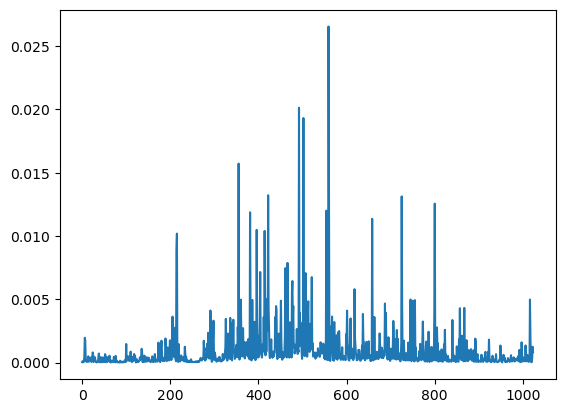

Alt
tensor(7.3558, grad_fn=<SelectBackward0>)


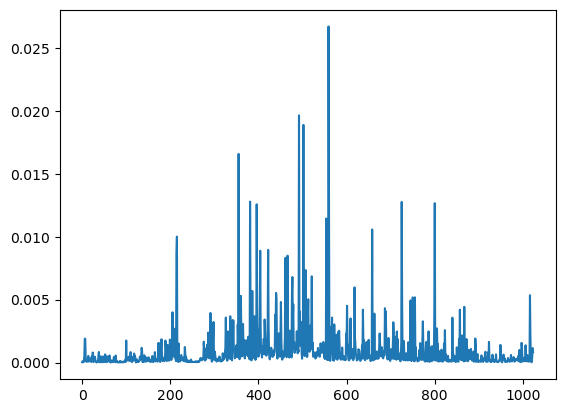

--------------------
253   2   0.018308207044511696   0.60982037
Reference
tensor(6.5069, grad_fn=<SelectBackward0>)


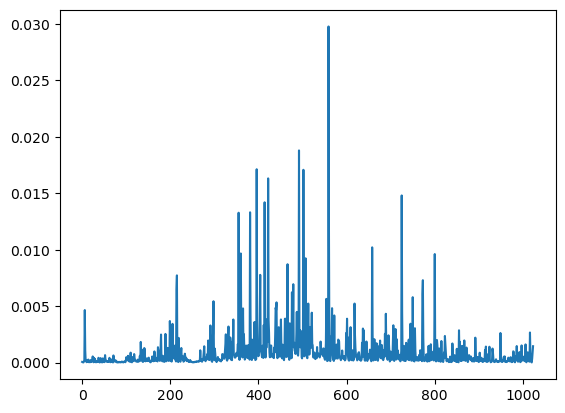

Alt
tensor(7.1167, grad_fn=<SelectBackward0>)


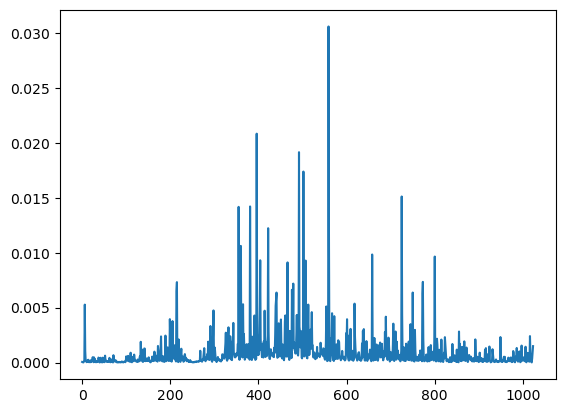

--------------------
253   3   0.012272971392084674   0.64254
Reference
tensor(6.7238, grad_fn=<SelectBackward0>)


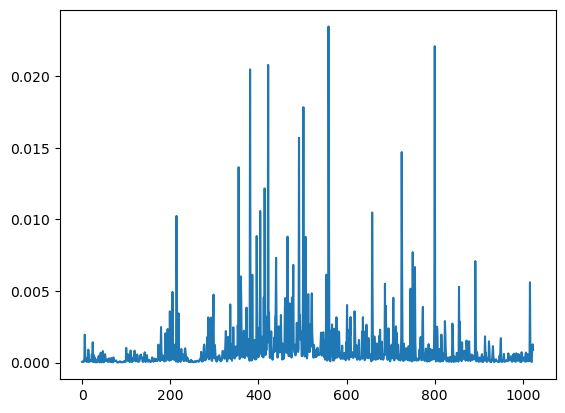

Alt
tensor(7.3664, grad_fn=<SelectBackward0>)


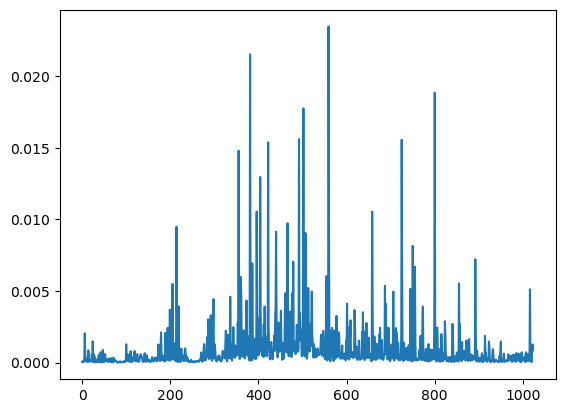

--------------------
284   3   0.005801992771519436   -0.26110125
Reference
tensor(7.6901, grad_fn=<SelectBackward0>)


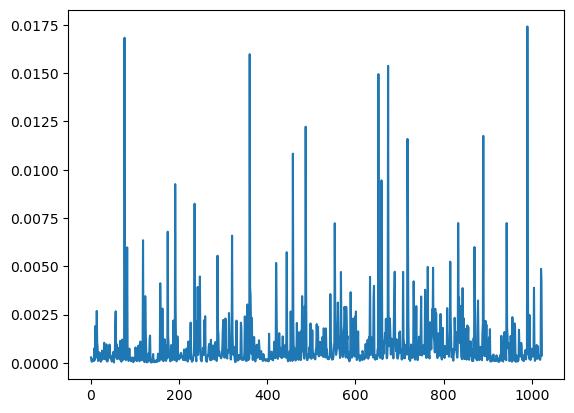

Alt
tensor(7.4290, grad_fn=<SelectBackward0>)


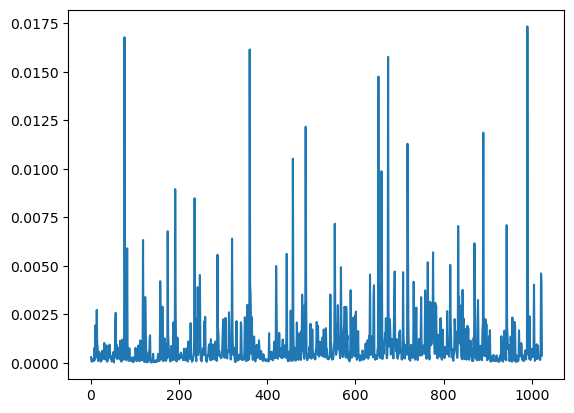

--------------------
291   0   0.01827061112792799   0.35173106
Reference
tensor(3.4689, grad_fn=<SelectBackward0>)


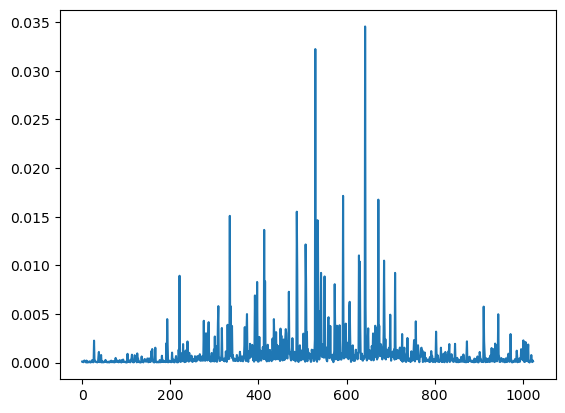

Alt
tensor(3.8206, grad_fn=<SelectBackward0>)


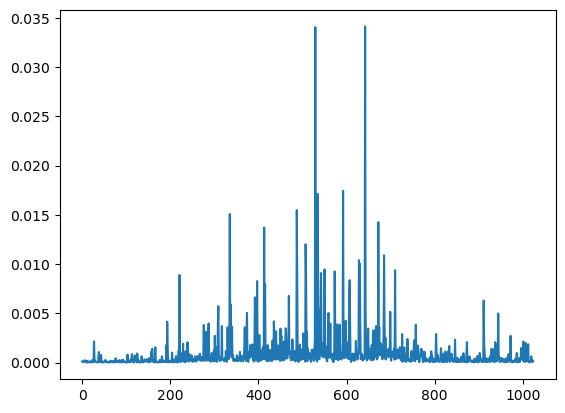

--------------------
291   1   0.009257678471572878   0.36090612
Reference
tensor(5.7547, grad_fn=<SelectBackward0>)


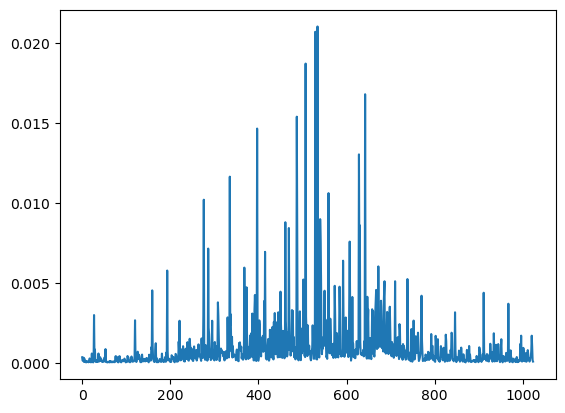

Alt
tensor(6.1157, grad_fn=<SelectBackward0>)


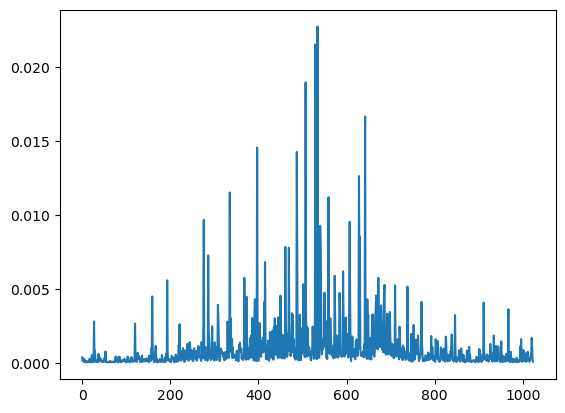

--------------------
291   2   0.016581523244959456   0.37992668
Reference
tensor(5.5931, grad_fn=<SelectBackward0>)


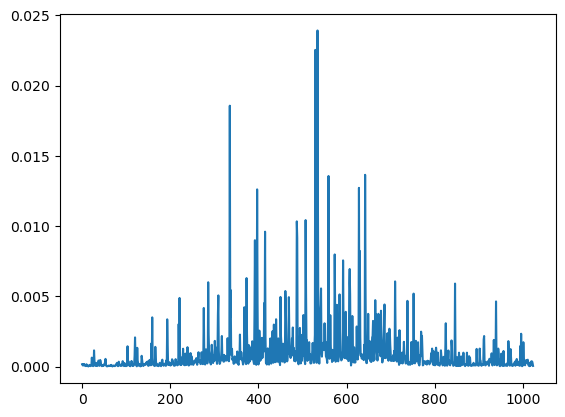

Alt
tensor(5.9730, grad_fn=<SelectBackward0>)


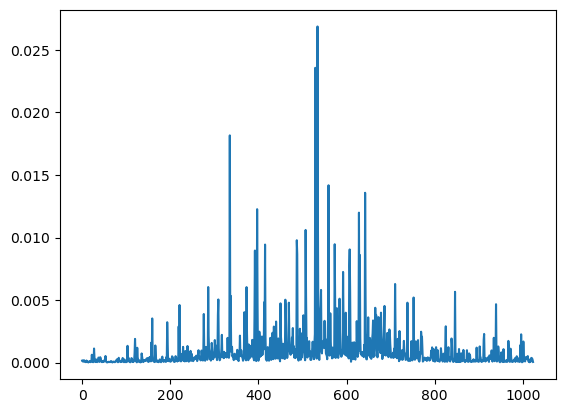

--------------------
291   3   0.010831796444876758   0.40807533
Reference
tensor(5.6552, grad_fn=<SelectBackward0>)


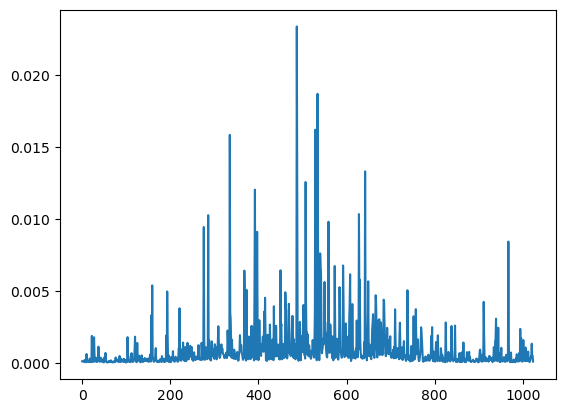

Alt
tensor(6.0633, grad_fn=<SelectBackward0>)


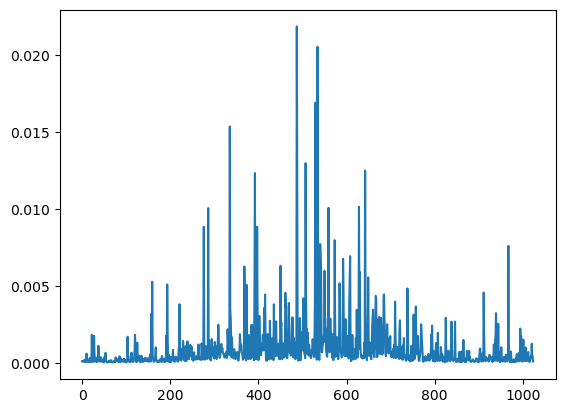

--------------------
369   0   0.009015097386558925   -0.53394556
Reference
tensor(5.2676, grad_fn=<SelectBackward0>)


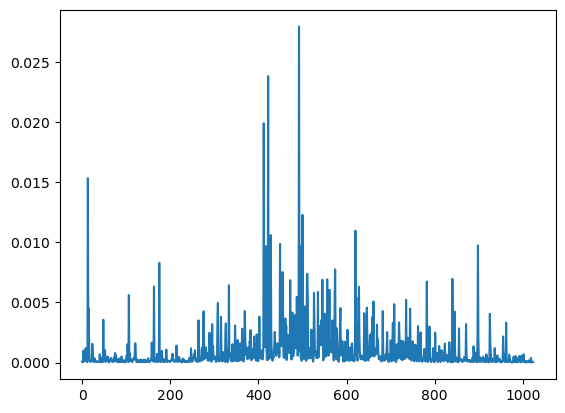

Alt
tensor(4.7336, grad_fn=<SelectBackward0>)


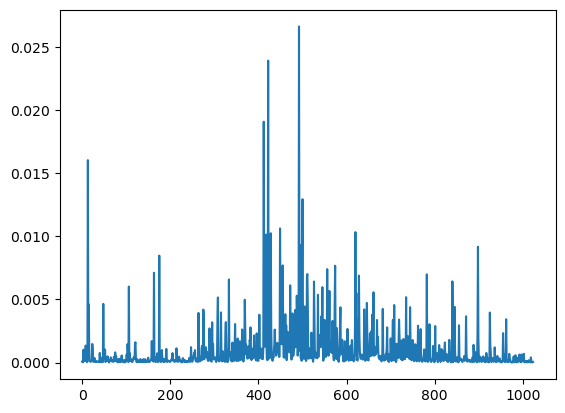

--------------------
369   1   0.009950280800063821   -0.58650684
Reference
tensor(7.6480, grad_fn=<SelectBackward0>)


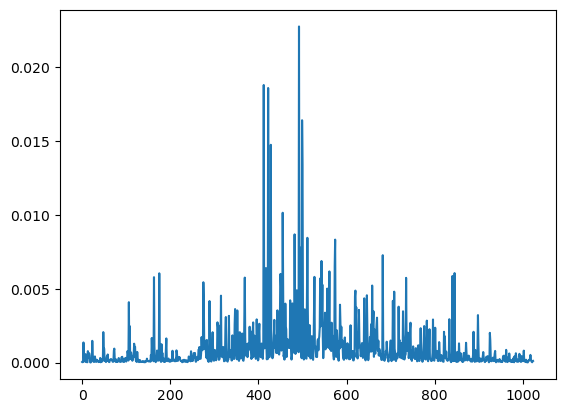

Alt
tensor(7.0615, grad_fn=<SelectBackward0>)


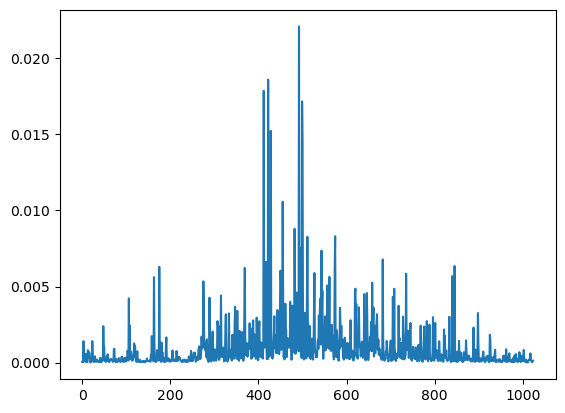

--------------------
369   2   0.012546965538757612   -0.586956
Reference
tensor(7.5593, grad_fn=<SelectBackward0>)


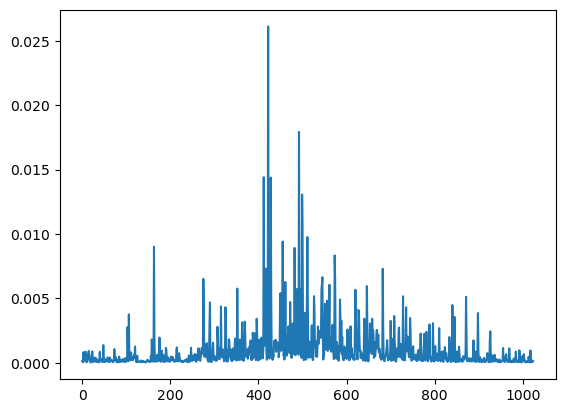

Alt
tensor(6.9724, grad_fn=<SelectBackward0>)


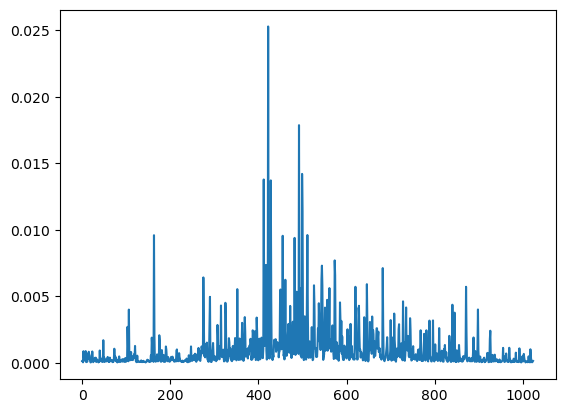

--------------------
369   3   0.003804455837690003   -0.61855364
Reference
tensor(7.7062, grad_fn=<SelectBackward0>)


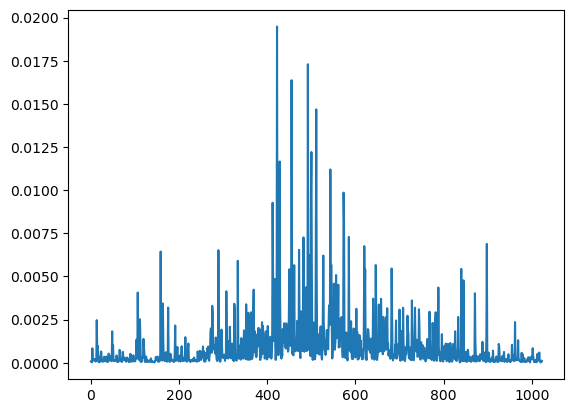

Alt
tensor(7.0876, grad_fn=<SelectBackward0>)


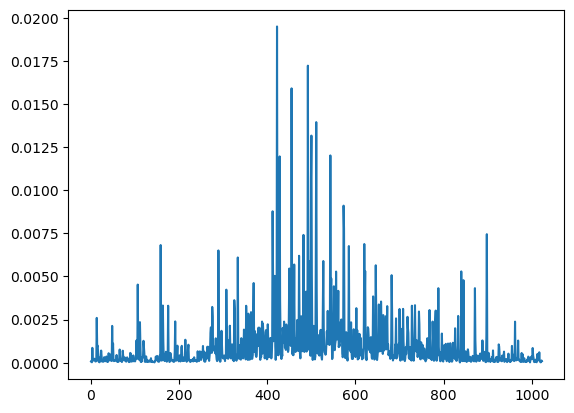

--------------------
373   0   0.22778215643181274   -0.4084363
Reference
tensor(3.8559, grad_fn=<SelectBackward0>)


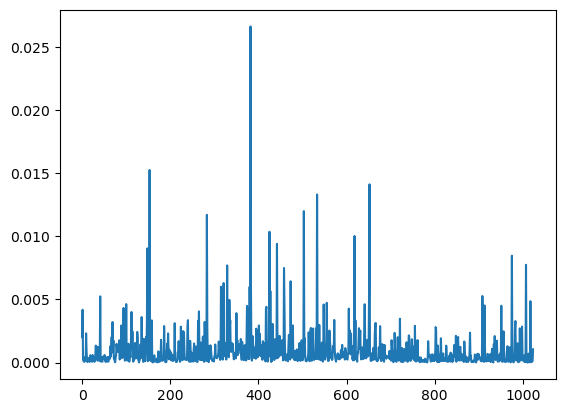

Alt
tensor(3.4475, grad_fn=<SelectBackward0>)


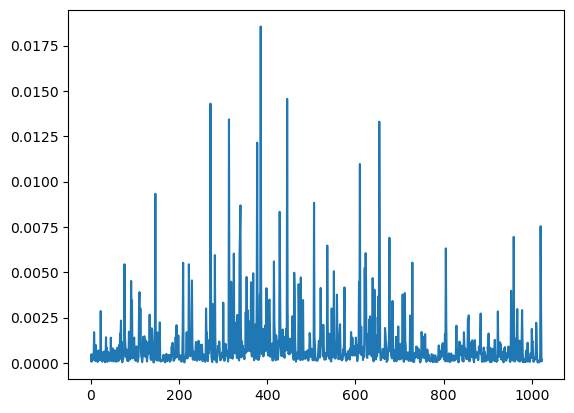

--------------------
373   1   0.2432648629835642   -0.47619295
Reference
tensor(6.0196, grad_fn=<SelectBackward0>)


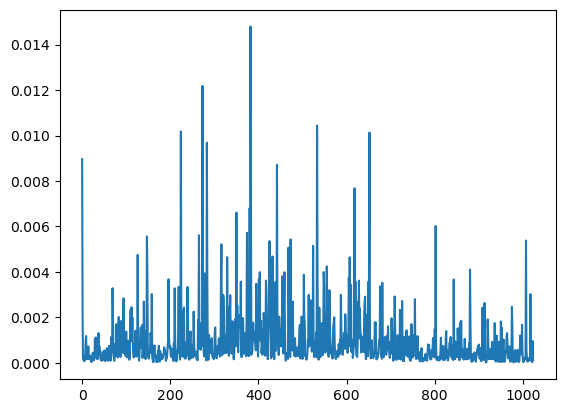

Alt
tensor(5.5434, grad_fn=<SelectBackward0>)


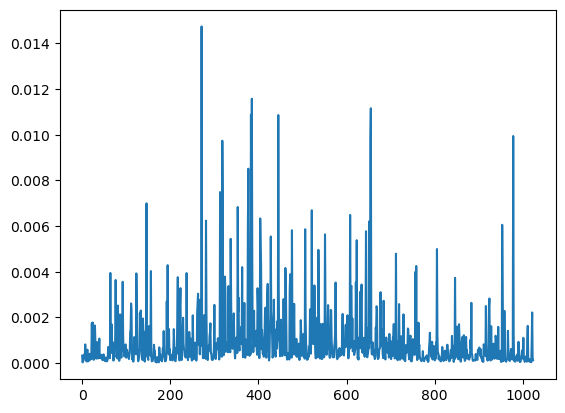

--------------------
373   2   0.2406810701363772   -0.4911399
Reference
tensor(5.8412, grad_fn=<SelectBackward0>)


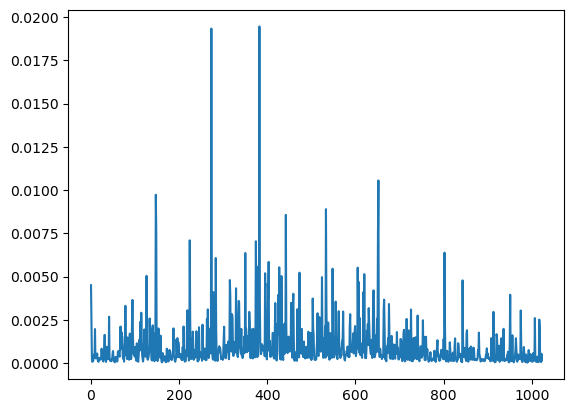

Alt
tensor(5.3500, grad_fn=<SelectBackward0>)


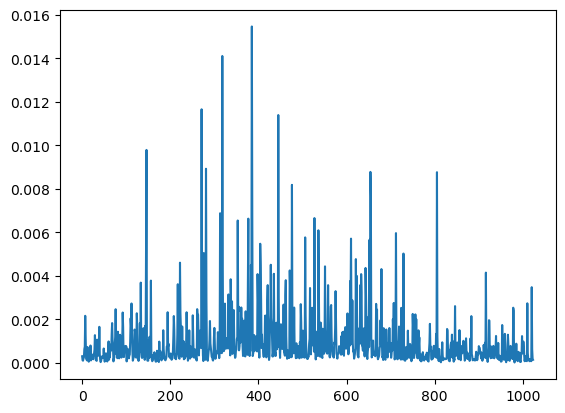

--------------------
373   3   0.20287204544256954   -0.52556133
Reference
tensor(6.0824, grad_fn=<SelectBackward0>)


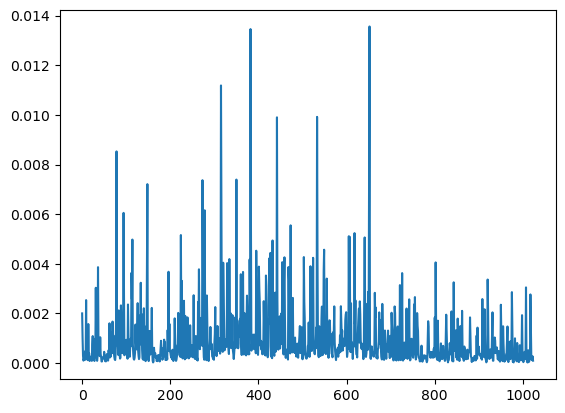

Alt
tensor(5.5568, grad_fn=<SelectBackward0>)


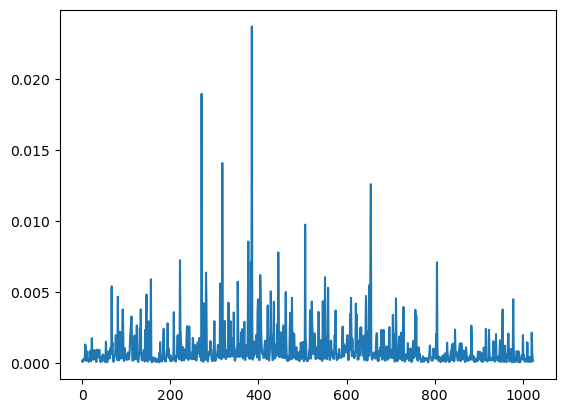

--------------------
379   0   0.015087026892324155   -0.25747848
Reference
tensor(3.1799, grad_fn=<SelectBackward0>)


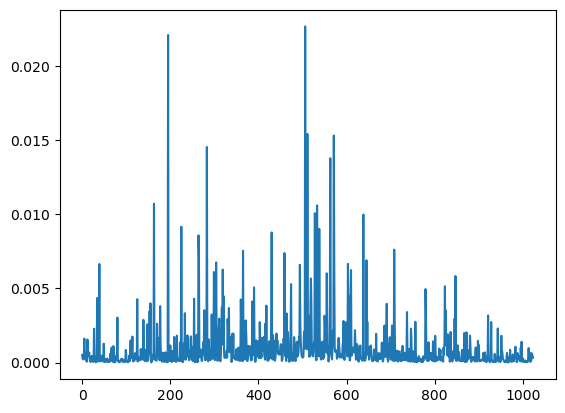

Alt
tensor(2.9224, grad_fn=<SelectBackward0>)


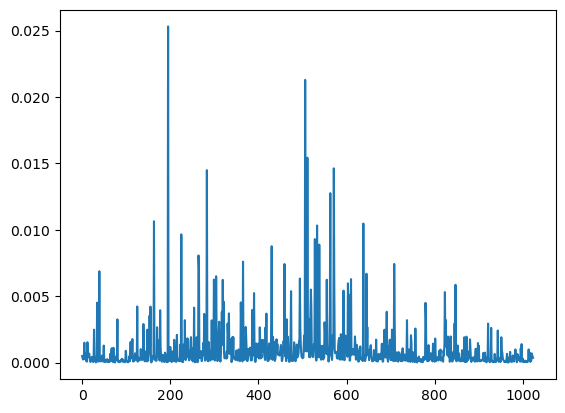

--------------------
379   1   0.018052366317138618   -0.2848153
Reference
tensor(5.4323, grad_fn=<SelectBackward0>)


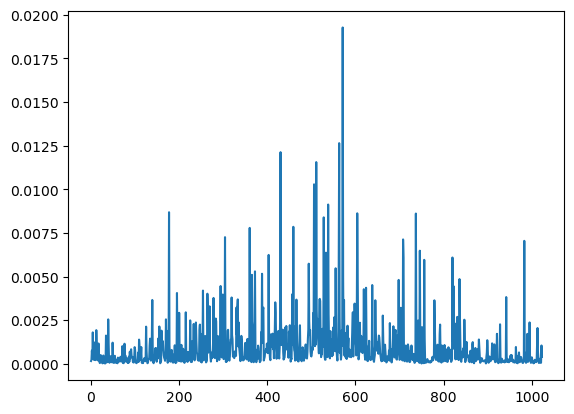

Alt
tensor(5.1475, grad_fn=<SelectBackward0>)


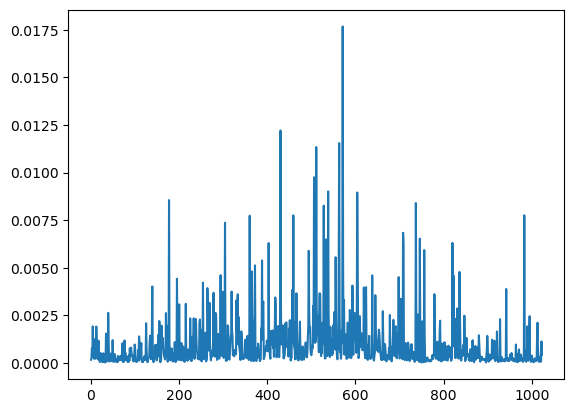

--------------------
379   2   0.011037031368856844   -0.29953146
Reference
tensor(5.2952, grad_fn=<SelectBackward0>)


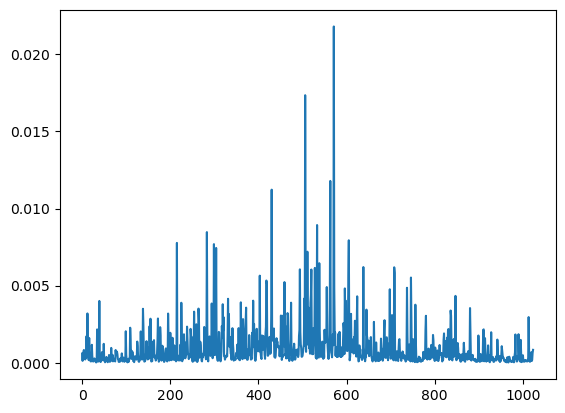

Alt
tensor(4.9956, grad_fn=<SelectBackward0>)


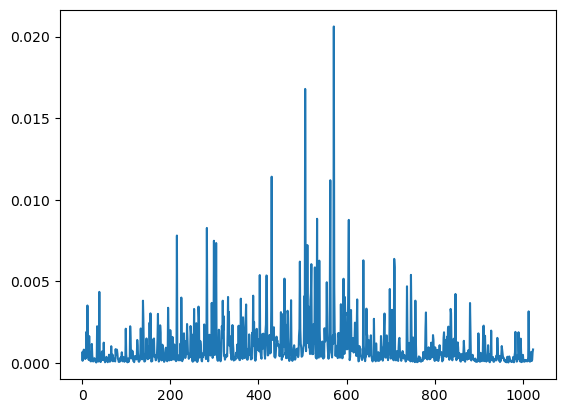

--------------------
379   3   0.010220219704567284   -0.3137765
Reference
tensor(5.5638, grad_fn=<SelectBackward0>)


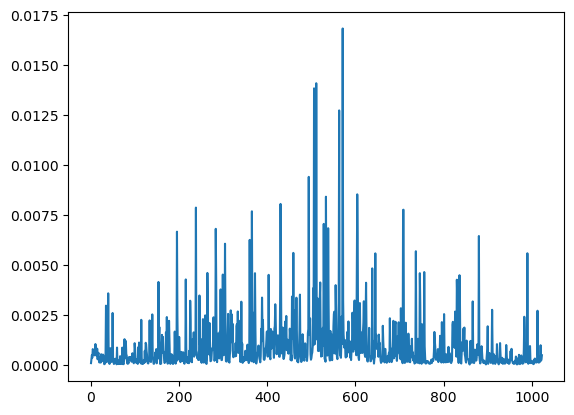

Alt
tensor(5.2501, grad_fn=<SelectBackward0>)


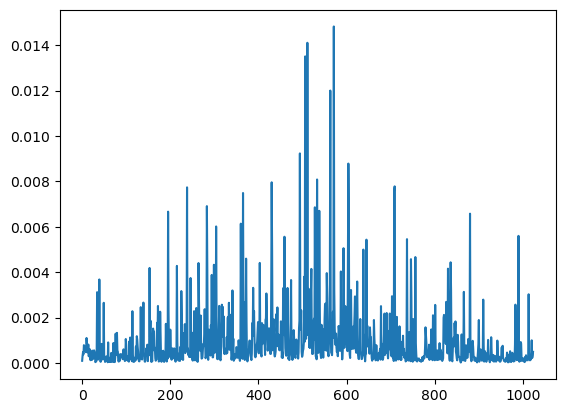

--------------------
387   0   0.0084667959895238   -0.27215672
Reference
tensor(4.3999, grad_fn=<SelectBackward0>)


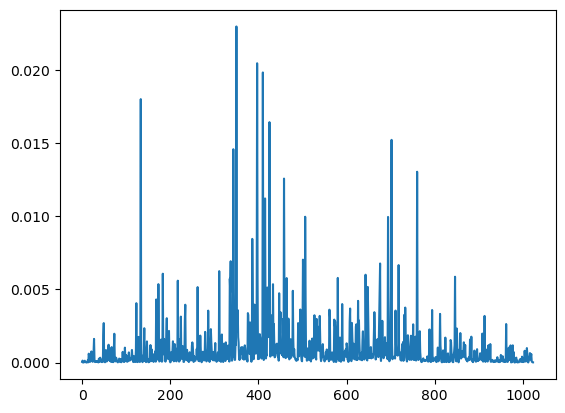

Alt
tensor(4.1277, grad_fn=<SelectBackward0>)


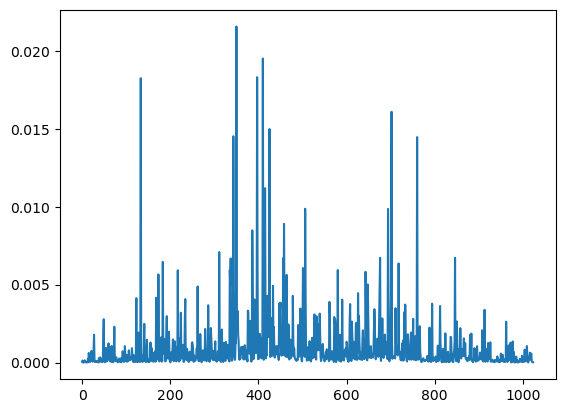

--------------------
387   1   0.007678277769027407   -0.29416943
Reference
tensor(6.5421, grad_fn=<SelectBackward0>)


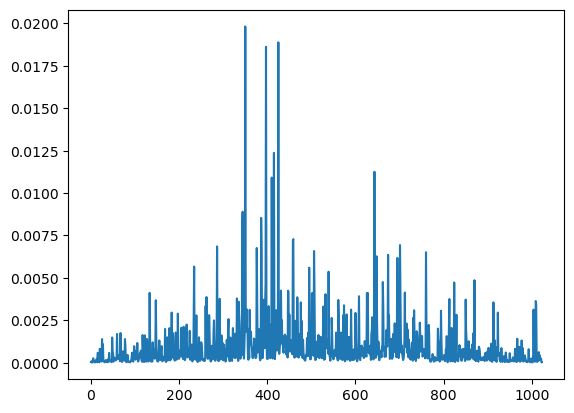

Alt
tensor(6.2479, grad_fn=<SelectBackward0>)


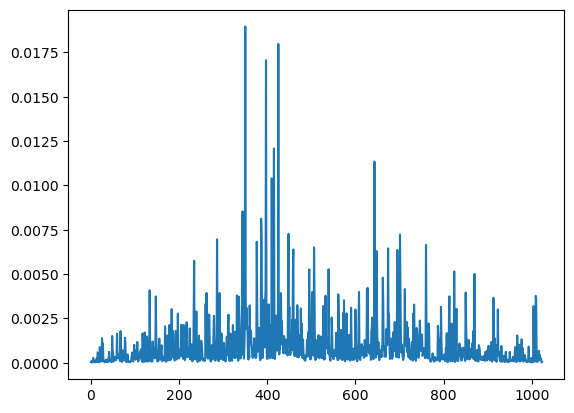

--------------------
387   2   0.005901139705455792   -0.30380106
Reference
tensor(6.3880, grad_fn=<SelectBackward0>)


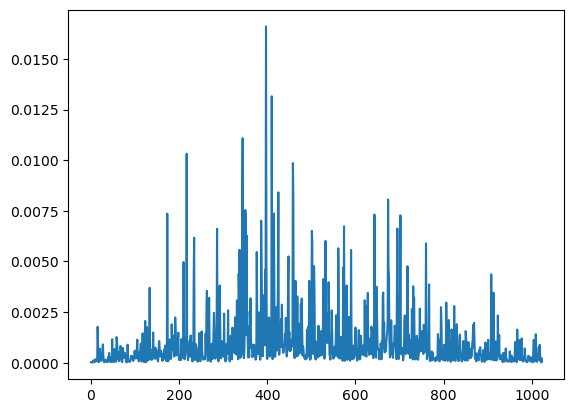

Alt
tensor(6.0842, grad_fn=<SelectBackward0>)


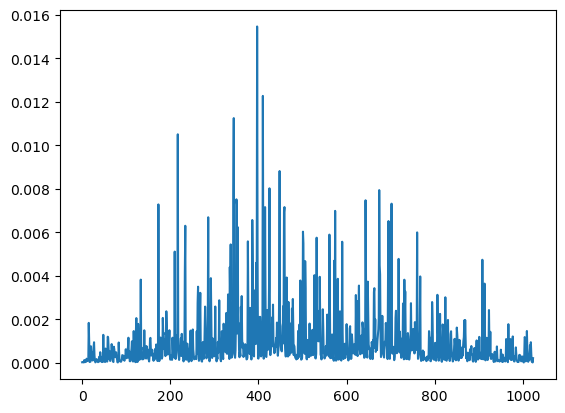

--------------------
387   3   0.013397182038768265   -0.32153034
Reference
tensor(6.5592, grad_fn=<SelectBackward0>)


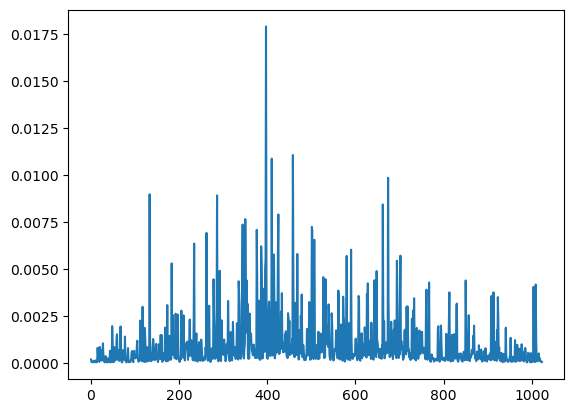

Alt
tensor(6.2376, grad_fn=<SelectBackward0>)


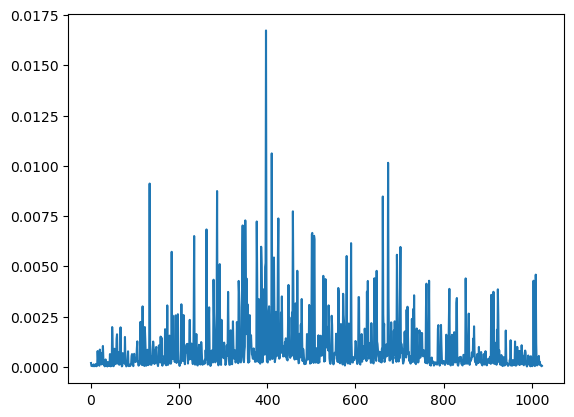

--------------------
403   0   0.0088912238502195   -0.29665565
Reference
tensor(1.4516, grad_fn=<SelectBackward0>)


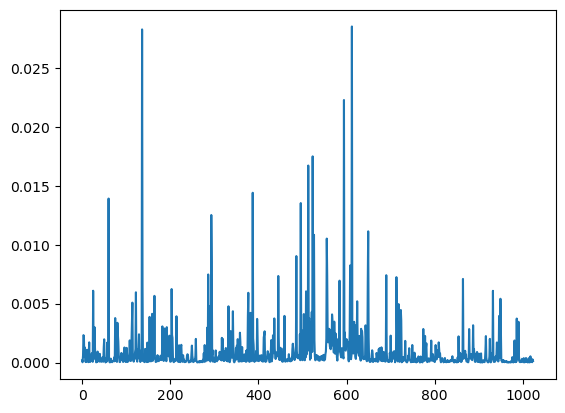

Alt
tensor(1.1550, grad_fn=<SelectBackward0>)


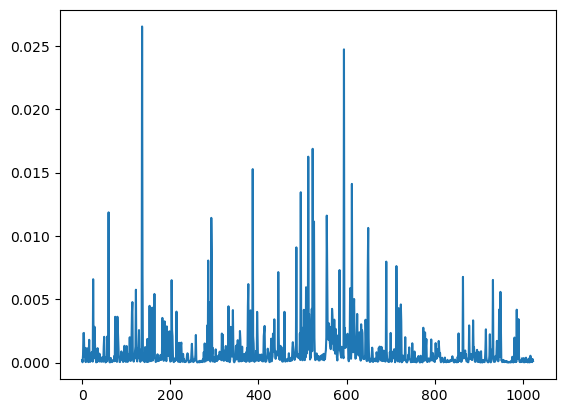

--------------------
403   1   0.012461200116418627   -0.32204247
Reference
tensor(3.4010, grad_fn=<SelectBackward0>)


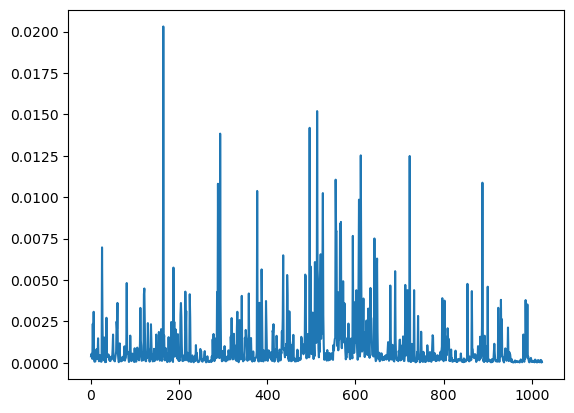

Alt
tensor(3.0790, grad_fn=<SelectBackward0>)


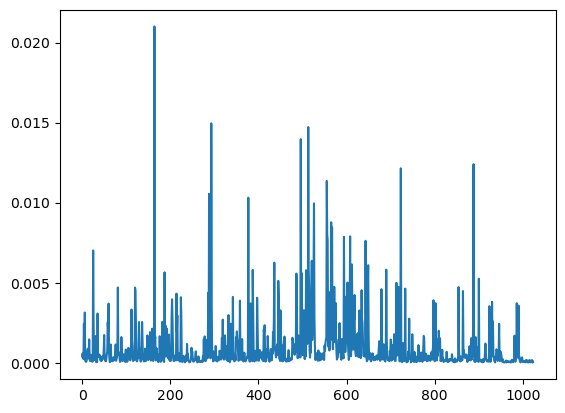

--------------------
403   2   0.005657832649408937   -0.31560564
Reference
tensor(3.3168, grad_fn=<SelectBackward0>)


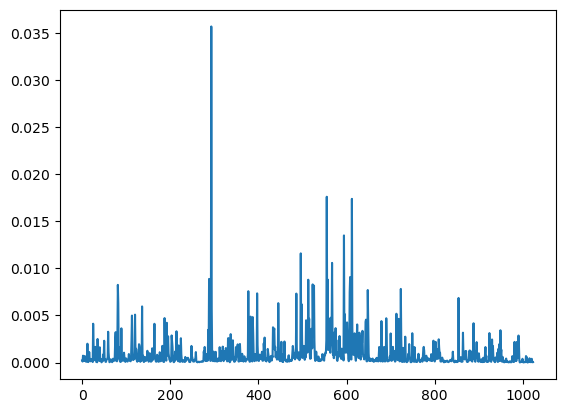

Alt
tensor(3.0012, grad_fn=<SelectBackward0>)


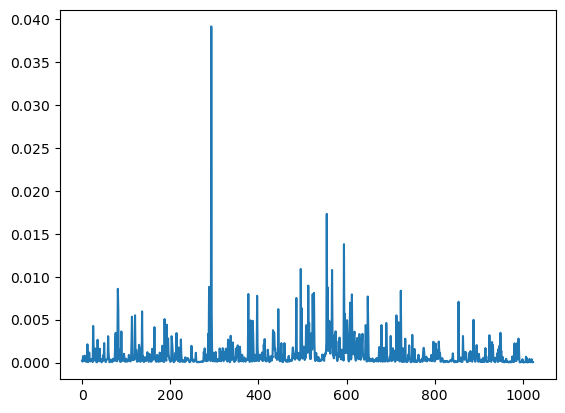

--------------------
403   3   0.013646766904267863   -0.3378725
Reference
tensor(3.4168, grad_fn=<SelectBackward0>)


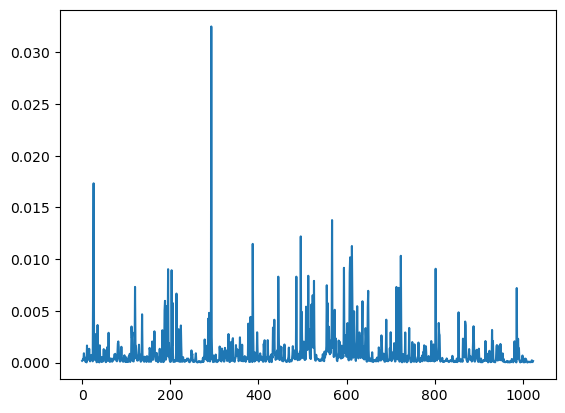

Alt
tensor(3.0790, grad_fn=<SelectBackward0>)


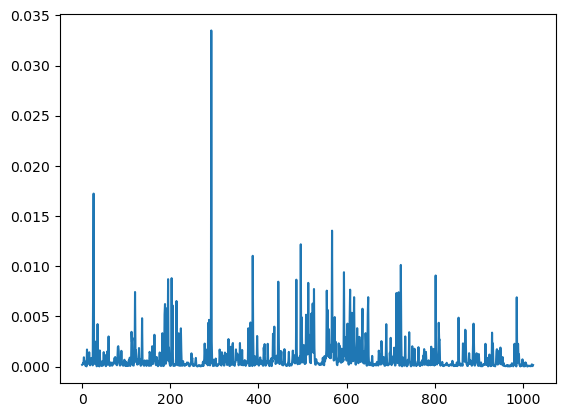

--------------------
412   0   0.018091390706283916   0.27411413
Reference
tensor(4.9244, grad_fn=<SelectBackward0>)


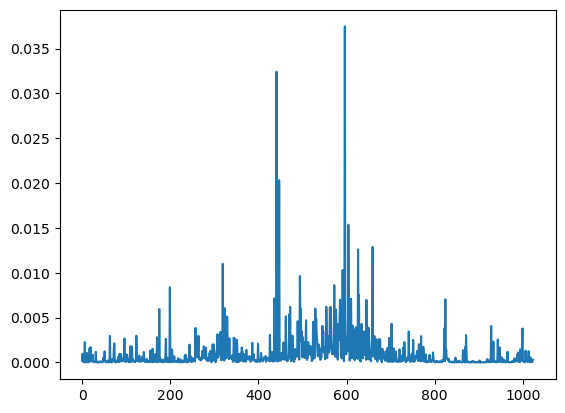

Alt
tensor(5.1985, grad_fn=<SelectBackward0>)


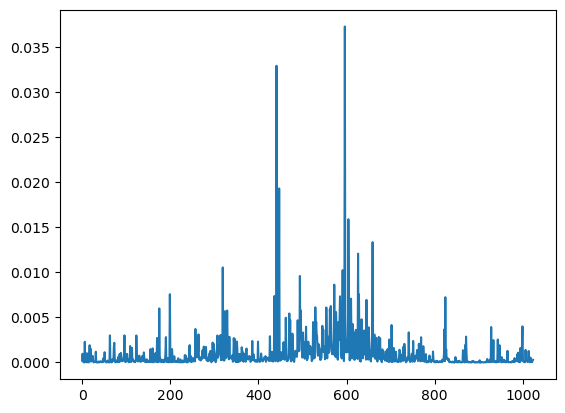

--------------------
412   1   0.01912025516062178   0.28121185
Reference
tensor(7.3341, grad_fn=<SelectBackward0>)


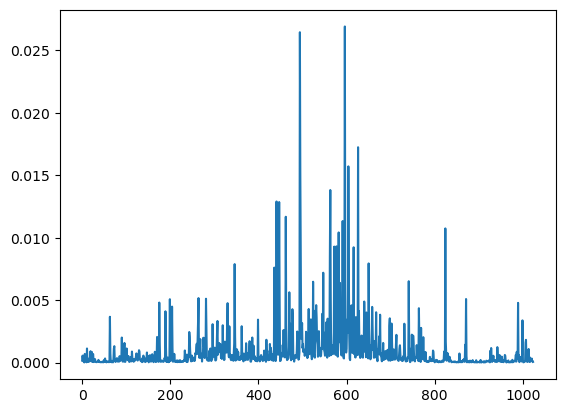

Alt
tensor(7.6153, grad_fn=<SelectBackward0>)


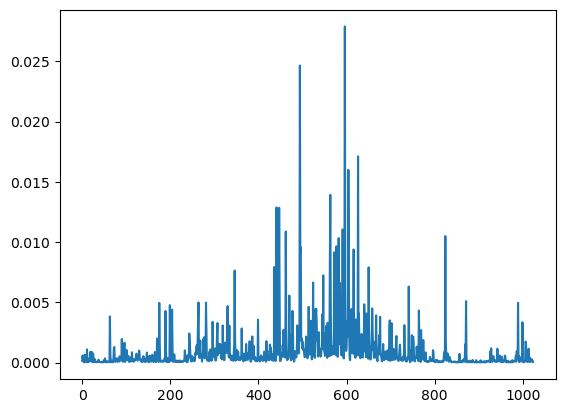

--------------------
412   2   0.009310119386275325   0.2864418
Reference
tensor(7.0138, grad_fn=<SelectBackward0>)


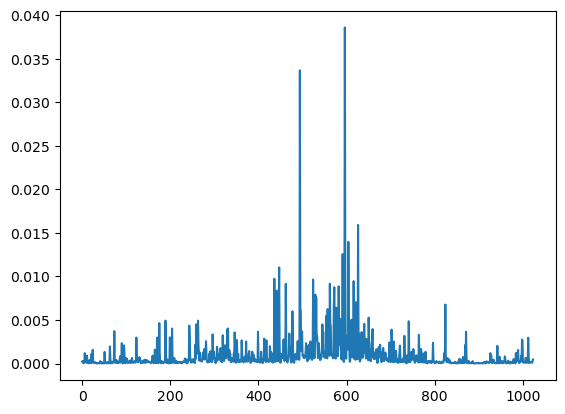

Alt
tensor(7.3003, grad_fn=<SelectBackward0>)


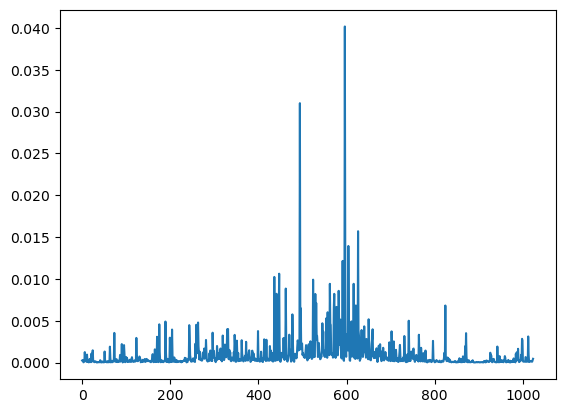

--------------------
412   3   0.002250674619510721   0.30262566
Reference
tensor(7.2718, grad_fn=<SelectBackward0>)


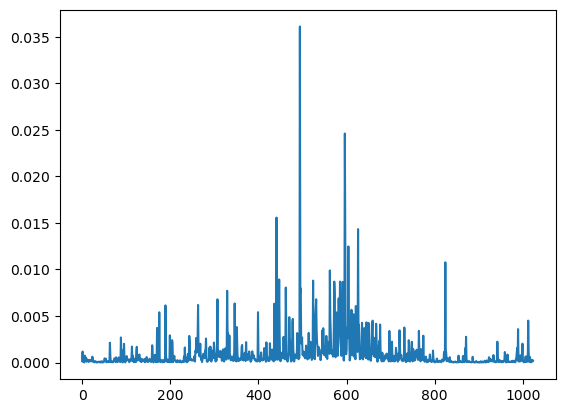

Alt
tensor(7.5744, grad_fn=<SelectBackward0>)


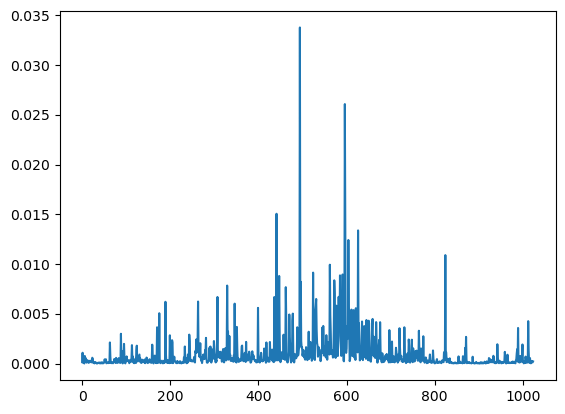

--------------------
419   0   0.03690646878100124   -0.25958776
Reference
tensor(4.6843, grad_fn=<SelectBackward0>)


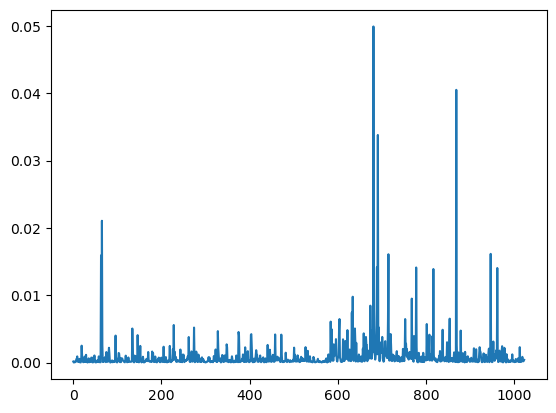

Alt
tensor(4.4247, grad_fn=<SelectBackward0>)


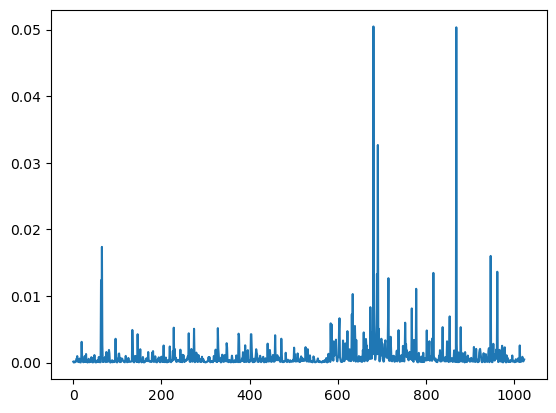

--------------------
419   1   0.03611058763079769   -0.2687378
Reference
tensor(6.8895, grad_fn=<SelectBackward0>)


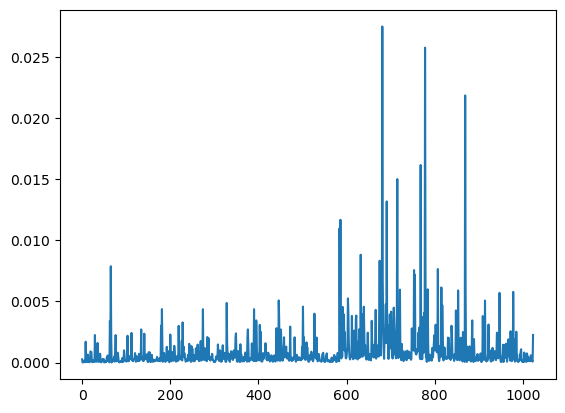

Alt
tensor(6.6208, grad_fn=<SelectBackward0>)


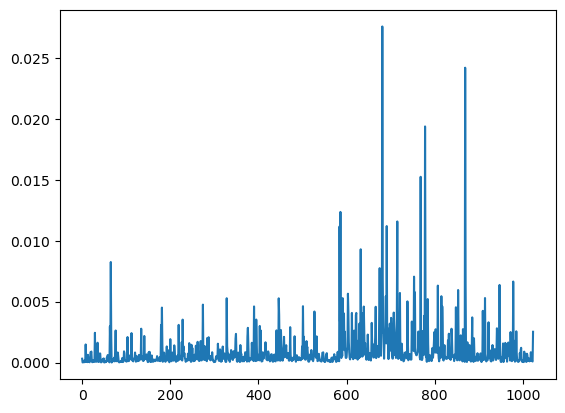

--------------------
419   2   0.03379556890918892   -0.28468943
Reference
tensor(6.8831, grad_fn=<SelectBackward0>)


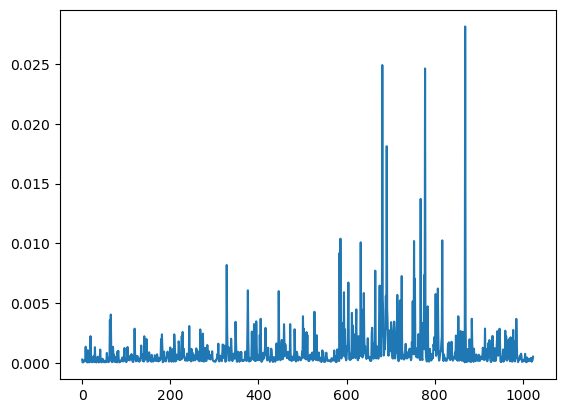

Alt
tensor(6.5984, grad_fn=<SelectBackward0>)


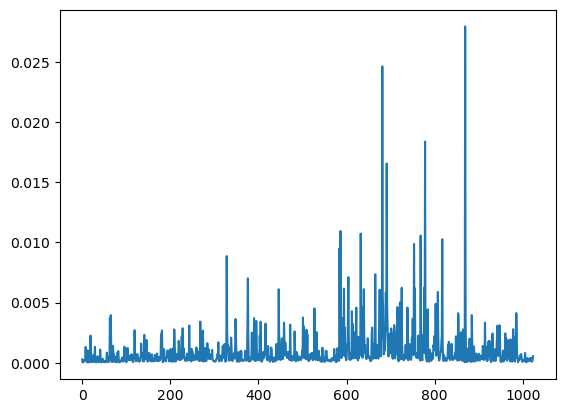

--------------------
419   3   0.021811642387070913   -0.30308628
Reference
tensor(7.0532, grad_fn=<SelectBackward0>)


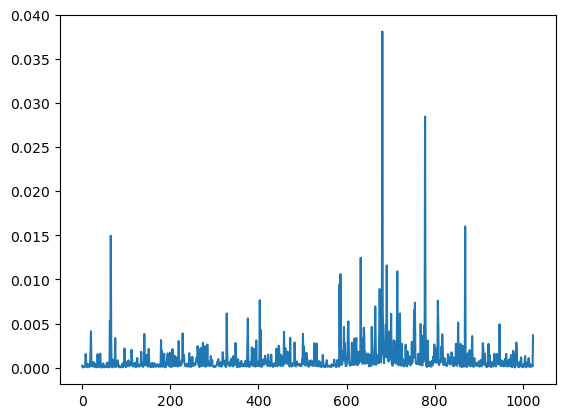

Alt
tensor(6.7501, grad_fn=<SelectBackward0>)


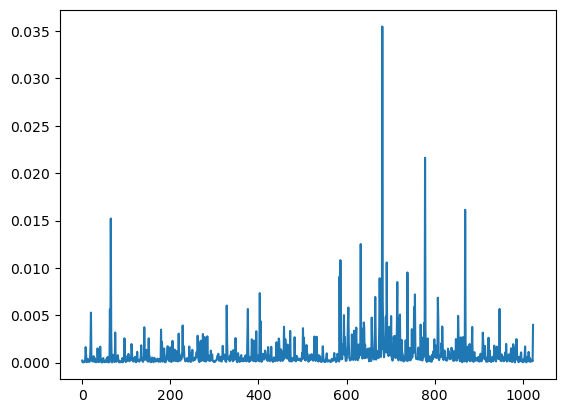

--------------------
432   0   0.07366570413499703   -1.1829715
Reference
tensor(3.3525, grad_fn=<SelectBackward0>)


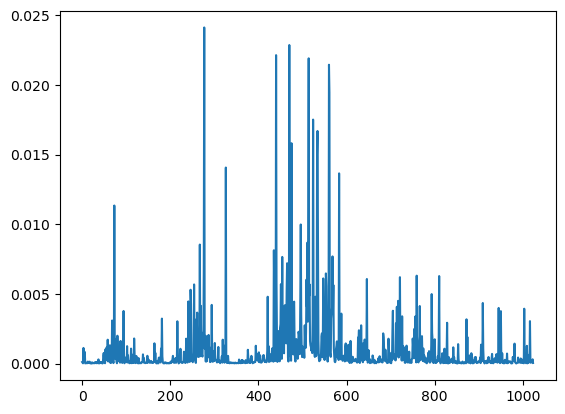

Alt
tensor(2.1695, grad_fn=<SelectBackward0>)


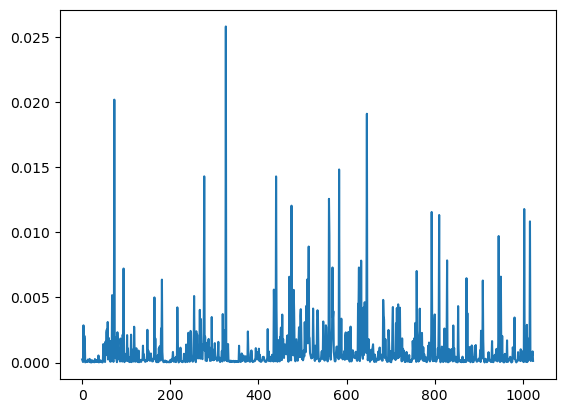

--------------------
432   1   0.06226797173049212   -1.357285
Reference
tensor(5.6418, grad_fn=<SelectBackward0>)


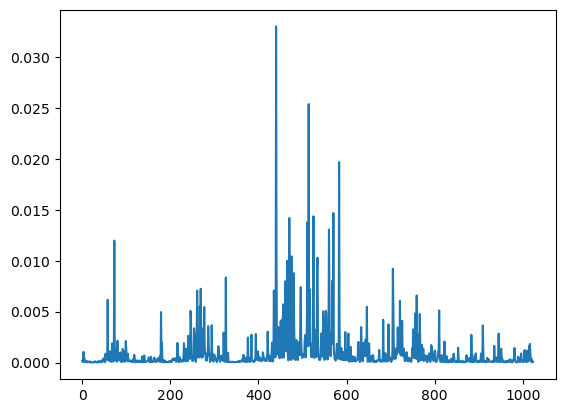

Alt
tensor(4.2845, grad_fn=<SelectBackward0>)


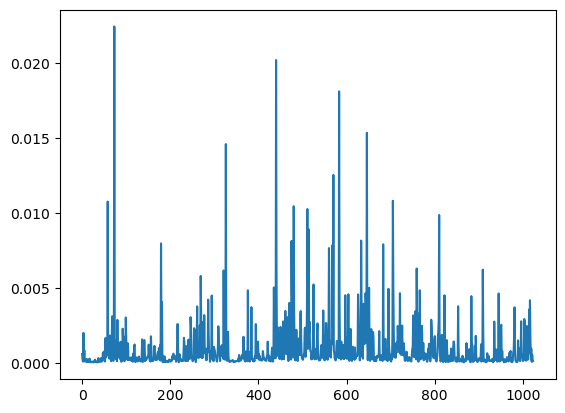

--------------------
432   2   0.05058325167562418   -1.2521954
Reference
tensor(5.3505, grad_fn=<SelectBackward0>)


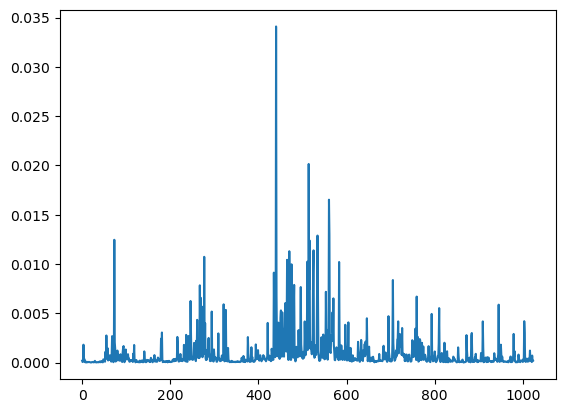

Alt
tensor(4.0983, grad_fn=<SelectBackward0>)


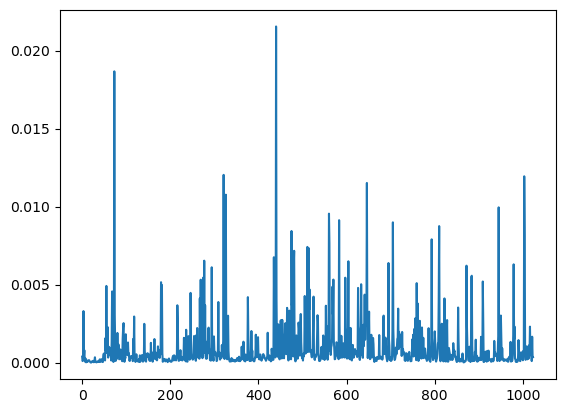

--------------------
432   3   0.046496537364518635   -1.2643209
Reference
tensor(5.5841, grad_fn=<SelectBackward0>)


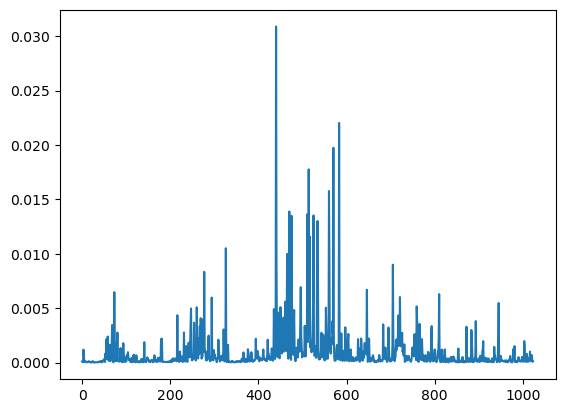

Alt
tensor(4.3197, grad_fn=<SelectBackward0>)


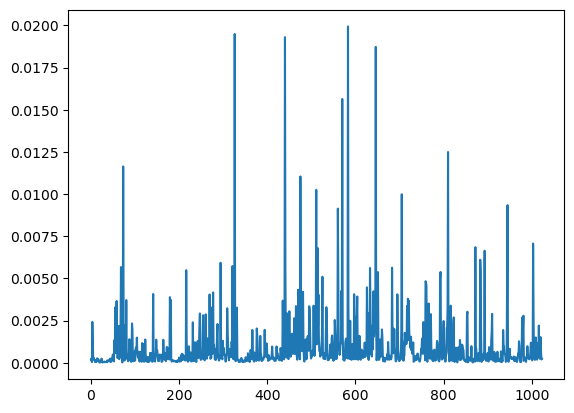

--------------------
443   0   0.015009483751716703   0.7144394
Reference
tensor(5.7191, grad_fn=<SelectBackward0>)


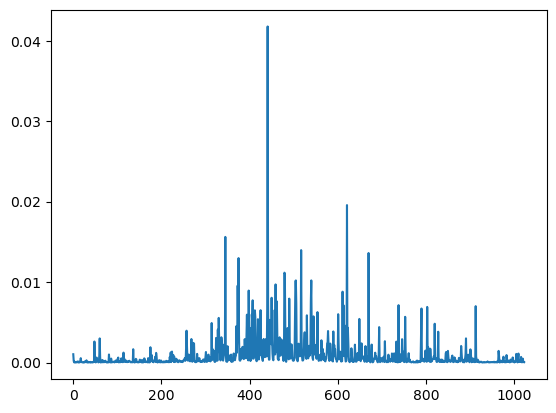

Alt
tensor(6.4336, grad_fn=<SelectBackward0>)


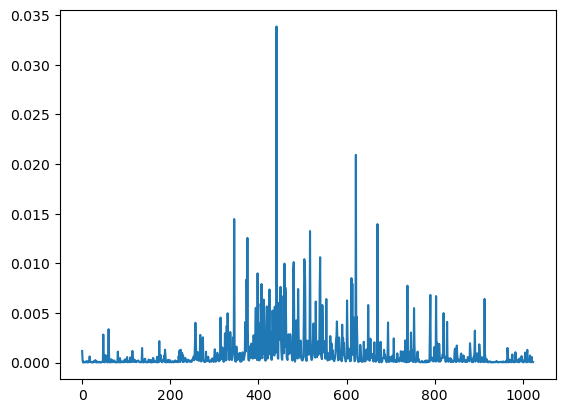

--------------------
443   1   0.006375476504088056   0.7746086
Reference
tensor(8.0843, grad_fn=<SelectBackward0>)


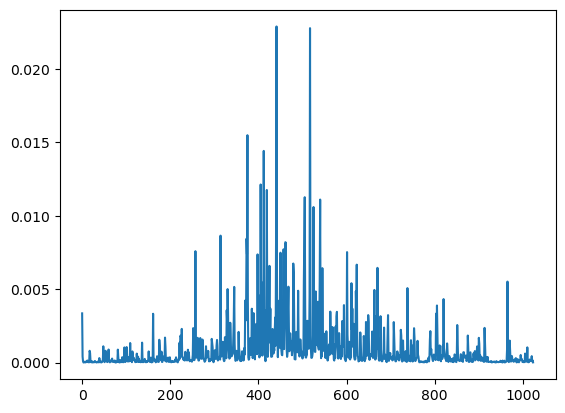

Alt
tensor(8.8589, grad_fn=<SelectBackward0>)


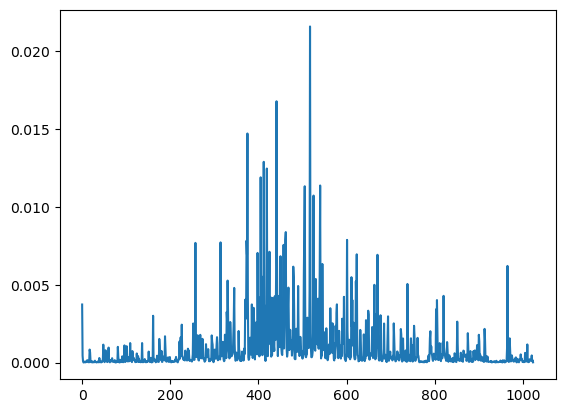

--------------------
443   2   0.01948841882253028   0.78430843
Reference
tensor(8.0047, grad_fn=<SelectBackward0>)


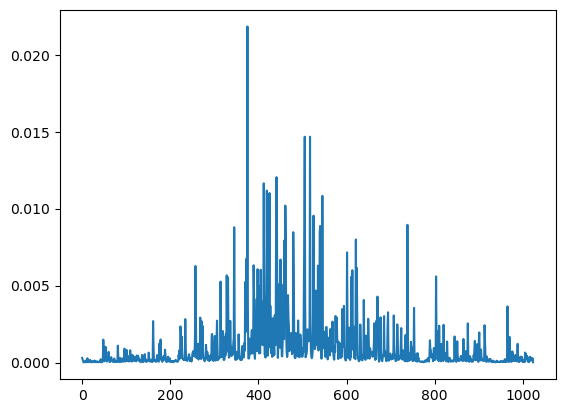

Alt
tensor(8.7890, grad_fn=<SelectBackward0>)


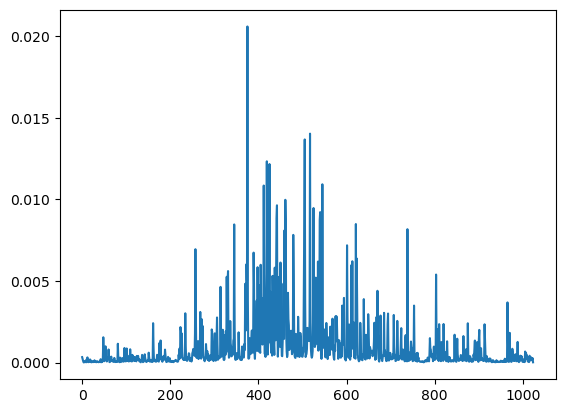

--------------------
443   3   0.003994660197975801   0.8298874
Reference
tensor(8.1531, grad_fn=<SelectBackward0>)


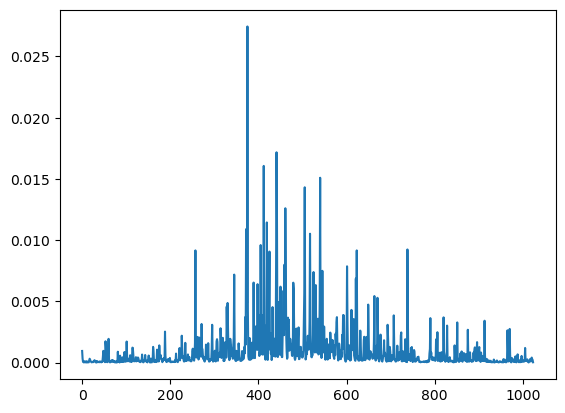

Alt
tensor(8.9829, grad_fn=<SelectBackward0>)


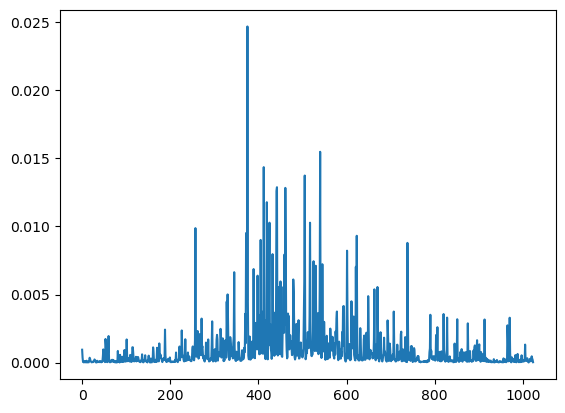

--------------------
451   1   0.006952978290660273   0.25027466
Reference
tensor(4.2982, grad_fn=<SelectBackward0>)


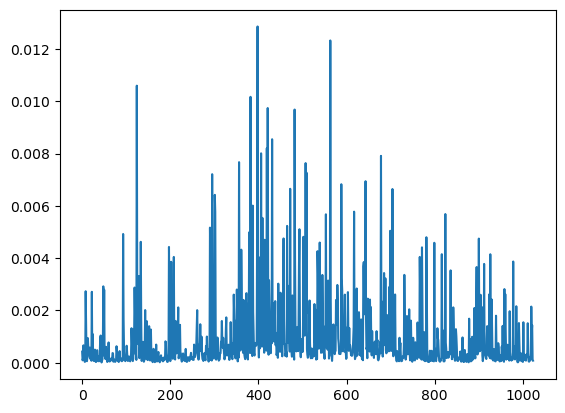

Alt
tensor(4.5484, grad_fn=<SelectBackward0>)


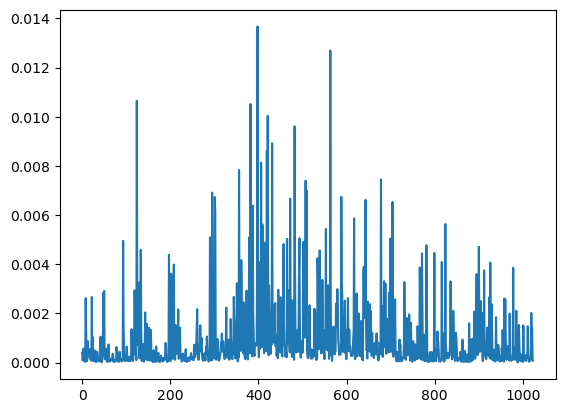

--------------------
451   2   0.006884758184983583   0.27311373
Reference
tensor(4.2295, grad_fn=<SelectBackward0>)


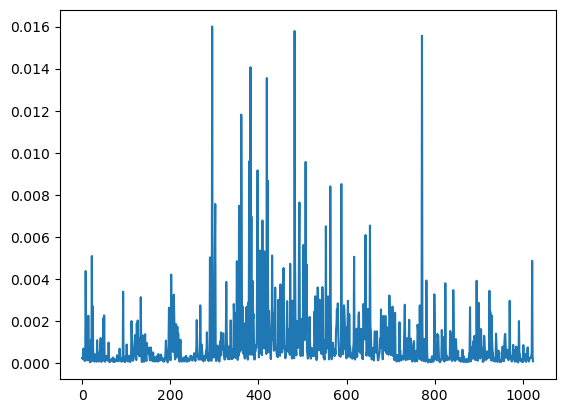

Alt
tensor(4.5026, grad_fn=<SelectBackward0>)


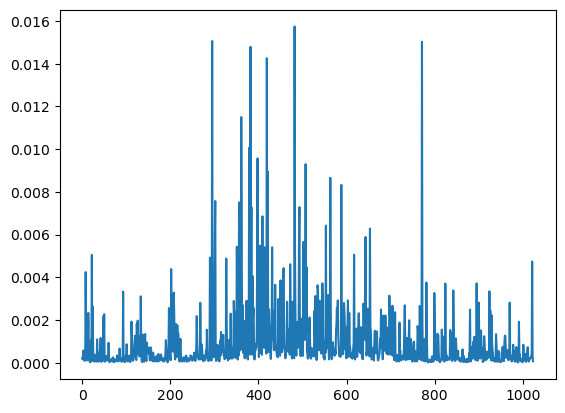

--------------------
451   3   0.0062607259653464685   0.2815833
Reference
tensor(4.3921, grad_fn=<SelectBackward0>)


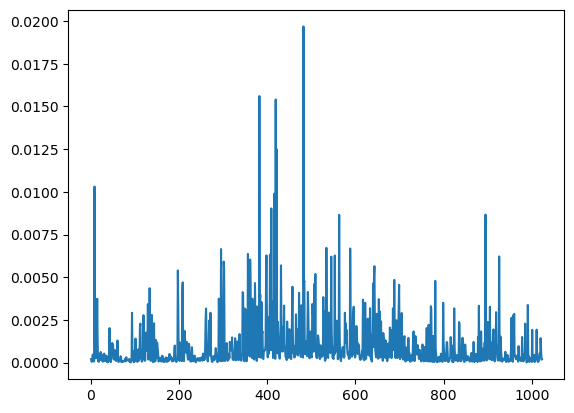

Alt
tensor(4.6737, grad_fn=<SelectBackward0>)


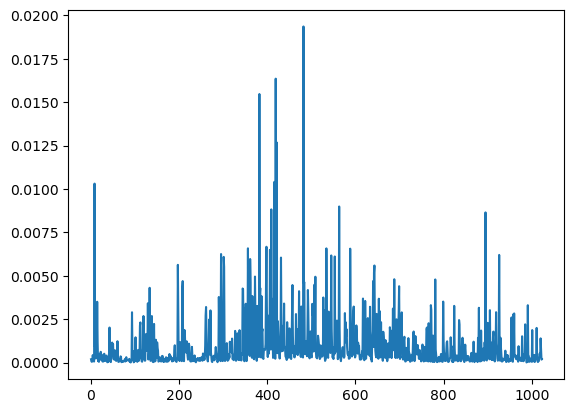

--------------------
453   0   0.008107487300791692   -0.39041424
Reference
tensor(2.5907, grad_fn=<SelectBackward0>)


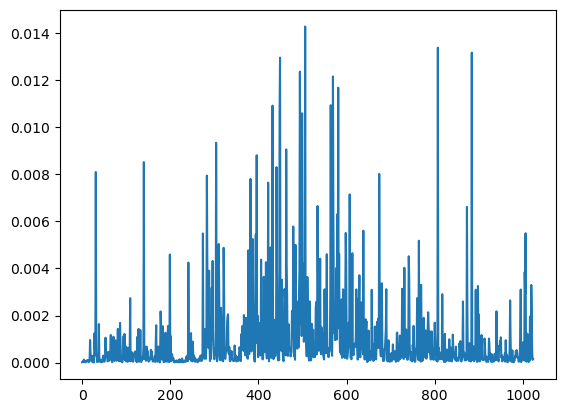

Alt
tensor(2.2003, grad_fn=<SelectBackward0>)


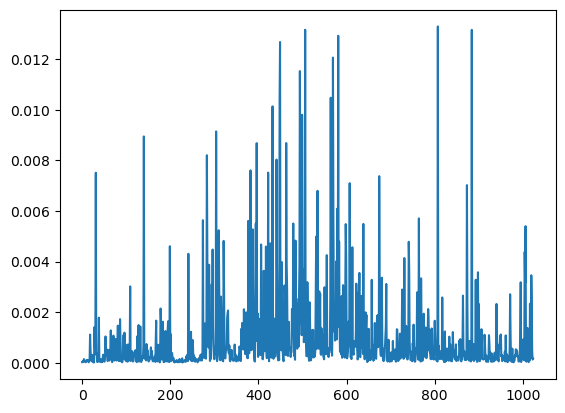

--------------------
453   1   0.007904222111010224   -0.43661213
Reference
tensor(4.6289, grad_fn=<SelectBackward0>)


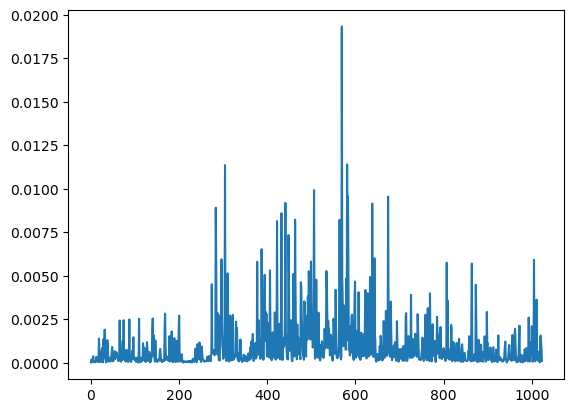

Alt
tensor(4.1923, grad_fn=<SelectBackward0>)


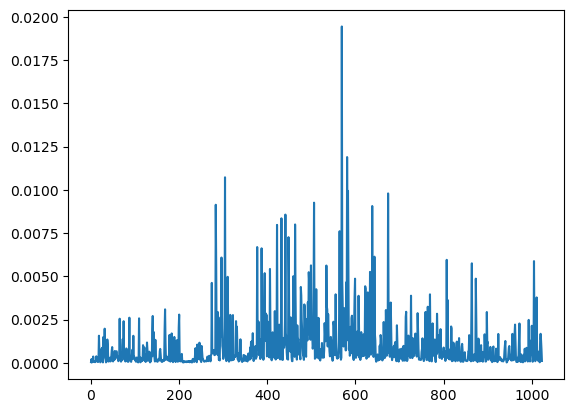

--------------------
453   2   0.00498414686837149   -0.44623137
Reference
tensor(4.4892, grad_fn=<SelectBackward0>)


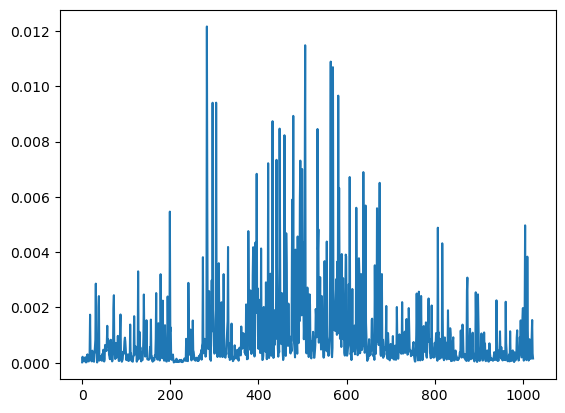

Alt
tensor(4.0429, grad_fn=<SelectBackward0>)


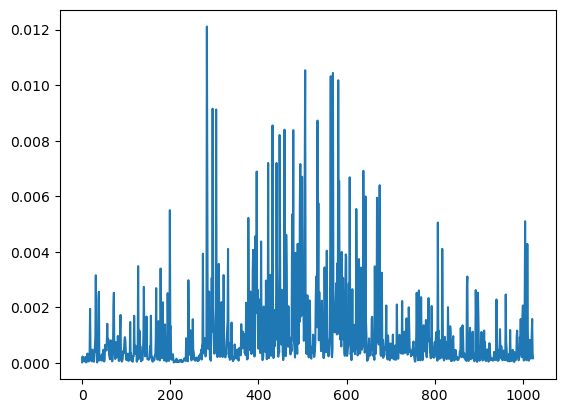

--------------------
453   3   0.00865402014852649   -0.47350836
Reference
tensor(4.6416, grad_fn=<SelectBackward0>)


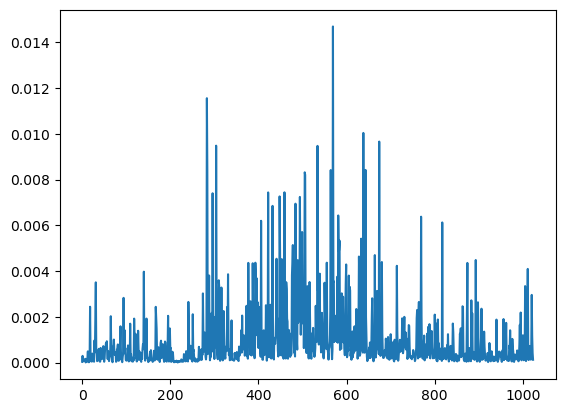

Alt
tensor(4.1681, grad_fn=<SelectBackward0>)


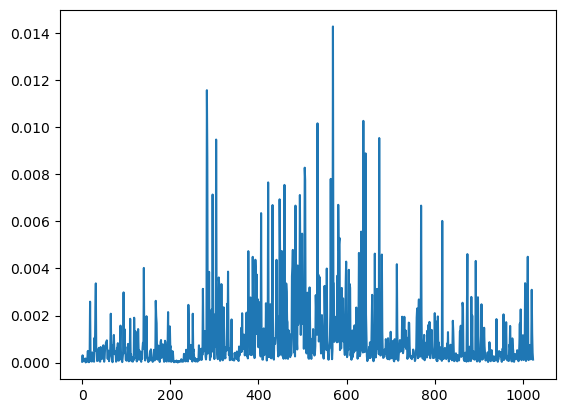

--------------------
476   0   0.022289544775873294   0.25208664
Reference
tensor(4.0713, grad_fn=<SelectBackward0>)


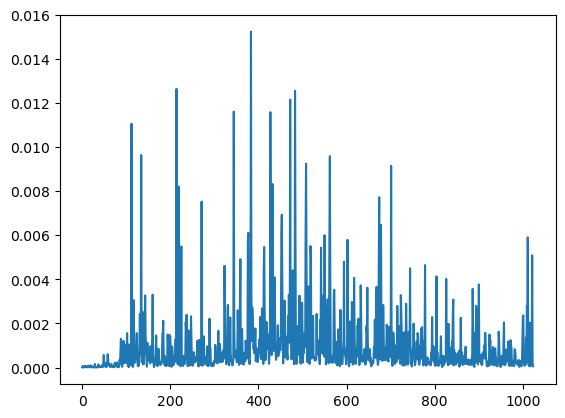

Alt
tensor(4.3234, grad_fn=<SelectBackward0>)


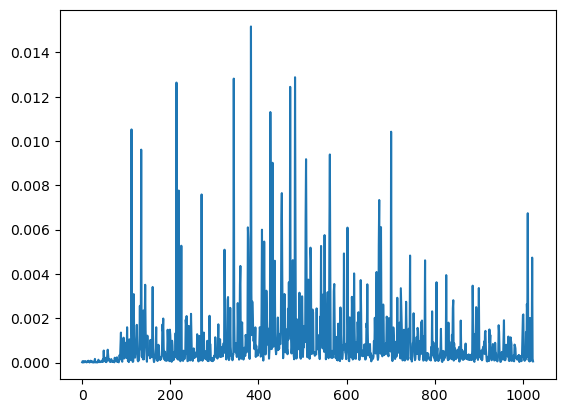

--------------------
476   1   0.018786652449097718   0.2759514
Reference
tensor(6.4559, grad_fn=<SelectBackward0>)


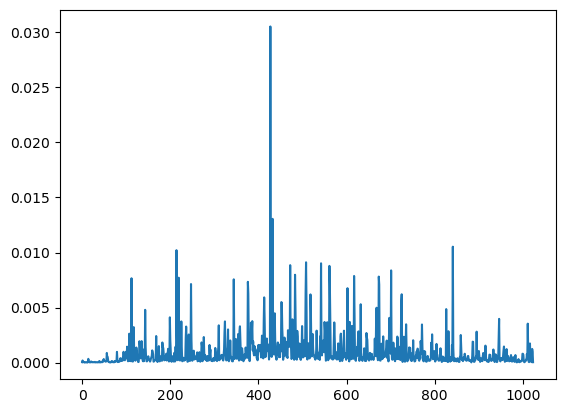

Alt
tensor(6.7318, grad_fn=<SelectBackward0>)


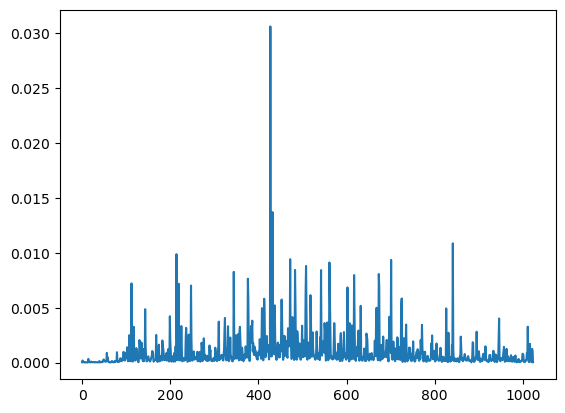

--------------------
476   2   0.011402844163852833   0.2894473
Reference
tensor(6.3115, grad_fn=<SelectBackward0>)


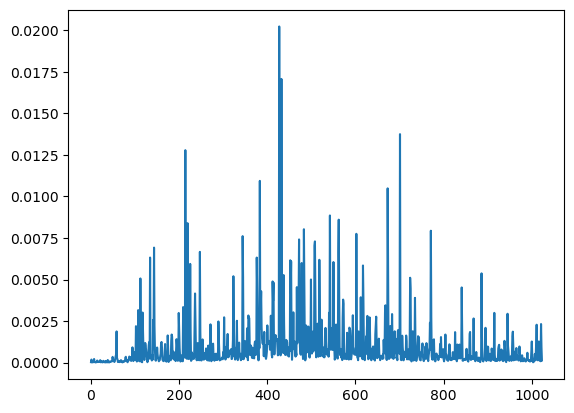

Alt
tensor(6.6009, grad_fn=<SelectBackward0>)


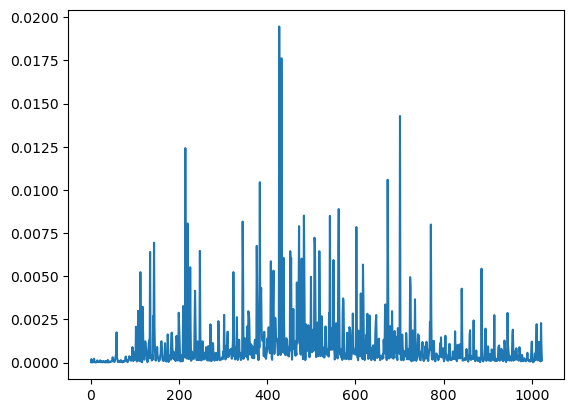

--------------------
476   3   0.005067641183467725   0.3024311
Reference
tensor(6.4343, grad_fn=<SelectBackward0>)


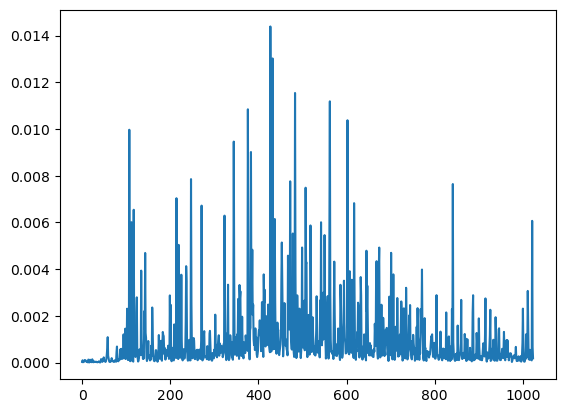

Alt
tensor(6.7367, grad_fn=<SelectBackward0>)


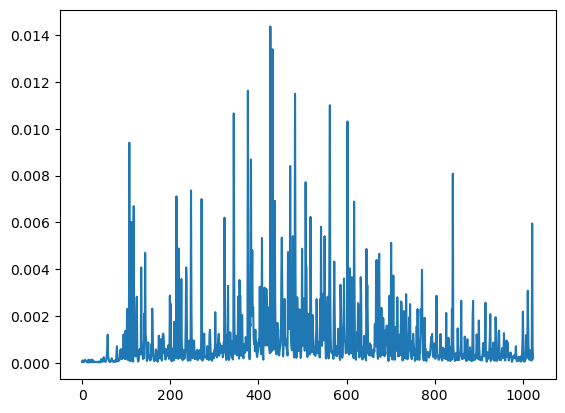

--------------------
486   1   0.005201792583607897   -0.25613117
Reference
tensor(7.7590, grad_fn=<SelectBackward0>)


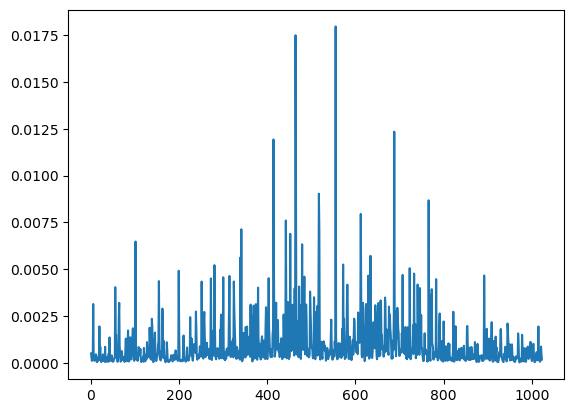

Alt
tensor(7.5029, grad_fn=<SelectBackward0>)


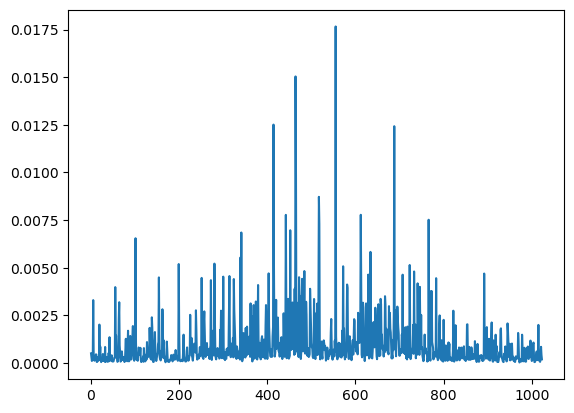

--------------------
486   2   0.012028927900196117   -0.26668262
Reference
tensor(7.6010, grad_fn=<SelectBackward0>)


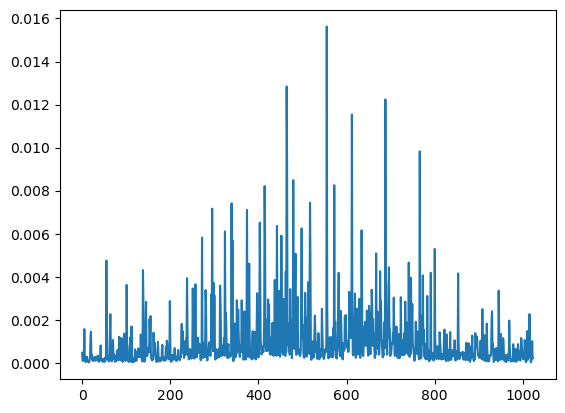

Alt
tensor(7.3343, grad_fn=<SelectBackward0>)


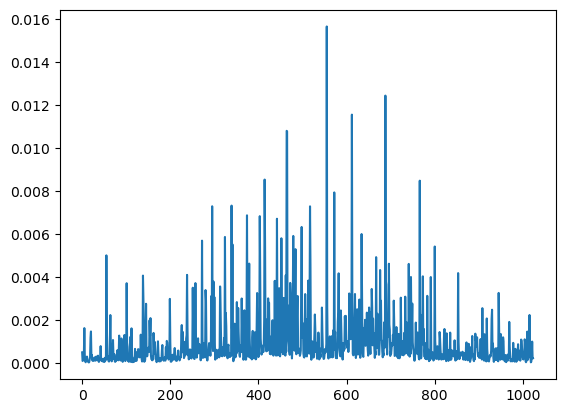

--------------------
486   3   0.011518420121206135   -0.28461933
Reference
tensor(7.8301, grad_fn=<SelectBackward0>)


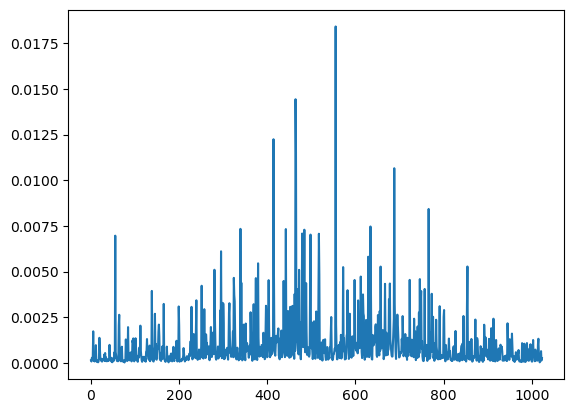

Alt
tensor(7.5455, grad_fn=<SelectBackward0>)


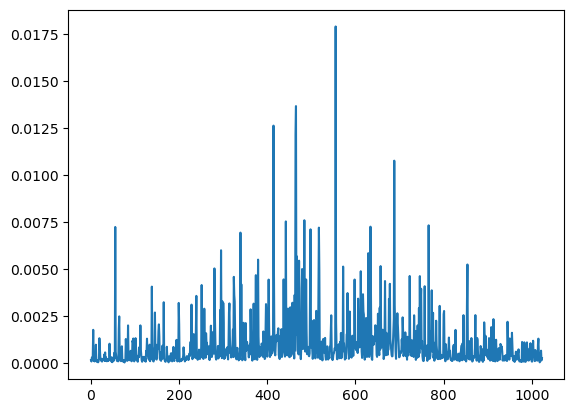

--------------------
523   1   0.25952403945598107   -0.25079584
Reference
tensor(4.2423, grad_fn=<SelectBackward0>)


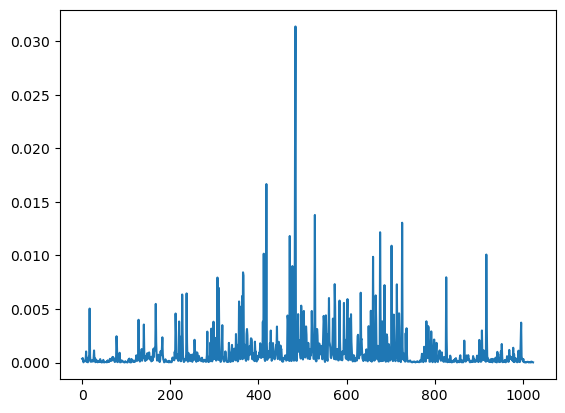

Alt
tensor(3.9915, grad_fn=<SelectBackward0>)


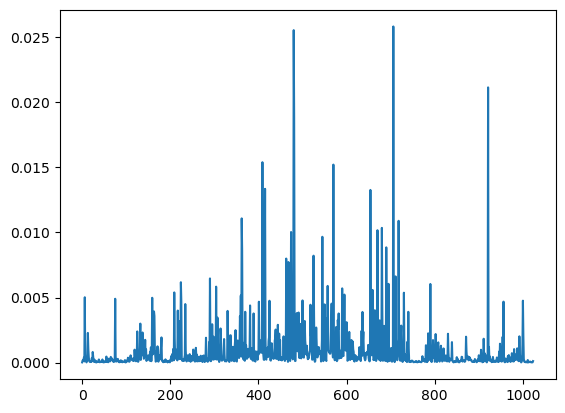

--------------------
523   2   0.15574271585428914   -0.26161146
Reference
tensor(4.1948, grad_fn=<SelectBackward0>)


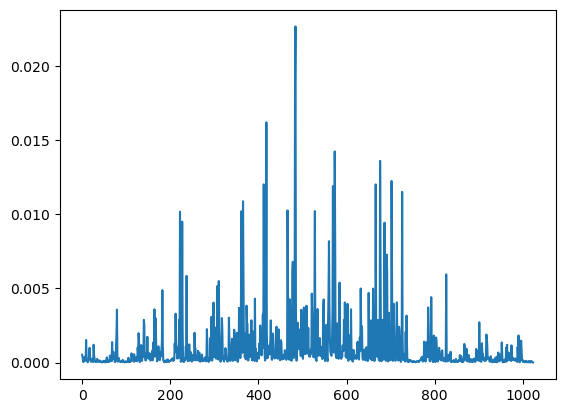

Alt
tensor(3.9332, grad_fn=<SelectBackward0>)


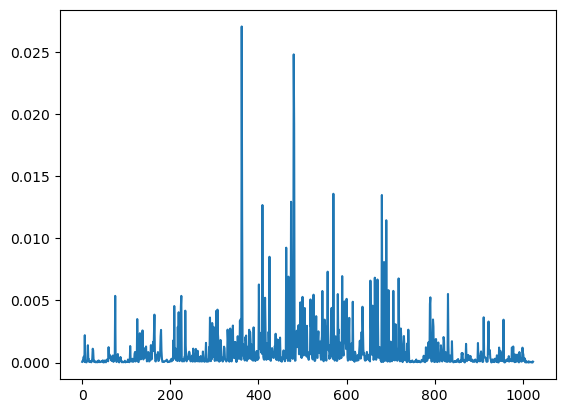

--------------------
523   3   0.19745595644621539   -0.26683426
Reference
tensor(4.2546, grad_fn=<SelectBackward0>)


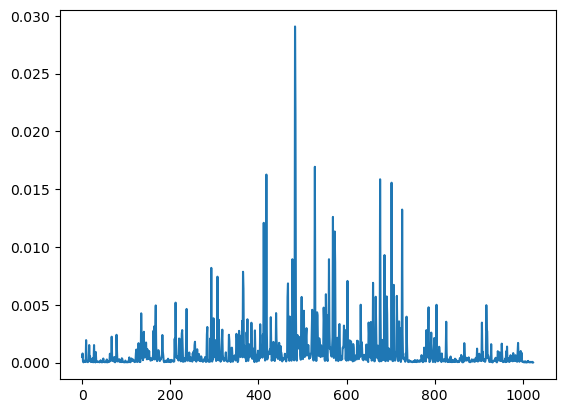

Alt
tensor(3.9878, grad_fn=<SelectBackward0>)


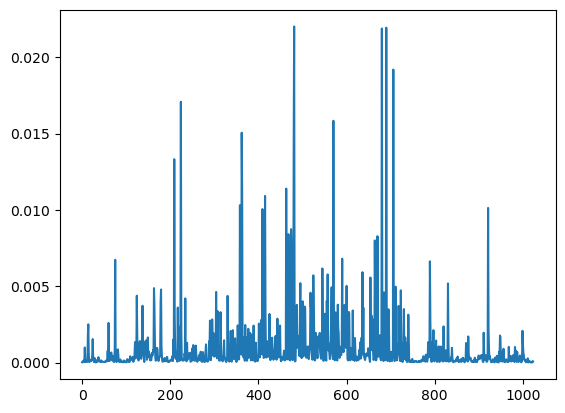

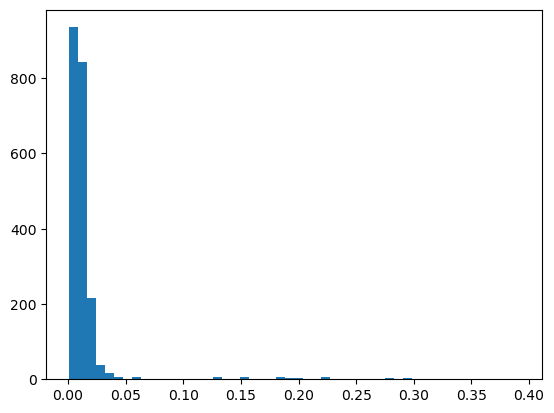

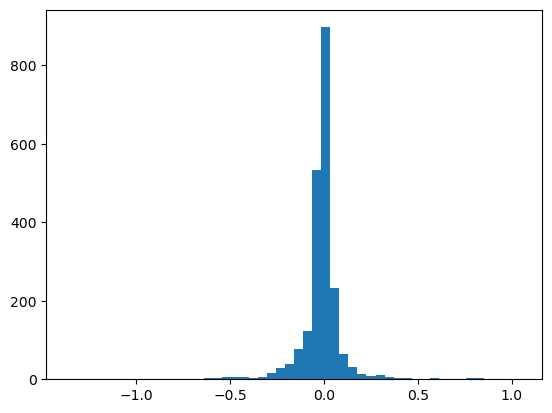

In [121]:

i, t = 50, 3
jsds, diffs, which_seq = [], [], []
for i in range (count.size(0)):
    for t in range(4):
        jsd = distance.jensenshannon(profile[i,t,:], alt_profile[i,t,:])
        jsds.append(jsd)

        diff =  alt_count[i,t].detach().numpy() - count[i,t].detach().numpy()
        diffs.append(diff)

        if abs(diff) > 0.25:
            print("--------------------")
            print(i, " ", t, " ", jsd, " ", diff)
            print("Reference")
            print(count[i,t])
            plt.plot(np.arange(0,1024),profile[i,:,t])
            plt.show()

            print("Alt")
            print(alt_count[i,t])
            plt.plot(np.arange(0,1024),alt_profile[i,:,t])
            plt.show()

            which_seq.append(i)

plt.hist(jsds, bins=50)
plt.show()
plt.hist(diffs, bins=50)
plt.show()

which_seq = np.unique(which_seq)

In [161]:
import pandas as pd
import math

#Intersection between variants in active enhancers regions and peak set of dataset
#---------------------------------

#Create peak set bed file
with open('../results/peaks_seq.pkl', 'rb') as file:
    peaks = pickle.load(file)

peaks = peaks[peaks.chr.str.isnumeric()].iloc[:,:3]

peaks.to_csv('../results/peaks_set.bed', header=False, index=False, sep='\t')

#Intersect the variants in active enhancer with the peak set 
#Change here the file with variants
""" cmd_bed = "bedtools intersect -a ../results/peaks_set.bed -b ../data/vars_in_acitive_enchancers.bed -wa -wb > ../results/aevp_pverlap.bed"
subprocess.run(cmd_bed, shell=True)
 """
active_enhancer = pd.read_csv("../results/mutations/aevp_pverlap.bed", header=None, sep='\t', names=["chr_peak", "start_peak", "end_peak", "chr_var", "pos_var", "end_var"])

#Add sequence of peak
with open('../results/peaks_seq.pkl', 'rb') as file:
    peaks = pickle.load(file)
active_enhancer.index = active_enhancer.chr_peak.astype(str) + ":" + active_enhancer.start_peak.astype(str) + "-" + active_enhancer.end_peak.astype(str)
active_enhancer["sequence"] = peaks.loc[active_enhancer.index].sequence
active_enhancer["middle"] = peaks.loc[active_enhancer.index].middle_peak

### Get reference sequenece and mutated sequences for overlapping variants
#---------------------------------

variants = pd.DataFrame(pd.read_csv("../data/Muscle_Skeletal.var.txt", sep='\t').variant_id)
variants = variants['variant_id'].str.split('_')

variants = pd.DataFrame(variants.tolist(), index= variants.index, columns=['chr_var','pos_var', 'ref', 'alt', '_']).iloc[:,:-1]
variants.chr_var = [idx[3:] for idx in variants.chr_var]
variants.index = variants.chr_var.astype(str) + ":" + variants.pos_var.astype(str)

#Join both dataset 
active_enhancer.index = active_enhancer.chr_var.astype(str) + ":" + active_enhancer.pos_var.astype(str)

variants = variants.loc[active_enhancer.index]
variants.chr_var = variants.chr_var.astype('int64'); variants.pos_var = variants.pos_var.astype('int64')

active_enhancer = pd.merge(variants, active_enhancer)
active_enhancer.index = active_enhancer.chr_var.astype(str) + ":" + active_enhancer.pos_var.astype(str) + "_" + active_enhancer.ref.astype(str) + "_" + active_enhancer.alt.astype(str)
active_enhancer = active_enhancer[~active_enhancer.index.duplicated(keep='first')]

#Create alt sequences
active_enhancer['dist_var_middle'] = active_enhancer.pos_var - active_enhancer.middle 
active_enhancer['var_pos_seq'] = 2048 + active_enhancer.dist_var_middle -1 

#check ref match to sequence
active_enhancer['nucleotide_var'] = [x[active_enhancer.var_pos_seq[i]] for i,x in enumerate(active_enhancer.sequence)]

#Is there an obvious motifs at these position?
active_enhancer['around_var'] = [x[active_enhancer.var_pos_seq[i]-6:active_enhancer.var_pos_seq[i]+6] for i,x in enumerate(active_enhancer.sequence)]

#Create alt sequence
active_enhancer['sequence_alt'] = [x[:active_enhancer.var_pos_seq[i]] + active_enhancer.alt[i] + x[active_enhancer.var_pos_seq[i]+1:] for i,x in enumerate(active_enhancer.sequence)]

#if alt more than one nucleotide, crop sequence alt
active_enhancer['sequence_alt'] = [x[math.floor((len(x)-4096)/2):-math.ceil((len(x)-4096)/2)] if len(x) > 4096 else x for x in active_enhancer.sequence_alt]


/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3291/259411305.py:54: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  active_enhancer['nucleotide_var'] = [x[active_enhancer.var_pos_seq[i]] for i,x in enumerate(active_enhancer.sequence)]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3291/259411305.py:57: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  active_enhancer['around_var'] = [x[active_enhancer.var_pos_seq[i]-6:active_enhancer.var_pos_seq[i]+6] for i,x in enumerate(active_enhancer.sequence)]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3291/259411305.py:60: FutureWarning: Serie

In [162]:
active_enhancer

,chr_var,pos_var,ref,alt,chr_peak,start_peak,end_peak,end_var,sequence,middle,dist_var_middle,var_pos_seq,nucleotide_var,around_var,sequence_alt
1:2179409_T_G,1,2179409,T,G,1,2179151,2180134,2179410,AGCCGGAACTCAAGGAGACCATGAAGCCACCCTTGGCCTCTAGCTG...,2179642,-233,1814,T,CCCCGGTACTTG,AGCCGGAACTCAAGGAGACCATGAAGCCACCCTTGGCCTCTAGCTG...
1:2189679_C_T,1,2189679,C,T,1,2189248,2190165,2189680,ATGAGCAGAAGGTGCAGCCAAGTCCCCATGCCCCTGCCCTGCCCGT...,2189706,-27,2020,C,GGGCGCCGCACT,ATGAGCAGAAGGTGCAGCCAAGTCCCCATGCCCCTGCCCTGCCCGT...
1:9067100_C_A,1,9067100,C,A,1,9066866,9067844,9067101,AAGGCTGACCTTCTGACAGGGTACGATTCAAGGTCACTGGGAAGGA...,9067355,-255,1792,C,CCTCCCCGGACC,AAGGCTGACCTTCTGACAGGGTACGATTCAAGGTCACTGGGAAGGA...
1:9961035_A_G,1,9961035,A,G,1,9960793,9961771,9961036,GGTGGCGGGCGCCTGTAATCCCAGCTACTCAGGAGGCTGAAGCAGA...,9961282,-247,1800,A,AGGTTTAGAGTC,GGTGGCGGGCGCCTGTAATCCCAGCTACTCAGGAGGCTGAAGCAGA...
1:11650839_A_C,1,11650839,A,C,1,11650151,11651118,11650840,GGATGTGTGGCTTGGGGAAGGTGAGGACGCTATGGACTAAGTTAAG...,11650634,205,2252,A,CTCTGCAGGCAG,GGATGTGTGGCTTGGGGAAGGTGAGGACGCTATGGACTAAGTTAAG...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9:129496588_G_T,9,129496588,G,T,9,129496477,129497425,129496589,AATTTTATATTTTTAGTAGAGACGTGGTTTCTCCATGTTGGTCAGG...,129496951,-363,1684,G,CACCGAGGCCAC,AATTTTATATTTTTAGTAGAGACGTGGTTTCTCCATGTTGGTCAGG...
9:133737936_C_T,9,133737936,C,T,9,133737767,133738752,133737937,ACAATCATCAATGCTGCCTCACACTCAGGAGCAGCCCCCCGCCTGG...,133738260,-324,1723,C,GGGCCTCGAGCA,ACAATCATCAATGCTGCCTCACACTCAGGAGCAGCCCCCCGCCTGG...
9:133738081_A_T,9,133738081,A,T,9,133737767,133738752,133738082,ACAATCATCAATGCTGCCTCACACTCAGGAGCAGCCCCCCGCCTGG...,133738260,-179,1868,A,AGCGGCAGGGGG,ACAATCATCAATGCTGCCTCACACTCAGGAGCAGCCCCCCGCCTGG...
9:134369786_C_T,9,134369786,C,T,9,134369499,134370323,134369787,CTCAGCCAGCAGTTTTGTGCTGACCCTGCAGGAACTGCTAATTAAG...,134369911,-125,1922,C,TGGAGGCAGAGG,CTCAGCCAGCAGTTTTGTGCTGACCCTGCAGGAACTGCTAATTAAG...


In [124]:
active_enhancer.iloc[which_seq]

,chr_var,pos_var,ref,alt,chr_peak,start_peak,end_peak,end_var,sequence,middle,dist_var_middle,var_pos_seq,nucleotide_var,around_var,sequence_alt
1:113979061_A_AAAC,1,113979061,A,AAAC,1,113978808,113979762,113979062,TTTTTTTTTTTTAACTGATAGATGGTGCAGCATGTCTACATGGTTG...,113979285,-224,1823,A,GGCTGAAAACCC,TTTTTTTTTTTAACTGATAGATGGTGCAGCATGTCTACATGGTTGT...
11:308059_T_C,11,308059,T,C,11,307640,308565,308060,TATTGCTACGAAGAGTCTGTTTTGTCAGTACTATGAGCTCCATCTC...,308102,-43,2004,T,TTGTTCTGCCCT,TATTGCTACGAAGAGTCTGTTTTGTCAGTACTATGAGCTCCATCTC...
12:54411590_T_C,12,54411590,T,C,12,54411259,54412383,54411591,TAGCCTGACTTATCTCTCCACTACACACATACACATACACACACAC...,54411821,-231,1816,T,GGGTGATTCAGG,TAGCCTGACTTATCTCTCCACTACACACATACACATACACACACAC...
13:21298170_C_G,13,21298170,C,G,13,21297745,21298625,21298171,AGGCTAACAGGAAAAACTGCTGCACCTGGAAACACAGAGAACAAAT...,21298185,-15,2032,C,CGCTGCCTTGGA,AGGCTAACAGGAAAAACTGCTGCACCTGGAAACACAGAGAACAAAT...
13:30906286_T_C,13,30906286,T,C,13,30905801,30906978,30906287,TCTATCTGAACTGAGGCATAATTATATCACTTCCTTTCTTTAAAAC...,30906390,-104,1943,T,GCGCGGTGCCTG,TCTATCTGAACTGAGGCATAATTATATCACTTCCTTTCTTTAAAAC...
17:45043940_C_T,17,45043940,C,T,17,45043038,45043965,45043941,CGCCTGCCATCATGCCCGGCTAATTTTTTGTATTTTTAGTAGAGAC...,45043502,438,2485,C,AGCCCCCGGTGC,CGCCTGCCATCATGCCCGGCTAATTTTTTGTATTTTTAGTAGAGAC...
17:48530668_G_A,17,48530668,G,A,17,48530480,48531439,48530669,TCAGAAAACAACCTCTGAAGGCTGCATTAGTGCAATATAAATATGC...,48530960,-292,1755,G,GGGCGCGGAGCT,TCAGAAAACAACCTCTGAAGGCTGCATTAGTGCAATATAAATATGC...
18:10520312_C_G,18,10520312,C,G,18,10519808,10520761,10520313,ATACCTGGCTTGGGGAAGCTTTTTTCCCCAGAGGATAGAAATATAT...,10520284,28,2075,C,ATAAGGCTACGC,ATACCTGGCTTGGGGAAGCTTTTTTCCCCAGAGGATAGAAATATAT...
18:54269477_G_T,18,54269477,G,T,18,54269085,54270052,54269478,TCAAAATAAATAAATAAATAACTAAATAAAATGAAAAACCACCAAA...,54269568,-91,1956,G,GAGACTGTAGTC,TCAAAATAAATAAATAAATAACTAAATAAAATGAAAAACCACCAAA...
19:55385959_A_G,19,55385959,A,G,19,55385217,55386177,55385960,CCCCCGTCTGTCTCCATTCCCGTCCCTCCCTCGGTCCCTCCGTCTC...,55385697,262,2309,A,GCTGCGAAGGGA,CCCCCGTCTGTCTCCATTCCCGTCCCTCCCTCGGTCCCTCCGTCTC...


### Look at the attribution maps

In [137]:
#Load proj scores
with open("../results/proj_scores.pkl", 'rb') as file:
    proj_score_ref = pickle.load(file)
with open("../results/proj_scores_alt.pkl", 'rb') as file:
    proj_score_alt = pickle.load(file)

proj_score_ref.shape, proj_score_alt.shape

(torch.Size([25, 11, 4096]), torch.Size([25, 11, 4096]))

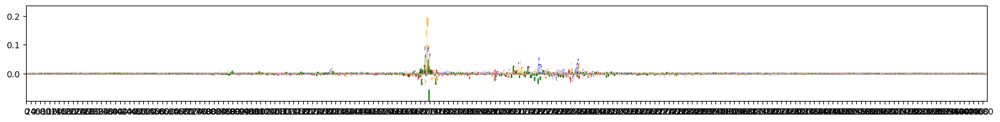

In [154]:
visualize_sequence_imp(proj_score_ref[[0],:4,:] ,0, 4096)

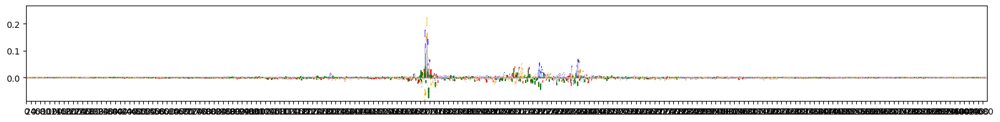

In [155]:
visualize_sequence_imp(proj_score_alt[[0],:4,:] ,0, 4096)

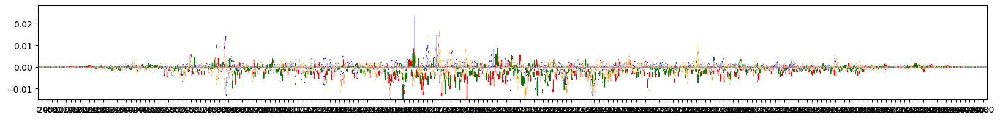

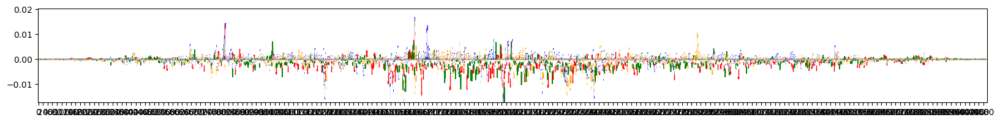

In [156]:
visualize_sequence_imp(proj_score_ref[[1],:4,:] ,0, 4096)
visualize_sequence_imp(proj_score_alt[[1],:4,:] ,0, 4096)

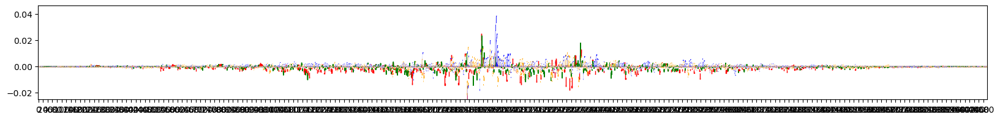

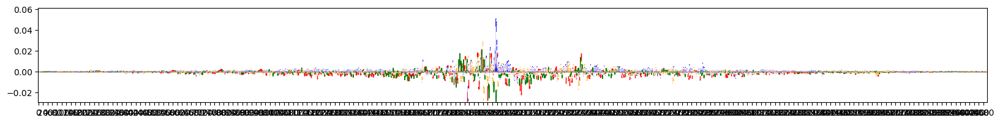

In [157]:
visualize_sequence_imp(proj_score_ref[[2],:4,:] ,0, 4096)
visualize_sequence_imp(proj_score_alt[[2],:4,:] ,0, 4096)

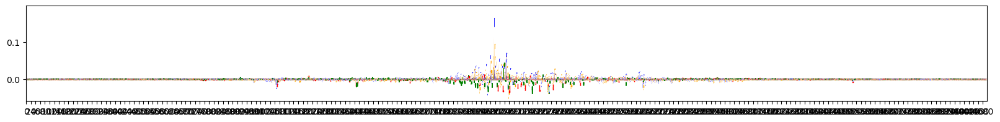

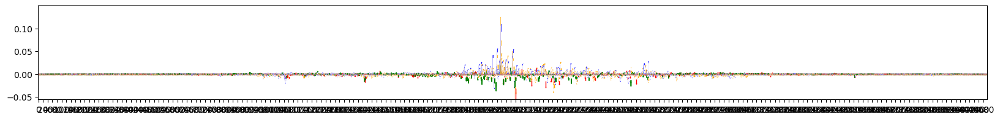

In [158]:
visualize_sequence_imp(proj_score_ref[[3],:4,:] ,0, 4096)
visualize_sequence_imp(proj_score_alt[[3],:4,:] ,0, 4096)

### Number of accessible regulatory regions

In [18]:
active_enhancer = pd.read_csv("../data/active_enhancers_all_days.bed", header=None, sep='\t')
#rep_enhancer = pd.read_csv("../data/repressed_enhancers_all_days.bed", header=None, index=None, sep='\t')
#promoter = pd.read_csv("../data/active_promoters_all_days.bed", header=None, index=None, sep='\t')

!bedtools intersect -a  ../data/active_promoters_all_days.bed  -b ../results/peaks_set.bed  -wa -wb > ../results/accessible_reg_regions.bed

reg_regions = pd.read_csv("../results/accessible_reg_regions.bed", header=None, sep='\t').iloc[:,:3]
reg_regions.drop_duplicates()

/Applications/anaconda3/envs/LeKira/lib/python3.10/pty.py:89: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  pid, fd = os.forkpty()


,0,1,2
0,1,940000,943400
2,1,996900,1002400
5,1,1012200,1014700
6,1,1019100,1022100
8,1,1031900,1034700
...,...,...,...
16200,9,137277400,137282300
16202,9,137303800,137306200
16203,9,137421500,137425500
16204,9,137457300,137459700


### Established threshold for differential prediction

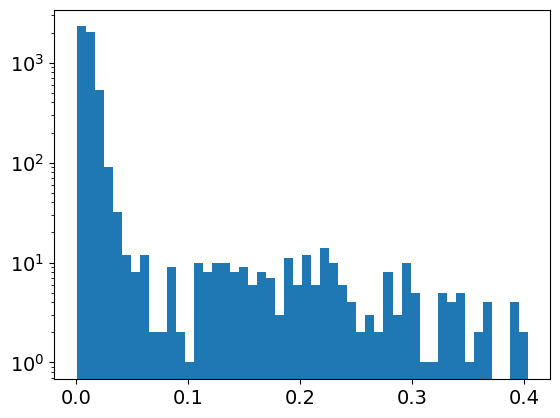

[-0.20696962  0.17661169]


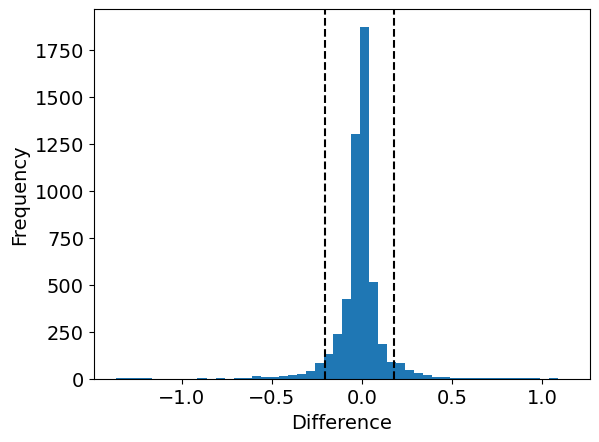

In [2]:
from scipy.spatial import distance

#regions interest
with open("../results/mutations/active_enchancer.pkl", 'rb') as file:
    active_enhancer = pickle.load(file)
active_enhancer["sign_effect"] = None
active_enhancer["effect"] = None
active_enhancer["type_reg"] = "Active enhancer"

with open("../results/mutations/rep_enhancer.pkl", 'rb') as file:
    rep_enhancer = pickle.load(file)
rep_enhancer["sign_effect"] = None
rep_enhancer["effect"] = None
rep_enhancer["type_reg"] = "Repressed enhancer"

with open("../results/mutations/promoter.pkl", 'rb') as file:
    promoter = pickle.load(file)
promoter["sign_effect"] = None
promoter["effect"] = None
promoter["type_reg"] = "Active promoter"


jsds, diffs, which_seq = [], [], []

#Active enhancer
with open("../results/mutations/pred_profile_active_enchancer.pkl", 'rb') as file:
    ref_profile = pickle.load(file)
with open("../results/mutations/pred_count_active_enchancer.pkl", 'rb') as file:
    ref_count = pickle.load(file)

with open("../results/mutations/alt_pred_profile_active_enchancer.pkl", 'rb') as file:
    alt_profile = pickle.load(file)
with open("../results/mutations/alt_pred_count_active_enchancer.pkl", 'rb') as file:
    alt_count = pickle.load(file)

ref_profile = torch.nn.functional.softmax(ref_profile, dim=1).detach().numpy()
alt_profile = torch.nn.functional.softmax(alt_profile, dim=1).detach().numpy()

for i in range (ref_count.size(0)):
    for t in range(4):
        jsd = distance.jensenshannon(ref_profile[i,t,:], alt_profile[i,t,:])
        jsds.append(jsd)

        diff =  alt_count[i,t].detach().numpy() - ref_count[i,t].detach().numpy()
        diffs.append(diff)

    active_enhancer.at[active_enhancer.index[i],"sign_effect"] = [x > 0 for x in diffs[-4:]]
    active_enhancer.at[active_enhancer.index[i],"effect"] = np.mean(diffs[-4:])


#Repressed enhancer
with open("../results/mutations/pred_profile_rep_enhancer.pkl", 'rb') as file:
    ref_profile = pickle.load(file)
with open("../results/mutations/pred_count_rep_enhancer.pkl", 'rb') as file:
    ref_count = pickle.load(file)

with open("../results/mutations/alt_pred_profile_rep_enhancer.pkl", 'rb') as file:
    alt_profile = pickle.load(file)
with open("../results/mutations/alt_pred_count_rep_enhancer.pkl", 'rb') as file:
    alt_count = pickle.load(file)

ref_profile = torch.nn.functional.softmax(ref_profile, dim=1).detach().numpy()
alt_profile = torch.nn.functional.softmax(alt_profile, dim=1).detach().numpy()


for i in range (ref_count.size(0)):
    for t in range(4):
        jsd = distance.jensenshannon(ref_profile[i,t,:], alt_profile[i,t,:])
        jsds.append(jsd)

        diff =  alt_count[i,t].detach().numpy() - ref_count[i,t].detach().numpy()
        diffs.append(diff)

    rep_enhancer.at[rep_enhancer.index[i],"sign_effect"] = [x > 0 for x in diffs[-4:]]
    rep_enhancer.at[rep_enhancer.index[i],"effect"] = np.mean(diffs[-4:])


#Active promoter
with open("../results/mutations/pred_profile_promoter.pkl", 'rb') as file:
    ref_profile = pickle.load(file)
with open("../results/mutations/pred_count_promoter.pkl", 'rb') as file:
    ref_count = pickle.load(file)

with open("../results/mutations/alt_pred_profile_promoter.pkl", 'rb') as file:
    alt_profile = pickle.load(file)
with open("../results/mutations/alt_pred_count_promoter.pkl", 'rb') as file:
    alt_count = pickle.load(file)

ref_profile = torch.nn.functional.softmax(ref_profile, dim=1).detach().numpy()
alt_profile = torch.nn.functional.softmax(alt_profile, dim=1).detach().numpy()

for i in range (ref_count.size(0)):
    for t in range(4):
        jsd = distance.jensenshannon(ref_profile[i,t,:], alt_profile[i,t,:])
        jsds.append(jsd)

        diff =  alt_count[i,t].detach().numpy() - ref_count[i,t].detach().numpy()
        diffs.append(diff)

    promoter.at[promoter.index[i],"sign_effect"] = [x > 0 for x in diffs[-4:]]
    promoter.at[promoter.index[i],"effect"] = np.mean(diffs[-4:])


#Plot distributions
plt.rcParams.update({'font.size': 14})

plt.hist(jsds, bins=50)
plt.yscale('log')
plt.show()


plt.hist(diffs, bins=50)
#plt.title("Difference between predicted and obseved log tn5 insertion count")
plt.ylabel("Frequency")
plt.xlabel("Difference")

#Compute quantiles of difference between log counts
five_perc_quantiles = np.quantile(diffs, q=[0.05,0.95])
plt.axvline(x=five_perc_quantiles[0],color='k', linestyle='--')
plt.axvline(x=five_perc_quantiles[1], color='k', linestyle='--')

print(five_perc_quantiles)
plt.show()

### Look if sign is the same for EQTL and prediction here

In [3]:
regions = pd.concat([active_enhancer, rep_enhancer, promoter])
regions

,chr_var,pos_var,ref,alt,chr_peak,start_peak,end_peak,end_var,sequence,middle,dist_var_middle,var_pos_seq,nucleotide_var,sequence_alt,sign_effect,effect,type_reg
1:2179409_T_G,1,2179409,T,G,1,2179151,2180134,2179410,AGCCGGAACTCAAGGAGACCATGAAGCCACCCTTGGCCTCTAGCTG...,2179642,-233,1814,T,AGCCGGAACTCAAGGAGACCATGAAGCCACCCTTGGCCTCTAGCTG...,"[True, True, True, True]",0.046827,Active enhancer
1:2189679_C_T,1,2189679,C,T,1,2189248,2190165,2189680,ATGAGCAGAAGGTGCAGCCAAGTCCCCATGCCCCTGCCCTGCCCGT...,2189706,-27,2020,C,ATGAGCAGAAGGTGCAGCCAAGTCCCCATGCCCCTGCCCTGCCCGT...,"[True, True, True, True]",0.026978,Active enhancer
1:9067100_C_A,1,9067100,C,A,1,9066866,9067844,9067101,AAGGCTGACCTTCTGACAGGGTACGATTCAAGGTCACTGGGAAGGA...,9067355,-255,1792,C,AAGGCTGACCTTCTGACAGGGTACGATTCAAGGTCACTGGGAAGGA...,"[True, True, True, True]",0.01538,Active enhancer
1:9961035_A_G,1,9961035,A,G,1,9960793,9961771,9961036,GGTGGCGGGCGCCTGTAATCCCAGCTACTCAGGAGGCTGAAGCAGA...,9961282,-247,1800,A,GGTGGCGGGCGCCTGTAATCCCAGCTACTCAGGAGGCTGAAGCAGA...,"[False, False, False, False]",-0.04423,Active enhancer
1:11650839_A_C,1,11650839,A,C,1,11650151,11651118,11650840,GGATGTGTGGCTTGGGGAAGGTGAGGACGCTATGGACTAAGTTAAG...,11650634,205,2252,A,GGATGTGTGGCTTGGGGAAGGTGAGGACGCTATGGACTAAGTTAAG...,"[False, False, False, False]",-0.01106,Active enhancer
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9:133738081_A_T,9,133738081,A,T,9,133737767,133738752,133738082,ACAATCATCAATGCTGCCTCACACTCAGGAGCAGCCCCCCGCCTGG...,133738260,-179,1868,A,ACAATCATCAATGCTGCCTCACACTCAGGAGCAGCCCCCCGCCTGG...,"[False, False, False, False]",-0.184659,Active promoter
9:134025469_C_T,9,134025469,C,T,9,134024793,134025705,134025470,TAGAGGGAGGGTGTTTGATATCAAATCAGATTGGAGCCAATGGGAT...,134025249,220,2267,C,TAGAGGGAGGGTGTTTGATATCAAATCAGATTGGAGCCAATGGGAT...,"[False, False, False, False]",-0.035446,Active promoter
9:136118473_A_C,9,136118473,A,C,9,136118428,136119327,136118474,CCGCATGCAGGCAGGTGGTGTGCGGGCCGTGGAAGGAGCGCACCCG...,136118878,-405,1642,A,CCGCATGCAGGCAGGTGGTGTGCGGGCCGTGGAAGGAGCGCACCCG...,"[True, True, True, True]",0.00535,Active promoter
9:136363451_G_A,9,136363451,G,A,9,136363055,136364000,136363452,GGCCACGCCATAGCTGCTCGTCCTGCCTGGGCCAGCAGGCAGCCTG...,136363528,-77,1970,G,GGCCACGCCATAGCTGCTCGTCCTGCCTGGGCCAGCAGGCAGCCTG...,"[True, True, False, False]",-0.002788,Active promoter


In [4]:
regions.groupby('type_reg').size()

type_reg
Active enhancer       534
Active promoter       589
Repressed enhancer    187
dtype: int64

In [5]:
#Differential predictions
""" idx_diff = np.logical_or(diffs < five_perc_quantiles[0], diffs > five_perc_quantiles[1])
regions = regions.reset_index()
names = np.repeat(regions.index.values, 4)

idx_diff = names[idx_diff]
regions = regions.loc[np.unique(idx_diff)] """

with open('../results/mutations/active_enchancer_diff_var.pkl', 'rb') as file:
    active_enhancer = pickle.load(file)

with open('../results/mutations/rep_enhancer_diff_var.pkl', 'rb') as file:
    rep_enhancer = pickle.load(file)

with open('../results/mutations/promoter_diff_var.pkl', 'rb') as file:
    promoter = pickle.load(file)

regions_prio = pd.concat([active_enhancer, rep_enhancer, promoter])
regions = regions.loc[regions_prio.index]

regions = regions.reset_index()
regions["index"] = [x.replace(":", "_") for x in regions['index']]
regions

,index,chr_var,pos_var,ref,alt,chr_peak,start_peak,end_peak,end_var,sequence,middle,dist_var_middle,var_pos_seq,nucleotide_var,sequence_alt,sign_effect,effect,type_reg
0,1_65467698_C_T,1,65467698,C,T,1,65467247,65468198,65467699,TCTCTAAGGACTTGCTTTATGAATCTGGGTGCTCCTGTGTTGGGTA...,65467722,-24,2023,C,TCTCTAAGGACTTGCTTTATGAATCTGGGTGCTCCTGTGTTGGGTA...,"[False, False, False, False]",-0.226584,Active enhancer
1,1_113979061_A_AAAC,1,113979061,A,AAAC,1,113978808,113979762,113979062,TTTTTTTTTTTTAACTGATAGATGGTGCAGCATGTCTACATGGTTG...,113979285,-224,1823,A,TTTTTTTTTTTAACTGATAGATGGTGCAGCATGTCTACATGGTTGT...,"[True, True, True, True]",0.946751,Active enhancer
2,1_113979061_A_AAAC,1,113979061,A,AAAC,1,113978808,113979762,113979062,TTTTTTTTTTTTAACTGATAGATGGTGCAGCATGTCTACATGGTTG...,113979285,-224,1823,A,TTTTTTTTTTTAACTGATAGATGGTGCAGCATGTCTACATGGTTGT...,"[True, True, True, True]",0.946751,Active promoter
3,1_154420375_G_A,1,154420375,G,A,1,154420116,154420659,154420376,ACCTGTTTATGGGTCCAAAGGAGCCTCCCTCCCAGACCCTCTCTCC...,154420388,-13,2034,G,ACCTGTTTATGGGTCCAAAGGAGCCTCCCTCCCAGACCCTCTCTCC...,"[False, False, False, False]",-0.226441,Active enhancer
4,11_308059_T_C,11,308059,T,C,11,307640,308565,308060,TATTGCTACGAAGAGTCTGTTTTGTCAGTACTATGAGCTCCATCTC...,308102,-43,2004,T,TATTGCTACGAAGAGTCTGTTTTGTCAGTACTATGAGCTCCATCTC...,"[False, False, False, False]",-0.248289,Active enhancer
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
207,8_124474526_A_G,8,124474526,A,G,8,124474311,124475273,124474527,AAAATTTGTACATCAAATTAAGATCAGGGACAGTTAAAACATTAAT...,124474792,-266,1781,A,AAAATTTGTACATCAAATTAAGATCAGGGACAGTTAAAACATTAAT...,"[True, True, True, True]",0.220315,Active promoter
208,8_144950882_C_G,8,144950882,C,G,8,144950355,144951246,144950883,ACCTTATTTTTCTCACTTCATTATGTGTGGGATCTTGCTTACCAGG...,144950800,82,2129,C,ACCTTATTTTTCTCACTTCATTATGTGTGGGATCTTGCTTACCAGG...,"[False, False, False, False]",-0.661084,Active promoter
209,9_15306294_A_C,9,15306294,A,C,9,15305727,15306418,15306295,GGTGAGCTGAATAATCTTAATTGAATTAAATAATAAAATATAAATG...,15306072,222,2269,A,GGTGAGCTGAATAATCTTAATTGAATTAAATAATAAAATATAAATG...,"[False, False, False, False]",-1.285827,Active promoter
210,9_19380241_A_T,9,19380241,A,T,9,19379818,19380739,19380242,CCAAATATTTTCTGTAAAAACTCCAAGTGAATAGTGCTAAGGCCTT...,19380278,-37,2010,A,CCAAATATTTTCTGTAAAAACTCCAAGTGAATAGTGCTAAGGCCTT...,"[True, True, True, True]",1.056347,Active promoter


In [6]:
variants = pd.DataFrame(pd.read_csv("../data/Muscle_Skeletal.var.txt", sep='\t'))[['phenotype_id','variant_id','slope']]
variants.variant_id = [x[3:-4] for x in variants.variant_id]
variants

,phenotype_id,variant_id,slope
0,ENSG00000227232.5,1_665098_G_A,0.521165
1,ENSG00000268903.1,1_593262_G_A,0.450060
2,ENSG00000269981.1,1_103147_C_T,-0.769645
3,ENSG00000241860.6,1_14677_G_A,0.944332
4,ENSG00000279457.4,1_599167_G_A,-0.560563
...,...,...,...
21026,ENSG00000155962.12,X_155608369_AAGG_A,-0.234715
21027,ENSG00000185973.10,X_155426002_G_A,-0.291783
21028,ENSG00000168939.11,X_155774618_A_G,0.211524
21029,ENSG00000124333.15,X_154881449_C_A,-0.085004


In [7]:
regions = regions.merge(variants, left_on='index', right_on='variant_id')
regions["sign_slope"] = regions.slope > 0
regions["sign_effect"] = [np.any(x) for x in regions.sign_effect]

regions = regions.drop_duplicates()
regions

,index,chr_var,pos_var,ref,alt,chr_peak,start_peak,end_peak,end_var,sequence,...,var_pos_seq,nucleotide_var,sequence_alt,sign_effect,effect,type_reg,phenotype_id,variant_id,slope,sign_slope
0,1_65467698_C_T,1,65467698,C,T,1,65467247,65468198,65467699,TCTCTAAGGACTTGCTTTATGAATCTGGGTGCTCCTGTGTTGGGTA...,...,2023,C,TCTCTAAGGACTTGCTTTATGAATCTGGGTGCTCCTGTGTTGGGTA...,False,-0.226584,Active enhancer,ENSG00000213625.8,1_65467698_C_T,0.274363,True
1,1_113979061_A_AAAC,1,113979061,A,AAAC,1,113978808,113979762,113979062,TTTTTTTTTTTTAACTGATAGATGGTGCAGCATGTCTACATGGTTG...,...,1823,A,TTTTTTTTTTTAACTGATAGATGGTGCAGCATGTCTACATGGTTGT...,True,0.946751,Active enhancer,ENSG00000116774.11,1_113979061_A_AAAC,0.217263,True
2,1_113979061_A_AAAC,1,113979061,A,AAAC,1,113978808,113979762,113979062,TTTTTTTTTTTTAACTGATAGATGGTGCAGCATGTCTACATGGTTG...,...,1823,A,TTTTTTTTTTTAACTGATAGATGGTGCAGCATGTCTACATGGTTGT...,True,0.946751,Active promoter,ENSG00000116774.11,1_113979061_A_AAAC,0.217263,True
3,1_154420375_G_A,1,154420375,G,A,1,154420116,154420659,154420376,ACCTGTTTATGGGTCCAAAGGAGCCTCCCTCCCAGACCCTCTCTCC...,...,2034,G,ACCTGTTTATGGGTCCAAAGGAGCCTCCCTCCCAGACCCTCTCTCC...,False,-0.226441,Active enhancer,ENSG00000160712.12,1_154420375_G_A,-0.209592,False
4,11_308059_T_C,11,308059,T,C,11,307640,308565,308060,TATTGCTACGAAGAGTCTGTTTTGTCAGTACTATGAGCTCCATCTC...,...,2004,T,TATTGCTACGAAGAGTCTGTTTTGTCAGTACTATGAGCTCCATCTC...,False,-0.248289,Active enhancer,ENSG00000185201.16,11_308059_T_C,0.223025,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
218,8_124474526_A_G,8,124474526,A,G,8,124474311,124475273,124474527,AAAATTTGTACATCAAATTAAGATCAGGGACAGTTAAAACATTAAT...,...,1781,A,AAAATTTGTACATCAAATTAAGATCAGGGACAGTTAAAACATTAAT...,True,0.220315,Active promoter,ENSG00000245149.3,8_124474526_A_G,-0.231252,False
219,8_144950882_C_G,8,144950882,C,G,8,144950355,144951246,144950883,ACCTTATTTTTCTCACTTCATTATGTGTGGGATCTTGCTTACCAGG...,...,2129,C,ACCTTATTTTTCTCACTTCATTATGTGTGGGATCTTGCTTACCAGG...,False,-0.661084,Active promoter,ENSG00000170631.14,8_144950882_C_G,-0.419649,False
220,9_15306294_A_C,9,15306294,A,C,9,15305727,15306418,15306295,GGTGAGCTGAATAATCTTAATTGAATTAAATAATAAAATATAAATG...,...,2269,A,GGTGAGCTGAATAATCTTAATTGAATTAAATAATAAAATATAAATG...,False,-1.285827,Active promoter,ENSG00000155158.20,9_15306294_A_C,-0.671896,False
221,9_19380241_A_T,9,19380241,A,T,9,19379818,19380739,19380242,CCAAATATTTTCTGTAAAAACTCCAAGTGAATAGTGCTAAGGCCTT...,...,2010,A,CCAAATATTTTCTGTAAAAACTCCAAGTGAATAGTGCTAAGGCCTT...,True,1.056347,Active promoter,ENSG00000137154.12,9_19380241_A_T,0.338344,True


In [8]:
regions.head(20)

,index,chr_var,pos_var,ref,alt,chr_peak,start_peak,end_peak,end_var,sequence,...,var_pos_seq,nucleotide_var,sequence_alt,sign_effect,effect,type_reg,phenotype_id,variant_id,slope,sign_slope
0,1_65467698_C_T,1,65467698,C,T,1,65467247,65468198,65467699,TCTCTAAGGACTTGCTTTATGAATCTGGGTGCTCCTGTGTTGGGTA...,...,2023,C,TCTCTAAGGACTTGCTTTATGAATCTGGGTGCTCCTGTGTTGGGTA...,False,-0.226584,Active enhancer,ENSG00000213625.8,1_65467698_C_T,0.274363,True
1,1_113979061_A_AAAC,1,113979061,A,AAAC,1,113978808,113979762,113979062,TTTTTTTTTTTTAACTGATAGATGGTGCAGCATGTCTACATGGTTG...,...,1823,A,TTTTTTTTTTTAACTGATAGATGGTGCAGCATGTCTACATGGTTGT...,True,0.946751,Active enhancer,ENSG00000116774.11,1_113979061_A_AAAC,0.217263,True
2,1_113979061_A_AAAC,1,113979061,A,AAAC,1,113978808,113979762,113979062,TTTTTTTTTTTTAACTGATAGATGGTGCAGCATGTCTACATGGTTG...,...,1823,A,TTTTTTTTTTTAACTGATAGATGGTGCAGCATGTCTACATGGTTGT...,True,0.946751,Active promoter,ENSG00000116774.11,1_113979061_A_AAAC,0.217263,True
3,1_154420375_G_A,1,154420375,G,A,1,154420116,154420659,154420376,ACCTGTTTATGGGTCCAAAGGAGCCTCCCTCCCAGACCCTCTCTCC...,...,2034,G,ACCTGTTTATGGGTCCAAAGGAGCCTCCCTCCCAGACCCTCTCTCC...,False,-0.226441,Active enhancer,ENSG00000160712.12,1_154420375_G_A,-0.209592,False
4,11_308059_T_C,11,308059,T,C,11,307640,308565,308060,TATTGCTACGAAGAGTCTGTTTTGTCAGTACTATGAGCTCCATCTC...,...,2004,T,TATTGCTACGAAGAGTCTGTTTTGTCAGTACTATGAGCTCCATCTC...,False,-0.248289,Active enhancer,ENSG00000185201.16,11_308059_T_C,0.223025,True
5,11_308059_T_C,11,308059,T,C,11,307640,308565,308060,TATTGCTACGAAGAGTCTGTTTTGTCAGTACTATGAGCTCCATCTC...,...,2004,T,TATTGCTACGAAGAGTCTGTTTTGTCAGTACTATGAGCTCCATCTC...,False,-0.248289,Active promoter,ENSG00000185201.16,11_308059_T_C,0.223025,True
6,11_17688220_T_A,11,17688220,T,A,11,17687688,17688681,17688221,GGGGCTTAGACAGGAGGAGCTCTGAGAGTCTGCGGATGTTATCCTT...,...,2083,T,GGGGCTTAGACAGGAGGAGCTCTGAGAGTCTGCGGATGTTATCCTT...,False,-0.212689,Active enhancer,ENSG00000129152.3,11_17688220_T_A,-0.170281,False
7,11_17688220_T_A,11,17688220,T,A,11,17687688,17688681,17688221,GGGGCTTAGACAGGAGGAGCTCTGAGAGTCTGCGGATGTTATCCTT...,...,2083,T,GGGGCTTAGACAGGAGGAGCTCTGAGAGTCTGCGGATGTTATCCTT...,False,-0.212689,Repressed enhancer,ENSG00000129152.3,11_17688220_T_A,-0.170281,False
8,12_54411590_T_C,12,54411590,T,C,12,54411259,54412383,54411591,TAGCCTGACTTATCTCTCCACTACACACATACACATACACACACAC...,...,1816,T,TAGCCTGACTTATCTCTCCACTACACACATACACATACACACACAC...,True,0.399824,Active enhancer,ENSG00000161638.10,12_54411590_T_C,0.354403,True
9,13_21298170_C_G,13,21298170,C,G,13,21297745,21298625,21298171,AGGCTAACAGGAAAAACTGCTGCACCTGGAAACACAGAGAACAAAT...,...,2032,C,AGGCTAACAGGAAAAACTGCTGCACCTGGAAACACAGAGAACAAAT...,False,-0.480643,Active enhancer,ENSG00000233325.3,13_21298170_C_G,1.783000,True


In [ ]:
regions.groupby('type_reg').size()

type_reg
Active enhancer        38
Active promoter       103
Repressed enhancer     12
dtype: int64

In [ ]:
regions[np.logical_and(regions.chr_var == 5, regions.pos_var == 151239432)]


,index,chr_var,pos_var,ref,alt,chr_peak,start_peak,end_peak,end_var,sequence,...,var_pos_seq,nucleotide_var,sequence_alt,sign_effect,effect,type_reg,phenotype_id,variant_id,slope,sign_slope
55,5_151239432_C_T,5,151239432,C,T,5,151238984,151239918,151239433,TTTTGTTTTTTGAGACGGAGTCTTGCTTTGTCGCCCAGGCTGGAGT...,...,2028,C,TTTTGTTTTTTGAGACGGAGTCTTGCTTTGTCGCCCAGGCTGGAGT...,False,-1.264193,Active enhancer,ENSG00000196743.8,5_151239432_C_T,0.300413,True
56,5_151239432_C_T,5,151239432,C,T,5,151238984,151239918,151239433,TTTTGTTTTTTGAGACGGAGTCTTGCTTTGTCGCCCAGGCTGGAGT...,...,2028,C,TTTTGTTTTTTGAGACGGAGTCTTGCTTTGTCGCCCAGGCTGGAGT...,False,-1.264193,Repressed enhancer,ENSG00000196743.8,5_151239432_C_T,0.300413,True


In [11]:
from sklearn.metrics import confusion_matrix as cm

#Confusiom matrix, does prediction goes in same direction as EGTL sign
tn, fp, fn, tp = cm(regions.sign_slope, regions.sign_effect).ravel()
acc = (tp+ tn) / (tp + tn + fp + fn) 
acc

0.5816993464052288

In [10]:
tp,fp,fn,tn

(37, 26, 26, 34)

In [16]:
import numpy as np
np.sqrt(1.7511)

1.323291351139272

<Axes: >

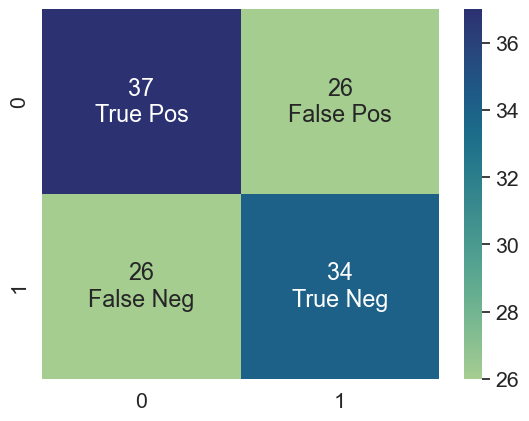

In [42]:
import seaborn as sns

cm = np.array([[tp,fp],[fn,tn]])
""" labels = np.array(['True Pos','False Pos','False Neg','True Neg'])
labels = [f"{v1}\n{v2}" for v1, v2 in
          zip(cm,labels)] """
labels = [['37\nTrue Pos', '26\nFalse Pos'], ['26\nFalse Neg', '34\nTrue Neg']]

sns.set_theme(font_scale=1.4)
sns.heatmap(cm, annot=labels, fmt='', cmap="crest")

0.03229257333132479


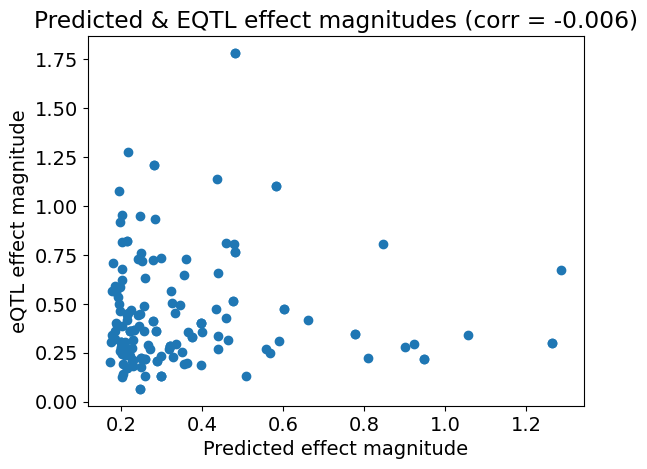

In [17]:
import scipy

#Plot predict effect vs slope
corr = scipy.stats.spearmanr(regions.effect.abs(), regions.slope.abs()).statistic
print(corr)
plt.scatter(regions.effect.abs(), regions.slope.abs())
plt.title("Predicted & EQTL effect magnitudes (corr = -0.006)")
plt.xlabel("Predicted effect magnitude")
plt.ylabel("eQTL effect magnitude")
plt.show()

### GO enrichment of genes accosiated to variants 

In [12]:
!pwd
!python ~/../../Applications/anaconda3/envs/scvi/bin/ncbi_gene_results_to_python.py -o genes_ncbi_proteincoding.py exploration/gene_result.txt

/Users/adorman/Documents/master-thesis/src
      20,630 lines READ:  exploration/gene_result.txt
      20,609 geneids WROTE: genes_ncbi_proteincoding.py


In [13]:
from genes_ncbi_proteincoding import GENEID2NT as GeneID2nt_mus
from goatools.base import download_go_basic_obo
from goatools.base import download_ncbi_associations
from goatools.obo_parser import GODag
from goatools.anno.genetogo_reader import Gene2GoReader
from goatools.goea.go_enrichment_ns import GOEnrichmentStudyNS

#run one time to initialize
obo_fname = download_go_basic_obo()
fin_gene2go = download_ncbi_associations()
obodag = GODag("go-basic.obo")

mapper = {}

for key in GeneID2nt_mus:
    mapper[GeneID2nt_mus[key].Symbol] = GeneID2nt_mus[key].GeneID
    
inv_map = {v: k for k, v in mapper.items()}

# Read NCBI's gene2go. Store annotations in a list of namedtuples
objanno = Gene2GoReader(fin_gene2go, taxids=[9606])
# Get namespace2association where:
#    namespace is:
#        BP: biological_process               
#        MF: molecular_function
#        CC: cellular_component
#    assocation is a dict:
#        key: NCBI GeneID
#        value: A set of GO IDs associated with that gene
ns2assoc = objanno.get_ns2assc()

goeaobj = GOEnrichmentStudyNS(
        GeneID2nt_mus.keys(), # List of mouse protein-coding genes
        ns2assoc, # geneid/GO associations
        obodag, # Ontologies
        propagate_counts = False,
        alpha = 0.05, # default significance cut-off
        methods = ['fdr_bh']) # defult multipletest correction method

GO_items = []

temp = goeaobj.ns2objgoea['BP'].assoc
for item in temp:
    GO_items += temp[item]
    

temp = goeaobj.ns2objgoea['CC'].assoc
for item in temp:
    GO_items += temp[item]
    

temp = goeaobj.ns2objgoea['MF'].assoc
for item in temp:
    GO_items += temp[item]

#pass list of gene symbols
def go_it(test_genes):
    print(f'input genes: {len(test_genes)}')
    
    mapped_genes = []
    for gene in test_genes:
        try:
            mapped_genes.append(mapper[gene])
        except:
            pass
    print(f'mapped genes: {len(mapped_genes)}')
    
    goea_results_all = goeaobj.run_study(mapped_genes)
    goea_results_sig = [r for r in goea_results_all if r.p_fdr_bh < 0.05]
    GO = pd.DataFrame(list(map(lambda x: [x.GO, x.goterm.name, x.goterm.namespace, x.p_uncorrected, x.p_fdr_bh,\
                   x.ratio_in_study[0], x.ratio_in_study[1], GO_items.count(x.GO), list(map(lambda y: inv_map[y], x.study_items)),\
                   ], goea_results_sig)), columns = ['GO', 'term', 'class', 'p', 'p_corr', 'n_genes',\
                                                    'n_study', 'n_go', 'study_genes'])

    GO = GO[GO.n_genes > 1]
    return GO

$ get http://purl.obolibrary.org/obo/go/go-basic.obo
requests.get(http://purl.obolibrary.org/obo/go/go-basic.obo, stream=True)
  WROTE: go-basic.obo

$ get ftp://ftp.ncbi.nlm.nih.gov/gene/DATA/gene2go.gz
FTP RETR ftp.ncbi.nlm.nih.gov gene/DATA gene2go.gz -> gene2go.gz
$ gunzip gene2go.gz
go-basic.obo: fmt(1.2) rel(2024-06-17) 45,494 Terms
HMS:0:01:57.531946 347,845 annotations, 20,780 genes, 18,718 GOs, 1 taxids READ: gene2go 

Load BP Ontology Enrichment Analysis ...
 83% 17,030 of 20,609 population items found in association

Load CC Ontology Enrichment Analysis ...
 88% 18,166 of 20,609 population items found in association

Load MF Ontology Enrichment Analysis ...
 85% 17,620 of 20,609 population items found in association


In [20]:
#Convert ensemblem gene id to gene symbol using: https://www.biotools.fr/human/ensembl_symbol_converter 
#for gene_id in ec_markers:
    #print(gene_id)

gene_id = ["LEPROT","OLFML3","OLFML3","IL6R","IFITM2","IFITM2","MYOD1","MYOD1","ITGA5","MIPEPP3","LINC00539","MIPEPP3","LINC00539","TEX26-AS1","TEX26-AS1","TEX26-AS1","DNAJC15","DNAJC15","AL122035.2","AC023024.1","MAP3K14","HOXB2","HOXB2","HOXB2","NAPG","POLI","POLI","RPL28","RPL28","THUMPD2","THUMPD2","FMNL2","TFPI","CMC1","CMC1","MYD88","MYD88","ITIH3","ITIH3","AC016924.1","AC016924.1","AC016924.1","AC080129.2","AC080129.2","AC080129.2","ADGRA3","TRIM2","TRIM2","NEK1","NEK1","PELO","PELO","PDGFRB","PDGFRB","PDGFRB","GM2A","GM2A","HIST1H2BD","HIST1H2BD","CD164","FO393415.1","OSBPL3","OSBPL3","POLD2","POLD2","SND1","SND1","LINC01504","CMPK1","FAM53A","RWDD4","TSLP","SDHB","MTFR1L","CDC7","GABPB2","RIT1","PYCR2","COA6","SMC3","WDR11","CD81","CD81-AS1","TMEM9B","SLC35C1","TRMT112","AP001107.8","CWC15","KDM5A","SMIM10L1","LINC0125","CASC","MDM1","C12orf73","BORA","METTL17","IGDCC4","BBS4","SH2D7","CIB2","SNHG9","ALG1","CNEP1R1","NUDT21","AC009163.7","UBE2Z","SMG8","NARF","CNDP2","ZNF31","ZNF253","AC011477.3","SAE1","LINC01869","ZNF154","CLHC1","FAM136","THNSL2","AC009962.1","NRSN2-AS1","MMP24OS","SERINC3","RPP14","NEPRO","RFC1","SLC30A9","SRD5A3","AC069200.1","SRD5A3-AS1","NOA1","LINC02427","CARD6","PCYOX1L","ZFP62","LINC01011","TCF19","RPS18","B3GALT4","NFKBIE","HEBP2","HOXA9","CYP51A1","ZBED6CL","XRCC2","NEIL2","UBXN2B","RNF139-AS1","ZNF16","TTC39B","RPS6","RBM18"]

input genes: 151
mapped genes: 113

Runing BP Ontology Analysis: current study set of 113 IDs.
 90%     83 of     92 study items found in association
 81%     92 of    113 study items found in population(20609)
Calculating 12,143 uncorrected p-values using fisher_scipy_stats
  12,143 terms are associated with 17,030 of 20,609 population items
     515 terms are associated with     83 of     92 study items
  METHOD fdr_bh:
       0 GO terms found significant (< 0.05=alpha) (  0 enriched +   0 purified): statsmodels fdr_bh
       0 study items associated with significant GO IDs (enriched)
       0 study items associated with significant GO IDs (purified)

Runing CC Ontology Analysis: current study set of 113 IDs.
 92%     85 of     92 study items found in association
 81%     92 of    113 study items found in population(20609)
Calculating 1,811 uncorrected p-values using fisher_scipy_stats
   1,811 terms are associated with 18,166 of 20,609 population items
     150 terms are associated 

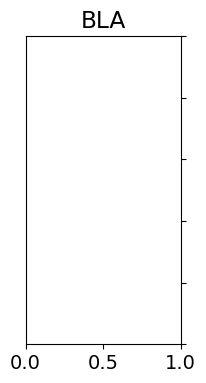

In [21]:
import matplotlib.pyplot as plt
import matplotlib as mpl
from matplotlib import cm
import seaborn as sns
import textwrap

#Run GO enrichment
df = go_it(gene_id)

df['enrichment_score'] = -np.log(df.p_corr)
df = df[0:10]
df = df.sort_values('enrichment_score', ascending=False)

#Plot barplot
plt.figure(figsize = (2,4))
ax = sns.barplot(data = df, x = 'enrichment_score', y = 'term')
ax.yaxis.tick_right()
ax.set_yticklabels([textwrap.fill(e, 35) for e in df['term']])
ax.set_title("BLA")
plt.show()

### Overlap motifs and variants

In [8]:
#Load all motifs found in sequences
active_enhancer_motifs  = pd.read_csv("../results/mutations/active_enchancer_motifs.bed", header=None, sep='\t', names=["chr", "start", "end", "motif_id", "score", "normal", "gene_name"])
active_enhancer_motifs = active_enhancer_motifs[[x.isupper() for x in active_enhancer_motifs.gene_name]]

rep_enhancer_motifs  = pd.read_csv("../results/mutations/rep_enhancer_motifs.bed", header=None, sep='\t', names=["chr", "start", "end", "motif_id", "score", "normal", "gene_name"])
rep_enhancer_motifs = rep_enhancer_motifs[[x.isupper() for x in rep_enhancer_motifs.gene_name]]

promoter_motifs  = pd.read_csv("../results/mutations/promoter_motifs.bed", header=None, sep='\t', names=["chr", "start", "end", "motif_id", "score", "normal", "gene_name"])
promoter_motifs = promoter_motifs[[x.isupper() for x in promoter_motifs.gene_name]]

motifs = pd.concat([active_enhancer_motifs, rep_enhancer_motifs, promoter_motifs])
print(motifs)

#Create .bed file of motifs
motifs.to_csv('../results/mutations/motifs_reg.bed', header=False, index=False, sep='\t')

#Create bed file for variants
variants = pd.DataFrame(pd.read_csv("../data/Muscle_Skeletal.var.txt", sep='\t').variant_id)
variants = variants['variant_id'].str.split('_')

variants = pd.DataFrame(variants.tolist(), index= variants.index, columns=['chr','pos', 'ref', 'alt', '_']).iloc[:,:-1]
variants = variants.iloc[:,:2]
variants["pos2"] = variants.pos.astype(int) + 1

variants.to_csv('../results/mutations/variants.bed', header=False, index=False, sep='\t')
variants


          chr      start        end  motif_id  score normal gene_name
0        chr1    2179141    2179154  MA0470.3    349      +      E2F4
1        chr1    2179141    2179154  MA0864.3    345      +      E2F2
2        chr1    2179142    2179154  MA0024.3    329      +      E2F1
4        chr1    2179147    2179153  MA0719.2    171      -    RHOXF1
5        chr1    2179147    2179156  MA1480.2    327      +      DPRX
...       ...        ...        ...       ...    ...    ...       ...
2349763  chr9  136546661  136546669  MA2099.1    397      +    ZNF770
2349764  chr9  136546661  136546667  MA1536.2    146      -     NR2C2
2349765  chr9  136546662  136546673  MA0810.2    310      +    TFAP2A
2349766  chr9  136546662  136546673  MA0811.2    349      -    TFAP2B
2349767  chr9  136546662  136546673  MA0524.3    360      -    TFAP2C

[4689556 rows x 7 columns]


,chr,pos,pos2
0,chr1,665098,665099
1,chr1,593262,593263
2,chr1,103147,103148
3,chr1,14677,14678
4,chr1,599167,599168
...,...,...,...
21026,chrX,155608369,155608370
21027,chrX,155426002,155426003
21028,chrX,155774618,155774619
21029,chrX,154881449,154881450


In [9]:
motifs.shape

(4689556, 7)

In [9]:
#Insection between the motifs and variants in accessible regions

!bedtools intersect -a ../results/mutations/motifs_reg.bed -b ../results/mutations/variants.bed -wa -wb > ../results/mutations/mut_var_overlap.bed
motif_var_overlap  = pd.read_csv("../results/mutations/mut_var_overlap.bed", header=None, sep='\t', names=["chr_motif", "start_motif", "end_motif", "motif_id", "score", "normal", "gene_name", 'chr_var', 'pos_var', '_'])
motif_var_overlap = motif_var_overlap.drop_duplicates()

motif_var_overlap

,chr_motif,start_motif,end_motif,motif_id,score,normal,gene_name,chr_var,pos_var,_
0,chr1,2179403,2179410,MA1545.2,240,+,OVOL2,chr1,2179409,2179410
1,chr1,2179407,2179414,MA1497.2,194,+,HOXA6,chr1,2179409,2179410
2,chr1,2179407,2179414,MA1500.2,222,-,HOXB6,chr1,2179409,2179410
3,chr1,2179407,2179414,MA1501.2,256,+,HOXB7,chr1,2179409,2179410
4,chr1,2179407,2179414,MA2093.1,211,+,HOXB1,chr1,2179409,2179410
...,...,...,...,...,...,...,...,...,...,...
41469,chr9,136363450,136363461,MA0778.2,366,+,NFKB2,chr9,136363451,136363452
41470,chr9,136363450,136363460,MA0101.1,295,+,REL,chr9,136363451,136363452
41471,chr9,136363450,136363456,MA1536.2,160,+,NR2C2,chr9,136363451,136363452
41472,chr9,136363450,136363456,MA1535.2,206,+,NR2C1,chr9,136363451,136363452


In [10]:
#Number of variants overlapping with at least one motif
len(np.unique(motif_var_overlap.chr_var + ":" + motif_var_overlap.pos_var.astype(str)))

1017

In [11]:
motif_var_overlap[motif_var_overlap.gene_name=="MYOG"]

,chr_motif,start_motif,end_motif,motif_id,score,normal,gene_name,chr_var,pos_var,_
968,chr1,210233589,210233597,MA0500.3,297,+,MYOG,chr1,210233595,210233596
973,chr1,210233589,210233597,MA0500.3,299,-,MYOG,chr1,210233595,210233596
3141,chr12,16350806,16350814,MA0500.3,262,-,MYOG,chr12,16350812,16350813
3142,chr12,16350806,16350814,MA0500.3,262,+,MYOG,chr12,16350812,16350813
3697,chr12,95084094,95084102,MA0500.3,265,+,MYOG,chr12,95084096,95084097
...,...,...,...,...,...,...,...,...,...,...
35210,chr3,9933700,9933708,MA0500.3,303,-,MYOG,chr3,9933702,9933703
38623,chr6,36443287,36443295,MA0500.3,347,-,MYOG,chr6,36443287,36443288
38624,chr6,36443287,36443295,MA0500.3,349,+,MYOG,chr6,36443287,36443288
40669,chr8,144786937,144786945,MA0500.3,281,+,MYOG,chr8,144786937,144786938


In [12]:
#Overlap between motifs and variants in accessible regions + predicted differential chromatin accessibility
regions.index = ["_".join(x.split("_")[:2]) for x in regions.iloc[:, 0]]
motif_var_overlap.index = motif_var_overlap.chr_var + "_" + motif_var_overlap.pos_var.astype(str)
motif_var_overlap.index = [x[3:] for x in motif_var_overlap.index]

overlap = regions.join(motif_var_overlap, lsuffix='_reg')
overlap = overlap[["chr_var", "pos_var", "ref", "alt", 'chr_motif','start_motif', 'end_motif', 'motif_id', 'score', 'normal', 'gene_name', 'middle', 'dist_var_middle', 'sign_effect', 'sign_slope', 'phenotype_id']]
overlap = overlap.drop_duplicates()
overlap

,chr_var,pos_var,ref,alt,chr_motif,start_motif,end_motif,motif_id,score,normal,gene_name,middle,dist_var_middle,sign_effect,sign_slope,phenotype_id
1_65467698,chr1,65467698,C,T,chr1,65467684,65467699,MA1533.2,351,-,NR1I2,65467722,-24,False,True,ENSG00000213625.8
1_65467698,chr1,65467698,C,T,chr1,65467691,65467699,MA1534.2,270,-,NR1I3,65467722,-24,False,True,ENSG00000213625.8
1_65467698,chr1,65467698,C,T,chr1,65467693,65467699,MA1536.2,265,+,NR2C2,65467722,-24,False,True,ENSG00000213625.8
1_65467698,chr1,65467698,C,T,chr1,65467693,65467704,MA1952.2,318,-,FOXJ2::ELF1,65467722,-24,False,True,ENSG00000213625.8
1_65467698,chr1,65467698,C,T,chr1,65467694,65467702,MA0632.3,261,-,TCFL5,65467722,-24,False,True,ENSG00000213625.8
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9_122264840,chr9,122264840,A,C,chr9,122264840,122264849,MA0812.2,282,+,TFAP2B,122264801,39,False,True,ENSG00000119446.13
9_122264840,chr9,122264840,A,C,chr9,122264840,122264849,MA0812.2,290,-,TFAP2B,122264801,39,False,True,ENSG00000119446.13
9_122264840,chr9,122264840,A,C,chr9,122264840,122264849,MA0814.3,320,+,TFAP2C,122264801,39,False,True,ENSG00000119446.13
9_122264840,chr9,122264840,A,C,chr9,122264840,122264849,MA1569.2,269,-,TFAP2E,122264801,39,False,True,ENSG00000119446.13


In [14]:
overlap[overlap.gene_name=="MYOG"]

,chr_var,pos_var,ref,alt,chr_motif,start_motif,end_motif,motif_id,score,normal,gene_name,middle,dist_var_middle,sign_effect,sign_slope,phenotype_id
17_48530668,chr17,48530668,G,A,chr17,48530667,48530675,MA0500.3,270,-,MYOG,48530960,-292,False,False,ENSG00000173917.10
17_48530668,chr17,48530668,G,A,chr17,48530667,48530675,MA0500.3,267,+,MYOG,48530960,-292,False,False,ENSG00000173917.10
7_24883216,chr7,24883216,A,T,chr7,24883216,24883224,MA0500.3,315,+,MYOG,24883308,-92,False,True,ENSG00000070882.12
7_24883216,chr7,24883216,A,T,chr7,24883216,24883224,MA0500.3,317,-,MYOG,24883308,-92,False,True,ENSG00000070882.12
11_8964472,chr11,8964472,G,C,chr11,8964472,8964480,MA0500.3,262,-,MYOG,8964588,-116,False,False,ENSG00000175348.10
11_8964472,chr11,8964472,G,C,chr11,8964472,8964480,MA0500.3,262,+,MYOG,8964588,-116,False,False,ENSG00000175348.10
11_94973303,chr11,94973303,G,GAAA,chr11,94973296,94973304,MA0500.3,269,-,MYOG,94973611,-308,True,False,ENSG00000150316.11
11_94973303,chr11,94973303,G,GAAA,chr11,94973296,94973304,MA0500.3,269,+,MYOG,94973611,-308,True,False,ENSG00000150316.11


# Look at attributions maps: zoom in on motifs

In [48]:
with open('../results/mutations/active_enchancer_diff_var.pkl', 'rb') as file:
    active_enhancer = pickle.load(file)

with open('../results/mutations/rep_enhancer_diff_var.pkl', 'rb') as file:
    rep_enhancer = pickle.load(file)

with open('../results/mutations/promoter_diff_var.pkl', 'rb') as file:
    promoter = pickle.load(file)

regions_reg = pd.concat([active_enhancer, rep_enhancer, promoter])
regions_reg.index = [x.replace(":", "_") for x in regions_reg.index]

regions_reg

,chr_var,pos_var,ref,alt,chr_peak,start_peak,end_peak,end_var,sequence,middle,dist_var_middle,var_pos_seq,nucleotide_var,sequence_alt
1_65467698_C_T,1,65467698,C,T,1,65467247,65468198,65467699,TCTCTAAGGACTTGCTTTATGAATCTGGGTGCTCCTGTGTTGGGTA...,65467722,-24,2023,C,TCTCTAAGGACTTGCTTTATGAATCTGGGTGCTCCTGTGTTGGGTA...
1_113979061_A_AAAC,1,113979061,A,AAAC,1,113978808,113979762,113979062,TTTTTTTTTTTTAACTGATAGATGGTGCAGCATGTCTACATGGTTG...,113979285,-224,1823,A,TTTTTTTTTTTAACTGATAGATGGTGCAGCATGTCTACATGGTTGT...
1_154420375_G_A,1,154420375,G,A,1,154420116,154420659,154420376,ACCTGTTTATGGGTCCAAAGGAGCCTCCCTCCCAGACCCTCTCTCC...,154420388,-13,2034,G,ACCTGTTTATGGGTCCAAAGGAGCCTCCCTCCCAGACCCTCTCTCC...
11_308059_T_C,11,308059,T,C,11,307640,308565,308060,TATTGCTACGAAGAGTCTGTTTTGTCAGTACTATGAGCTCCATCTC...,308102,-43,2004,T,TATTGCTACGAAGAGTCTGTTTTGTCAGTACTATGAGCTCCATCTC...
11_17688220_T_A,11,17688220,T,A,11,17687688,17688681,17688221,GGGGCTTAGACAGGAGGAGCTCTGAGAGTCTGCGGATGTTATCCTT...,17688184,36,2083,T,GGGGCTTAGACAGGAGGAGCTCTGAGAGTCTGCGGATGTTATCCTT...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8_124474526_A_G,8,124474526,A,G,8,124474311,124475273,124474527,AAAATTTGTACATCAAATTAAGATCAGGGACAGTTAAAACATTAAT...,124474792,-266,1781,A,AAAATTTGTACATCAAATTAAGATCAGGGACAGTTAAAACATTAAT...
8_144950882_C_G,8,144950882,C,G,8,144950355,144951246,144950883,ACCTTATTTTTCTCACTTCATTATGTGTGGGATCTTGCTTACCAGG...,144950800,82,2129,C,ACCTTATTTTTCTCACTTCATTATGTGTGGGATCTTGCTTACCAGG...
9_15306294_A_C,9,15306294,A,C,9,15305727,15306418,15306295,GGTGAGCTGAATAATCTTAATTGAATTAAATAATAAAATATAAATG...,15306072,222,2269,A,GGTGAGCTGAATAATCTTAATTGAATTAAATAATAAAATATAAATG...
9_19380241_A_T,9,19380241,A,T,9,19379818,19380739,19380242,CCAAATATTTTCTGTAAAAACTCCAAGTGAATAGTGCTAAGGCCTT...,19380278,-37,2010,A,CCAAATATTTTCTGTAAAAACTCCAAGTGAATAGTGCTAAGGCCTT...


In [49]:
#Load proj scores
with open("../results/mutations/active_enchancer_proj_scores.pkl", 'rb') as file:
    ae_proj_score_ref = pickle.load(file)
with open("../results/mutations/active_enchancer_proj_scores_alt.pkl", 'rb') as file:
    ae_proj_score_alt = pickle.load(file)

with open("../results/mutations/rep_enhancer_proj_scores.pkl", 'rb') as file:
    re_proj_score_ref = pickle.load(file)
with open("../results/mutations/rep_enhancer_proj_scores_alt.pkl", 'rb') as file:
    re_proj_score_alt = pickle.load(file)

with open("../results/mutations/promoter_proj_scores.pkl", 'rb') as file:
    p_proj_score_ref = pickle.load(file)
with open("../results/mutations/promoter_proj_scores_alt.pkl", 'rb') as file:
    p_proj_score_alt = pickle.load(file)

idx_seq = regions.index
idx_seq = ["_".join(x.split("_")[:2]) for x in idx_seq]

proj_score_ref = torch.concat([ae_proj_score_ref, re_proj_score_ref, p_proj_score_ref])
proj_score_alt = torch.concat([ae_proj_score_alt, re_proj_score_alt, p_proj_score_alt])

proj_score_ref.shape

torch.Size([144, 11, 4096])

In [50]:
#Add variations attribution scores around variants to dataframe
regions_reg['diff_att'] = 0
regions_reg = regions_reg.reset_index()
for i, reg in regions_reg.iterrows():
    pos_var = 2048 + reg.dist_var_middle
    att_ref = proj_score_ref[i, :4, pos_var -20: pos_var+20].sum()
    att_alt = proj_score_alt[i, :4, pos_var -20: pos_var+20].sum()
    regions_reg.at[i,"diff_att"] = (att_alt - att_ref).item()

regions_reg

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_40087/3603640603.py:8: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '-0.10565368601237424' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  regions_reg.at[i,"diff_att"] = (att_alt - att_ref).item()


,index,chr_var,pos_var,ref,alt,chr_peak,start_peak,end_peak,end_var,sequence,middle,dist_var_middle,var_pos_seq,nucleotide_var,sequence_alt,diff_att
0,1_65467698_C_T,1,65467698,C,T,1,65467247,65468198,65467699,TCTCTAAGGACTTGCTTTATGAATCTGGGTGCTCCTGTGTTGGGTA...,65467722,-24,2023,C,TCTCTAAGGACTTGCTTTATGAATCTGGGTGCTCCTGTGTTGGGTA...,-0.105654
1,1_113979061_A_AAAC,1,113979061,A,AAAC,1,113978808,113979762,113979062,TTTTTTTTTTTTAACTGATAGATGGTGCAGCATGTCTACATGGTTG...,113979285,-224,1823,A,TTTTTTTTTTTAACTGATAGATGGTGCAGCATGTCTACATGGTTGT...,0.006572
2,1_154420375_G_A,1,154420375,G,A,1,154420116,154420659,154420376,ACCTGTTTATGGGTCCAAAGGAGCCTCCCTCCCAGACCCTCTCTCC...,154420388,-13,2034,G,ACCTGTTTATGGGTCCAAAGGAGCCTCCCTCCCAGACCCTCTCTCC...,-0.057624
3,11_308059_T_C,11,308059,T,C,11,307640,308565,308060,TATTGCTACGAAGAGTCTGTTTTGTCAGTACTATGAGCTCCATCTC...,308102,-43,2004,T,TATTGCTACGAAGAGTCTGTTTTGTCAGTACTATGAGCTCCATCTC...,-0.089430
4,11_17688220_T_A,11,17688220,T,A,11,17687688,17688681,17688221,GGGGCTTAGACAGGAGGAGCTCTGAGAGTCTGCGGATGTTATCCTT...,17688184,36,2083,T,GGGGCTTAGACAGGAGGAGCTCTGAGAGTCTGCGGATGTTATCCTT...,-0.054716
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
139,8_124474526_A_G,8,124474526,A,G,8,124474311,124475273,124474527,AAAATTTGTACATCAAATTAAGATCAGGGACAGTTAAAACATTAAT...,124474792,-266,1781,A,AAAATTTGTACATCAAATTAAGATCAGGGACAGTTAAAACATTAAT...,0.001081
140,8_144950882_C_G,8,144950882,C,G,8,144950355,144951246,144950883,ACCTTATTTTTCTCACTTCATTATGTGTGGGATCTTGCTTACCAGG...,144950800,82,2129,C,ACCTTATTTTTCTCACTTCATTATGTGTGGGATCTTGCTTACCAGG...,-0.642908
141,9_15306294_A_C,9,15306294,A,C,9,15305727,15306418,15306295,GGTGAGCTGAATAATCTTAATTGAATTAAATAATAAAATATAAATG...,15306072,222,2269,A,GGTGAGCTGAATAATCTTAATTGAATTAAATAATAAAATATAAATG...,-1.051471
142,9_19380241_A_T,9,19380241,A,T,9,19379818,19380739,19380242,CCAAATATTTTCTGTAAAAACTCCAAGTGAATAGTGCTAAGGCCTT...,19380278,-37,2010,A,CCAAATATTTTCTGTAAAAACTCCAAGTGAATAGTGCTAAGGCCTT...,0.316840


In [51]:
variants = pd.DataFrame(pd.read_csv("../data/Muscle_Skeletal.var.txt", sep='\t'))[['phenotype_id','variant_id','slope']]
variants.variant_id = [x[3:-4] for x in variants.variant_id]
variants

,phenotype_id,variant_id,slope
0,ENSG00000227232.5,1_665098_G_A,0.521165
1,ENSG00000268903.1,1_593262_G_A,0.450060
2,ENSG00000269981.1,1_103147_C_T,-0.769645
3,ENSG00000241860.6,1_14677_G_A,0.944332
4,ENSG00000279457.4,1_599167_G_A,-0.560563
...,...,...,...
21026,ENSG00000155962.12,X_155608369_AAGG_A,-0.234715
21027,ENSG00000185973.10,X_155426002_G_A,-0.291783
21028,ENSG00000168939.11,X_155774618_A_G,0.211524
21029,ENSG00000124333.15,X_154881449_C_A,-0.085004


In [52]:
regions_reg = regions_reg.merge(variants, left_on='index', right_on='variant_id')
regions_reg

,index,chr_var,pos_var,ref,alt,chr_peak,start_peak,end_peak,end_var,sequence,middle,dist_var_middle,var_pos_seq,nucleotide_var,sequence_alt,diff_att,phenotype_id,variant_id,slope
0,1_65467698_C_T,1,65467698,C,T,1,65467247,65468198,65467699,TCTCTAAGGACTTGCTTTATGAATCTGGGTGCTCCTGTGTTGGGTA...,65467722,-24,2023,C,TCTCTAAGGACTTGCTTTATGAATCTGGGTGCTCCTGTGTTGGGTA...,-0.105654,ENSG00000213625.8,1_65467698_C_T,0.274363
1,1_113979061_A_AAAC,1,113979061,A,AAAC,1,113978808,113979762,113979062,TTTTTTTTTTTTAACTGATAGATGGTGCAGCATGTCTACATGGTTG...,113979285,-224,1823,A,TTTTTTTTTTTAACTGATAGATGGTGCAGCATGTCTACATGGTTGT...,0.006572,ENSG00000116774.11,1_113979061_A_AAAC,0.217263
2,1_154420375_G_A,1,154420375,G,A,1,154420116,154420659,154420376,ACCTGTTTATGGGTCCAAAGGAGCCTCCCTCCCAGACCCTCTCTCC...,154420388,-13,2034,G,ACCTGTTTATGGGTCCAAAGGAGCCTCCCTCCCAGACCCTCTCTCC...,-0.057624,ENSG00000160712.12,1_154420375_G_A,-0.209592
3,11_308059_T_C,11,308059,T,C,11,307640,308565,308060,TATTGCTACGAAGAGTCTGTTTTGTCAGTACTATGAGCTCCATCTC...,308102,-43,2004,T,TATTGCTACGAAGAGTCTGTTTTGTCAGTACTATGAGCTCCATCTC...,-0.089430,ENSG00000185201.16,11_308059_T_C,0.223025
4,11_17688220_T_A,11,17688220,T,A,11,17687688,17688681,17688221,GGGGCTTAGACAGGAGGAGCTCTGAGAGTCTGCGGATGTTATCCTT...,17688184,36,2083,T,GGGGCTTAGACAGGAGGAGCTCTGAGAGTCTGCGGATGTTATCCTT...,-0.054716,ENSG00000129152.3,11_17688220_T_A,-0.170281
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
148,8_124474526_A_G,8,124474526,A,G,8,124474311,124475273,124474527,AAAATTTGTACATCAAATTAAGATCAGGGACAGTTAAAACATTAAT...,124474792,-266,1781,A,AAAATTTGTACATCAAATTAAGATCAGGGACAGTTAAAACATTAAT...,0.001081,ENSG00000245149.3,8_124474526_A_G,-0.231252
149,8_144950882_C_G,8,144950882,C,G,8,144950355,144951246,144950883,ACCTTATTTTTCTCACTTCATTATGTGTGGGATCTTGCTTACCAGG...,144950800,82,2129,C,ACCTTATTTTTCTCACTTCATTATGTGTGGGATCTTGCTTACCAGG...,-0.642908,ENSG00000170631.14,8_144950882_C_G,-0.419649
150,9_15306294_A_C,9,15306294,A,C,9,15305727,15306418,15306295,GGTGAGCTGAATAATCTTAATTGAATTAAATAATAAAATATAAATG...,15306072,222,2269,A,GGTGAGCTGAATAATCTTAATTGAATTAAATAATAAAATATAAATG...,-1.051471,ENSG00000155158.20,9_15306294_A_C,-0.671896
151,9_19380241_A_T,9,19380241,A,T,9,19379818,19380739,19380242,CCAAATATTTTCTGTAAAAACTCCAAGTGAATAGTGCTAAGGCCTT...,19380278,-37,2010,A,CCAAATATTTTCTGTAAAAACTCCAAGTGAATAGTGCTAAGGCCTT...,0.316840,ENSG00000137154.12,9_19380241_A_T,0.338344


SignificanceResult(statistic=0.1763424214996155, pvalue=0.029223053657924547)


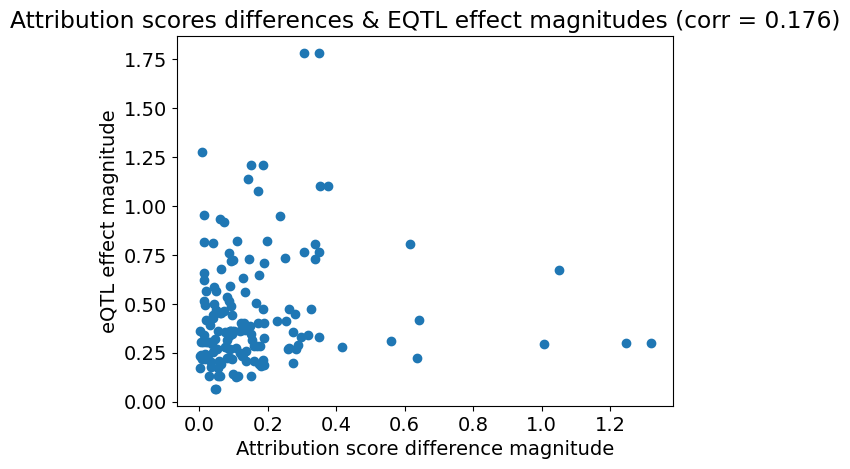

In [53]:
import scipy

#Plot predict effect vs slope
corr = scipy.stats.spearmanr(regions_reg.diff_att.abs(), regions_reg.slope.abs())
print(corr)
plt.scatter(regions_reg.diff_att.abs(), regions_reg.slope.abs())
plt.title("Attribution scores differences & EQTL effect magnitudes (corr = 0.176)")
plt.xlabel("Attribution score difference magnitude")
plt.ylabel("eQTL effect magnitude")
plt.show()

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

C T
ENSG00000213625.8
            motif_id    gene_name
1_65467698  MA1533.2        NR1I2
1_65467698  MA1534.2        NR1I3
1_65467698  MA1536.2        NR2C2
1_65467698  MA1952.2  FOXJ2::ELF1
1_65467698  MA0632.3        TCFL5
1_65467698  MA2325.1        EPAS1
1_65467698  MA1935.2   ERF::FOXI1
1_65467698  MA1947.2  ETV5::FOXO1
1_65467698  MA1106.2        HIF1A
1_65467698  MA0259.2  ARNT::HIF1A
1_65467698  MA2336.1      ZSCAN21
1_65467698  MA1729.2       ZNF680


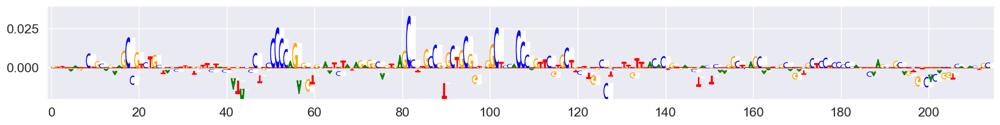

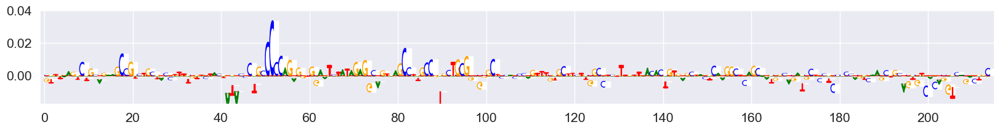

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

A AAAC
ENSG00000116774.11
             motif_id    gene_name
1_113979061  MA0140.3  GATA1::TAL1
1_113979061  MA0766.3        GATA5
1_113979061  MA1554.2         RFX7
1_113979061  MA0101.1          REL
1_113979061  MA0101.1          REL
1_113979061  MA0719.2       RHOXF1
1_113979061  MA0719.2       RHOXF1
1_113979061  MA0468.1         DUX4
1_113979061  MA0479.2        FOXH1


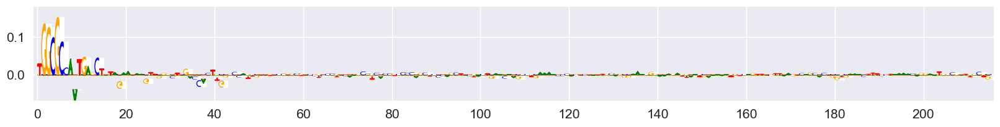

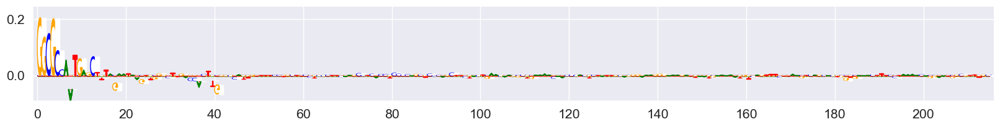

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

G A
ENSG00000160712.12
             motif_id gene_name
1_154420375  MA1516.2      KLF3
1_154420375  MA1726.2    ZNF331
1_154420375  MA1655.2    ZNF341
1_154420375  MA2121.1    ZNF213
1_154420375  MA0671.2      NFIX
1_154420375  MA0738.2      HIC2
1_154420375  MA0811.2    TFAP2B
1_154420375  MA0155.1     INSM1
1_154420375  MA0810.2    TFAP2A
1_154420375  MA0161.3      NFIC
1_154420375  MA0671.2      NFIX
1_154420375  MA0498.3     MEIS1
1_154420375  MA0498.3     MEIS1
1_154420375  MA0670.2      NFIA
1_154420375  MA0003.5    TFAP2A
1_154420375  MA0499.3     MYOD1
1_154420375  MA0812.2    TFAP2B
1_154420375  MA0812.2    TFAP2B
1_154420375  MA0814.3    TFAP2C
1_154420375  MA1569.2    TFAP2E
1_154420375  MA1569.2    TFAP2E
1_154420375  MA1631.2     ASCL1
1_154420375  MA0810.2    TFAP2A
1_154420375  MA0830.3      TCF4
1_154420375  MA1100.3     ASCL1
1_154420375  MA1100.3     ASCL1


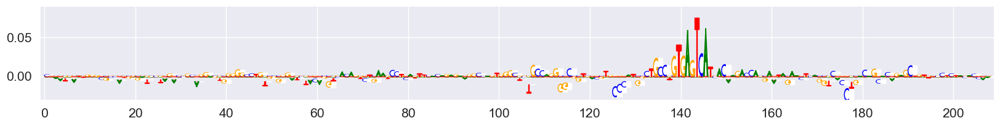

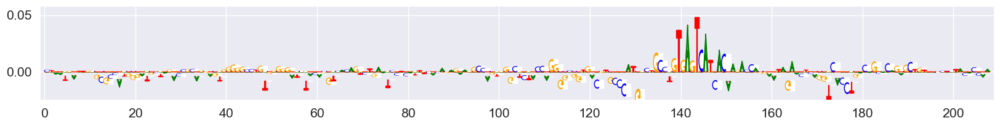

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

T C
ENSG00000185201.16
           motif_id   gene_name
11_308059  MA0847.4       FOXD2
11_308059  MA1561.2       SOX12
11_308059  MA0599.1        KLF5
11_308059  MA1728.2      ZNF549
11_308059  MA1969.2        THRA
11_308059  MA0671.2        NFIX
11_308059  MA0738.2        HIC2
11_308059  MA0646.2        GCM1
11_308059  MA0671.2        NFIX
11_308059  MA1535.2       NR2C1
11_308059  MA1536.2       NR2C2
11_308059  MA1111.2       NR2F2
11_308059  MA1149.2  RARA::RXRG
11_308059  MA0083.3         SRF
11_308059  MA0083.3         SRF
11_308059  MA1534.2       NR1I3
11_308059  MA1112.3       NR4A1
11_308059  MA0597.3       THAP1
11_308059  MA0160.3       NR4A2
11_308059  MA1530.2      NKX6-3
11_308059  MA1497.2       HOXA6
11_308059  MA1500.2       HOXB6
11_308059  MA1501.2       HOXB7
11_308059  MA1502.2       HOXB8
11_308059  MA0672.2      NKX2-3
11_308059  MA0673.2      NKX2-8
11_308059  MA0767.2        GCM2
11_308059  MA0910.3       HOXD8
11_308059  MA0893.3        GSX2
11_308059  MA1496

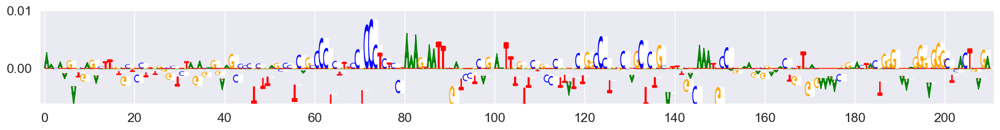

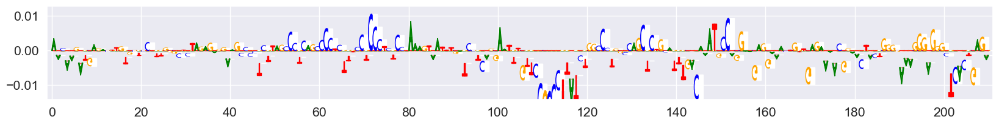

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

T A
ENSG00000129152.3
             motif_id gene_name
11_17688220  MA0038.3      GFI1
11_17688220  MA0674.2    NKX6-1
11_17688220  MA0710.2      NOTO
11_17688220  MA1501.2     HOXB7
11_17688220  MA0068.2      PAX4
...               ...       ...
11_17688220  MA1535.2     NR2C1
11_17688220  MA1536.2     NR2C2
11_17688220  MA1727.2    ZNF417
11_17688220  MA1548.2    PLAGL2
11_17688220  MA0504.2     NR2C2

[61 rows x 2 columns]


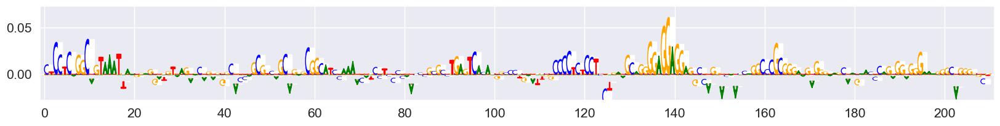

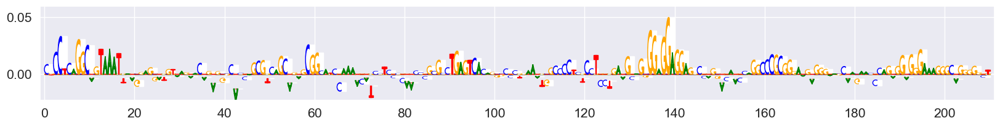

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

T C
ENSG00000161638.10
             motif_id   gene_name
12_54411590  MA1517.2        KLF6
12_54411590  MA0101.1         REL
12_54411590  MA1149.2  RARA::RXRG
12_54411590  MA0496.4        MAFK
12_54411590  MA1101.3       BACH2
...               ...         ...
12_54411590  MA0144.3       STAT3
12_54411590  MA1500.2       HOXB6
12_54411590  MA0081.3        SPIB
12_54411590  MA1558.2       SNAI1
12_54411590  MA0597.3       THAP1

[65 rows x 2 columns]


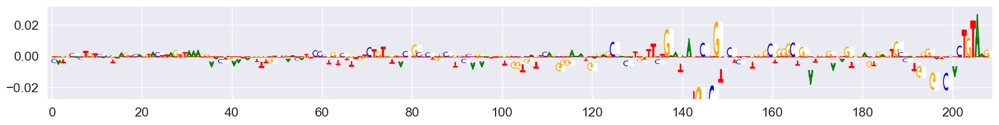

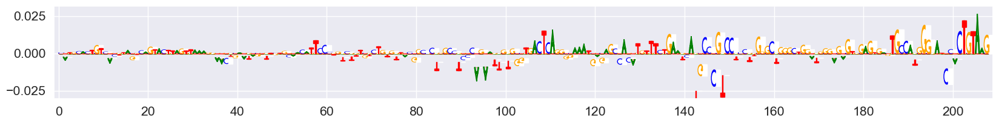

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

C G
ENSG00000233325.3
             motif_id gene_name
13_21298170  MA0798.3      RFX3
13_21298170  MA0798.3      RFX3
13_21298170  MA0509.3      RFX1
13_21298170  MA0509.3      RFX1
13_21298170  MA2121.1    ZNF213
13_21298170  MA1728.2    ZNF549
13_21298170  MA1554.2      RFX7
13_21298170  MA0510.3      RFX5
13_21298170  MA0510.3      RFX5
13_21298170  MA0600.3      RFX2
13_21298170  MA0600.3      RFX2
13_21298170  MA0671.2      NFIX
13_21298170  MA2326.1     IKZF2
13_21298170  MA0775.2     MEIS3
13_21298170  MA0597.3     THAP1
13_21298170  MA0144.3     STAT3
13_21298170  MA0161.3      NFIC
13_21298170  MA0769.3      TCF7
13_21298170  MA0670.2      NFIA
13_21298170  MA0671.2      NFIX
13_21298170  MA1116.2      RBPJ
13_21298170  MA0619.2     LIN54
13_21298170  MA1525.3    NFATC4
13_21298170  MA1708.2      ETV7
13_21298170  MA0798.3      RFX3
13_21298170  MA0798.3      RFX3
13_21298170  MA0509.3      RFX1
13_21298170  MA0509.3      RFX1
13_21298170  MA2121.1    ZNF213
13_21298170  MA172

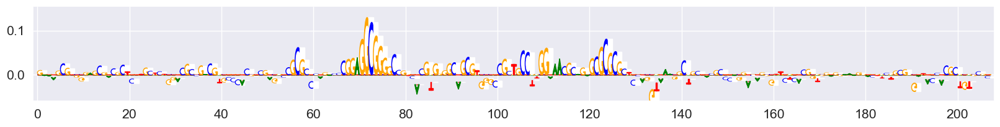

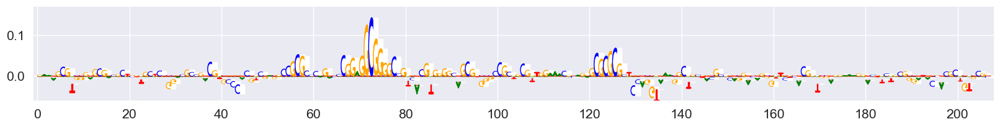

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

T C
ENSG00000224743.6
             motif_id gene_name
13_30906286  MA0696.1      ZIC1
13_30906286  MA0751.2      ZIC4
13_30906286  MA1513.2     KLF15
13_30906286  MA1515.2      KLF2
13_30906286  MA1959.2      KLF7
13_30906286  MA1716.2     ZNF76
13_30906286  MA1730.2    ZNF708
13_30906286  MA0738.2      HIC2
13_30906286  MA0646.2      GCM1
13_30906286  MA0872.1    TFAP2A
13_30906286  MA0872.1    TFAP2A
13_30906286  MA0815.1    TFAP2C
13_30906286  MA0815.1    TFAP2C
13_30906286  MA0813.1    TFAP2B
13_30906286  MA0811.2    TFAP2B
13_30906286  MA0810.2    TFAP2A
13_30906286  MA0524.3    TFAP2C
13_30906286  MA0813.1    TFAP2B
13_30906286  MA0812.2    TFAP2B
13_30906286  MA0812.2    TFAP2B
13_30906286  MA1569.2    TFAP2E
13_30906286  MA1569.2    TFAP2E
13_30906286  MA0524.3    TFAP2C
13_30906286  MA0810.2    TFAP2A
13_30906286  MA0811.2    TFAP2B


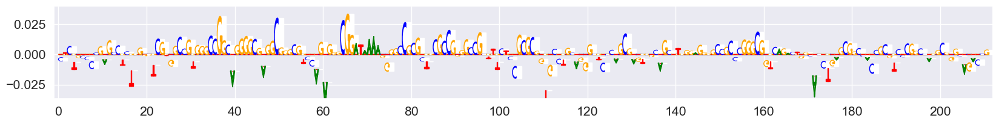

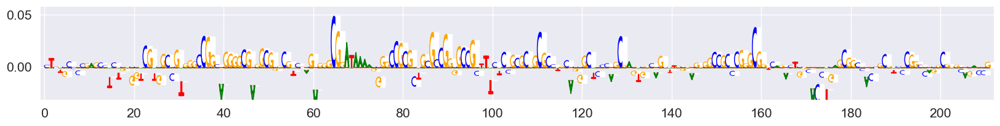

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

C T
ENSG00000120675.5
             motif_id gene_name
13_43023570  MA0775.2     MEIS3
13_43023570  MA1535.2     NR2C1
13_43023570  MA0813.1    TFAP2B
13_43023570  MA1536.2     NR2C2
13_43023570  MA0524.3    TFAP2C
13_43023570  MA0810.2    TFAP2A
13_43023570  MA0811.2    TFAP2B
13_43023570  MA0810.2    TFAP2A
13_43023570  MA0811.2    TFAP2B
13_43023570  MA0811.2    TFAP2B
13_43023570  MA0524.3    TFAP2C
13_43023570  MA0524.3    TFAP2C
13_43023570  MA1568.2     TCF21
13_43023570  MA1637.2      EBF3
13_43023570  MA0812.2    TFAP2B
13_43023570  MA0812.2    TFAP2B
13_43023570  MA1569.2    TFAP2E
13_43023570  MA1569.2    TFAP2E
13_43023570  MA0524.3    TFAP2C
13_43023570  MA0810.2    TFAP2A
13_43023570  MA0811.2    TFAP2B
13_43023570  MA0594.3     HOXA9


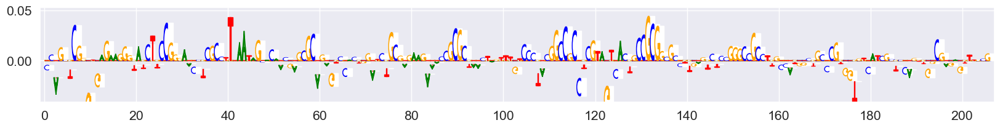

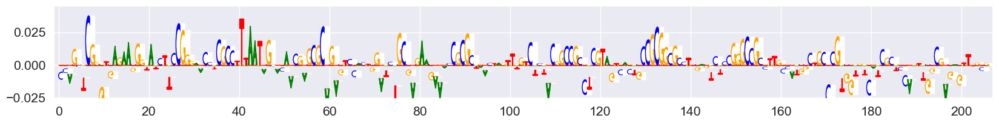

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

G A
ENSG00000272909.1
             motif_id    gene_name
14_64442433  MA0140.3  GATA1::TAL1
14_64442433  MA0144.3        STAT3
14_64442433  MA0137.4        STAT1
14_64442433  MA1500.2        HOXB6
14_64442433  MA0760.2          ERF
14_64442433  MA0763.2         ETV3
14_64442433  MA0765.4         ETV5
14_64442433  MA0670.2         NFIA
14_64442433  MA0671.2         NFIX
14_64442433  MA0775.2        MEIS3
14_64442433  MA0498.3        MEIS1
14_64442433  MA0671.2         NFIX
14_64442433  MA1523.2      MSANTD3
14_64442433  MA1563.2        SOX18


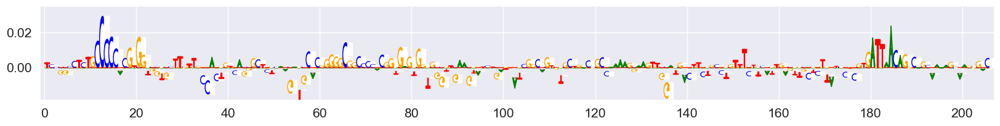

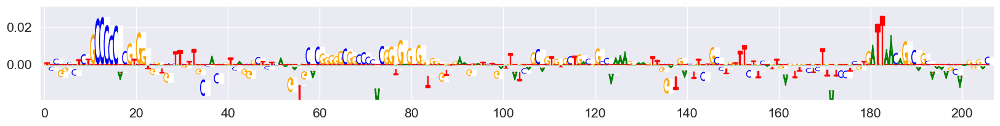

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

C G
ENSG00000259172.1
              motif_id gene_name
15_101116229  MA0163.1     PLAG1
15_101116229  MA1548.2    PLAGL2
15_101116229  MA1548.2    PLAGL2
15_101116229  MA1930.2      CTCF
15_101116229  MA1548.2    PLAGL2
15_101116229  MA1986.2    ZNF692
15_101116229  MA1102.3     CTCFL
15_101116229  MA1559.2     SNAI3
15_101116229  MA1100.3     ASCL1
15_101116229  MA1631.2     ASCL1
15_101116229  MA1100.3     ASCL1
15_101116229  MA0830.3      TCF4
15_101116229  MA0745.3     SNAI2
15_101116229  MA0103.4      ZEB1
15_101116229  MA0820.2     FIGLA
15_101116229  MA0522.4      TCF3
15_101116229  MA1558.2     SNAI1
15_101116229  MA1648.2     TCF12
15_101116229  MA1522.2       MAZ
15_101116229  MA0810.2    TFAP2A
15_101116229  MA0811.2    TFAP2B
15_101116229  MA1569.2    TFAP2E
15_101116229  MA1569.2    TFAP2E


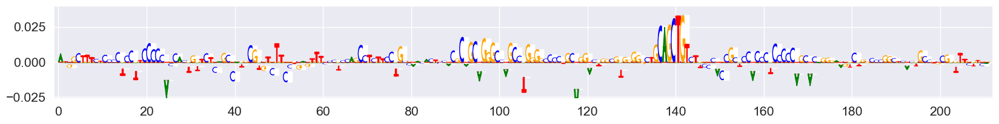

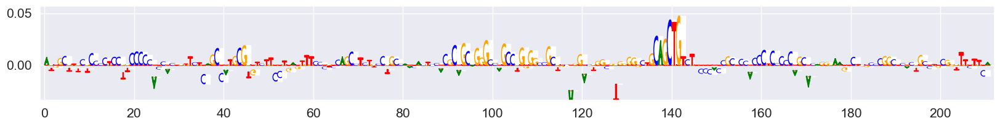

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

C T
ENSG00000006062.14
             motif_id gene_name
17_45043940  MA0815.1    TFAP2C
17_45043940  MA0815.1    TFAP2C
17_45043940  MA0872.1    TFAP2A
17_45043940  MA0872.1    TFAP2A
17_45043940  MA0524.3    TFAP2C
17_45043940  MA0813.1    TFAP2B
17_45043940  MA0811.2    TFAP2B
17_45043940  MA0810.2    TFAP2A
17_45043940  MA0813.1    TFAP2B
17_45043940  MA1102.3     CTCFL
17_45043940  MA0812.2    TFAP2B
17_45043940  MA0812.2    TFAP2B
17_45043940  MA1569.2    TFAP2E
17_45043940  MA1569.2    TFAP2E
17_45043940  MA2094.1      PAX8
17_45043940  MA0811.2    TFAP2B
17_45043940  MA0810.2    TFAP2A
17_45043940  MA1569.2    TFAP2E
17_45043940  MA1569.2    TFAP2E
17_45043940  MA1578.2     VEZF1
17_45043940  MA0524.3    TFAP2C
17_45043940  MA1569.2    TFAP2E
17_45043940  MA1569.2    TFAP2E
17_45043940  MA0830.3      TCF4
17_45043940  MA1100.3     ASCL1
17_45043940  MA1100.3     ASCL1
17_45043940  MA0103.4      ZEB1
17_45043940  MA0820.2     FIGLA
17_45043940  MA1536.2     NR2C2


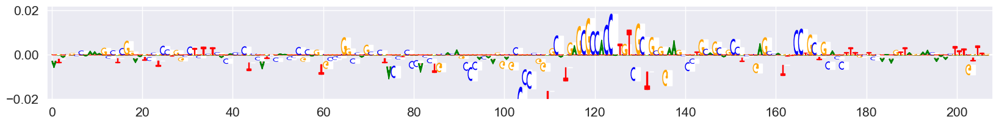

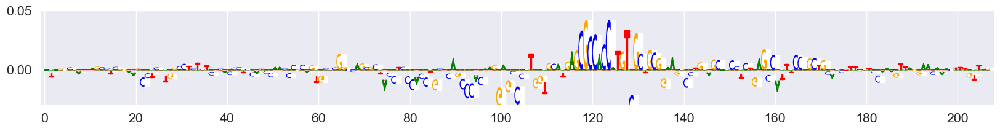

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

G A
ENSG00000173917.10
             motif_id gene_name
17_48530668  MA1712.2    ZNF454
17_48530668  MA1961.2     PATZ1
17_48530668  MA0746.3       SP3
17_48530668  MA0741.1     KLF16
17_48530668  MA1653.2    ZNF148
17_48530668  MA1512.2     KLF11
17_48530668  MA0162.5      EGR1
17_48530668  MA1564.2       SP9
17_48530668  MA0742.2     KLF12
17_48530668  MA0747.2       SP8
17_48530668  MA0599.1      KLF5
17_48530668  MA1517.2      KLF6
17_48530668  MA1511.2     KLF10
17_48530668  MA0740.2     KLF14
17_48530668  MA0685.2       SP4
17_48530668  MA0516.3       SP2
17_48530668  MA0079.5       SP1
17_48530668  MA0493.3      KLF1
17_48530668  MA1516.2      KLF3
17_48530668  MA0865.3      E2F8
17_48530668  MA1630.3    ZNF281
17_48530668  MA1959.2      KLF7
17_48530668  MA1650.2    ZBTB14
17_48530668  MA1522.2       MAZ
17_48530668  MA1513.2     KLF15
17_48530668  MA0632.3     TCFL5
17_48530668  MA0039.5      KLF4
17_48530668  MA1515.2      KLF2
17_48530668  MA0079.5       SP1
17_48530668  MA17

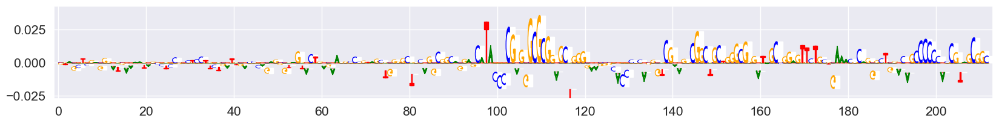

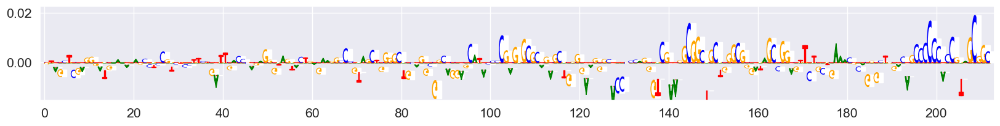

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

C G
ENSG00000134265.12
             motif_id gene_name
18_10520312  MA0088.2    ZNF143
18_10520312  MA1716.2     ZNF76
18_10520312  MA0524.3    TFAP2C
18_10520312  MA0810.2    TFAP2A
18_10520312  MA0811.2    TFAP2B
18_10520312  MA1602.2   ZSCAN29
18_10520312  MA0719.2    RHOXF1
18_10520312  MA1478.2    DMRTA2
18_10520312  MA0632.3     TCFL5
18_10520312  MA1650.2    ZBTB14


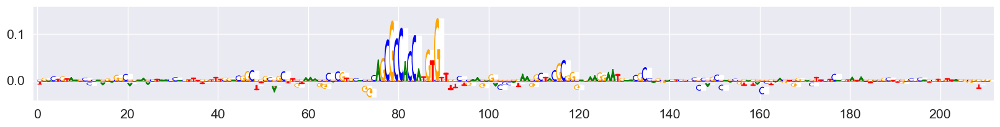

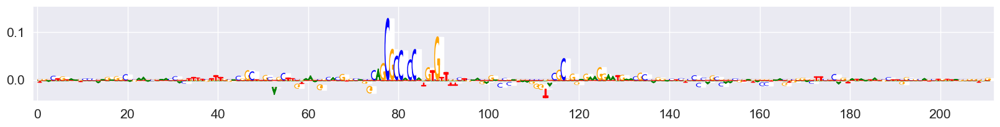

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

G T
ENSG00000101751.10
             motif_id gene_name
18_54269477  MA1580.1    ZBTB32
18_54269477  MA1542.2      OSR1
18_54269477  MA0712.3      OTX2
18_54269477  MA0719.2    RHOXF1
18_54269477  MA0714.2     PITX3
18_54269477  MA0711.2      OTX1
18_54269477  MA0682.3     PITX1


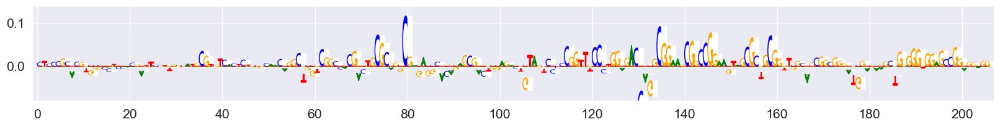

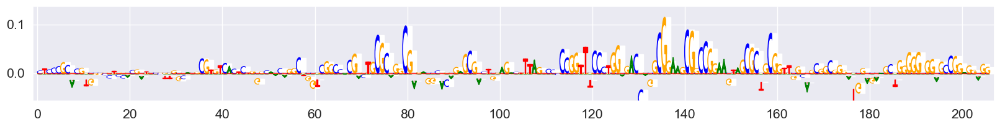

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

A G
ENSG00000108107.14
             motif_id gene_name
19_55385959  MA1529.2     NHLH2
19_55385959  MA1529.2     NHLH2
19_55385959  MA0670.2      NFIA
19_55385959  MA1116.2      RBPJ
19_55385959  MA0161.3      NFIC
19_55385959  MA1972.1     ZFP14
19_55385959  MA2326.1     IKZF2
19_55385959  MA1717.2    ZNF784
19_55385959  MA0685.2       SP4
19_55385959  MA0599.1      KLF5


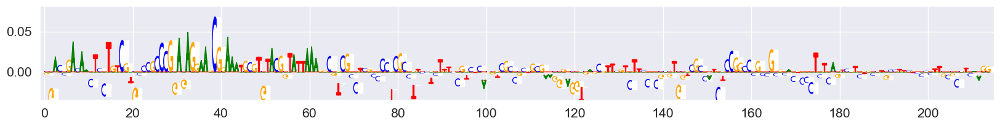

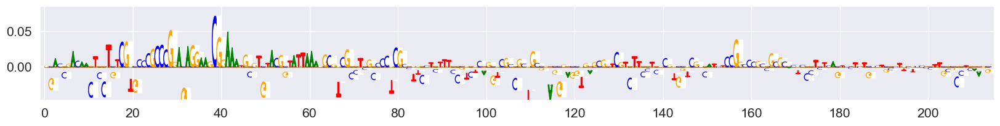

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

A C
ENSG00000138050.14
            motif_id gene_name
2_39779290  MA1516.2      KLF3
2_39779290  MA2096.1    ZNF524
2_39779290  MA0865.3      E2F8
2_39779290  MA0649.2      HEY2
2_39779290  MA0616.3      HES2
2_39779290  MA1122.2     TFDP1
2_39779290  MA1099.3      HES1
2_39779290  MA0471.3      E2F6
2_39779290  MA0821.2      HES5
2_39779290  MA0821.2      HES5
2_39779290  MA0823.1      HEY1
2_39779290  MA0810.2    TFAP2A
2_39779290  MA1982.2    ZNF574
2_39779290  MA0014.4      PAX5
2_39779290  MA0632.3     TCFL5
2_39779290  MA0632.3     TCFL5
2_39779290  MA0162.5      EGR1
2_39779290  MA1653.2    ZNF148
2_39779290  MA1099.3      HES1
2_39779290  MA0632.3     TCFL5
2_39779290  MA1522.2       MAZ
2_39779290  MA1713.2    ZNF610


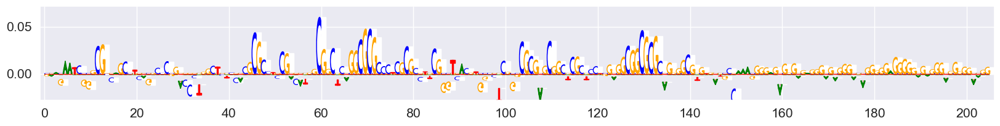

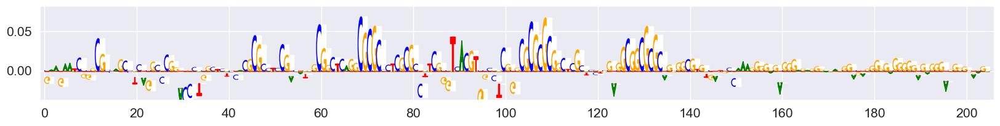

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

C T
ENSG00000157827.19
             motif_id gene_name
2_152594980  MA0137.4     STAT1
2_152594980  MA0144.3     STAT3
2_152594980  MA0471.3      E2F6
2_152594980  MA1122.2     TFDP1
2_152594980  MA0511.2     RUNX2
2_152594980  MA0865.3      E2F8
2_152594980  MA1578.2     VEZF1
2_152594980  MA0767.2      GCM2
2_152594980  MA1650.2    ZBTB14
2_152594980  MA0033.2     FOXL1
2_152594980  MA0850.1     FOXP3


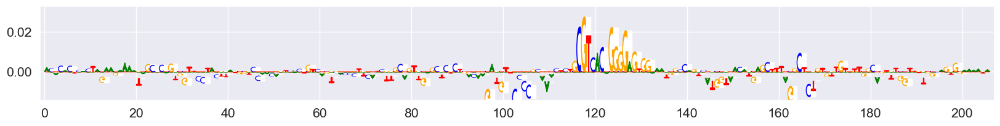

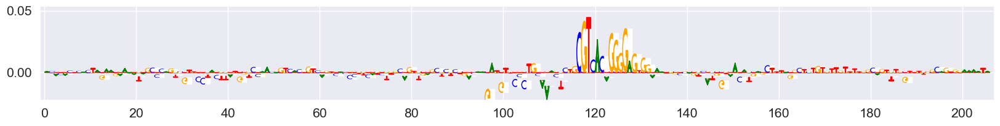

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

A C
ENSG00000003436.15
             motif_id     gene_name
2_187547635  MA1962.1  POU2F1::SOX2
2_187547635  MA1657.2        ZNF652
2_187547635  MA1534.2         NR1I3
2_187547635  MA0468.1          DUX4
2_187547635  MA0776.1         MYBL1
2_187547635  MA0895.2        HMBOX1
2_187547635  MA1480.2          DPRX
2_187547635  MA0635.2        BARHL2
2_187547635  MA0766.3         GATA5
2_187547635  MA0046.3         HNF1A
2_187547635  MA0153.2         HNF1B
2_187547635  MA0644.3          ESX1
2_187547635  MA0724.1         VENTX
2_187547635  MA1563.2         SOX18
2_187547635  MA1547.2         PITX2
2_187547635  MA0036.4         GATA2
2_187547635  MA0035.5         GATA1
2_187547635  MA0887.2          EVX1
2_187547635  MA0879.3          DLX1
2_187547635  MA0879.3          DLX1
2_187547635  MA0877.4        BARHL1
2_187547635  MA0876.2           BSX
2_187547635  MA1498.3         HOXA7
2_187547635  MA0875.2         BARX1
2_187547635  MA0721.2          UNCX
2_187547635  MA0719.2        RHOXF1
2_187

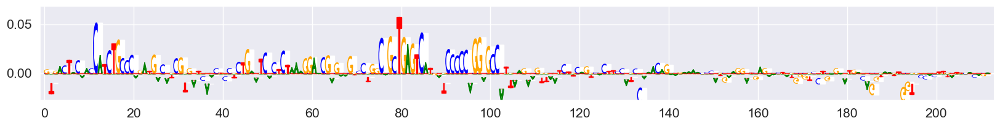

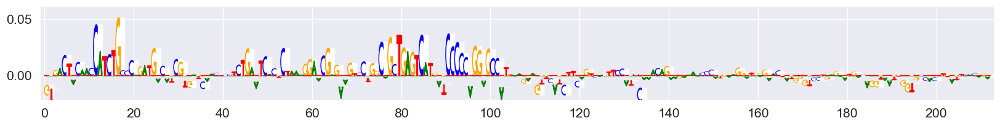

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

G A
ENSG00000187118.12
            motif_id     gene_name
3_28241610  MA1961.2         PATZ1
3_28241610  MA1713.2        ZNF610
3_28241610  MA1935.2    ERF::FOXI1
3_28241610  MA0641.1          ELF4
3_28241610  MA0740.2         KLF14
3_28241610  MA0516.3           SP2
3_28241610  MA0079.5           SP1
3_28241610  MA0748.3           YY2
3_28241610  MA1483.3          ELF2
3_28241610  MA1932.2  ELK1::HOXB13
3_28241610  MA1957.1   HOXB2::ELK1
3_28241610  MA1945.2   ETV5::FIGLA
3_28241610  MA1484.2          ETS2
3_28241610  MA0765.4          ETV5
3_28241610  MA0764.4          ETV4
3_28241610  MA0763.2          ETV3
3_28241610  MA0761.3          ETV1
3_28241610  MA0760.2           ERF
3_28241610  MA0759.3          ELK3
3_28241610  MA0475.3          FLI1
3_28241610  MA0762.2          ETV2
3_28241610  MA0156.4           FEV
3_28241610  MA0098.4          ETS1
3_28241610  MA0028.3          ELK1
3_28241610  MA0471.3          E2F6
3_28241610  MA0473.4          ELF1
3_28241610  MA1966.2   TFAP4::ET

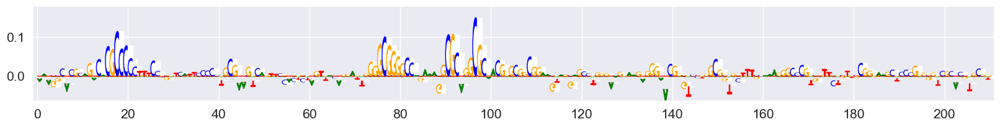

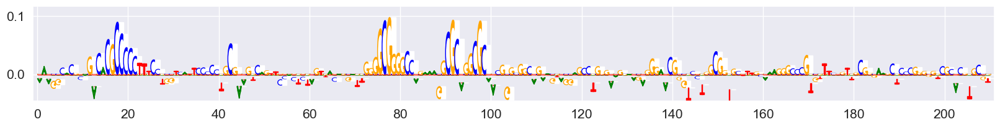

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

C CGGCGG
ENSG00000172936.12
            motif_id gene_name
3_38138612  MA0051.2      IRF2
3_38138612  MA0815.1    TFAP2C
3_38138612  MA0872.1    TFAP2A
3_38138612  MA0872.1    TFAP2A
3_38138612  MA0815.1    TFAP2C
3_38138612  MA0813.1    TFAP2B
3_38138612  MA0813.1    TFAP2B
3_38138612  MA0811.2    TFAP2B
3_38138612  MA0810.2    TFAP2A
3_38138612  MA0810.2    TFAP2A
3_38138612  MA0747.2       SP8
3_38138612  MA0524.3    TFAP2C
3_38138612  MA0812.2    TFAP2B
3_38138612  MA1961.2     PATZ1
3_38138612  MA0811.2    TFAP2B
3_38138612  MA0810.2    TFAP2A
3_38138612  MA0524.3    TFAP2C
3_38138612  MA1653.2    ZNF148
3_38138612  MA1569.2    TFAP2E
3_38138612  MA1569.2    TFAP2E
3_38138612  MA0814.3    TFAP2C
3_38138612  MA0812.2    TFAP2B
3_38138612  MA1648.2     TCF12
3_38138612  MA0522.4      TCF3
3_38138612  MA1569.2    TFAP2E
3_38138612  MA1569.2    TFAP2E
3_38138612  MA0067.3      PAX2
3_38138612  MA2094.1      PAX8
3_38138612  MA1522.2       MAZ
3_38138612  MA1959.2      KLF7
3_38138612 

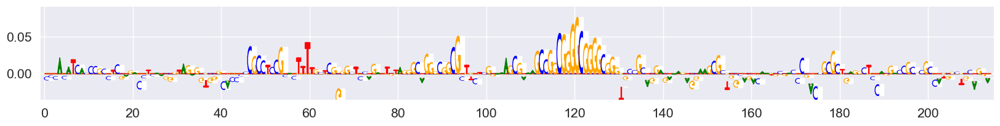

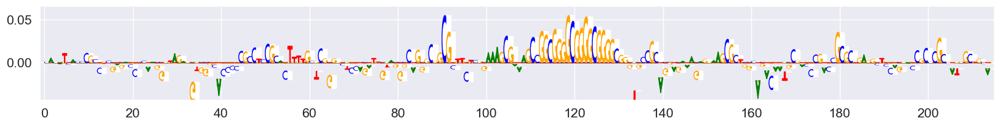

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

C A
ENSG00000162267.12
            motif_id gene_name
3_52835247  MA0658.2      LHX6
3_52835247  MA0068.2      PAX4
3_52835247  MA0060.4      NFYA
3_52835247  MA1644.2      NFYC
3_52835247  MA0502.3      NFYB
3_52835247  MA1117.2      RELB
3_52835247  MA0736.1     GLIS2
3_52835247  MA0811.2    TFAP2B
3_52835247  MA0524.3    TFAP2C
3_52835247  MA0810.2    TFAP2A
3_52835247  MA0810.2    TFAP2A
3_52835247  MA0810.2    TFAP2A
3_52835247  MA0811.2    TFAP2B
3_52835247  MA0811.2    TFAP2B
3_52835247  MA0524.3    TFAP2C
3_52835247  MA1569.2    TFAP2E
3_52835247  MA1569.2    TFAP2E
3_52835247  MA0524.3    TFAP2C
3_52835247  MA0810.2    TFAP2A
3_52835247  MA0811.2    TFAP2B
3_52835247  MA0524.3    TFAP2C
3_52835247  MA1569.2    TFAP2E
3_52835247  MA1569.2    TFAP2E
3_52835247  MA0814.3    TFAP2C
3_52835247  MA0812.2    TFAP2B
3_52835247  MA0812.2    TFAP2B
3_52835247  MA0003.5    TFAP2A


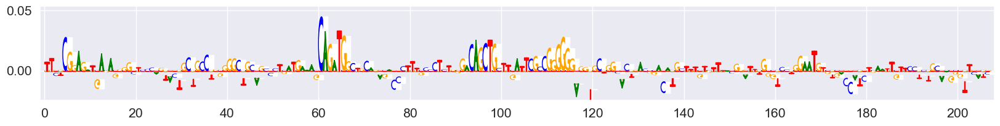

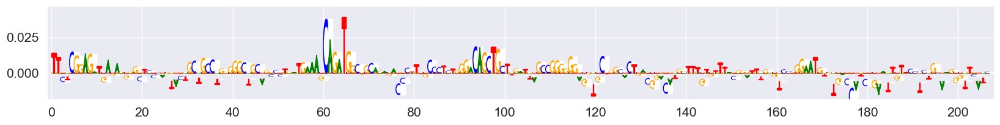

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

A G
ENSG00000250934.1
             motif_id gene_name
3_126287675  MA0144.3     STAT3
3_126287675  MA0625.3    NFATC3
3_126287675  MA1116.2      RBPJ
3_126287675  MA1525.3    NFATC4
3_126287675  MA0625.3    NFATC3
...               ...       ...
3_126287675  MA1642.2   NEUROG2
3_126287675  MA0104.5      MYCN
3_126287675  MA0104.5      MYCN
3_126287675  MA0147.4       MYC
3_126287675  MA0147.4       MYC

[76 rows x 2 columns]


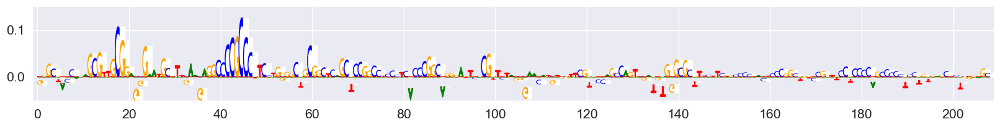

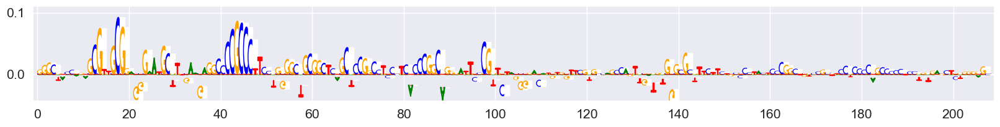

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

C CA
ENSG00000232874.1
             motif_id gene_name
3_194134863  MA0073.2     RREB1
3_194134863  MA0073.2     RREB1
3_194134863  MA0073.2     RREB1
3_194134863  MA0741.1     KLF16
3_194134863  MA1107.3      KLF9
...               ...       ...
3_194134863  MA1578.2     VEZF1
3_194134863  MA0039.5      KLF4
3_194134863  MA0767.2      GCM2
3_194134863  MA1515.2      KLF2
3_194134863  MA0493.3      KLF1

[81 rows x 2 columns]


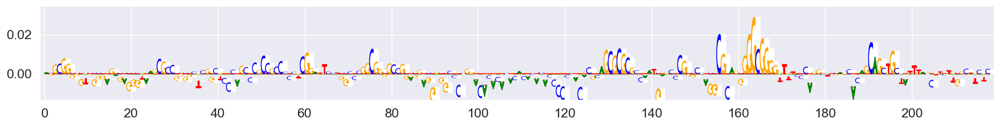

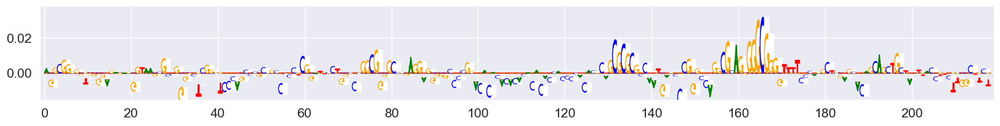

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

C T
ENSG00000152990.13
            motif_id gene_name
4_22492211  MA0599.1      KLF5
4_22492211  MA1644.2      NFYC
4_22492211  MA0060.4      NFYA
4_22492211  MA0695.2    ZBTB7C
4_22492211  MA2336.1   ZSCAN21


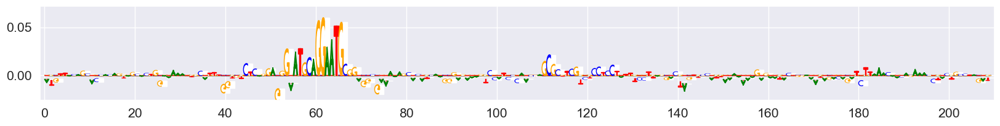

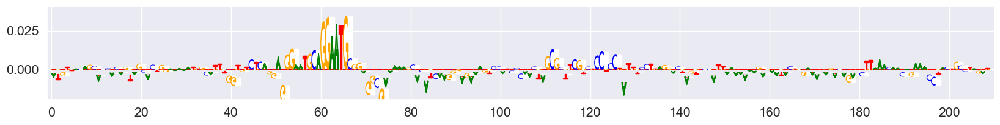

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

C G
ENSG00000109654.14
             motif_id gene_name
4_153222954  MA1979.2    ZNF416
4_153222954  MA0733.2      EGR4
4_153222954  MA0811.2    TFAP2B
4_153222954  MA0155.1     INSM1
4_153222954  MA0162.5      EGR1
4_153222954  MA0810.2    TFAP2A
4_153222954  MA1656.2    ZNF449
4_153222954  MA0695.2    ZBTB7C
4_153222954  MA2328.1     ZBED4
4_153222954  MA1650.2    ZBTB14
4_153222954  MA1986.2    ZNF692
4_153222954  MA0024.3      E2F1
4_153222954  MA0024.3      E2F1
4_153222954  MA0864.3      E2F2
4_153222954  MA0740.2     KLF14
4_153222954  MA1517.2      KLF6
4_153222954  MA0742.2     KLF12
4_153222954  MA0671.2      NFIX
4_153222954  MA0632.3     TCFL5
4_153222954  MA0865.3      E2F8
4_153222954  MA1986.2    ZNF692
4_153222954  MA1650.2    ZBTB14
4_153222954  MA1515.2      KLF2
4_153222954  MA1513.2     KLF15
4_153222954  MA0632.3     TCFL5
4_153222954  MA0014.4      PAX5
4_153222954  MA0738.2      HIC2
4_153222954  MA1099.3      HES1
4_153222954  MA0079.5       SP1
4_153222954  MA06

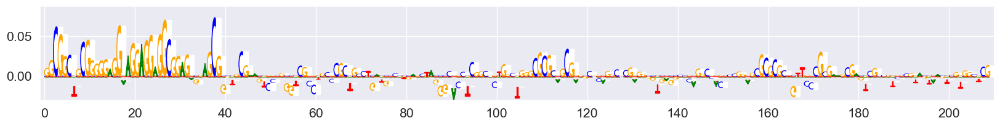

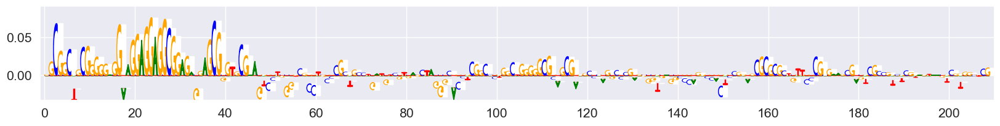

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

G T
ENSG00000137601.16
             motif_id gene_name
4_169612585  MA0767.2      GCM2
4_169612585  MA1534.2     NR1I3
4_169612585  MA1547.2     PITX2
4_169612585  MA0682.3     PITX1
4_169612585  MA0719.2    RHOXF1
4_169612585  MA0714.2     PITX3
4_169612585  MA0711.2      OTX1
4_169612585  MA0498.3     MEIS1
4_169612585  MA0867.3      SOX4
4_169612585  MA1569.2    TFAP2E
4_169612585  MA1569.2    TFAP2E
4_169612585  MA0442.3     SOX10
4_169612585  MA1152.2     SOX15


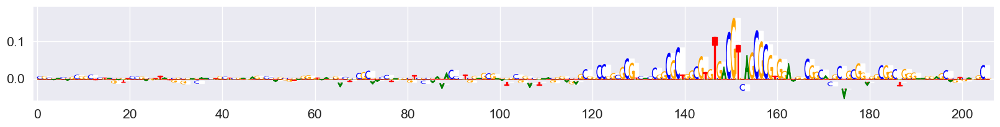

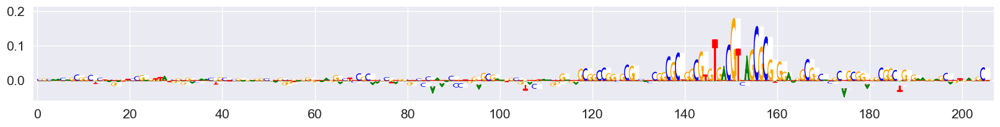

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

C A
ENSG00000152684.10
            motif_id    gene_name
5_52800100  MA0884.2         DUXA
5_52800100  MA1133.2    JUN::JUNB
5_52800100  MA1536.2        NR2C2
5_52800100  MA1127.1    FOSB::JUN
5_52800100  MA0492.2         JUND
5_52800100  MA1636.2        CEBPG
5_52800100  MA1145.2  FOSL2::JUND
5_52800100  MA1139.2  FOSL2::JUNB
5_52800100  MA1139.2  FOSL2::JUNB
5_52800100  MA1136.1   FOSB::JUNB
5_52800100  MA1136.1   FOSB::JUNB
5_52800100  MA1131.2   FOSL2::JUN
5_52800100  MA1131.2   FOSL2::JUN
5_52800100  MA1129.1   FOSL1::JUN
5_52800100  MA1129.1   FOSL1::JUN
5_52800100  MA1126.2     FOS::JUN
5_52800100  MA0838.1        CEBPG
5_52800100  MA1471.2        BARX2
5_52800100  MA1475.2      CREB3L4
5_52800100  MA0488.2          JUN
5_52800100  MA0605.3         ATF3
5_52800100  MA0605.3         ATF3
5_52800100  MA0639.2          DBP
5_52800100  MA0639.2          DBP
5_52800100  MA0656.2         JDP2
5_52800100  MA0656.2         JDP2
5_52800100  MA0833.3         ATF4
5_52800100  MA0834.2     

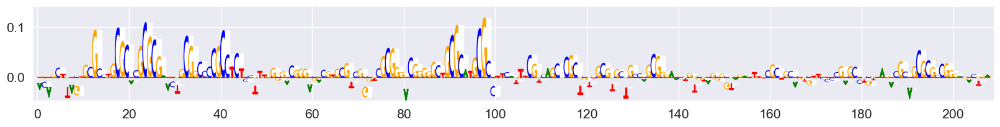

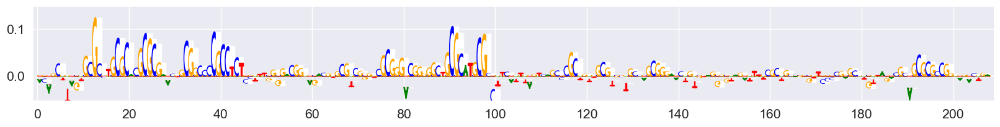

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

C T
ENSG00000113721.13
             motif_id   gene_name
5_150144550  MA1563.2       SOX18
5_150144550  MA1936.2  ERF::FOXO1
5_150144550  MA0258.2        ESR2
5_150144550  MA1545.2       OVOL2
5_150144550  MA1496.2       HOXA4
5_150144550  MA0594.3       HOXA9
5_150144550  MA1106.2       HIF1A
5_150144550  MA0595.1      SREBF1
5_150144550  MA0596.1      SREBF2
5_150144550  MA0671.2        NFIX


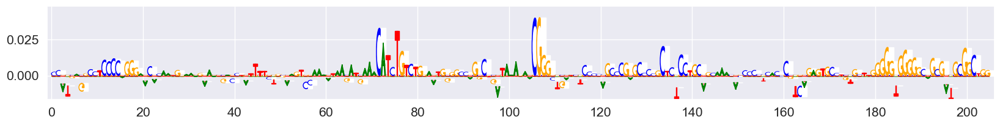

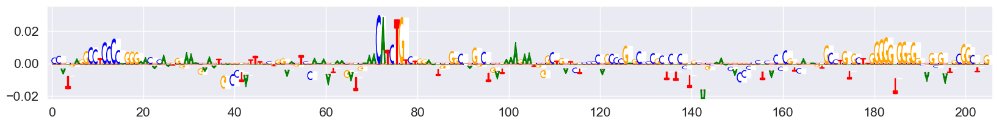

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

C T
ENSG00000196743.8
             motif_id gene_name
5_151239432  MA0472.2      EGR2
5_151239432  MA1564.2       SP9
5_151239432  MA0732.2      EGR3
5_151239432  MA0733.2      EGR4
5_151239432  MA1930.2      CTCF
5_151239432  MA0139.2      CTCF
5_151239432  MA0162.5      EGR1
5_151239432  MA0753.3    ZNF740
5_151239432  MA1548.2    PLAGL2
5_151239432  MA1982.2    ZNF574
5_151239432  MA0695.2    ZBTB7C
5_151239432  MA1102.3     CTCFL
5_151239432  MA1536.2     NR2C2
5_151239432  MA1578.2     VEZF1
5_151239432  MA1961.2     PATZ1
5_151239432  MA1578.2     VEZF1
5_151239432  MA1522.2       MAZ
5_151239432  MA1653.2    ZNF148
5_151239432  MA0810.2    TFAP2A
5_151239432  MA0672.2    NKX2-3
5_151239432  MA0673.2    NKX2-8
5_151239432  MA2003.2    NKX2-4
5_151239432  MA0470.3      E2F4
5_151239432  MA0864.3      E2F2


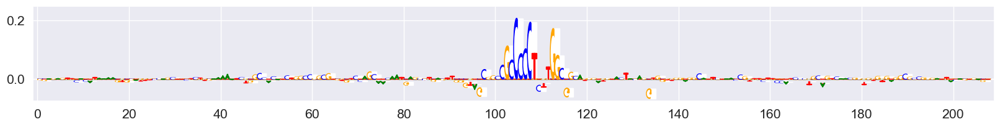

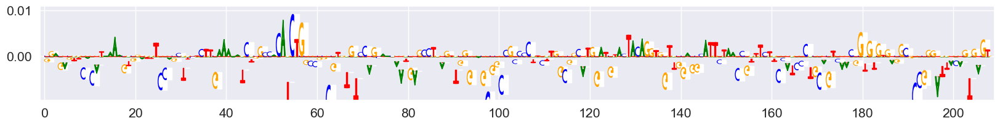

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

C T
ENSG00000158373.8
            motif_id gene_name
6_26171991  MA0162.5      EGR1
6_26171991  MA1721.2     ZNF93
6_26171991  MA1961.2     PATZ1
6_26171991  MA0810.2    TFAP2A
6_26171991  MA0733.2      EGR4
6_26171991  MA0732.2      EGR3
6_26171991  MA0472.2      EGR2
6_26171991  MA1554.2      RFX7
6_26171991  MA0079.5       SP1
6_26171991  MA0812.2    TFAP2B
6_26171991  MA1569.2    TFAP2E
6_26171991  MA1569.2    TFAP2E
6_26171991  MA0748.3       YY2
6_26171991  MA0599.1      KLF5
6_26171991  MA1713.2    ZNF610
6_26171991  MA1961.2     PATZ1
6_26171991  MA1653.2    ZNF148
6_26171991  MA1512.2     KLF11
6_26171991  MA0493.3      KLF1
6_26171991  MA1564.2       SP9
6_26171991  MA1517.2      KLF6
6_26171991  MA1511.2     KLF10
6_26171991  MA0742.2     KLF12
6_26171991  MA0740.2     KLF14
6_26171991  MA0685.2       SP4
6_26171991  MA0516.3       SP2
6_26171991  MA0079.5       SP1
6_26171991  MA1959.2      KLF7
6_26171991  MA1728.2    ZNF549
6_26171991  MA1522.2       MAZ
6_26171991  MA151

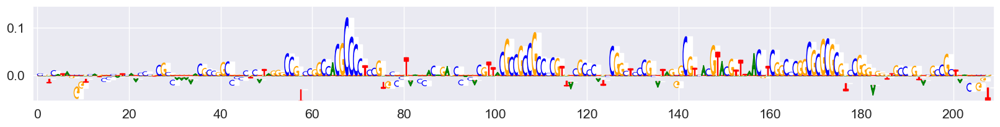

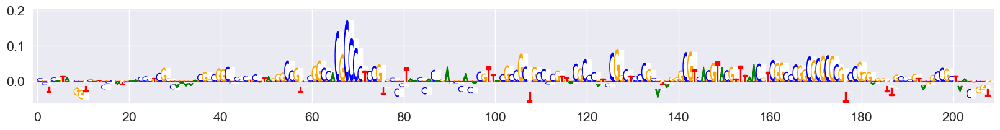

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

C T
ENSG00000135535.15
             motif_id gene_name
6_109318453  MA1536.2     NR2C2
6_109318453  MA0619.2     LIN54
6_109318453  MA0137.4     STAT1
6_109318453  MA0137.4     STAT1
6_109318453  MA0144.3     STAT3
6_109318453  MA0063.3    NKX2-5
6_109318453  MA0673.2    NKX2-8
6_109318453  MA0707.3      MNX1
6_109318453  MA0887.2      EVX1
6_109318453  MA0888.2      EVX2
6_109318453  MA0895.2    HMBOX1
6_109318453  MA1554.2      RFX7


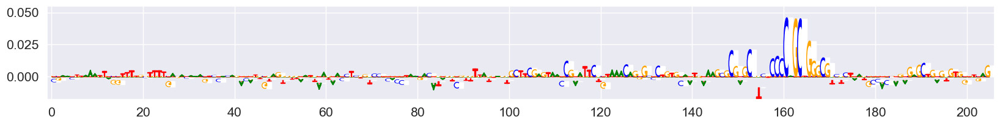

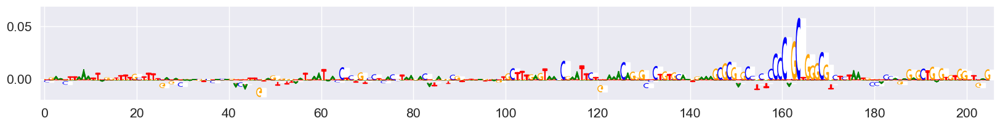

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

G A
ENSG00000175967.3
             motif_id    gene_name
6_113904066  MA1597.1       ZNF528
6_113904066  MA0492.2         JUND
6_113904066  MA0141.4        ESRRB
6_113904066  MA0488.2          JUN
6_113904066  MA1126.2     FOS::JUN
6_113904066  MA1136.1   FOSB::JUNB
6_113904066  MA1145.2  FOSL2::JUND
6_113904066  MA1632.2         ATF2
6_113904066  MA0492.2         JUND
6_113904066  MA0592.4        ESRRA
6_113904066  MA1475.2      CREB3L4
6_113904066  MA0071.1         RORA
6_113904066  MA1150.2         RORB
6_113904066  MA1151.2         RORC
6_113904066  MA0159.1   RARA::RXRA
6_113904066  MA1575.2         THRB
6_113904066  MA1575.2         THRB
6_113904066  MA1731.2       ZNF768
6_113904066  MA1965.2          SP5
6_113904066  MA0865.3         E2F8


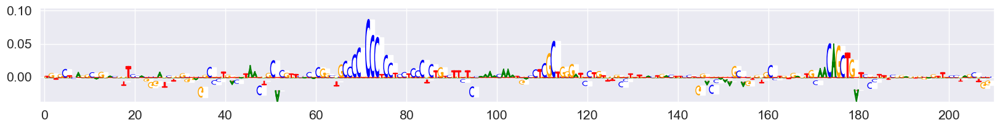

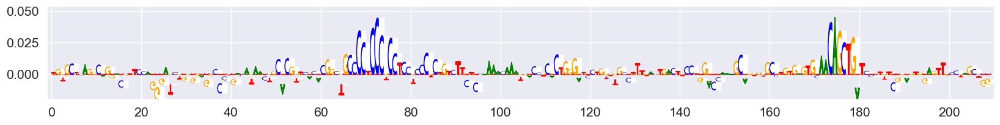

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

A T
ENSG00000070882.12
            motif_id gene_name
7_24883216  MA0836.3     CEBPD
7_24883216  MA0047.4     FOXA2
7_24883216  MA0593.2     FOXP2
7_24883216  MA2118.1     FOXS1
7_24883216  MA0047.4     FOXA2
...              ...       ...
7_24883216  MA0500.3      MYOG
7_24883216  MA0745.3     SNAI2
7_24883216  MA0830.3      TCF4
7_24883216  MA1100.3     ASCL1
7_24883216  MA1109.2   NEUROD1

[61 rows x 2 columns]


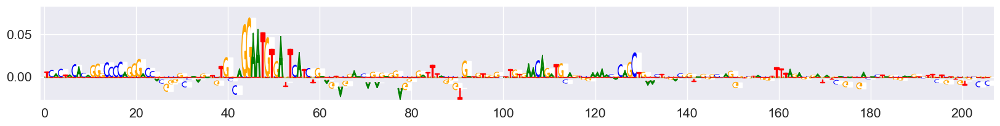

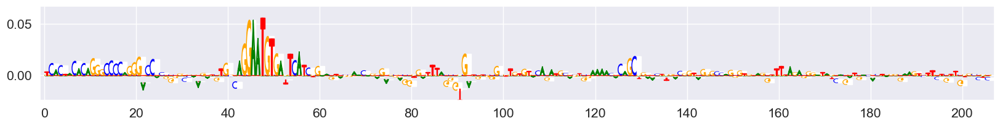

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

C G
ENSG00000106628.10
            motif_id gene_name
7_44123530  MA0808.1     TEAD3
7_44123530  MA0764.4      ETV4
7_44123530  MA1484.2      ETS2
7_44123530  MA0625.3    NFATC3
7_44123530  MA0471.3      E2F6
7_44123530  MA1122.2     TFDP1
7_44123530  MA0865.3      E2F8
7_44123530  MA0599.1      KLF5
7_44123530  MA1513.2     KLF15
7_44123530  MA0516.3       SP2
7_44123530  MA0740.2     KLF14
7_44123530  MA1578.2     VEZF1
7_44123530  MA0748.3       YY2
7_44123530  MA0775.2     MEIS3
7_44123530  MA1516.2      KLF3
7_44123530  MA1599.2    ZNF682
7_44123530  MA0502.3      NFYB
7_44123530  MA0670.2      NFIA
7_44123530  MA0671.2      NFIX
7_44123530  MA0498.3     MEIS1
7_44123530  MA0599.1      KLF5
7_44123530  MA0741.1     KLF16


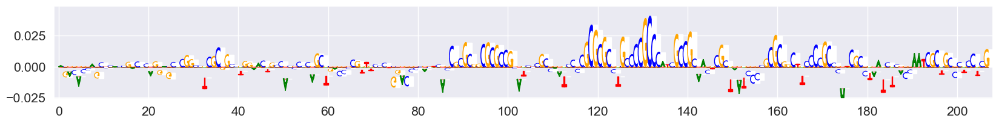

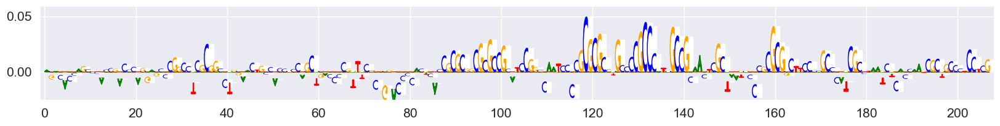

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

C T
ENSG00000197157.10
             motif_id gene_name
7_127651950  MA1587.1    ZNF135
7_127651950  MA1653.2    ZNF148
7_127651950  MA2329.1    ZBTB11
7_127651950  MA0685.2       SP4
7_127651950  MA1717.2    ZNF784
7_127651950  MA0625.3    NFATC3
7_127651950  MA0471.3      E2F6
7_127651950  MA1579.2    ZBTB26
7_127651950  MA0865.3      E2F8
7_127651950  MA1964.2     SMAD2
7_127651950  MA0748.3       YY2
7_127651950  MA0160.3     NR4A2
7_127651950  MA1536.2     NR2C2
7_127651950  MA1535.2     NR2C1
7_127651950  MA0498.3     MEIS1
7_127651950  MA1500.2     HOXB6
7_127651950  MA1563.2     SOX18
7_127651950  MA0158.2     HOXA5
7_127651950  MA0158.2     HOXA5
7_127651950  MA2119.1     HOXA3
7_127651950  MA2093.1     HOXB1
7_127651950  MA1549.2    POU6F1
7_127651950  MA1502.2     HOXB8
7_127651950  MA1501.2     HOXB7
7_127651950  MA1497.2     HOXA6
7_127651950  MA1496.2     HOXA4
7_127651950  MA0910.3     HOXD8
7_127651950  MA0893.3      GSX2
7_127651950  MA0710.2      NOTO
7_127651950  MA07

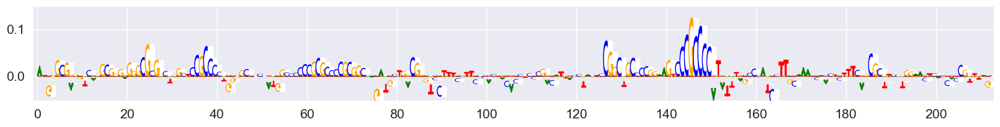

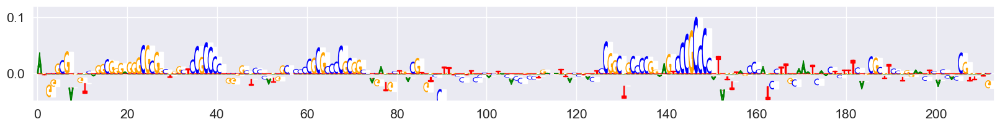

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

T TCACACTA
ENSG00000225434.2
            motif_id gene_name
9_72305384  MA0698.2    ZBTB18
9_72305384  MA1570.1     TFAP4
9_72305384  MA1570.1     TFAP4
9_72305384  MA1568.2     TCF21
9_72305384  MA1493.1      HES6
...              ...       ...
9_72305384  MA1525.3    NFATC4
9_72305384  MA0130.1   ZNF354C
9_72305384  MA0625.3    NFATC3
9_72305384  MA1116.2      RBPJ
9_72305384  MA2120.1    ZNF184

[75 rows x 2 columns]


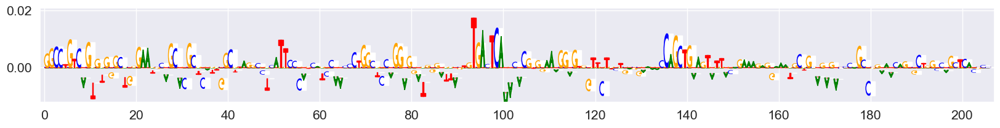

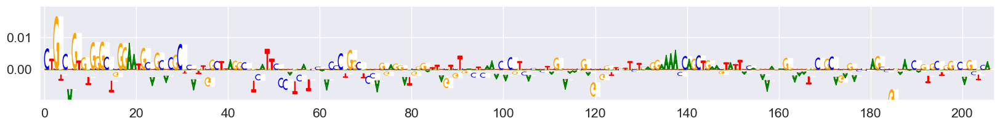

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

C A
ENSG00000162368.13
            motif_id gene_name
1_47503295  MA0258.2      ESR2
1_47503295  MA0258.2      ESR2
1_47503295  MA1982.2    ZNF574
1_47503295  MA0131.3     HINFP
1_47503295  MA0775.2     MEIS3
1_47503295  MA1536.2     NR2C2
1_47503295  MA1535.2     NR2C1
1_47503295  MA0498.3     MEIS1
1_47503295  MA0738.2      HIC2
1_47503295  MA0625.3    NFATC3
1_47503295  MA0810.2    TFAP2A
1_47503295  MA0524.3    TFAP2C
1_47503295  MA0811.2    TFAP2B
1_47503295  MA1602.2   ZSCAN29
1_47503295  MA0524.3    TFAP2C
1_47503295  MA0147.4       MYC
1_47503295  MA0147.4       MYC
1_47503295  MA0104.5      MYCN
1_47503295  MA0104.5      MYCN
1_47503295  MA0819.3     CLOCK
1_47503295  MA0820.2     FIGLA
1_47503295  MA0825.2       MNT
1_47503295  MA0819.3     CLOCK
1_47503295  MA0825.2       MNT
1_47503295  MA0058.4       MAX
1_47503295  MA0058.4       MAX


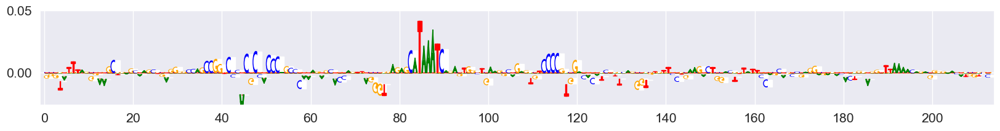

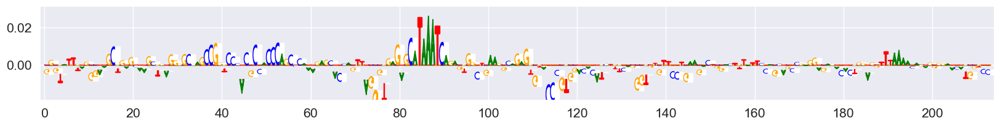

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

T A
ENSG00000129152.3
             motif_id gene_name
11_17688220  MA0038.3      GFI1
11_17688220  MA0674.2    NKX6-1
11_17688220  MA0710.2      NOTO
11_17688220  MA1501.2     HOXB7
11_17688220  MA0068.2      PAX4
...               ...       ...
11_17688220  MA1535.2     NR2C1
11_17688220  MA1536.2     NR2C2
11_17688220  MA1727.2    ZNF417
11_17688220  MA1548.2    PLAGL2
11_17688220  MA0504.2     NR2C2

[61 rows x 2 columns]


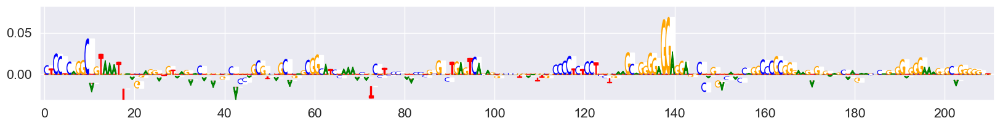

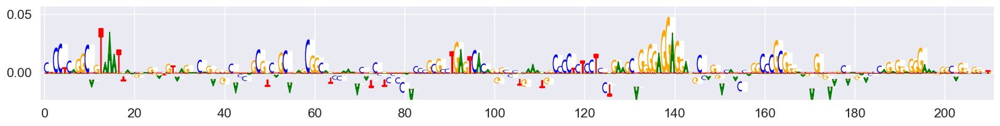

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

T C
ENSG00000224743.6
             motif_id gene_name
13_30906286  MA0696.1      ZIC1
13_30906286  MA0751.2      ZIC4
13_30906286  MA1513.2     KLF15
13_30906286  MA1515.2      KLF2
13_30906286  MA1959.2      KLF7
13_30906286  MA1716.2     ZNF76
13_30906286  MA1730.2    ZNF708
13_30906286  MA0738.2      HIC2
13_30906286  MA0646.2      GCM1
13_30906286  MA0872.1    TFAP2A
13_30906286  MA0872.1    TFAP2A
13_30906286  MA0815.1    TFAP2C
13_30906286  MA0815.1    TFAP2C
13_30906286  MA0813.1    TFAP2B
13_30906286  MA0811.2    TFAP2B
13_30906286  MA0810.2    TFAP2A
13_30906286  MA0524.3    TFAP2C
13_30906286  MA0813.1    TFAP2B
13_30906286  MA0812.2    TFAP2B
13_30906286  MA0812.2    TFAP2B
13_30906286  MA1569.2    TFAP2E
13_30906286  MA1569.2    TFAP2E
13_30906286  MA0524.3    TFAP2C
13_30906286  MA0810.2    TFAP2A
13_30906286  MA0811.2    TFAP2B


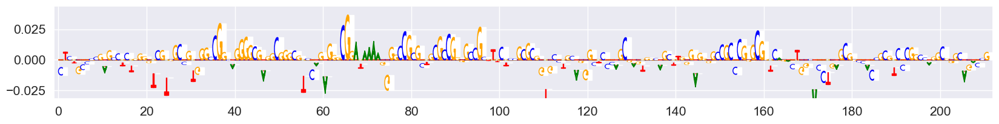

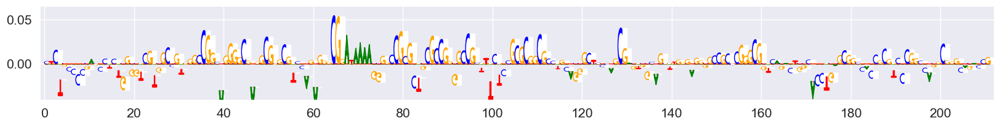

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

G A
ENSG00000173917.10
             motif_id gene_name
17_48530668  MA1712.2    ZNF454
17_48530668  MA1961.2     PATZ1
17_48530668  MA0746.3       SP3
17_48530668  MA0741.1     KLF16
17_48530668  MA1653.2    ZNF148
17_48530668  MA1512.2     KLF11
17_48530668  MA0162.5      EGR1
17_48530668  MA1564.2       SP9
17_48530668  MA0742.2     KLF12
17_48530668  MA0747.2       SP8
17_48530668  MA0599.1      KLF5
17_48530668  MA1517.2      KLF6
17_48530668  MA1511.2     KLF10
17_48530668  MA0740.2     KLF14
17_48530668  MA0685.2       SP4
17_48530668  MA0516.3       SP2
17_48530668  MA0079.5       SP1
17_48530668  MA0493.3      KLF1
17_48530668  MA1516.2      KLF3
17_48530668  MA0865.3      E2F8
17_48530668  MA1630.3    ZNF281
17_48530668  MA1959.2      KLF7
17_48530668  MA1650.2    ZBTB14
17_48530668  MA1522.2       MAZ
17_48530668  MA1513.2     KLF15
17_48530668  MA0632.3     TCFL5
17_48530668  MA0039.5      KLF4
17_48530668  MA1515.2      KLF2
17_48530668  MA0079.5       SP1
17_48530668  MA17

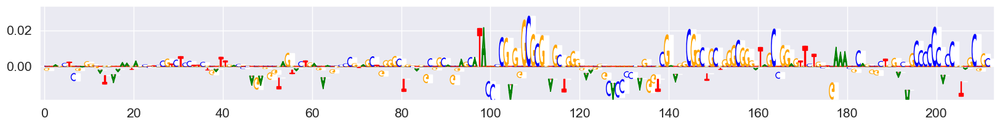

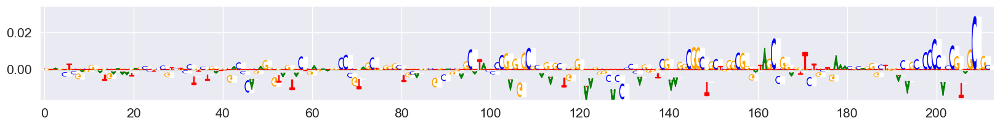

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

A G
ENSG00000250934.1
             motif_id gene_name
3_126287675  MA0144.3     STAT3
3_126287675  MA0625.3    NFATC3
3_126287675  MA1116.2      RBPJ
3_126287675  MA1525.3    NFATC4
3_126287675  MA0625.3    NFATC3
...               ...       ...
3_126287675  MA1642.2   NEUROG2
3_126287675  MA0104.5      MYCN
3_126287675  MA0104.5      MYCN
3_126287675  MA0147.4       MYC
3_126287675  MA0147.4       MYC

[76 rows x 2 columns]


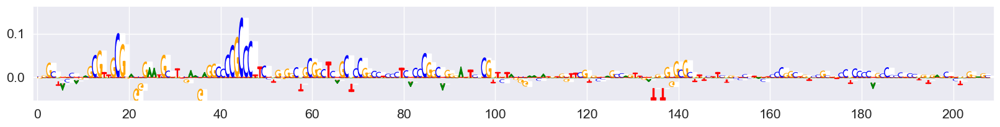

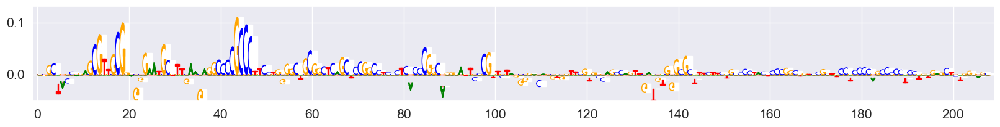

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

C CA
ENSG00000232874.1
             motif_id gene_name
3_194134863  MA0073.2     RREB1
3_194134863  MA0073.2     RREB1
3_194134863  MA0073.2     RREB1
3_194134863  MA0741.1     KLF16
3_194134863  MA1107.3      KLF9
...               ...       ...
3_194134863  MA1578.2     VEZF1
3_194134863  MA0039.5      KLF4
3_194134863  MA0767.2      GCM2
3_194134863  MA1515.2      KLF2
3_194134863  MA0493.3      KLF1

[81 rows x 2 columns]


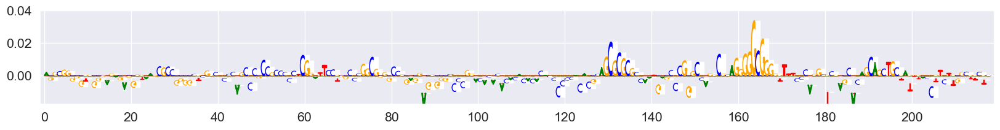

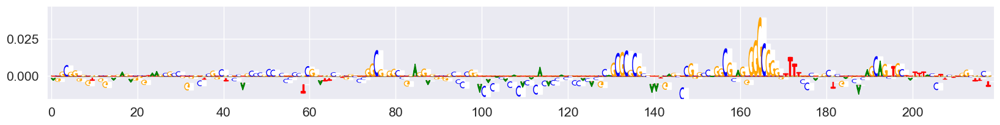

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

T G
ENSG00000174137.12
           motif_id gene_name
4_1684252  MA1584.2      ZIC5
4_1684252  MA0696.1      ZIC1
4_1684252  MA0736.1     GLIS2
4_1684252  MA0751.2      ZIC4
4_1684252  MA0810.2    TFAP2A
4_1684252  MA0472.2      EGR2
4_1684252  MA0162.5      EGR1
4_1684252  MA1723.2     PRDM9
4_1684252  MA1512.2     KLF11
4_1684252  MA1961.2     PATZ1
4_1684252  MA1107.3      KLF9
4_1684252  MA0741.1     KLF16
4_1684252  MA1653.2    ZNF148
4_1684252  MA1630.3    ZNF281
4_1684252  MA1564.2       SP9
4_1684252  MA0162.5      EGR1
4_1684252  MA1515.2      KLF2
4_1684252  MA0695.2    ZBTB7C
4_1684252  MA0522.4      TCF3
4_1684252  MA0079.5       SP1
4_1684252  MA1517.2      KLF6
4_1684252  MA1511.2     KLF10
4_1684252  MA0599.1      KLF5
4_1684252  MA0742.2     KLF12
4_1684252  MA1578.2     VEZF1
4_1684252  MA0740.2     KLF14
4_1684252  MA1536.2     NR2C2
4_1684252  MA0039.5      KLF4
4_1684252  MA0493.3      KLF1
4_1684252  MA0801.1       MGA
4_1684252  MA0806.1      TBX4
4_1684252  MA0807

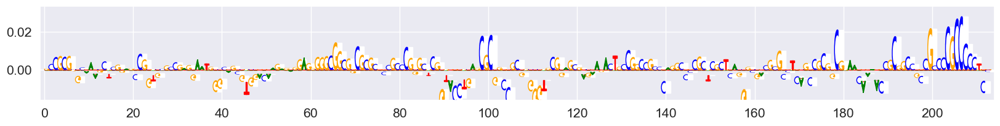

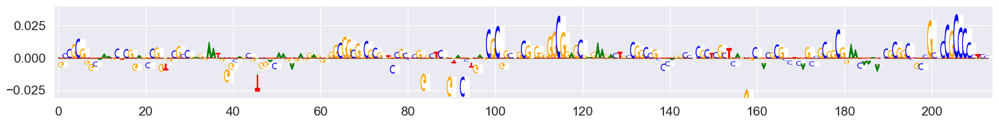

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

G T
ENSG00000182552.14
             motif_id gene_name
4_183619597  MA1981.2    ZNF530
4_183619597  MA1723.2     PRDM9
4_183619597  MA0504.2     NR2C2
4_183619597  MA1514.2     KLF17
4_183619597  MA0747.2       SP8
...               ...       ...
4_183619597  MA1717.2    ZNF784
4_183619597  MA0131.3     HINFP
4_183619597  MA1578.2     VEZF1
4_183619597  MA0738.2      HIC2
4_183619597  MA0130.1   ZNF354C

[85 rows x 2 columns]


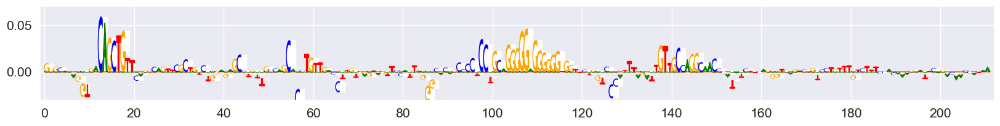

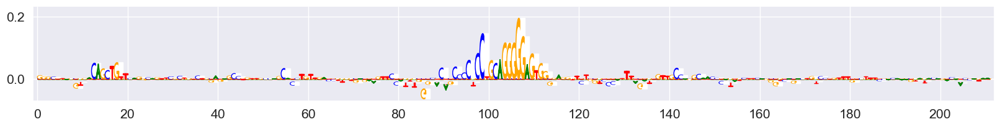

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

C G
ENSG00000145777.14
             motif_id    gene_name
5_111073369  MA1723.2        PRDM9
5_111073369  MA0067.3         PAX2
5_111073369  MA0779.2         PAX1
5_111073369  MA0781.2         PAX9
5_111073369  MA2094.1         PAX8
5_111073369  MA0599.1         KLF5
5_111073369  MA1537.2        NR2F1
5_111073369  MA1574.2         THRB
5_111073369  MA0504.2        NR2C2
5_111073369  MA0855.1         RXRB
5_111073369  MA0856.1         RXRG
5_111073369  MA1550.2        PPARD
5_111073369  MA1148.2  PPARA::RXRA
5_111073369  MA1500.2        HOXB6
5_111073369  MA0017.3        NR2F1
5_111073369  MA1710.2       ZNF257
5_111073369  MA0014.4         PAX5
5_111073369  MA1964.2        SMAD2
5_111073369  MA2324.1       BCL11A
5_111073369  MA0488.2          JUN
5_111073369  MA1632.2         ATF2
5_111073369  MA0492.2         JUND
5_111073369  MA2120.1       ZNF184
5_111073369  MA0160.3        NR4A2
5_111073369  MA1112.3        NR4A1
5_111073369  MA1534.2        NR1I3
5_111073369  MA0071.1         RO

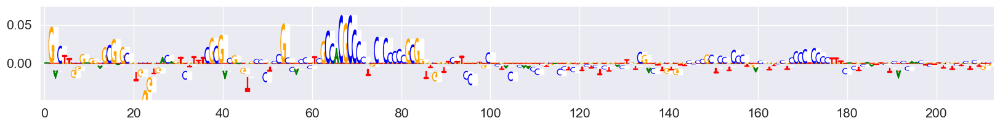

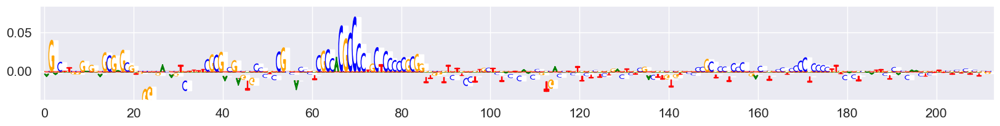

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

C T
ENSG00000113721.13
             motif_id   gene_name
5_150144550  MA1563.2       SOX18
5_150144550  MA1936.2  ERF::FOXO1
5_150144550  MA0258.2        ESR2
5_150144550  MA1545.2       OVOL2
5_150144550  MA1496.2       HOXA4
5_150144550  MA0594.3       HOXA9
5_150144550  MA1106.2       HIF1A
5_150144550  MA0595.1      SREBF1
5_150144550  MA0596.1      SREBF2
5_150144550  MA0671.2        NFIX


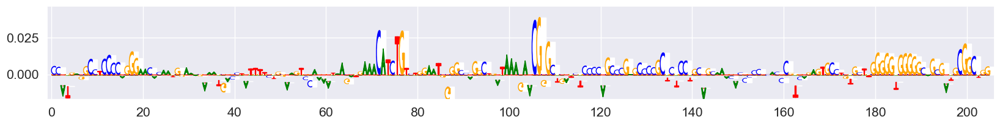

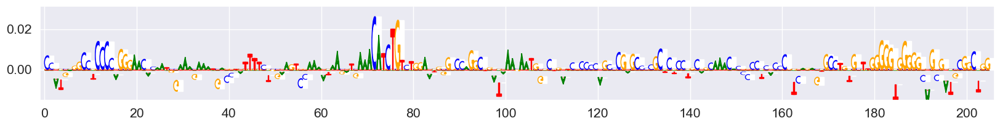

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

C T
ENSG00000196743.8
             motif_id gene_name
5_151239432  MA0472.2      EGR2
5_151239432  MA1564.2       SP9
5_151239432  MA0732.2      EGR3
5_151239432  MA0733.2      EGR4
5_151239432  MA1930.2      CTCF
5_151239432  MA0139.2      CTCF
5_151239432  MA0162.5      EGR1
5_151239432  MA0753.3    ZNF740
5_151239432  MA1548.2    PLAGL2
5_151239432  MA1982.2    ZNF574
5_151239432  MA0695.2    ZBTB7C
5_151239432  MA1102.3     CTCFL
5_151239432  MA1536.2     NR2C2
5_151239432  MA1578.2     VEZF1
5_151239432  MA1961.2     PATZ1
5_151239432  MA1578.2     VEZF1
5_151239432  MA1522.2       MAZ
5_151239432  MA1653.2    ZNF148
5_151239432  MA0810.2    TFAP2A
5_151239432  MA0672.2    NKX2-3
5_151239432  MA0673.2    NKX2-8
5_151239432  MA2003.2    NKX2-4
5_151239432  MA0470.3      E2F4
5_151239432  MA0864.3      E2F2


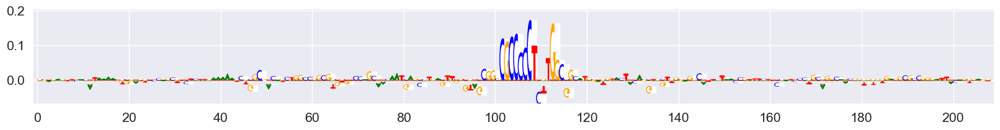

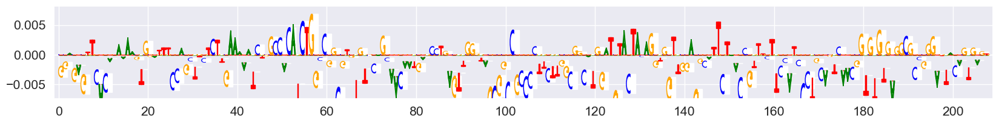

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

A T
ENSG00000070882.12
            motif_id gene_name
7_24883216  MA0836.3     CEBPD
7_24883216  MA0047.4     FOXA2
7_24883216  MA0593.2     FOXP2
7_24883216  MA2118.1     FOXS1
7_24883216  MA0047.4     FOXA2
...              ...       ...
7_24883216  MA0500.3      MYOG
7_24883216  MA0745.3     SNAI2
7_24883216  MA0830.3      TCF4
7_24883216  MA1100.3     ASCL1
7_24883216  MA1109.2   NEUROD1

[61 rows x 2 columns]


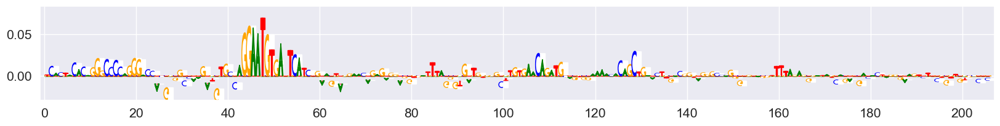

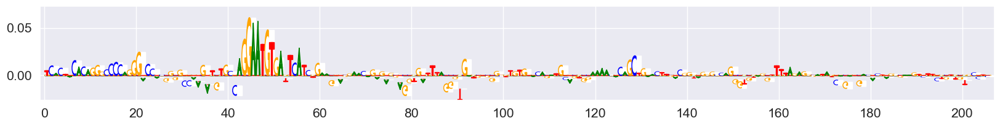

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

C A
ENSG00000117118.9
            motif_id     gene_name
1_17054158  MA1966.2   TFAP4::ETV1
1_17054158  MA1957.1   HOXB2::ELK1
1_17054158  MA0811.2        TFAP2B
1_17054158  MA0641.1          ELF4
1_17054158  MA0687.2          SPIC
1_17054158  MA0810.2        TFAP2A
1_17054158  MA0062.4         GABPA
1_17054158  MA2329.1        ZBTB11
1_17054158  MA1708.2          ETV7
1_17054158  MA0750.3        ZBTB7A
1_17054158  MA0645.2          ETV6
1_17054158  MA0076.3          ELK4
1_17054158  MA0765.4          ETV5
1_17054158  MA1484.2          ETS2
1_17054158  MA2332.1        ZNF175
1_17054158  MA0686.2         SPDEF
1_17054158  MA1483.3          ELF2
1_17054158  MA1942.2   ETV2::FOXI1
1_17054158  MA1952.2   FOXJ2::ELF1
1_17054158  MA0517.2  STAT1::STAT2
1_17054158  MA0652.2          IRF8
1_17054158  MA1953.2   FOXO1::ELF1
1_17054158  MA1954.2   FOXO1::ELK1
1_17054158  MA1955.2   FOXO1::ELK3
1_17054158  MA1956.2   FOXO1::FLI1
1_17054158  MA0759.3          ELK3
1_17054158  MA0763.2          ETV

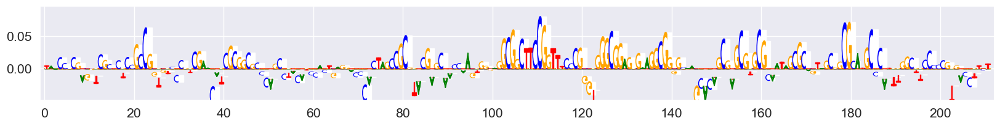

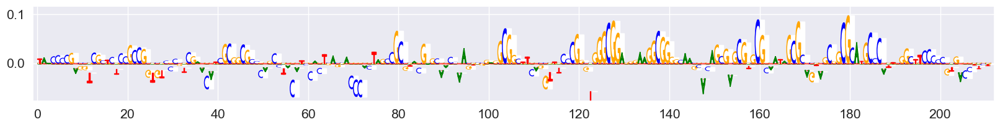

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

G C
ENSG00000117640.17
            motif_id gene_name
1_25820023  MA1596.1    ZNF460
1_25820023  MA1587.1    ZNF135
1_25820023  MA0632.3     TCFL5
1_25820023  MA1536.2     NR2C2
1_25820023  MA0810.2    TFAP2A
1_25820023  MA0003.5    TFAP2A
1_25820023  MA0812.2    TFAP2B
1_25820023  MA0812.2    TFAP2B
1_25820023  MA0814.3    TFAP2C
1_25820023  MA1581.2     ZBTB6


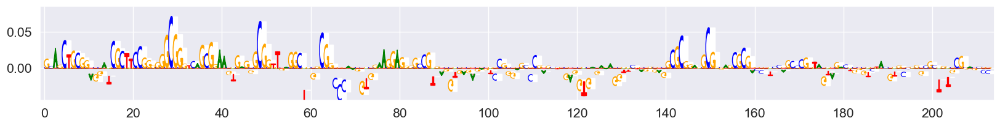

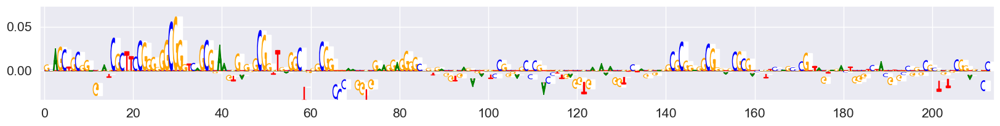

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

G A
ENSG00000097046.12
            motif_id   gene_name
1_91500849  MA1987.2      ZNF701
1_91500849  MA1938.2  ERF::NHLH1
1_91500849  MA1711.2      ZNF343
1_91500849  MA1483.3        ELF2
1_91500849  MA0028.3        ELK1
1_91500849  MA0062.4       GABPA
1_91500849  MA2332.1      ZNF175
1_91500849  MA1484.2        ETS2
1_91500849  MA0764.4        ETV4
1_91500849  MA0759.3        ELK3
1_91500849  MA0765.4        ETV5
1_91500849  MA0475.3        FLI1
1_91500849  MA0156.4         FEV
1_91500849  MA0098.4        ETS1
1_91500849  MA0763.2        ETV3
1_91500849  MA0761.3        ETV1
1_91500849  MA0760.2         ERF
1_91500849  MA2329.1      ZBTB11
1_91500849  MA1708.2        ETV7
1_91500849  MA0750.3      ZBTB7A
1_91500849  MA0645.2        ETV6
1_91500849  MA0640.3        ELF3
1_91500849  MA0598.4         EHF
1_91500849  MA0473.4        ELF1
1_91500849  MA0076.3        ELK4
1_91500849  MA1717.2      ZNF784
1_91500849  MA1493.1        HES6
1_91500849  MA1523.2     MSANTD3
1_91500849  MA1558.2

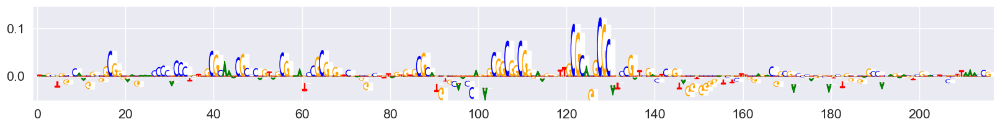

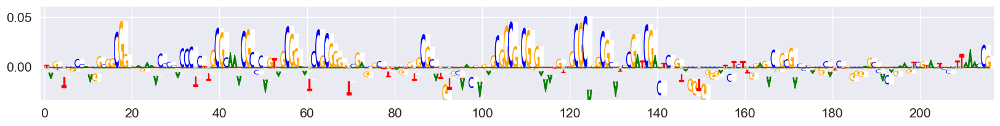

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

A AAAC
ENSG00000116774.11
             motif_id    gene_name
1_113979061  MA0140.3  GATA1::TAL1
1_113979061  MA0766.3        GATA5
1_113979061  MA1554.2         RFX7
1_113979061  MA0101.1          REL
1_113979061  MA0101.1          REL
1_113979061  MA0719.2       RHOXF1
1_113979061  MA0719.2       RHOXF1
1_113979061  MA0468.1         DUX4
1_113979061  MA0479.2        FOXH1


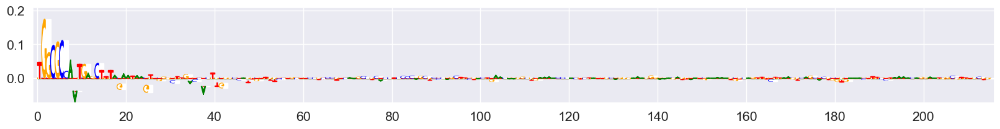

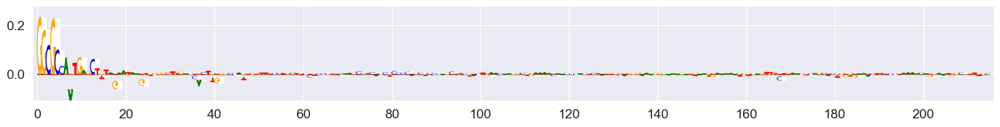

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

G T
ENSG00000143458.11
             motif_id gene_name
1_151060221  MA0751.2      ZIC4
1_151060221  MA0810.2    TFAP2A
1_151060221  MA0767.2      GCM2
1_151060221  MA0162.5      EGR1
1_151060221  MA1515.2      KLF2
1_151060221  MA1512.2     KLF11
1_151060221  MA1516.2      KLF3
1_151060221  MA1961.2     PATZ1
1_151060221  MA1578.2     VEZF1
1_151060221  MA0695.2    ZBTB7C
1_151060221  MA0522.4      TCF3
1_151060221  MA1511.2     KLF10
1_151060221  MA1517.2      KLF6
1_151060221  MA1536.2     NR2C2
1_151060221  MA1578.2     VEZF1
1_151060221  MA1515.2      KLF2
1_151060221  MA1959.2      KLF7
1_151060221  MA2330.1    ZBTB24
1_151060221  MA1579.2    ZBTB26
1_151060221  MA0144.3     STAT3


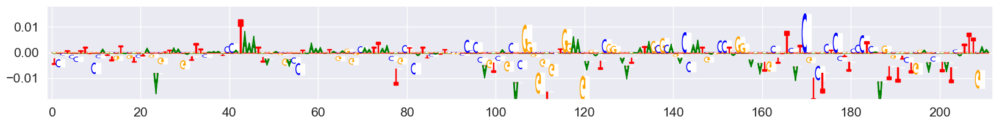

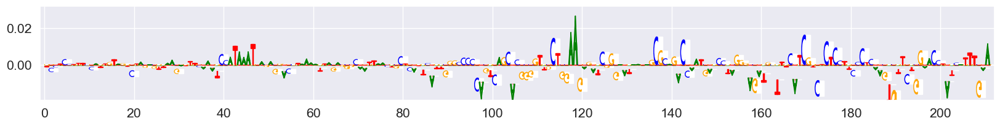

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

G A
ENSG00000143622.10
             motif_id   gene_name
1_155911161  MA0524.3      TFAP2C
1_155911161  MA0810.2      TFAP2A
1_155911161  MA0811.2      TFAP2B
1_155911161  MA0810.2      TFAP2A
1_155911161  MA0811.2      TFAP2B
1_155911161  MA0698.2      ZBTB18
1_155911161  MA0524.3      TFAP2C
1_155911161  MA0003.5      TFAP2A
1_155911161  MA0091.2  TAL1::TCF3
1_155911161  MA1570.1       TFAP4
1_155911161  MA1570.1       TFAP4
1_155911161  MA1123.3      TWIST1
1_155911161  MA1642.2     NEUROG2
1_155911161  MA0684.3       RUNX3
1_155911161  MA1525.3      NFATC4
1_155911161  MA0645.2        ETV6
1_155911161  MA1971.2       ZBED2
1_155911161  MA0131.3       HINFP
1_155911161  MA0028.3        ELK1
1_155911161  MA0759.3        ELK3
1_155911161  MA0764.4        ETV4
1_155911161  MA1484.2        ETS2
1_155911161  MA1972.1       ZFP14
1_155911161  MA0741.1       KLF16
1_155911161  MA1723.2       PRDM9
1_155911161  MA1961.2       PATZ1
1_155911161  MA0746.3         SP3
1_155911161  MA0599.1    

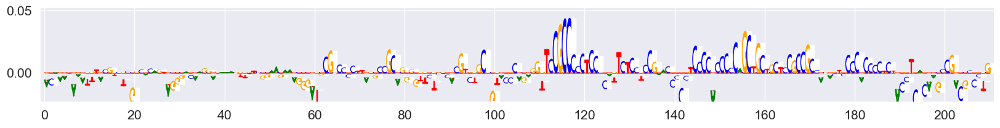

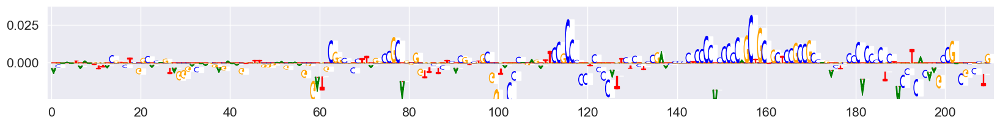

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

T C
ENSG00000143811.18
             motif_id    gene_name
1_225924245  MA1934.2   ERF::FIGLA
1_225924245  MA1941.2  ETV2::FIGLA
1_225924245  MA1966.2  TFAP4::ETV1
1_225924245  MA0076.3         ELK4
1_225924245  MA1100.3        ASCL1
1_225924245  MA1542.2         OSR1
1_225924245  MA1123.3       TWIST1
1_225924245  MA1642.2      NEUROG2
1_225924245  MA1646.2         OSR2
1_225924245  MA1952.2  FOXJ2::ELF1
1_225924245  MA1483.3         ELF2
1_225924245  MA1484.2         ETS2
1_225924245  MA1638.2        HAND2
1_225924245  MA1935.2   ERF::FOXI1
1_225924245  MA1964.2        SMAD2
1_225924245  MA0137.4        STAT1
1_225924245  MA0144.3        STAT3
1_225924245  MA1579.2       ZBTB26
1_225924245  MA0738.2         HIC2
1_225924245  MA1116.2         RBPJ
1_225924245  MA0625.3       NFATC3
1_225924245  MA1965.2          SP5


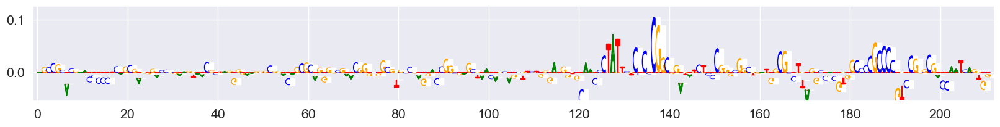

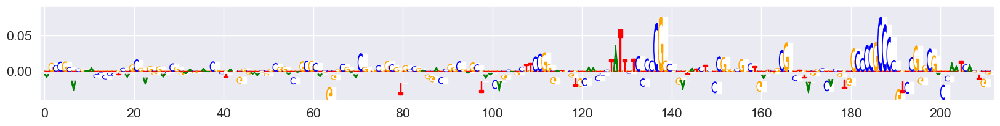

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

G C
ENSG00000168275.14
             motif_id     gene_name
1_234373513  MA0014.4          PAX5
1_234373513  MA0632.3         TCFL5
1_234373513  MA1523.2       MSANTD3
1_234373513  MA1645.2        NKX2-2
1_234373513  MA0100.4           MYB
1_234373513  MA1554.2          RFX7
1_234373513  MA0517.2  STAT1::STAT2
1_234373513  MA1478.2        DMRTA2
1_234373513  MA1478.2        DMRTA2
1_234373513  MA1935.2    ERF::FOXI1


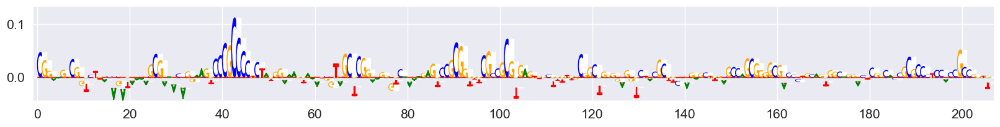

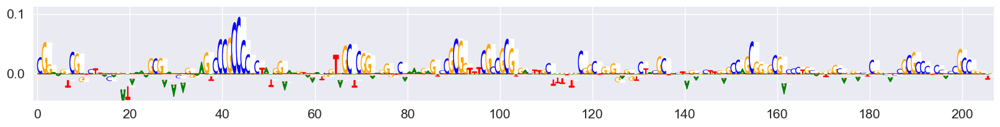

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

T TA
ENSG00000108055.9
              motif_id gene_name
10_110567334  MA0497.2     MEF2C
10_110567334  MA1125.2    ZNF384
10_110567334  MA0052.5     MEF2A
10_110567334  MA0108.3       TBP
10_110567334  MA0108.3       TBP
10_110567334  MA0845.1     FOXB1
10_110567334  MA0674.2    NKX6-1
10_110567334  MA0892.2      GSX1
10_110567334  MA0723.3      VAX2
10_110567334  MA0635.2    BARHL2
10_110567334  MA0108.3       TBP
10_110567334  MA0108.3       TBP
10_110567334  MA0619.2     LIN54
10_110567334  MA0619.2     LIN54
10_110567334  MA0144.3     STAT3
10_110567334  MA0497.2     MEF2C
10_110567334  MA2118.1     FOXS1
10_110567334  MA0593.2     FOXP2
10_110567334  MA0047.4     FOXA2
10_110567334  MA0619.2     LIN54
10_110567334  MA0148.5     FOXA1
10_110567334  MA2117.1     FOXP4
10_110567334  MA1683.2     FOXA3
10_110567334  MA1103.3     FOXK2
10_110567334  MA0895.2    HMBOX1
10_110567334  MA0852.3     FOXK1
10_110567334  MA0849.1     FOXO6
10_110567334  MA0848.1     FOXO4
10_110567334  MA0481

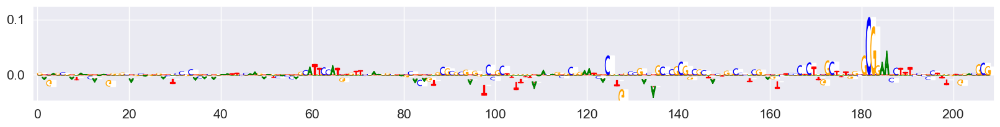

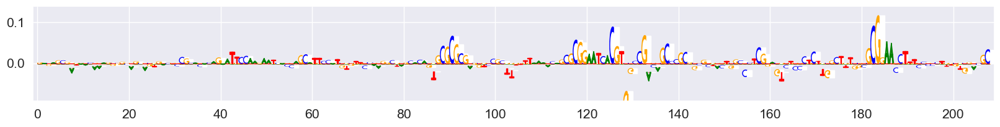

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

T A
ENSG00000120008.15
              motif_id    gene_name
10_120851275  MA1564.2          SP9
10_120851275  MA1516.2         KLF3
10_120851275  MA0079.5          SP1
10_120851275  MA0685.2          SP4
10_120851275  MA1511.2        KLF10
10_120851275  MA1713.2       ZNF610
10_120851275  MA1959.2         KLF7
10_120851275  MA0599.1         KLF5
10_120851275  MA1536.2        NR2C2
10_120851275  MA1712.2       ZNF454
10_120851275  MA1536.2        NR2C2
10_120851275  MA1976.2       ZNF320
10_120851275  MA0130.1      ZNF354C
10_120851275  MA2096.1       ZNF524
10_120851275  MA1649.2       ZBTB12
10_120851275  MA1525.3       NFATC4
10_120851275  MA0625.3       NFATC3
10_120851275  MA0738.2         HIC2
10_120851275  MA1478.2       DMRTA2
10_120851275  MA1947.2  ETV5::FOXO1


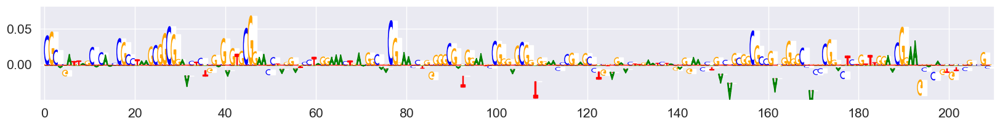

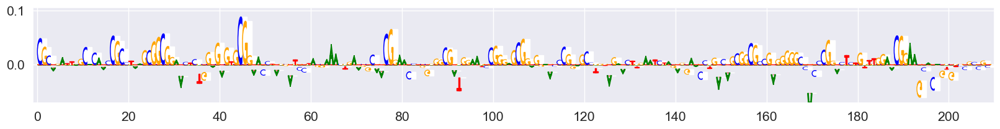

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

T C
ENSG00000185201.16
           motif_id   gene_name
11_308059  MA0847.4       FOXD2
11_308059  MA1561.2       SOX12
11_308059  MA0599.1        KLF5
11_308059  MA1728.2      ZNF549
11_308059  MA1969.2        THRA
11_308059  MA0671.2        NFIX
11_308059  MA0738.2        HIC2
11_308059  MA0646.2        GCM1
11_308059  MA0671.2        NFIX
11_308059  MA1535.2       NR2C1
11_308059  MA1536.2       NR2C2
11_308059  MA1111.2       NR2F2
11_308059  MA1149.2  RARA::RXRG
11_308059  MA0083.3         SRF
11_308059  MA0083.3         SRF
11_308059  MA1534.2       NR1I3
11_308059  MA1112.3       NR4A1
11_308059  MA0597.3       THAP1
11_308059  MA0160.3       NR4A2
11_308059  MA1530.2      NKX6-3
11_308059  MA1497.2       HOXA6
11_308059  MA1500.2       HOXB6
11_308059  MA1501.2       HOXB7
11_308059  MA1502.2       HOXB8
11_308059  MA0672.2      NKX2-3
11_308059  MA0673.2      NKX2-8
11_308059  MA0767.2        GCM2
11_308059  MA0910.3       HOXD8
11_308059  MA0893.3        GSX2
11_308059  MA1496

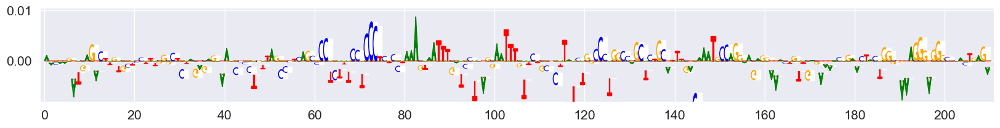

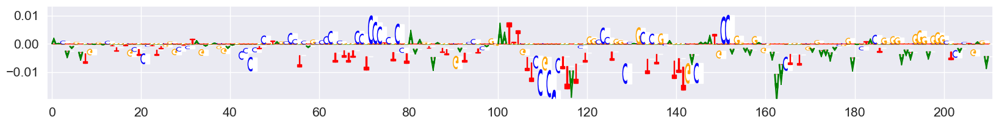

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

G C
ENSG00000110651.11
            motif_id gene_name
11_2378019  MA0163.1     PLAG1
11_2378019  MA1987.2    ZNF701
11_2378019  MA0810.2    TFAP2A
11_2378019  MA1961.2     PATZ1
11_2378019  MA0736.1     GLIS2
...              ...       ...
11_2378019  MA0695.2    ZBTB7C
11_2378019  MA1548.2    PLAGL2
11_2378019  MA0163.1     PLAG1
11_2378019  MA1578.2     VEZF1
11_2378019  MA1548.2    PLAGL2

[136 rows x 2 columns]


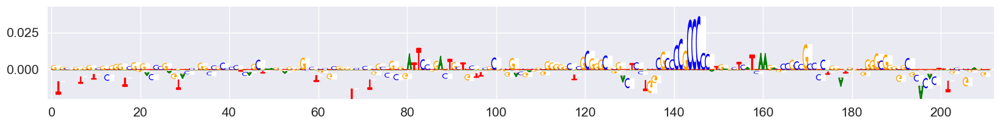

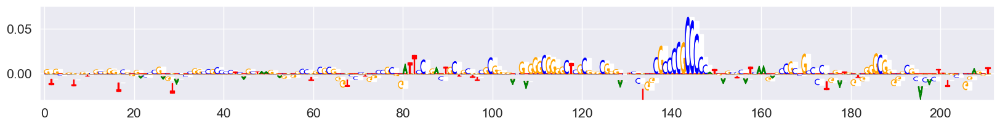

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

G C
ENSG00000175348.10
            motif_id gene_name
11_8964472  MA0017.3     NR2F1
11_8964472  MA1535.2     NR2C1
11_8964472  MA2096.1    ZNF524
11_8964472  MA2324.1    BCL11A
11_8964472  MA1536.2     NR2C2
11_8964472  MA0719.2    RHOXF1
11_8964472  MA0692.2      TFEB
11_8964472  MA1570.1     TFAP4
11_8964472  MA0830.3      TCF4
11_8964472  MA1559.2     SNAI3
11_8964472  MA0048.3     NHLH1
11_8964472  MA1646.2      OSR2
11_8964472  MA1123.3    TWIST1
11_8964472  MA1100.3     ASCL1
11_8964472  MA1100.3     ASCL1
11_8964472  MA0500.3      MYOG
11_8964472  MA0500.3      MYOG
11_8964472  MA1558.2     SNAI1
11_8964472  MA1109.2   NEUROD1


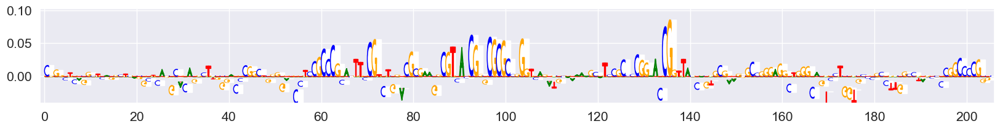

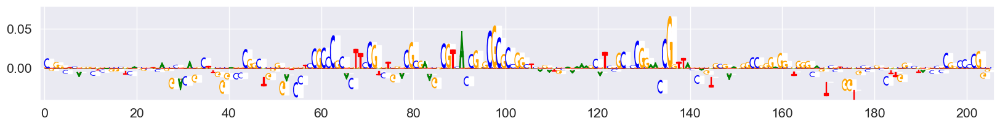

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

G A
ENSG00000181830.8
             motif_id gene_name
11_45805170  MA1972.1     ZFP14
11_45805170  MA2330.1    ZBTB24
11_45805170  MA0811.2    TFAP2B
11_45805170  MA0524.3    TFAP2C
11_45805170  MA1581.2     ZBTB6
11_45805170  MA1646.2      OSR2
11_45805170  MA0811.2    TFAP2B
11_45805170  MA0810.2    TFAP2A
11_45805170  MA0524.3    TFAP2C
11_45805170  MA1542.2      OSR1
11_45805170  MA1100.3     ASCL1
11_45805170  MA1100.3     ASCL1
11_45805170  MA0830.3      TCF4
11_45805170  MA1569.2    TFAP2E
11_45805170  MA1569.2    TFAP2E
11_45805170  MA1979.2    ZNF416
11_45805170  MA0596.1    SREBF2
11_45805170  MA0595.1    SREBF1
11_45805170  MA0671.2      NFIX
11_45805170  MA0685.2       SP4
11_45805170  MA0740.2     KLF14
11_45805170  MA0599.1      KLF5
11_45805170  MA1599.2    ZNF682
11_45805170  MA2341.1     FEZF2
11_45805170  MA1959.2      KLF7
11_45805170  MA0493.3      KLF1
11_45805170  MA0719.2    RHOXF1
11_45805170  MA0814.3    TFAP2C
11_45805170  MA1726.2    ZNF331


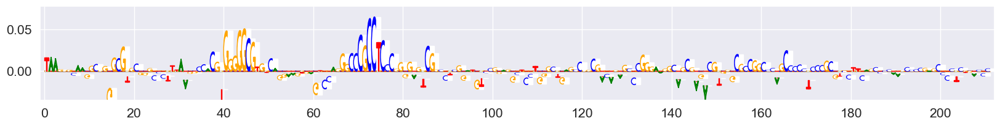

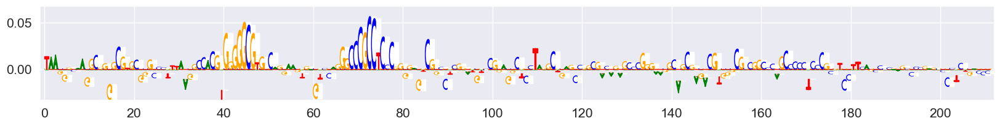

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

G C
ENSG00000173113.6
             motif_id     gene_name
11_64317591  MA1933.2  ELK1::SREBF2
11_64317591  MA0750.3        ZBTB7A
11_64317591  MA1708.2          ETV7
11_64317591  MA2329.1        ZBTB11
11_64317591  MA0062.4         GABPA
11_64317591  MA0641.1          ELF4
11_64317591  MA0640.3          ELF3
11_64317591  MA0598.4           EHF
11_64317591  MA0473.4          ELF1
11_64317591  MA0076.3          ELK4
11_64317591  MA0645.2          ETV6
11_64317591  MA0761.3          ETV1
11_64317591  MA0764.4          ETV4
11_64317591  MA0762.2          ETV2
11_64317591  MA0763.2          ETV3
11_64317591  MA0765.4          ETV5
11_64317591  MA1484.2          ETS2
11_64317591  MA2332.1        ZNF175
11_64317591  MA0686.2         SPDEF
11_64317591  MA1483.3          ELF2
11_64317591  MA0810.2        TFAP2A
11_64317591  MA1952.2   FOXJ2::ELF1
11_64317591  MA0759.3          ELK3
11_64317591  MA0475.3          FLI1
11_64317591  MA0156.4           FEV
11_64317591  MA0098.4          ETS1
11_643

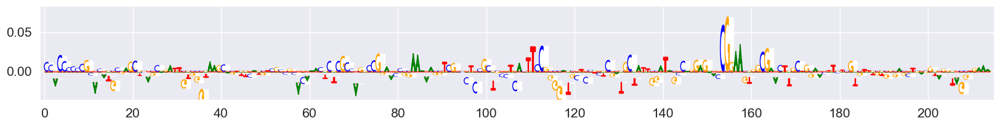

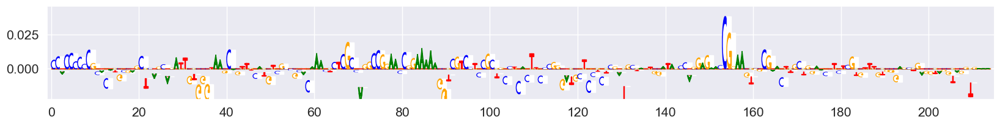

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

T C
ENSG00000254855.1
             motif_id gene_name
11_66268508  MA1645.2    NKX2-2
11_66268508  MA0100.4       MYB
11_66268508  MA2096.1    ZNF524
11_66268508  MA1536.2     NR2C2
11_66268508  MA0130.1   ZNF354C
11_66268508  MA0671.2      NFIX
11_66268508  MA0625.3    NFATC3
11_66268508  MA0673.2    NKX2-8


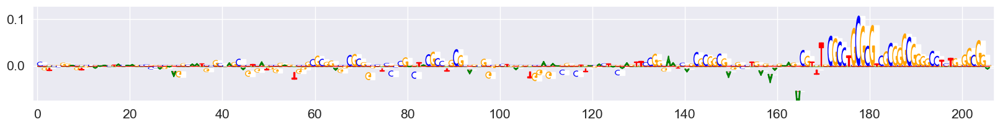

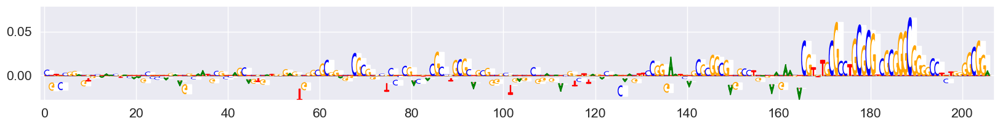

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

G GAAA
ENSG00000150316.11
             motif_id    gene_name
11_94973303  MA1528.2         NFIX
11_94973303  MA0500.3         MYOG
11_94973303  MA0500.3         MYOG
11_94973303  MA1728.2       ZNF549
11_94973303  MA1942.2  ETV2::FOXI1
11_94973303  MA2332.1       ZNF175
11_94973303  MA0761.3         ETV1
11_94973303  MA1484.2         ETS2
11_94973303  MA0671.2         NFIX
11_94973303  MA1936.2   ERF::FOXO1
11_94973303  MA2326.1        IKZF2
11_94973303  MA0810.2       TFAP2A


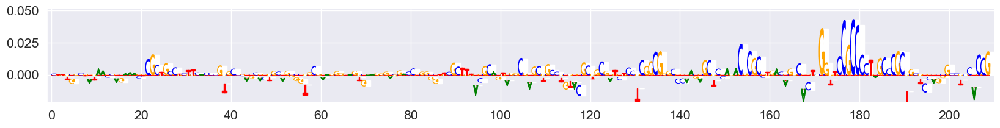

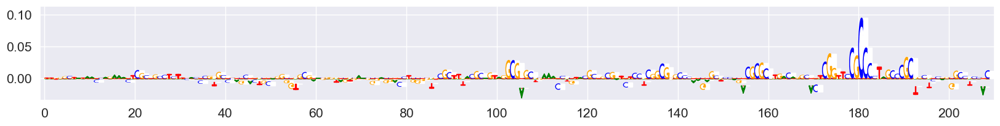

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

C CGGG
ENSG00000073614.12
           motif_id gene_name
12_389569  MA2094.1      PAX8
12_389569  MA1981.2    ZNF530
12_389569  MA2094.1      PAX8
12_389569  MA1516.2      KLF3
12_389569  MA1653.2    ZNF148
12_389569  MA1961.2     PATZ1
12_389569  MA1522.2       MAZ
12_389569  MA0838.1     CEBPG
12_389569  MA0806.1      TBX4
12_389569  MA1986.2    ZNF692
12_389569  MA1727.2    ZNF417
12_389569  MA0719.2    RHOXF1
12_389569  MA1554.2      RFX7
12_389569  MA1478.2    DMRTA2
12_389569  MA0067.3      PAX2
12_389569  MA0779.2      PAX1
12_389569  MA0781.2      PAX9
12_389569  MA2094.1      PAX8


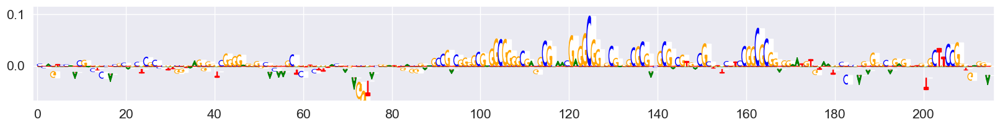

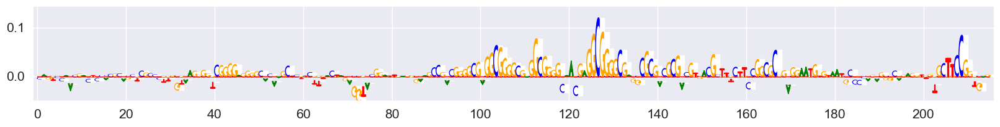

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

G A
ENSG00000256537.4
             motif_id gene_name
12_11171765  MA0113.4     NR3C1
12_11171765  MA0113.4     NR3C1
12_11171765  MA0727.2     NR3C2
12_11171765  MA0727.2     NR3C2
12_11171765  MA2327.1       PGR
...               ...       ...
12_11171765  MA0144.3     STAT3
12_11171765  MA1579.2    ZBTB26
12_11171765  MA0144.3     STAT3
12_11171765  MA0686.2     SPDEF
12_11171765  MA1483.3      ELF2

[62 rows x 2 columns]


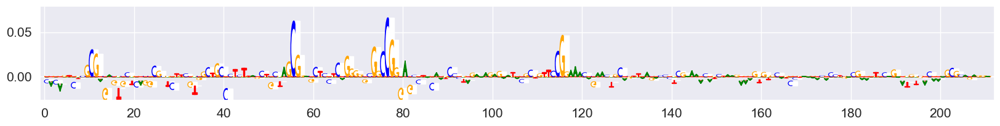

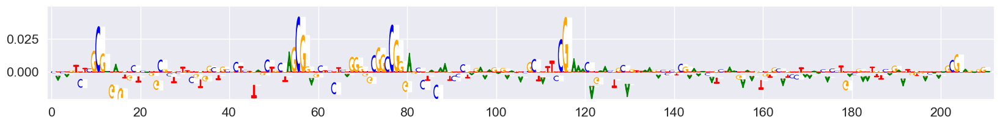

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

G T
ENSG00000118307.18
             motif_id   gene_name
12_25195139  MA1468.1       ATOH7
12_25195139  MA1568.2       TCF21
12_25195139  MA0594.3       HOXA9
12_25195139  MA1516.2        KLF3
12_25195139  MA1515.2        KLF2
12_25195139  MA0810.2      TFAP2A
12_25195139  MA0641.1        ELF4
12_25195139  MA0811.2      TFAP2B
12_25195139  MA0524.3      TFAP2C
12_25195139  MA2329.1      ZBTB11
12_25195139  MA0750.3      ZBTB7A
12_25195139  MA0076.3        ELK4
12_25195139  MA0810.2      TFAP2A
12_25195139  MA0524.3      TFAP2C
12_25195139  MA1483.3        ELF2
12_25195139  MA0759.3        ELK3
12_25195139  MA0686.2       SPDEF
12_25195139  MA1569.2      TFAP2E
12_25195139  MA1569.2      TFAP2E
12_25195139  MA0812.2      TFAP2B
12_25195139  MA1484.2        ETS2
12_25195139  MA1965.2         SP5
12_25195139  MA0764.4        ETV4
12_25195139  MA1542.2        OSR1
12_25195139  MA0625.3      NFATC3
12_25195139  MA1122.2       TFDP1
12_25195139  MA1935.2  ERF::FOXI1


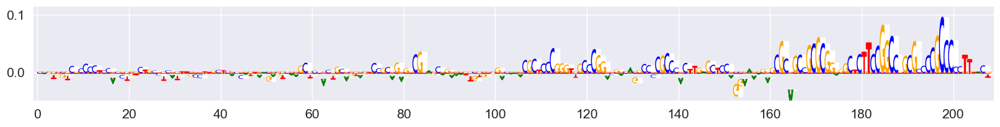

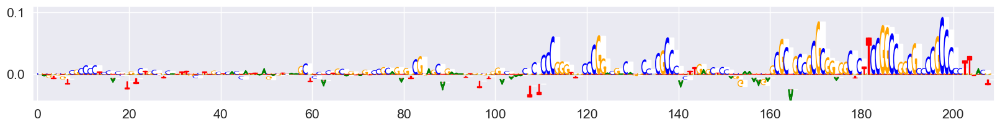

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

C T
ENSG00000111554.14
             motif_id gene_name
12_68332523  MA1547.2     PITX2
12_68332523  MA0682.3     PITX1
12_68332523  MA0808.1     TEAD3
12_68332523  MA0712.3      OTX2
12_68332523  MA0891.2      GSC2
12_68332523  MA0719.2    RHOXF1
12_68332523  MA0714.2     PITX3
12_68332523  MA0711.2      OTX1
12_68332523  MA0056.3      MZF1
12_68332523  MA0811.2    TFAP2B
12_68332523  MA0810.2    TFAP2A
12_68332523  MA0524.3    TFAP2C
12_68332523  MA0154.5      EBF1
12_68332523  MA0154.5      EBF1
12_68332523  MA1637.2      EBF3
12_68332523  MA1569.2    TFAP2E
12_68332523  MA1569.2    TFAP2E
12_68332523  MA0524.3    TFAP2C
12_68332523  MA0524.3    TFAP2C
12_68332523  MA0810.2    TFAP2A
12_68332523  MA0810.2    TFAP2A
12_68332523  MA0811.2    TFAP2B
12_68332523  MA0811.2    TFAP2B
12_68332523  MA0155.1     INSM1
12_68332523  MA0003.5    TFAP2A
12_68332523  MA0810.2    TFAP2A
12_68332523  MA1637.2      EBF3
12_68332523  MA1569.2    TFAP2E
12_68332523  MA1569.2    TFAP2E
12_68332523  MA08

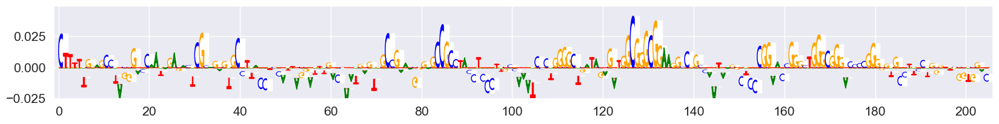

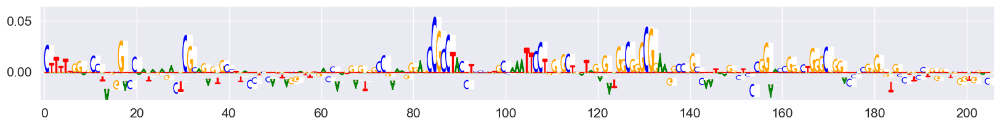

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

T A
ENSG00000204954.9
              motif_id   gene_name
12_103957073  MA1587.1      ZNF135
12_103957073  MA0687.2        SPIC
12_103957073  MA1935.2  ERF::FOXI1
12_103957073  MA0672.2      NKX2-3
12_103957073  MA0673.2      NKX2-8
12_103957073  MA2003.2      NKX2-4
12_103957073  MA0599.1        KLF5
12_103957073  MA0685.2         SP4
12_103957073  MA0671.2        NFIX
12_103957073  MA0130.1     ZNF354C
12_103957073  MA0673.2      NKX2-8
12_103957073  MA1522.2         MAZ
12_103957073  MA2003.2      NKX2-4
12_103957073  MA1965.2         SP5
12_103957073  MA0528.3      ZNF263
12_103957073  MA1652.2     ZKSCAN5
12_103957073  MA1630.3      ZNF281
12_103957073  MA1653.2      ZNF148
12_103957073  MA1961.2       PATZ1


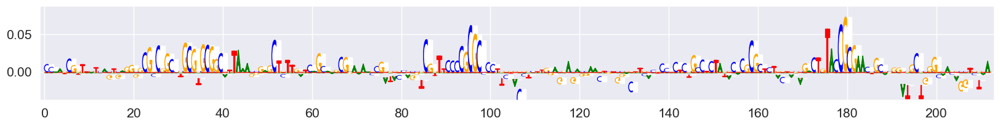

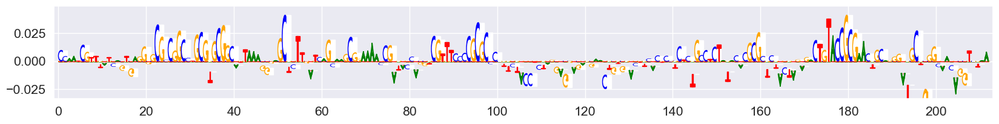

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

C G
ENSG00000233325.3
             motif_id gene_name
13_21298170  MA0798.3      RFX3
13_21298170  MA0798.3      RFX3
13_21298170  MA0509.3      RFX1
13_21298170  MA0509.3      RFX1
13_21298170  MA2121.1    ZNF213
13_21298170  MA1728.2    ZNF549
13_21298170  MA1554.2      RFX7
13_21298170  MA0510.3      RFX5
13_21298170  MA0510.3      RFX5
13_21298170  MA0600.3      RFX2
13_21298170  MA0600.3      RFX2
13_21298170  MA0671.2      NFIX
13_21298170  MA2326.1     IKZF2
13_21298170  MA0775.2     MEIS3
13_21298170  MA0597.3     THAP1
13_21298170  MA0144.3     STAT3
13_21298170  MA0161.3      NFIC
13_21298170  MA0769.3      TCF7
13_21298170  MA0670.2      NFIA
13_21298170  MA0671.2      NFIX
13_21298170  MA1116.2      RBPJ
13_21298170  MA0619.2     LIN54
13_21298170  MA1525.3    NFATC4
13_21298170  MA1708.2      ETV7
13_21298170  MA0798.3      RFX3
13_21298170  MA0798.3      RFX3
13_21298170  MA0509.3      RFX1
13_21298170  MA0509.3      RFX1
13_21298170  MA2121.1    ZNF213
13_21298170  MA172

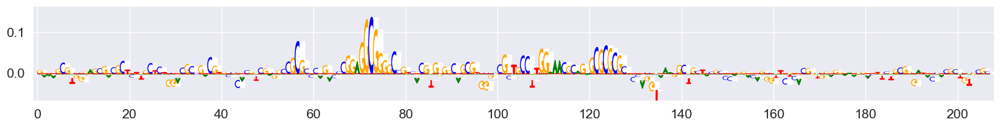

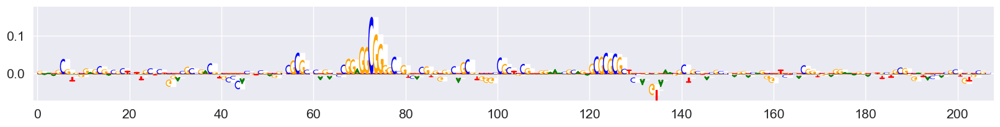

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

T C
ENSG00000224743.6
             motif_id gene_name
13_30906286  MA0696.1      ZIC1
13_30906286  MA0751.2      ZIC4
13_30906286  MA1513.2     KLF15
13_30906286  MA1515.2      KLF2
13_30906286  MA1959.2      KLF7
13_30906286  MA1716.2     ZNF76
13_30906286  MA1730.2    ZNF708
13_30906286  MA0738.2      HIC2
13_30906286  MA0646.2      GCM1
13_30906286  MA0872.1    TFAP2A
13_30906286  MA0872.1    TFAP2A
13_30906286  MA0815.1    TFAP2C
13_30906286  MA0815.1    TFAP2C
13_30906286  MA0813.1    TFAP2B
13_30906286  MA0811.2    TFAP2B
13_30906286  MA0810.2    TFAP2A
13_30906286  MA0524.3    TFAP2C
13_30906286  MA0813.1    TFAP2B
13_30906286  MA0812.2    TFAP2B
13_30906286  MA0812.2    TFAP2B
13_30906286  MA1569.2    TFAP2E
13_30906286  MA1569.2    TFAP2E
13_30906286  MA0524.3    TFAP2C
13_30906286  MA0810.2    TFAP2A
13_30906286  MA0811.2    TFAP2B


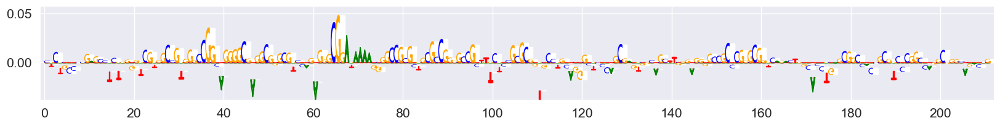

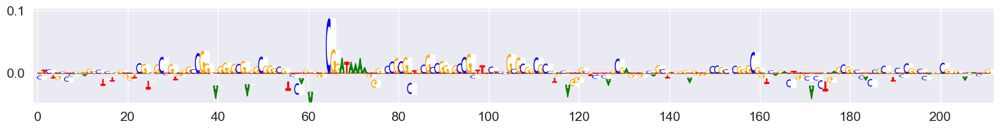

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

C T
ENSG00000120675.5
             motif_id gene_name
13_43023570  MA0775.2     MEIS3
13_43023570  MA1535.2     NR2C1
13_43023570  MA0813.1    TFAP2B
13_43023570  MA1536.2     NR2C2
13_43023570  MA0524.3    TFAP2C
13_43023570  MA0810.2    TFAP2A
13_43023570  MA0811.2    TFAP2B
13_43023570  MA0810.2    TFAP2A
13_43023570  MA0811.2    TFAP2B
13_43023570  MA0811.2    TFAP2B
13_43023570  MA0524.3    TFAP2C
13_43023570  MA0524.3    TFAP2C
13_43023570  MA1568.2     TCF21
13_43023570  MA1637.2      EBF3
13_43023570  MA0812.2    TFAP2B
13_43023570  MA0812.2    TFAP2B
13_43023570  MA1569.2    TFAP2E
13_43023570  MA1569.2    TFAP2E
13_43023570  MA0524.3    TFAP2C
13_43023570  MA0810.2    TFAP2A
13_43023570  MA0811.2    TFAP2B
13_43023570  MA0594.3     HOXA9


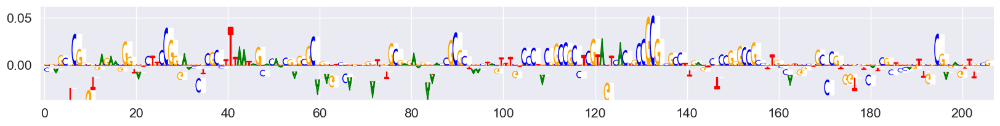

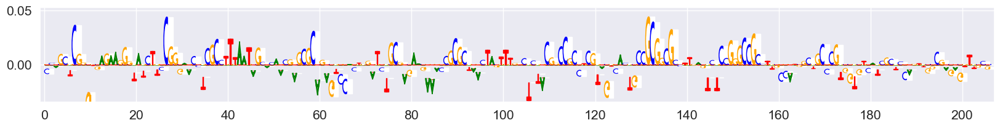

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

C T
ENSG00000136122.15
             motif_id     gene_name
13_72727908  MA1711.2        ZNF343
13_72727908  MA1935.2    ERF::FOXI1
13_72727908  MA0641.1          ELF4
13_72727908  MA1483.3          ELF2
13_72727908  MA0763.2          ETV3
13_72727908  MA1484.2          ETS2
13_72727908  MA0765.4          ETV5
13_72727908  MA0764.4          ETV4
13_72727908  MA0762.2          ETV2
13_72727908  MA0759.3          ELK3
13_72727908  MA0475.3          FLI1
13_72727908  MA0156.4           FEV
13_72727908  MA0098.4          ETS1
13_72727908  MA0028.3          ELK1
13_72727908  MA0750.3        ZBTB7A
13_72727908  MA1933.2  ELK1::SREBF2
13_72727908  MA2329.1        ZBTB11
13_72727908  MA1708.2          ETV7
13_72727908  MA0645.2          ETV6
13_72727908  MA0076.3          ELK4
13_72727908  MA0598.4           EHF
13_72727908  MA0131.3         HINFP
13_72727908  MA1542.2          OSR1
13_72727908  MA1646.2          OSR2
13_72727908  MA0625.3        NFATC3
13_72727908  MA2326.1         IKZF2
13_72

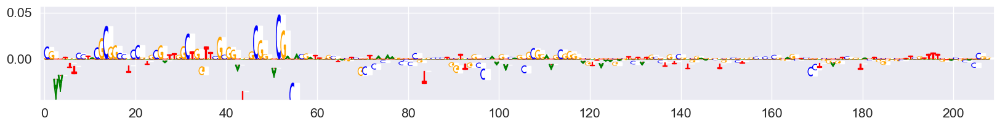

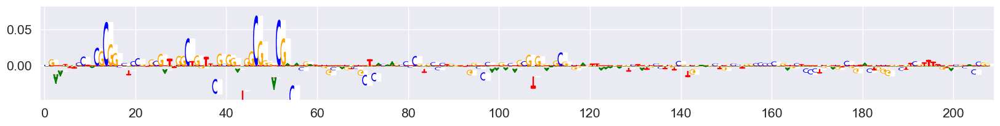

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

C T
ENSG00000165792.17
             motif_id    gene_name
14_20989786  MA0155.1        INSM1
14_20989786  MA1986.2       ZNF692
14_20989786  MA0258.2         ESR2
14_20989786  MA0747.2          SP8
14_20989786  MA2099.1       ZNF770
14_20989786  MA1548.2       PLAGL2
14_20989786  MA1727.2       ZNF417
14_20989786  MA0516.3          SP2
14_20989786  MA0742.2        KLF12
14_20989786  MA1511.2        KLF10
14_20989786  MA1538.1        NR2F1
14_20989786  MA0079.5          SP1
14_20989786  MA1985.1       ZNF669
14_20989786  MA1147.2  NR4A2::RXRA
14_20989786  MA1511.2        KLF10
14_20989786  MA0685.2          SP4
14_20989786  MA1513.2        KLF15
14_20989786  MA1959.2         KLF7
14_20989786  MA1631.2        ASCL1
14_20989786  MA0522.4         TCF3
14_20989786  MA1558.2        SNAI1
14_20989786  MA1648.2        TCF12
14_20989786  MA0830.3         TCF4
14_20989786  MA0103.4         ZEB1
14_20989786  MA0820.2        FIGLA
14_20989786  MA1535.2        NR2C1
14_20989786  MA1536.2        NR2

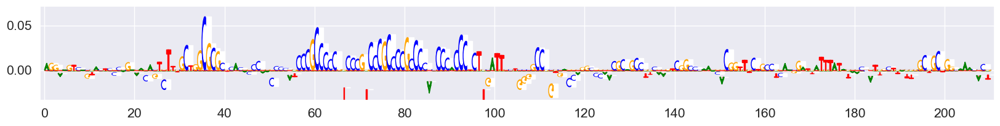

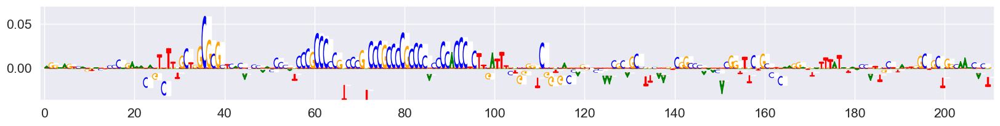

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

C G
ENSG00000103742.11
             motif_id gene_name
15_65421670  MA1592.2    ZNF274
15_65421670  MA0105.4     NFKB1
15_65421670  MA0105.4     NFKB1
15_65421670  MA1723.2     PRDM9
15_65421670  MA0778.2     NFKB2
...               ...       ...
15_65421670  MA1578.2     VEZF1
15_65421670  MA1578.2     VEZF1
15_65421670  MA1965.2       SP5
15_65421670  MA0056.3      MZF1
15_65421670  MA0753.3    ZNF740

[62 rows x 2 columns]


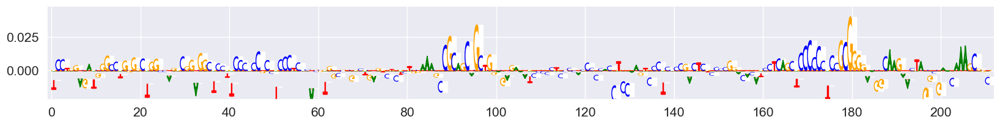

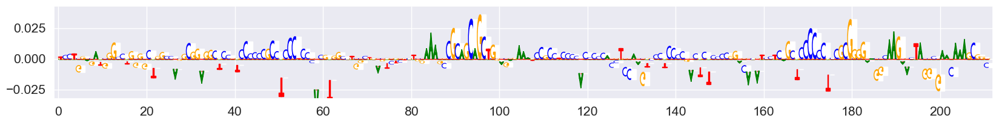

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

C A
ENSG00000140463.13
             motif_id     gene_name
15_72686190  MA2098.1        ZNF766
15_72686190  MA0778.2         NFKB2
15_72686190  MA0778.2         NFKB2
15_72686190  MA0101.1           REL
15_72686190  MA0107.1          RELA
15_72686190  MA0511.2         RUNX2
15_72686190  MA0842.3           NRL
15_72686190  MA0747.2           SP8
15_72686190  MA1933.2  ELK1::SREBF2
15_72686190  MA1650.2        ZBTB14
15_72686190  MA1932.2  ELK1::HOXB13
15_72686190  MA1966.2   TFAP4::ETV1
15_72686190  MA1957.1   HOXB2::ELK1


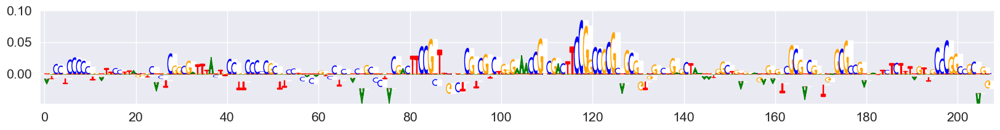

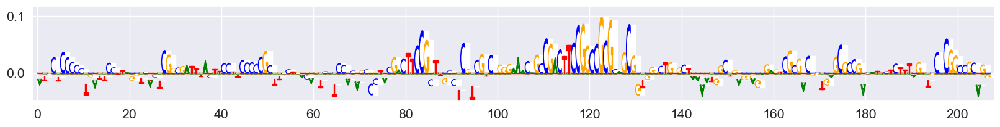

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

A C
ENSG00000183476.12
             motif_id gene_name
15_78131254  MA0599.1      KLF5
15_78131254  MA0498.3     MEIS1
15_78131254  MA0493.3      KLF1
15_78131254  MA0695.2    ZBTB7C
15_78131254  MA1515.2      KLF2
15_78131254  MA1959.2      KLF7
15_78131254  MA0740.2     KLF14
15_78131254  MA1517.2      KLF6
15_78131254  MA0694.2    ZBTB7B
15_78131254  MA1512.2     KLF11
15_78131254  MA1564.2       SP9
15_78131254  MA2094.1      PAX8
15_78131254  MA0468.1      DUX4
15_78131254  MA1523.2   MSANTD3
15_78131254  MA1965.2       SP5
15_78131254  MA0625.3    NFATC3
15_78131254  MA0738.2      HIC2
15_78131254  MA1116.2      RBPJ
15_78131254  MA0144.3     STAT3
15_78131254  MA0599.1      KLF5
15_78131254  MA0498.3     MEIS1
15_78131254  MA0493.3      KLF1
15_78131254  MA0695.2    ZBTB7C
15_78131254  MA1515.2      KLF2
15_78131254  MA1959.2      KLF7
15_78131254  MA0740.2     KLF14
15_78131254  MA1517.2      KLF6
15_78131254  MA0694.2    ZBTB7B
15_78131254  MA1512.2     KLF11
15_78131254  MA15

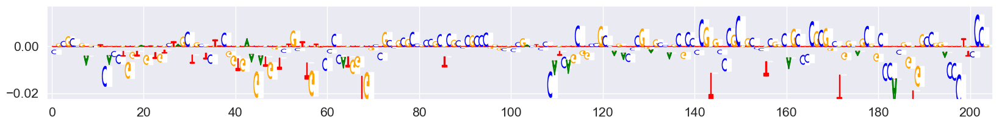

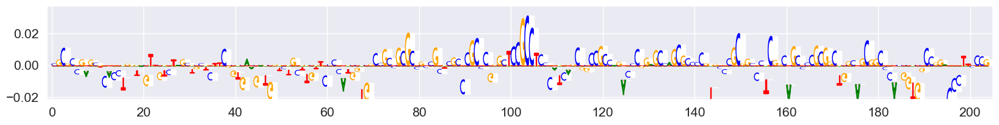

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

C T
ENSG00000255198.4
            motif_id gene_name
16_1964953  MA1516.2      KLF3
16_1964953  MA0599.1      KLF5
16_1964953  MA0471.3      E2F6
16_1964953  MA1122.2     TFDP1
16_1964953  MA1961.2     PATZ1
16_1964953  MA1107.3      KLF9
16_1964953  MA0746.3       SP3
16_1964953  MA0741.1     KLF16
16_1964953  MA0747.2       SP8
16_1964953  MA1710.2    ZNF257
16_1964953  MA1653.2    ZNF148
16_1964953  MA1630.3    ZNF281
16_1964953  MA0516.3       SP2
16_1964953  MA1564.2       SP9
16_1964953  MA1512.2     KLF11
16_1964953  MA0753.3    ZNF740
16_1964953  MA1517.2      KLF6
16_1964953  MA0742.2     KLF12
16_1964953  MA0740.2     KLF14
16_1964953  MA0685.2       SP4
16_1964953  MA0079.5       SP1
16_1964953  MA2341.1     FEZF2
16_1964953  MA1959.2      KLF7
16_1964953  MA1522.2       MAZ
16_1964953  MA1511.2     KLF10
16_1964953  MA1515.2      KLF2
16_1964953  MA1513.2     KLF15
16_1964953  MA0493.3      KLF1
16_1964953  MA0039.5      KLF4
16_1964953  MA1578.2     VEZF1
16_1964953  MA064

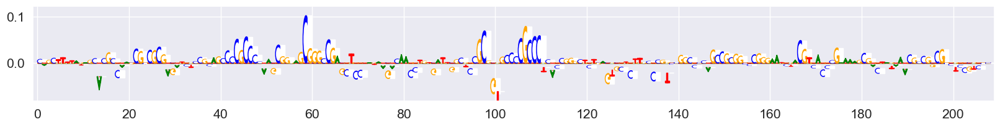

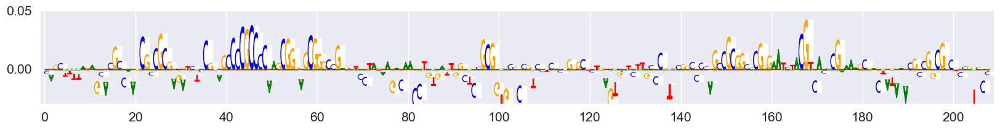

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

G GGTCT
ENSG00000033011.11
            motif_id gene_name
16_5072071  MA1537.2     NR2F1
16_5072071  MA0811.2    TFAP2B
16_5072071  MA0810.2    TFAP2A
16_5072071  MA0524.3    TFAP2C
16_5072071  MA0810.2    TFAP2A
16_5072071  MA0524.3    TFAP2C
16_5072071  MA1569.2    TFAP2E
16_5072071  MA1569.2    TFAP2E
16_5072071  MA0502.3      NFYB
16_5072071  MA1637.2      EBF3
16_5072071  MA0672.2    NKX2-3
16_5072071  MA0673.2    NKX2-8
16_5072071  MA1505.2     HOXC8
16_5072071  MA1500.2     HOXB6
16_5072071  MA1517.2      KLF6
16_5072071  MA0599.1      KLF5
16_5072071  MA0493.3      KLF1
16_5072071  MA1515.2      KLF2
16_5072071  MA2096.1    ZNF524
16_5072071  MA0039.5      KLF4
16_5072071  MA1536.2     NR2C2
16_5072071  MA1535.2     NR2C1
16_5072071  MA0719.2    RHOXF1
16_5072071  MA1964.2     SMAD2


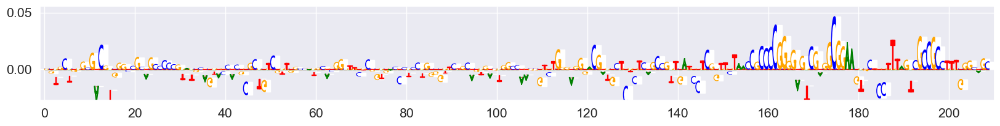

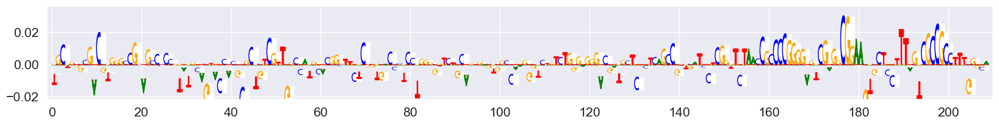

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

G C
ENSG00000205423.11
             motif_id gene_name
16_50025257  MA0815.1    TFAP2C
16_50025257  MA0872.1    TFAP2A
16_50025257  MA0815.1    TFAP2C
16_50025257  MA2121.1    ZNF213
16_50025257  MA0524.3    TFAP2C
...               ...       ...
16_50025257  MA0742.2     KLF12
16_50025257  MA1511.2     KLF10
16_50025257  MA1721.2     ZNF93
16_50025257  MA1515.2      KLF2
16_50025257  MA1583.2     ZFP57

[67 rows x 2 columns]


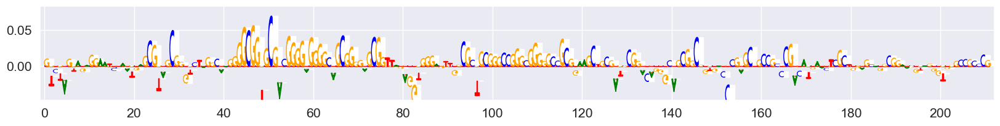

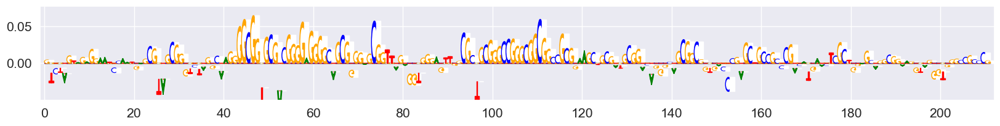

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

G T
ENSG00000167005.13
             motif_id    gene_name
16_56451339  MA1972.1        ZFP14
16_56451339  MA1602.2      ZSCAN29
16_56451339  MA0812.2       TFAP2B
16_56451339  MA1569.2       TFAP2E
16_56451339  MA1569.2       TFAP2E
16_56451339  MA0472.2         EGR2
16_56451339  MA0850.1        FOXP3
16_56451339  MA0670.2         NFIA
16_56451339  MA0671.2         NFIX
16_56451339  MA0738.2         HIC2
16_56451339  MA0014.4         PAX5
16_56451339  MA1730.2       ZNF708
16_56451339  MA1099.3         HES1
16_56451339  MA2325.1        EPAS1
16_56451339  MA1946.2  ETV5::FOXI1
16_56451339  MA1515.2         KLF2
16_56451339  MA0632.3        TCFL5
16_56451339  MA1106.2        HIF1A
16_56451339  MA0259.2  ARNT::HIF1A
16_56451339  MA1950.2  FLI1::FOXI1


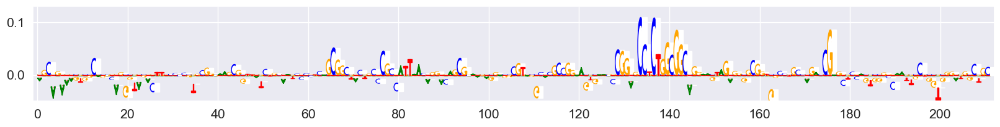

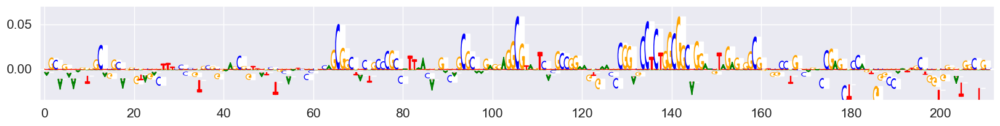

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

G C
ENSG00000274220.1
             motif_id    gene_name
16_75433545  MA1513.2        KLF15
16_75433545  MA0671.2         NFIX
16_75433545  MA0492.2         JUND
16_75433545  MA0498.3        MEIS1
16_75433545  MA0738.2         HIC2
16_75433545  MA1727.2       ZNF417
16_75433545  MA0862.1        GMEB2
16_75433545  MA1143.2  FOSL1::JUND
16_75433545  MA1475.2      CREB3L4
16_75433545  MA0131.3        HINFP
16_75433545  MA1731.2       ZNF768
16_75433545  MA0498.3        MEIS1
16_75433545  MA1965.2          SP5


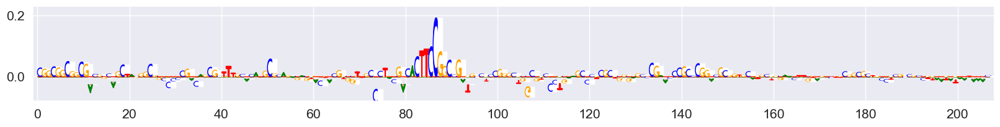

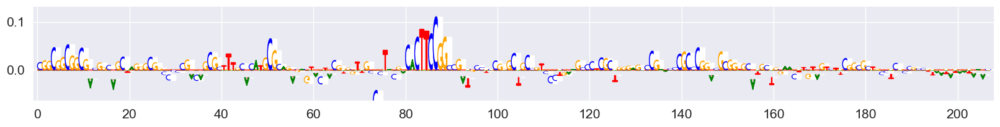

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

G A
ENSG00000173917.10
             motif_id gene_name
17_48530668  MA1712.2    ZNF454
17_48530668  MA1961.2     PATZ1
17_48530668  MA0746.3       SP3
17_48530668  MA0741.1     KLF16
17_48530668  MA1653.2    ZNF148
17_48530668  MA1512.2     KLF11
17_48530668  MA0162.5      EGR1
17_48530668  MA1564.2       SP9
17_48530668  MA0742.2     KLF12
17_48530668  MA0747.2       SP8
17_48530668  MA0599.1      KLF5
17_48530668  MA1517.2      KLF6
17_48530668  MA1511.2     KLF10
17_48530668  MA0740.2     KLF14
17_48530668  MA0685.2       SP4
17_48530668  MA0516.3       SP2
17_48530668  MA0079.5       SP1
17_48530668  MA0493.3      KLF1
17_48530668  MA1516.2      KLF3
17_48530668  MA0865.3      E2F8
17_48530668  MA1630.3    ZNF281
17_48530668  MA1959.2      KLF7
17_48530668  MA1650.2    ZBTB14
17_48530668  MA1522.2       MAZ
17_48530668  MA1513.2     KLF15
17_48530668  MA0632.3     TCFL5
17_48530668  MA0039.5      KLF4
17_48530668  MA1515.2      KLF2
17_48530668  MA0079.5       SP1
17_48530668  MA17

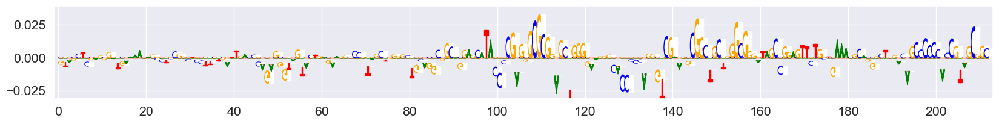

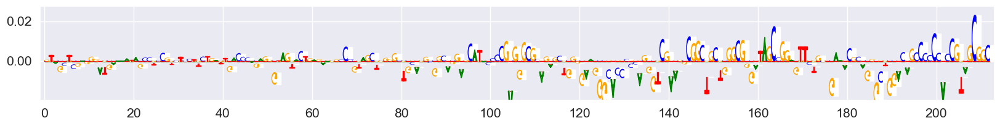

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

A G
ENSG00000159202.17
             motif_id     gene_name
17_48908272  MA1943.2  ETV2::HOXB13
17_48908272  MA0646.2          GCM1
17_48908272  MA1470.2         BACH2
17_48908272  MA1530.2        NKX6-3
17_48908272  MA1500.2         HOXB6
17_48908272  MA0038.3          GFI1
17_48908272  MA2093.1         HOXB1
17_48908272  MA0067.3          PAX2
17_48908272  MA0498.3         MEIS1
17_48908272  MA0594.3         HOXA9
17_48908272  MA0893.3          GSX2
17_48908272  MA1496.2         HOXA4
17_48908272  MA1500.2         HOXB6
17_48908272  MA0801.1           MGA
17_48908272  MA0259.2   ARNT::HIF1A
17_48908272  MA1536.2         NR2C2
17_48908272  MA2099.1        ZNF770


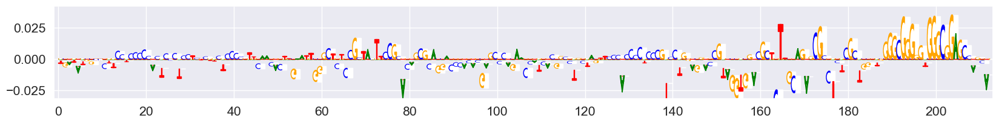

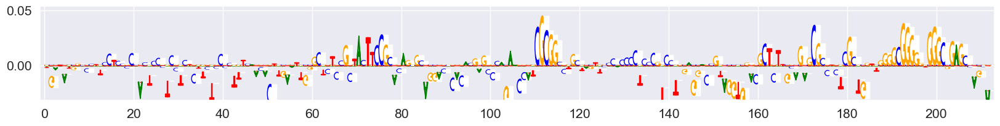

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

A G
ENSG00000167447.12
             motif_id gene_name
17_59210093  MA0488.2       JUN
17_59210093  MA0492.2      JUND
17_59210093  MA0738.2      HIC2
17_59210093  MA1478.2    DMRTA2
17_59210093  MA1468.1     ATOH7
17_59210093  MA1100.3     ASCL1
17_59210093  MA1100.3     ASCL1
17_59210093  MA0719.2    RHOXF1
17_59210093  MA1638.2     HAND2
17_59210093  MA2341.1     FEZF2
17_59210093  MA0719.2    RHOXF1


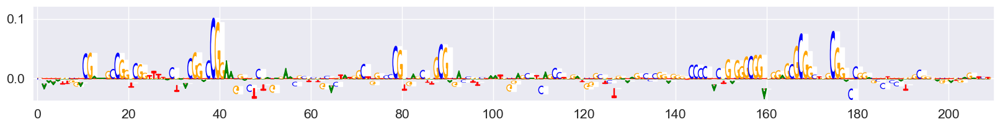

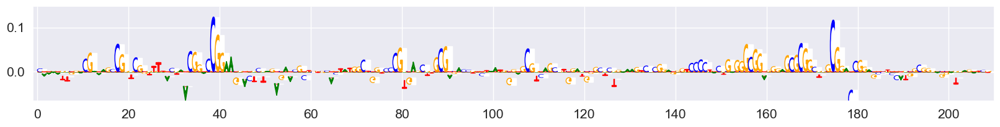

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

G C
ENSG00000141562.17
             motif_id gene_name
17_82458529  MA0524.3    TFAP2C
17_82458529  MA0811.2    TFAP2B
17_82458529  MA0810.2    TFAP2A
17_82458529  MA1569.2    TFAP2E
17_82458529  MA0810.2    TFAP2A
17_82458529  MA1569.2    TFAP2E
17_82458529  MA0814.3    TFAP2C
17_82458529  MA0812.2    TFAP2B
17_82458529  MA0812.2    TFAP2B
17_82458529  MA0003.5    TFAP2A
17_82458529  MA0684.3     RUNX3
17_82458529  MA0511.2     RUNX2
17_82458529  MA0131.3     HINFP
17_82458529  MA0599.1      KLF5
17_82458529  MA1987.2    ZNF701
17_82458529  MA1564.2       SP9
17_82458529  MA1517.2      KLF6
17_82458529  MA0742.2     KLF12
17_82458529  MA1511.2     KLF10
17_82458529  MA0685.2       SP4
17_82458529  MA0516.3       SP2
17_82458529  MA0079.5       SP1
17_82458529  MA1986.2    ZNF692
17_82458529  MA1959.2      KLF7
17_82458529  MA1515.2      KLF2
17_82458529  MA1513.2     KLF15
17_82458529  MA0493.3      KLF1
17_82458529  MA0740.2     KLF14
17_82458529  MA0528.3    ZNF263
17_82458529  MA23

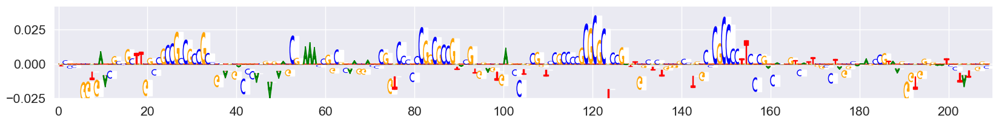

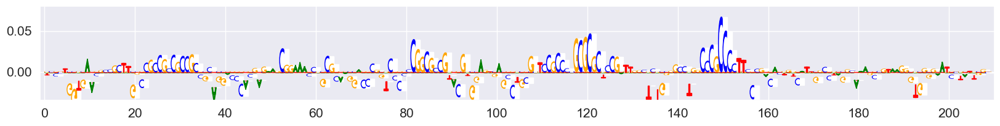

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

G T
ENSG00000101751.10
             motif_id gene_name
18_54269477  MA1580.1    ZBTB32
18_54269477  MA1542.2      OSR1
18_54269477  MA0712.3      OTX2
18_54269477  MA0719.2    RHOXF1
18_54269477  MA0714.2     PITX3
18_54269477  MA0711.2      OTX1
18_54269477  MA0682.3     PITX1


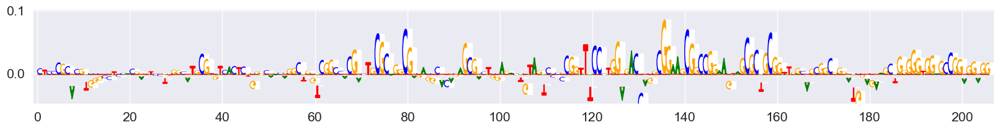

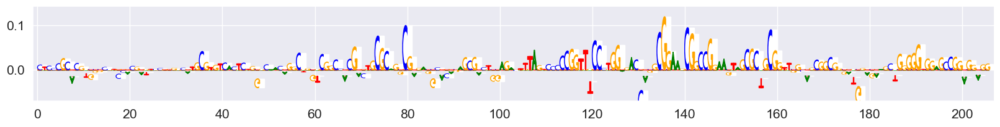

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

A T
ENSG00000133313.14
             motif_id gene_name
18_74496224  MA1723.2     PRDM9
18_74496224  MA2328.1     ZBED4
18_74496224  MA1961.2     PATZ1
18_74496224  MA0079.5       SP1
18_74496224  MA0516.3       SP2
18_74496224  MA0740.2     KLF14
18_74496224  MA0599.1      KLF5
18_74496224  MA1710.2    ZNF257
18_74496224  MA0258.2      ESR2
18_74496224  MA0508.4     PRDM1
18_74496224  MA1731.2    ZNF768
18_74496224  MA0599.1      KLF5
18_74496224  MA1523.2   MSANTD3
18_74496224  MA1563.2     SOX18
18_74496224  MA0914.2      ISL2
18_74496224  MA0782.3    PKNOX1
18_74496224  MA1114.2      PBX3


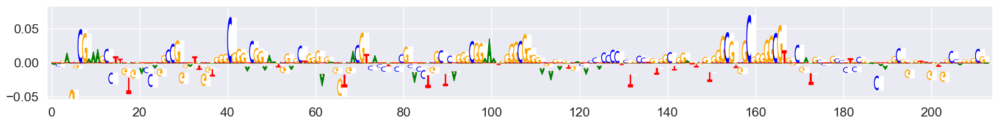

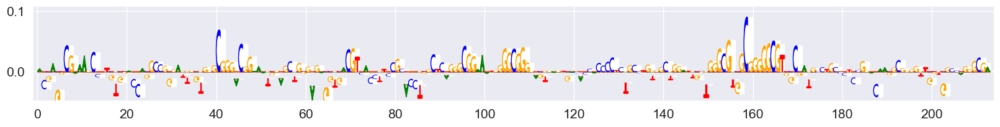

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

A C
ENSG00000130803.14
            motif_id gene_name
19_9140308  MA0468.1      DUX4
19_9140308  MA0479.2     FOXH1
19_9140308  MA1509.1      IRF6
19_9140308  MA1115.2    POU5F1
19_9140308  MA0619.2     LIN54
19_9140308  MA1964.2     SMAD2
19_9140308  MA1971.2     ZBED2
19_9140308  MA1536.2     NR2C2
19_9140308  MA1534.2     NR1I3
19_9140308  MA0114.5     HNF4A
19_9140308  MA0484.3     HNF4G
19_9140308  MA1574.2      THRB
19_9140308  MA2003.2    NKX2-4
19_9140308  MA1534.2     NR1I3
19_9140308  MA0673.2    NKX2-8
19_9140308  MA0684.3     RUNX3
19_9140308  MA1536.2     NR2C2
19_9140308  MA0523.2    TCF7L2


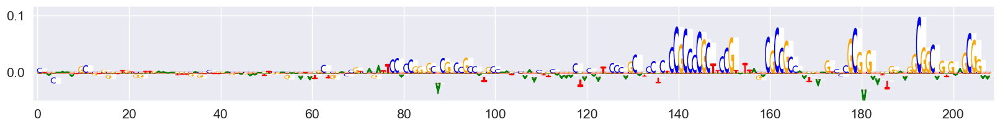

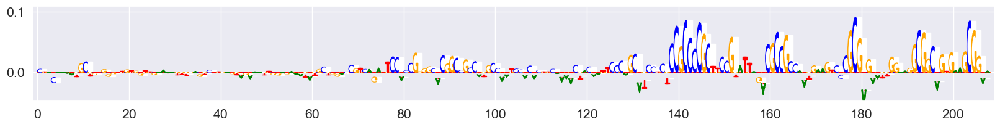

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

G A
ENSG00000256771.3
             motif_id gene_name
19_19866179  MA1485.1    FERD3L
19_19866179  MA1485.1    FERD3L
19_19866179  MA0641.1      ELF4
19_19866179  MA1548.2    PLAGL2
19_19866179  MA1986.2    ZNF692
19_19866179  MA1961.2     PATZ1
19_19866179  MA1548.2    PLAGL2
19_19866179  MA1548.2    PLAGL2
19_19866179  MA0079.5       SP1
19_19866179  MA0742.2     KLF12
19_19866179  MA1511.2     KLF10
19_19866179  MA1516.2      KLF3
19_19866179  MA1726.2    ZNF331
19_19866179  MA1986.2    ZNF692
19_19866179  MA0671.2      NFIX
19_19866179  MA1583.2     ZFP57
19_19866179  MA1650.2    ZBTB14
19_19866179  MA1485.1    FERD3L
19_19866179  MA1485.1    FERD3L
19_19866179  MA0641.1      ELF4
19_19866179  MA1548.2    PLAGL2
19_19866179  MA1986.2    ZNF692
19_19866179  MA1961.2     PATZ1
19_19866179  MA1548.2    PLAGL2
19_19866179  MA1548.2    PLAGL2
19_19866179  MA0079.5       SP1
19_19866179  MA0742.2     KLF12
19_19866179  MA1511.2     KLF10
19_19866179  MA1516.2      KLF3
19_19866179  MA172

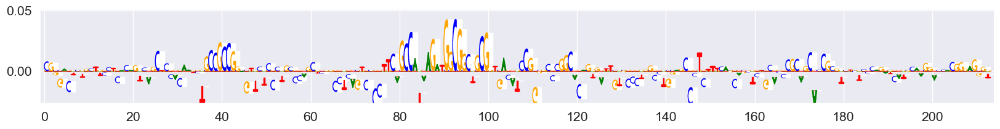

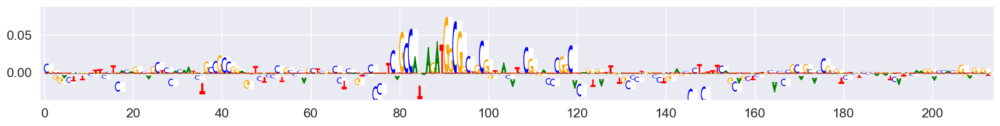

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

T G
ENSG00000142230.11
             motif_id gene_name
19_47131056  MA1554.2      RFX7
19_47131056  MA0524.3    TFAP2C
19_47131056  MA0811.2    TFAP2B
19_47131056  MA0594.3     HOXA9
19_47131056  MA0893.3      GSX2
19_47131056  MA1545.2     OVOL2
19_47131056  MA0524.3    TFAP2C
19_47131056  MA0810.2    TFAP2A
19_47131056  MA0811.2    TFAP2B
19_47131056  MA1569.2    TFAP2E
19_47131056  MA1569.2    TFAP2E
19_47131056  MA1517.2      KLF6
19_47131056  MA0599.1      KLF5


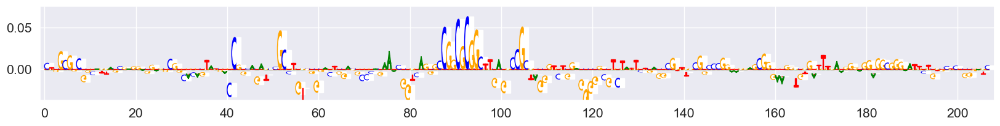

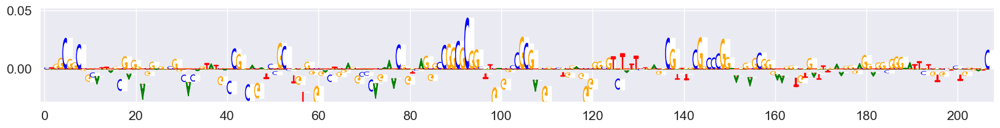

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

A T
ENSG00000180279.6
             motif_id gene_name
19_50804968  MA1581.2     ZBTB6
19_50804968  MA1721.2     ZNF93
19_50804968  MA1593.2    ZNF317
19_50804968  MA1579.2    ZBTB26
19_50804968  MA0733.2      EGR4
19_50804968  MA0732.2      EGR3
19_50804968  MA0472.2      EGR2
19_50804968  MA2003.2    NKX2-4
19_50804968  MA1726.2    ZNF331
19_50804968  MA1100.3     ASCL1
19_50804968  MA1100.3     ASCL1
19_50804968  MA1646.2      OSR2
19_50804968  MA0048.3     NHLH1
19_50804968  MA1981.2    ZNF530
19_50804968  MA1638.2     HAND2
19_50804968  MA1731.2    ZNF768
19_50804968  MA1653.2    ZNF148
19_50804968  MA1961.2     PATZ1
19_50804968  MA0746.3       SP3
19_50804968  MA0741.1     KLF16
19_50804968  MA1630.3    ZNF281
19_50804968  MA1564.2       SP9
19_50804968  MA1512.2     KLF11
19_50804968  MA2099.1    ZNF770
19_50804968  MA0079.5       SP1
19_50804968  MA0516.3       SP2
19_50804968  MA0685.2       SP4
19_50804968  MA0740.2     KLF14
19_50804968  MA0742.2     KLF12
19_50804968  MA151

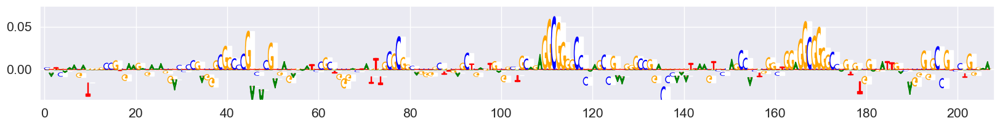

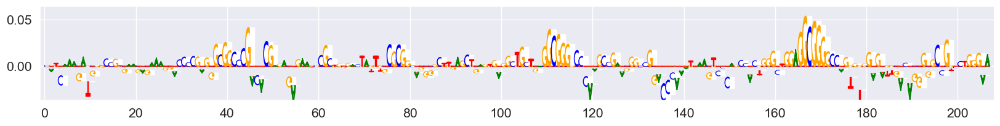

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

A G
ENSG00000108107.14
             motif_id gene_name
19_55385959  MA1529.2     NHLH2
19_55385959  MA1529.2     NHLH2
19_55385959  MA0670.2      NFIA
19_55385959  MA1116.2      RBPJ
19_55385959  MA0161.3      NFIC
19_55385959  MA1972.1     ZFP14
19_55385959  MA2326.1     IKZF2
19_55385959  MA1717.2    ZNF784
19_55385959  MA0685.2       SP4
19_55385959  MA0599.1      KLF5


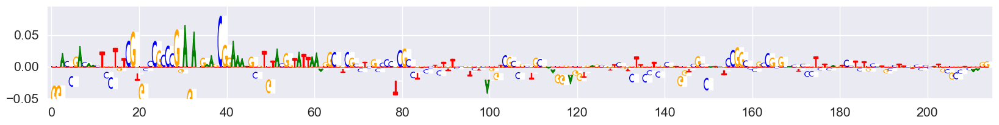

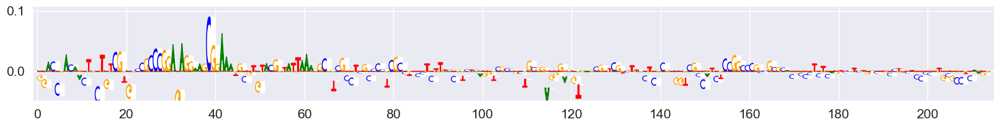

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

G GC
ENSG00000179909.15
             motif_id gene_name
19_57709211  MA1548.2    PLAGL2
19_57709211  MA2099.1    ZNF770
19_57709211  MA1548.2    PLAGL2
19_57709211  MA1548.2    PLAGL2
19_57709211  MA1548.2    PLAGL2
19_57709211  MA1986.2    ZNF692
19_57709211  MA0733.2      EGR4
19_57709211  MA0162.5      EGR1
19_57709211  MA1548.2    PLAGL2
19_57709211  MA0695.2    ZBTB7C
19_57709211  MA0736.1     GLIS2
19_57709211  MA0694.2    ZBTB7B
19_57709211  MA1578.2     VEZF1
19_57709211  MA1548.2    PLAGL2
19_57709211  MA1102.3     CTCFL
19_57709211  MA1513.2     KLF15
19_57709211  MA1515.2      KLF2
19_57709211  MA0753.3    ZNF740
19_57709211  MA0740.2     KLF14
19_57709211  MA1965.2       SP5
19_57709211  MA0753.3    ZNF740
19_57709211  MA1536.2     NR2C2
19_57709211  MA1578.2     VEZF1
19_57709211  MA1522.2       MAZ


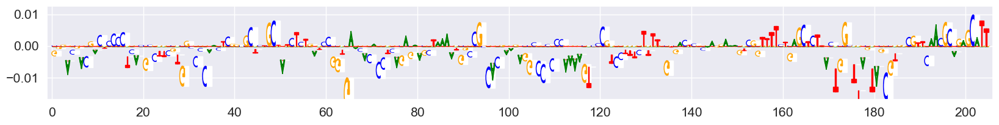

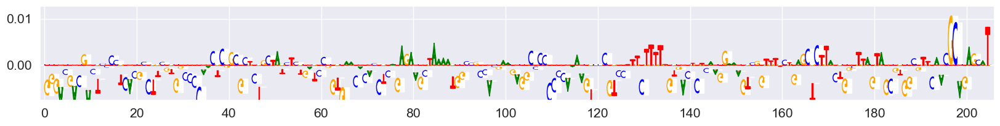

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

A C
ENSG00000138050.14
            motif_id gene_name
2_39779290  MA1516.2      KLF3
2_39779290  MA2096.1    ZNF524
2_39779290  MA0865.3      E2F8
2_39779290  MA0649.2      HEY2
2_39779290  MA0616.3      HES2
2_39779290  MA1122.2     TFDP1
2_39779290  MA1099.3      HES1
2_39779290  MA0471.3      E2F6
2_39779290  MA0821.2      HES5
2_39779290  MA0821.2      HES5
2_39779290  MA0823.1      HEY1
2_39779290  MA0810.2    TFAP2A
2_39779290  MA1982.2    ZNF574
2_39779290  MA0014.4      PAX5
2_39779290  MA0632.3     TCFL5
2_39779290  MA0632.3     TCFL5
2_39779290  MA0162.5      EGR1
2_39779290  MA1653.2    ZNF148
2_39779290  MA1099.3      HES1
2_39779290  MA0632.3     TCFL5
2_39779290  MA1522.2       MAZ
2_39779290  MA1713.2    ZNF610


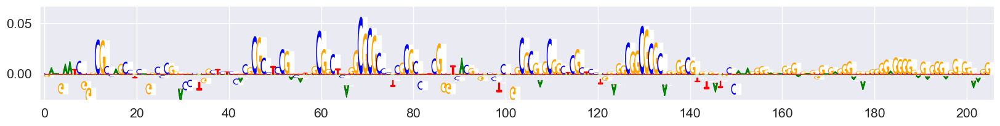

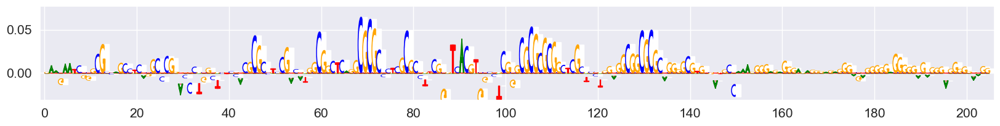

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

T G
ENSG00000162994.15
            motif_id  gene_name
2_55232237  MA1529.2      NHLH2
2_55232237  MA1529.2      NHLH2
2_55232237  MA1710.2     ZNF257
2_55232237  MA0829.3     SREBF1
2_55232237  MA1570.1      TFAP4
...              ...        ...
2_55232237  MA1928.2       BNC2
2_55232237  MA1634.2       BATF
2_55232237  MA0835.3      BATF3
2_55232237  MA0462.3  BATF::JUN
2_55232237  MA0719.2     RHOXF1

[76 rows x 2 columns]


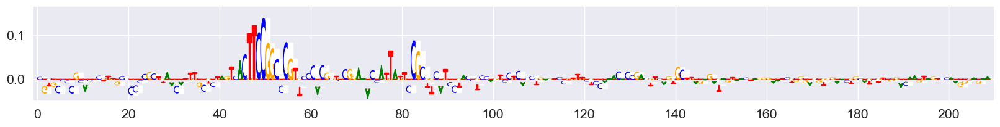

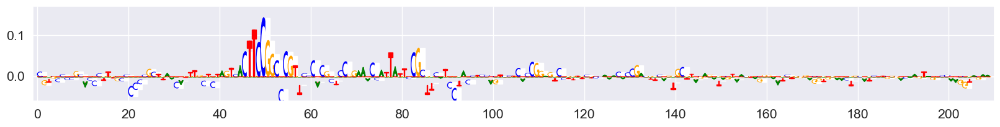

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

C CCCGCCCCCTCA
ENSG00000035141.7
            motif_id gene_name
2_70302073  MA0646.2      GCM1
2_70302073  MA2325.1     EPAS1
2_70302073  MA1548.2    PLAGL2
2_70302073  MA1986.2    ZNF692
2_70302073  MA0671.2      NFIX
2_70302073  MA1516.2      KLF3
2_70302073  MA1548.2    PLAGL2
2_70302073  MA0131.3     HINFP
2_70302073  MA1986.2    ZNF692
2_70302073  MA0671.2      NFIX
2_70302073  MA0471.3      E2F6
2_70302073  MA1548.2    PLAGL2
2_70302073  MA0599.1      KLF5
2_70302073  MA0741.1     KLF16
2_70302073  MA0746.3       SP3
2_70302073  MA1107.3      KLF9
2_70302073  MA1961.2     PATZ1
2_70302073  MA0742.2     KLF12
2_70302073  MA1511.2     KLF10
2_70302073  MA1517.2      KLF6
2_70302073  MA1512.2     KLF11
2_70302073  MA1516.2      KLF3
2_70302073  MA1515.2      KLF2
2_70302073  MA1564.2       SP9
2_70302073  MA1630.3    ZNF281
2_70302073  MA1653.2    ZNF148
2_70302073  MA0747.2       SP8
2_70302073  MA0685.2       SP4
2_70302073  MA0740.2     KLF14
2_70302073  MA0039.5      KLF4
2_7030

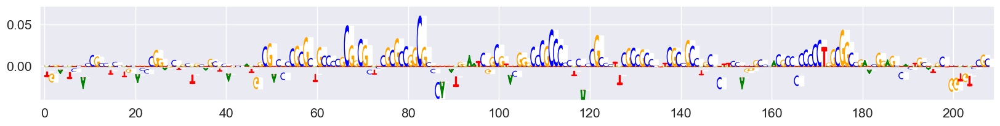

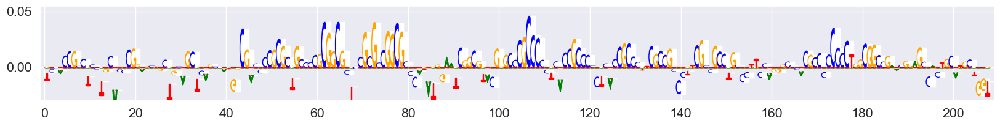

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

G C
ENSG00000144115.16
            motif_id gene_name
2_88170344  MA0810.2    TFAP2A
2_88170344  MA0599.1      KLF5
2_88170344  MA0524.3    TFAP2C
2_88170344  MA0810.2    TFAP2A
2_88170344  MA0811.2    TFAP2B
2_88170344  MA1961.2     PATZ1
2_88170344  MA0736.1     GLIS2
2_88170344  MA1511.2     KLF10
2_88170344  MA0740.2     KLF14
2_88170344  MA0511.2     RUNX2
2_88170344  MA0079.5       SP1
2_88170344  MA1511.2     KLF10
2_88170344  MA0685.2       SP4
2_88170344  MA1959.2      KLF7
2_88170344  MA0684.3     RUNX3
2_88170344  MA1515.2      KLF2
2_88170344  MA1536.2     NR2C2
2_88170344  MA0524.3    TFAP2C
2_88170344  MA0810.2    TFAP2A
2_88170344  MA0811.2    TFAP2B


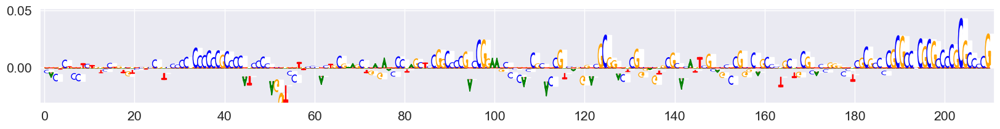

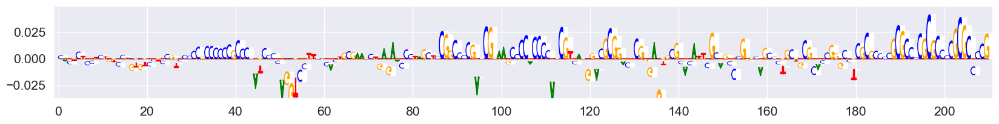

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

C G
ENSG00000260742.1
             motif_id gene_name
2_181892173  MA1099.3      HES1
2_181892173  MA0821.2      HES5
2_181892173  MA0821.2      HES5
2_181892173  MA0850.1     FOXP3
2_181892173  MA1099.3      HES1
2_181892173  MA0472.2      EGR2
2_181892173  MA1536.2     NR2C2
2_181892173  MA0498.3     MEIS1
2_181892173  MA1638.2     HAND2


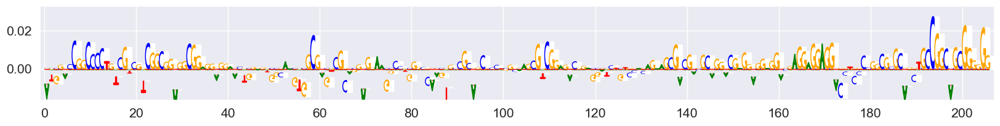

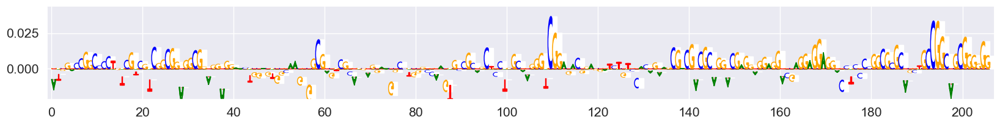

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

C A
ENSG00000225377.5
           motif_id gene_name
20_324557  MA0472.2      EGR2
20_324557  MA0732.2      EGR3
20_324557  MA0733.2      EGR4
20_324557  MA1552.2      RARB
20_324557  MA0657.2     KLF13
...             ...       ...
20_324557  MA1569.2    TFAP2E
20_324557  MA0524.3    TFAP2C
20_324557  MA0811.2    TFAP2B
20_324557  MA1569.2    TFAP2E
20_324557  MA1569.2    TFAP2E

[78 rows x 2 columns]


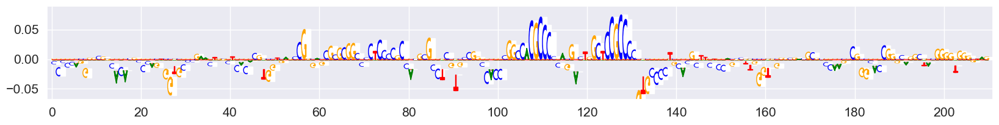

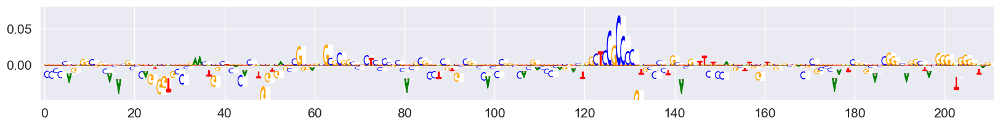

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

C T
ENSG00000126005.16
             motif_id gene_name
20_35278226  MA0727.2     NR3C2
20_35278226  MA0727.2     NR3C2
20_35278226  MA0113.4     NR3C1
20_35278226  MA0113.4     NR3C1
20_35278226  MA0101.1       REL
20_35278226  MA1536.2     NR2C2
20_35278226  MA1534.2     NR1I3
20_35278226  MA2003.2    NKX2-4
20_35278226  MA0673.2    NKX2-8
20_35278226  MA0684.3     RUNX3
20_35278226  MA1536.2     NR2C2
20_35278226  MA1578.2     VEZF1
20_35278226  MA1656.2    ZNF449
20_35278226  MA0810.2    TFAP2A


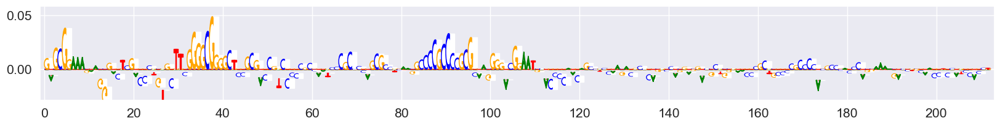

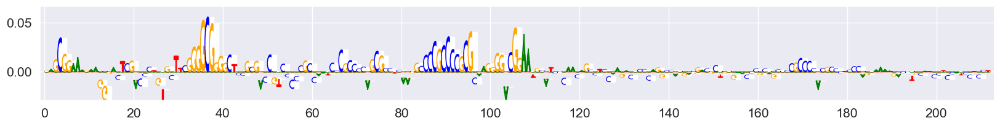

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

G A
ENSG00000132824.13
             motif_id    gene_name
20_44521668  MA2328.1        ZBED4
20_44521668  MA1564.2          SP9
20_44521668  MA0746.3          SP3
20_44521668  MA1961.2        PATZ1
20_44521668  MA0740.2        KLF14
20_44521668  MA0599.1         KLF5
20_44521668  MA1517.2         KLF6
20_44521668  MA1511.2        KLF10
20_44521668  MA0742.2        KLF12
20_44521668  MA0685.2          SP4
20_44521668  MA0516.3          SP2
20_44521668  MA0079.5          SP1
20_44521668  MA1516.2         KLF3
20_44521668  MA1959.2         KLF7
20_44521668  MA1515.2         KLF2
20_44521668  MA1513.2        KLF15
20_44521668  MA0493.3         KLF1
20_44521668  MA0039.5         KLF4
20_44521668  MA0528.3       ZNF263
20_44521668  MA1726.2       ZNF331
20_44521668  MA0130.1      ZNF354C
20_44521668  MA0131.3        HINFP
20_44521668  MA2328.1        ZBED4
20_44521668  MA1966.2  TFAP4::ETV1
20_44521668  MA0625.3       NFATC3
20_44521668  MA0478.2        FOSL2
20_44521668  MA1727.2       ZNF4

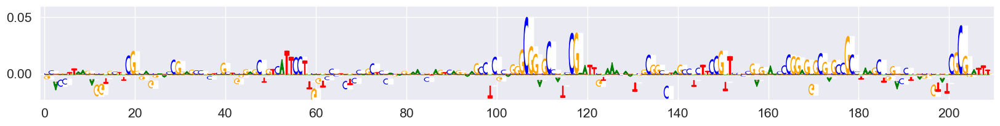

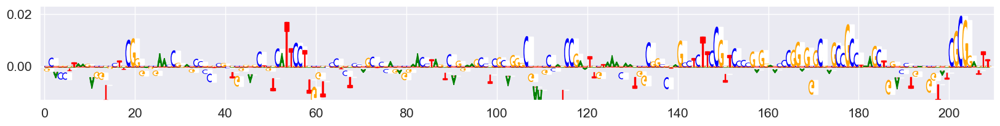

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

G A
ENSG00000187118.12
            motif_id     gene_name
3_28241610  MA1961.2         PATZ1
3_28241610  MA1713.2        ZNF610
3_28241610  MA1935.2    ERF::FOXI1
3_28241610  MA0641.1          ELF4
3_28241610  MA0740.2         KLF14
3_28241610  MA0516.3           SP2
3_28241610  MA0079.5           SP1
3_28241610  MA0748.3           YY2
3_28241610  MA1483.3          ELF2
3_28241610  MA1932.2  ELK1::HOXB13
3_28241610  MA1957.1   HOXB2::ELK1
3_28241610  MA1945.2   ETV5::FIGLA
3_28241610  MA1484.2          ETS2
3_28241610  MA0765.4          ETV5
3_28241610  MA0764.4          ETV4
3_28241610  MA0763.2          ETV3
3_28241610  MA0761.3          ETV1
3_28241610  MA0760.2           ERF
3_28241610  MA0759.3          ELK3
3_28241610  MA0475.3          FLI1
3_28241610  MA0762.2          ETV2
3_28241610  MA0156.4           FEV
3_28241610  MA0098.4          ETS1
3_28241610  MA0028.3          ELK1
3_28241610  MA0471.3          E2F6
3_28241610  MA0473.4          ELF1
3_28241610  MA1966.2   TFAP4::ET

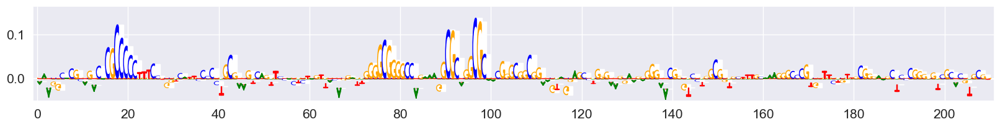

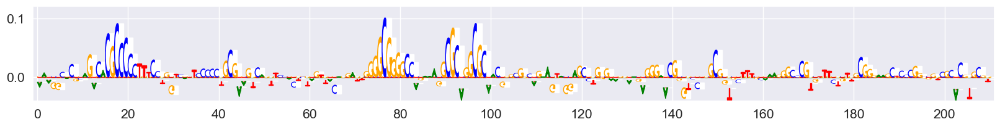

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

C CGGCGG
ENSG00000172936.12
            motif_id gene_name
3_38138612  MA0051.2      IRF2
3_38138612  MA0815.1    TFAP2C
3_38138612  MA0872.1    TFAP2A
3_38138612  MA0872.1    TFAP2A
3_38138612  MA0815.1    TFAP2C
3_38138612  MA0813.1    TFAP2B
3_38138612  MA0813.1    TFAP2B
3_38138612  MA0811.2    TFAP2B
3_38138612  MA0810.2    TFAP2A
3_38138612  MA0810.2    TFAP2A
3_38138612  MA0747.2       SP8
3_38138612  MA0524.3    TFAP2C
3_38138612  MA0812.2    TFAP2B
3_38138612  MA1961.2     PATZ1
3_38138612  MA0811.2    TFAP2B
3_38138612  MA0810.2    TFAP2A
3_38138612  MA0524.3    TFAP2C
3_38138612  MA1653.2    ZNF148
3_38138612  MA1569.2    TFAP2E
3_38138612  MA1569.2    TFAP2E
3_38138612  MA0814.3    TFAP2C
3_38138612  MA0812.2    TFAP2B
3_38138612  MA1648.2     TCF12
3_38138612  MA0522.4      TCF3
3_38138612  MA1569.2    TFAP2E
3_38138612  MA1569.2    TFAP2E
3_38138612  MA0067.3      PAX2
3_38138612  MA2094.1      PAX8
3_38138612  MA1522.2       MAZ
3_38138612  MA1959.2      KLF7
3_38138612 

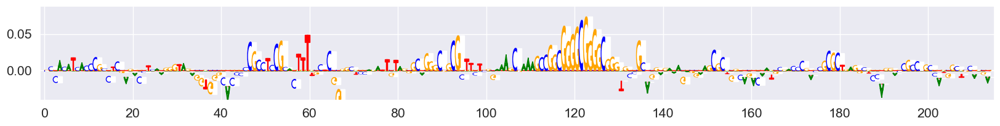

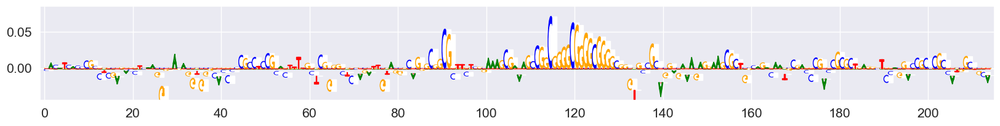

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

C A
ENSG00000162267.12
            motif_id gene_name
3_52835247  MA0658.2      LHX6
3_52835247  MA0068.2      PAX4
3_52835247  MA0060.4      NFYA
3_52835247  MA1644.2      NFYC
3_52835247  MA0502.3      NFYB
3_52835247  MA1117.2      RELB
3_52835247  MA0736.1     GLIS2
3_52835247  MA0811.2    TFAP2B
3_52835247  MA0524.3    TFAP2C
3_52835247  MA0810.2    TFAP2A
3_52835247  MA0810.2    TFAP2A
3_52835247  MA0810.2    TFAP2A
3_52835247  MA0811.2    TFAP2B
3_52835247  MA0811.2    TFAP2B
3_52835247  MA0524.3    TFAP2C
3_52835247  MA1569.2    TFAP2E
3_52835247  MA1569.2    TFAP2E
3_52835247  MA0524.3    TFAP2C
3_52835247  MA0810.2    TFAP2A
3_52835247  MA0811.2    TFAP2B
3_52835247  MA0524.3    TFAP2C
3_52835247  MA1569.2    TFAP2E
3_52835247  MA1569.2    TFAP2E
3_52835247  MA0814.3    TFAP2C
3_52835247  MA0812.2    TFAP2B
3_52835247  MA0812.2    TFAP2B
3_52835247  MA0003.5    TFAP2A


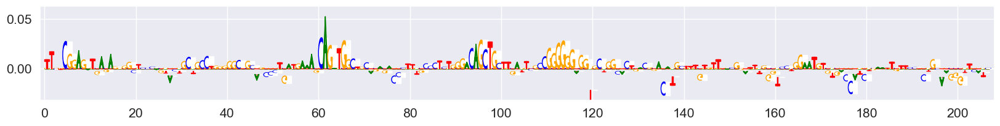

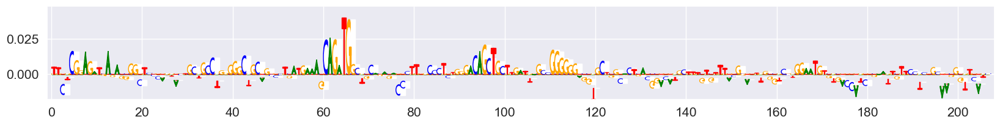

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

T C
ENSG00000272886.5
            motif_id gene_name
3_53347519  MA1651.2     ZFP42
3_53347519  MA1123.3    TWIST1
3_53347519  MA1109.2   NEUROD1
3_53347519  MA1642.2   NEUROG2
3_53347519  MA1638.2     HAND2
3_53347519  MA0673.2    NKX2-8
3_53347519  MA2003.2    NKX2-4
3_53347519  MA0723.3      VAX2
3_53347519  MA0619.2     LIN54
3_53347519  MA2096.1    ZNF524
3_53347519  MA1478.2    DMRTA2
3_53347519  MA1547.2     PITX2


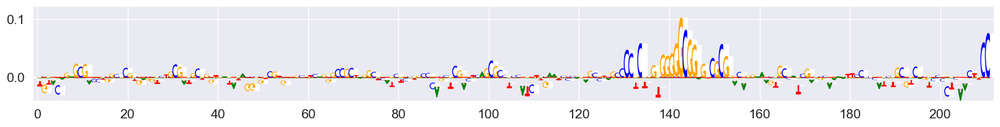

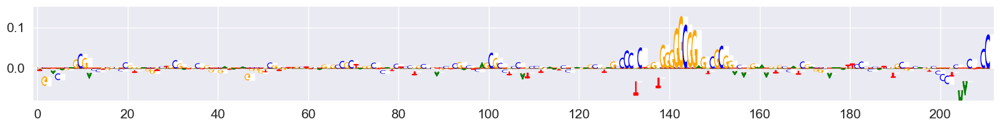

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

C T
ENSG00000163684.11
            motif_id gene_name
3_58306531  MA1723.2     PRDM9
3_58306531  MA1533.2     NR1I2
3_58306531  MA0504.2     NR2C2
3_58306531  MA0599.1      KLF5
3_58306531  MA1630.3    ZNF281
3_58306531  MA1564.2       SP9
3_58306531  MA0599.1      KLF5
3_58306531  MA2096.1    ZNF524
3_58306531  MA1511.2     KLF10
3_58306531  MA0742.2     KLF12
3_58306531  MA0740.2     KLF14
3_58306531  MA0685.2       SP4
3_58306531  MA0516.3       SP2
3_58306531  MA0079.5       SP1
3_58306531  MA1959.2      KLF7
3_58306531  MA0493.3      KLF1
3_58306531  MA0740.2     KLF14
3_58306531  MA1535.2     NR2C1
3_58306531  MA1536.2     NR2C2
3_58306531  MA0695.2    ZBTB7C
3_58306531  MA0694.2    ZBTB7B
3_58306531  MA0524.3    TFAP2C
3_58306531  MA0810.2    TFAP2A
3_58306531  MA0811.2    TFAP2B
3_58306531  MA0810.2    TFAP2A
3_58306531  MA1712.2    ZNF454
3_58306531  MA0811.2    TFAP2B
3_58306531  MA0810.2    TFAP2A
3_58306531  MA0524.3    TFAP2C
3_58306531  MA1569.2    TFAP2E
3_58306531  MA15

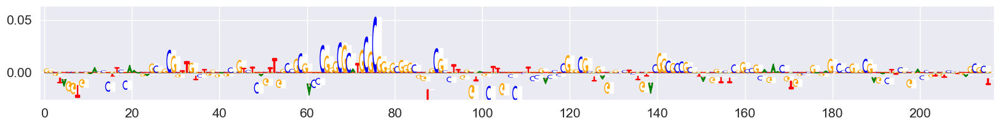

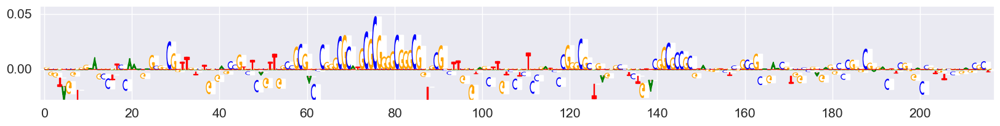

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

C T
ENSG00000163608.14
             motif_id gene_name
3_113019471  MA0733.2      EGR4
3_113019471  MA0746.3       SP3
3_113019471  MA1961.2     PATZ1
3_113019471  MA1107.3      KLF9
3_113019471  MA0741.1     KLF16
...               ...       ...
3_113019471  MA1106.2     HIF1A
3_113019471  MA0819.3     CLOCK
3_113019471  MA0632.3     TCFL5
3_113019471  MA0616.3      HES2
3_113019471  MA0649.2      HEY2

[78 rows x 2 columns]


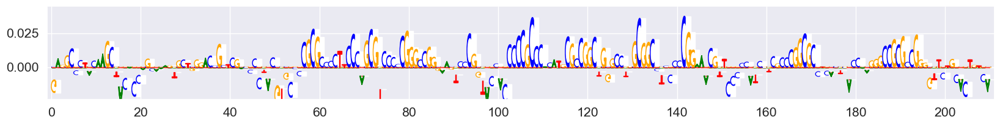

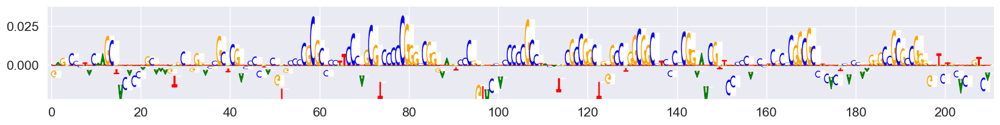

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

A G
ENSG00000250934.1
             motif_id gene_name
3_126287675  MA0144.3     STAT3
3_126287675  MA0625.3    NFATC3
3_126287675  MA1116.2      RBPJ
3_126287675  MA1525.3    NFATC4
3_126287675  MA0625.3    NFATC3
...               ...       ...
3_126287675  MA1642.2   NEUROG2
3_126287675  MA0104.5      MYCN
3_126287675  MA0104.5      MYCN
3_126287675  MA0147.4       MYC
3_126287675  MA0147.4       MYC

[76 rows x 2 columns]


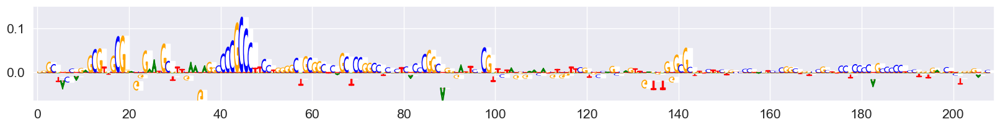

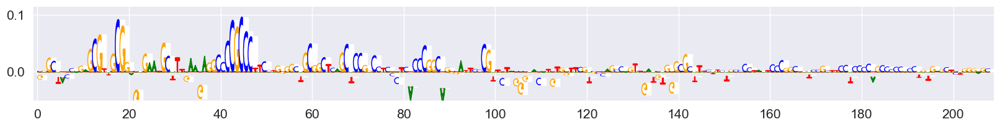

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

C CA
ENSG00000232874.1
             motif_id gene_name
3_194134863  MA0073.2     RREB1
3_194134863  MA0073.2     RREB1
3_194134863  MA0073.2     RREB1
3_194134863  MA0741.1     KLF16
3_194134863  MA1107.3      KLF9
...               ...       ...
3_194134863  MA1578.2     VEZF1
3_194134863  MA0039.5      KLF4
3_194134863  MA0767.2      GCM2
3_194134863  MA1515.2      KLF2
3_194134863  MA0493.3      KLF1

[81 rows x 2 columns]


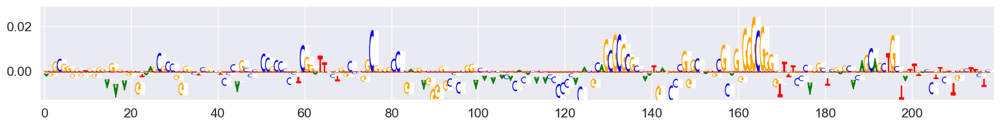

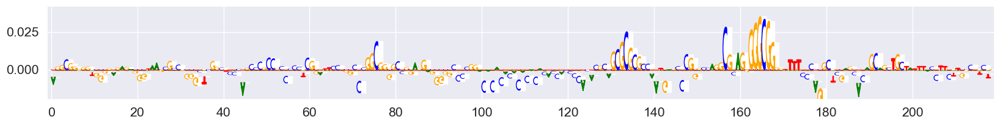

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

C T
ENSG00000035928.15
            motif_id    gene_name
4_39366463  MA1723.2        PRDM9
4_39366463  MA0258.2         ESR2
4_39366463  MA1533.2        NR1I2
4_39366463  MA1099.3         HES1
4_39366463  MA1631.2        ASCL1
4_39366463  MA1559.2        SNAI3
4_39366463  MA1961.2        PATZ1
4_39366463  MA1569.2       TFAP2E
4_39366463  MA1569.2       TFAP2E
4_39366463  MA0830.3         TCF4
4_39366463  MA1648.2        TCF12
4_39366463  MA1558.2        SNAI1
4_39366463  MA0522.4         TCF3
4_39366463  MA0103.4         ZEB1
4_39366463  MA0820.2        FIGLA
4_39366463  MA0516.3          SP2
4_39366463  MA0767.2         GCM2
4_39366463  MA1513.2        KLF15
4_39366463  MA1515.2         KLF2
4_39366463  MA2341.1        FEZF2
4_39366463  MA1578.2        VEZF1
4_39366463  MA1548.2       PLAGL2
4_39366463  MA0471.3         E2F6
4_39366463  MA1986.2       ZNF692
4_39366463  MA0671.2         NFIX
4_39366463  MA1538.1        NR2F1
4_39366463  MA1548.2       PLAGL2
4_39366463  MA1728.2     

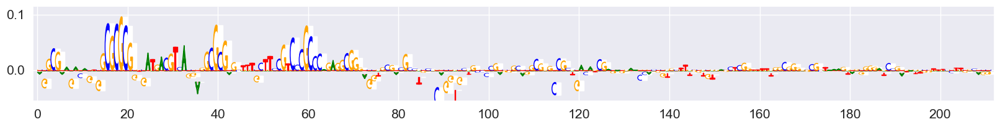

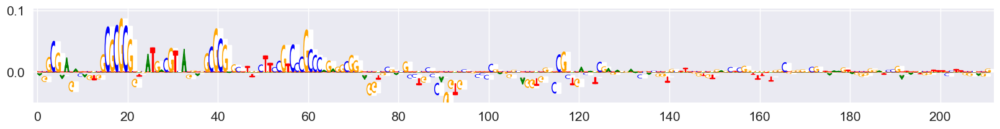

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

G C
ENSG00000014824.13
            motif_id gene_name
4_41990735  MA1981.2    ZNF530
4_41990735  MA1961.2     PATZ1
4_41990735  MA1713.2    ZNF610
4_41990735  MA0599.1      KLF5
4_41990735  MA0812.2    TFAP2B
4_41990735  MA1569.2    TFAP2E
4_41990735  MA1569.2    TFAP2E
4_41990735  MA0810.2    TFAP2A
4_41990735  MA0748.3       YY2
4_41990735  MA1583.2     ZFP57
4_41990735  MA1102.3     CTCFL
4_41990735  MA1536.2     NR2C2
4_41990735  MA1720.2     ZNF85


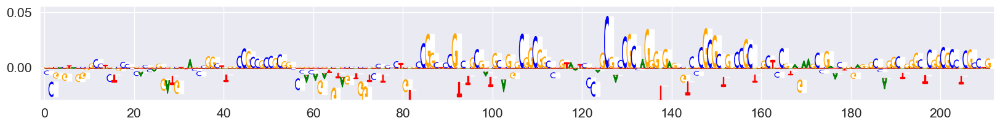

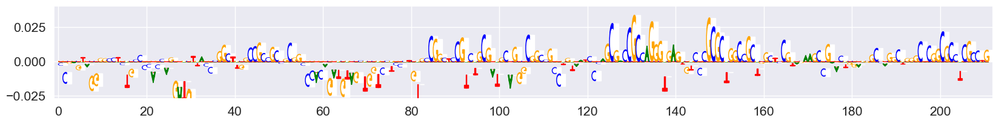

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

G GCGCGTCCCCGCCCCGCGC
ENSG00000128039.10
            motif_id gene_name
4_55346203  MA1726.2    ZNF331
4_55346203  MA1655.2    ZNF341
4_55346203  MA1719.2    ZNF816
4_55346203  MA1650.2    ZBTB14
4_55346203  MA0632.3     TCFL5
4_55346203  MA1099.3      HES1
4_55346203  MA1517.2      KLF6
4_55346203  MA2325.1     EPAS1
4_55346203  MA1106.2     HIF1A
4_55346203  MA0014.4      PAX5
4_55346203  MA0632.3     TCFL5
4_55346203  MA0632.3     TCFL5
4_55346203  MA1560.2    SOHLH2
4_55346203  MA0616.3      HES2
4_55346203  MA0649.2      HEY2
4_55346203  MA1522.2       MAZ
4_55346203  MA1099.3      HES1
4_55346203  MA1726.2    ZNF331
4_55346203  MA1655.2    ZNF341
4_55346203  MA1719.2    ZNF816
4_55346203  MA1650.2    ZBTB14
4_55346203  MA0632.3     TCFL5
4_55346203  MA1099.3      HES1
4_55346203  MA1517.2      KLF6
4_55346203  MA2325.1     EPAS1
4_55346203  MA1106.2     HIF1A
4_55346203  MA0014.4      PAX5
4_55346203  MA0632.3     TCFL5
4_55346203  MA0632.3     TCFL5
4_55346203  MA1560.2    SOHLH

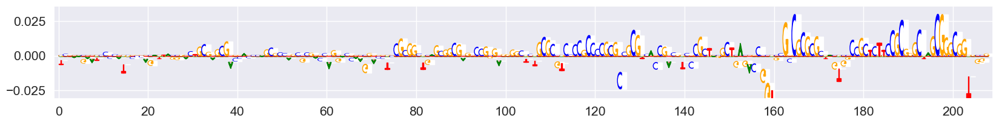

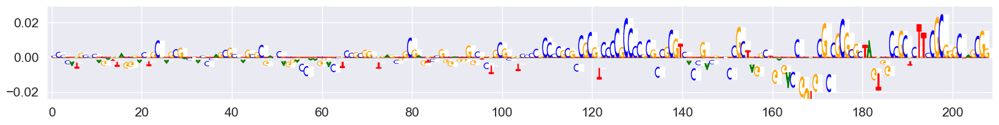

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

G C
ENSG00000084092.6
            motif_id gene_name
4_56977697  MA1977.2    ZNF324
4_56977697  MA0060.4      NFYA
4_56977697  MA1644.2      NFYC
4_56977697  MA1717.2    ZNF784
4_56977697  MA0468.1      DUX4
4_56977697  MA1487.3     FOXE1
4_56977697  MA0847.4     FOXD2
4_56977697  MA1554.2      RFX7
4_56977697  MA1536.2     NR2C2
4_56977697  MA0850.1     FOXP3
4_56977697  MA0895.2    HMBOX1
4_56977697  MA0719.2    RHOXF1
4_56977697  MA1971.2     ZBED2
4_56977697  MA1536.2     NR2C2
4_56977697  MA1525.3    NFATC4


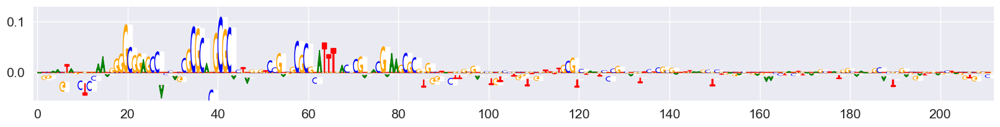

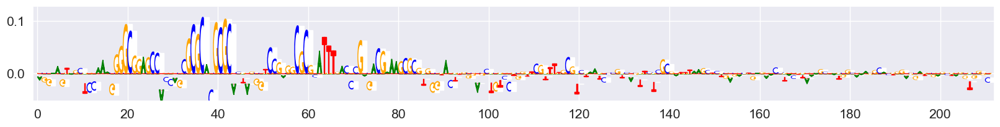

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

A G
ENSG00000236296.7
             motif_id    gene_name
4_143514784  MA1630.3       ZNF281
4_143514784  MA1547.2        PITX2
4_143514784  MA1124.1        ZNF24
4_143514784  MA0756.3      ONECUT2
4_143514784  MA0478.2        FOSL2
4_143514784  MA1128.2   FOSL1::JUN
4_143514784  MA1130.2   FOSL2::JUN
4_143514784  MA1134.2    FOS::JUNB
4_143514784  MA1135.2   FOSB::JUNB
4_143514784  MA1137.2  FOSL1::JUNB
4_143514784  MA1138.2  FOSL2::JUNB
4_143514784  MA1141.2    FOS::JUND
4_143514784  MA1144.2  FOSL2::JUND
4_143514784  MA1633.2        BACH1
4_143514784  MA0490.3         JUNB
4_143514784  MA1128.2   FOSL1::JUN
4_143514784  MA1132.2    JUN::JUNB
4_143514784  MA0476.2          FOS
4_143514784  MA1115.2       POU5F1
4_143514784  MA0033.2        FOXL1
4_143514784  MA1142.2  FOSL1::JUND
4_143514784  MA1563.2        SOX18
4_143514784  MA0099.4     FOS::JUN
4_143514784  MA0477.3        FOSL1
4_143514784  MA0477.3        FOSL1
4_143514784  MA0490.3         JUNB
4_143514784  MA1142.2  FOSL1::JUN

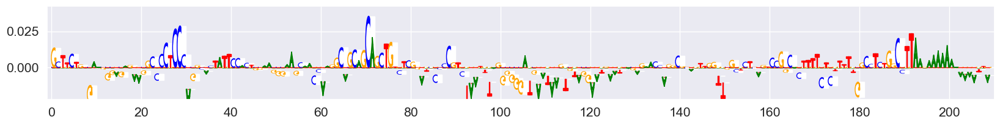

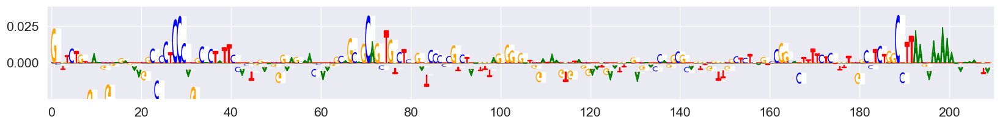

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

C G
ENSG00000109654.14
             motif_id gene_name
4_153222954  MA1979.2    ZNF416
4_153222954  MA0733.2      EGR4
4_153222954  MA0811.2    TFAP2B
4_153222954  MA0155.1     INSM1
4_153222954  MA0162.5      EGR1
4_153222954  MA0810.2    TFAP2A
4_153222954  MA1656.2    ZNF449
4_153222954  MA0695.2    ZBTB7C
4_153222954  MA2328.1     ZBED4
4_153222954  MA1650.2    ZBTB14
4_153222954  MA1986.2    ZNF692
4_153222954  MA0024.3      E2F1
4_153222954  MA0024.3      E2F1
4_153222954  MA0864.3      E2F2
4_153222954  MA0740.2     KLF14
4_153222954  MA1517.2      KLF6
4_153222954  MA0742.2     KLF12
4_153222954  MA0671.2      NFIX
4_153222954  MA0632.3     TCFL5
4_153222954  MA0865.3      E2F8
4_153222954  MA1986.2    ZNF692
4_153222954  MA1650.2    ZBTB14
4_153222954  MA1515.2      KLF2
4_153222954  MA1513.2     KLF15
4_153222954  MA0632.3     TCFL5
4_153222954  MA0014.4      PAX5
4_153222954  MA0738.2      HIC2
4_153222954  MA1099.3      HES1
4_153222954  MA0079.5       SP1
4_153222954  MA06

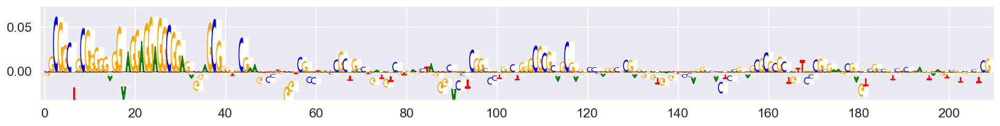

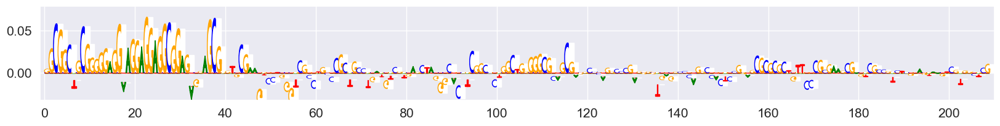

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

G T
ENSG00000137601.16
             motif_id gene_name
4_169612585  MA0767.2      GCM2
4_169612585  MA1534.2     NR1I3
4_169612585  MA1547.2     PITX2
4_169612585  MA0682.3     PITX1
4_169612585  MA0719.2    RHOXF1
4_169612585  MA0714.2     PITX3
4_169612585  MA0711.2      OTX1
4_169612585  MA0498.3     MEIS1
4_169612585  MA0867.3      SOX4
4_169612585  MA1569.2    TFAP2E
4_169612585  MA1569.2    TFAP2E
4_169612585  MA0442.3     SOX10
4_169612585  MA1152.2     SOX15


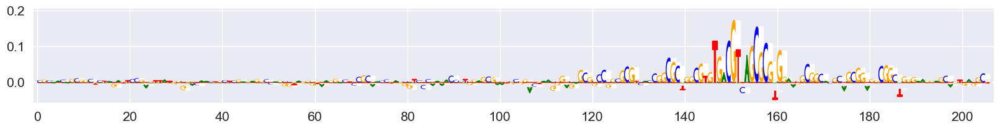

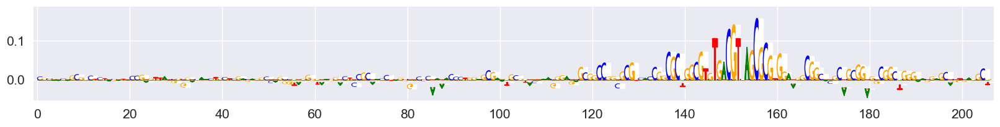

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

G GAA
ENSG00000271538.5
             motif_id gene_name
4_184537939  MA0674.2    NKX6-1
4_184537939  MA0850.1     FOXP3
4_184537939  MA2093.1     HOXB1
4_184537939  MA1505.2     HOXC8
4_184537939  MA1507.2     HOXD4
4_184537939  MA1549.2    POU6F1
4_184537939  MA1500.2     HOXB6
4_184537939  MA1497.2     HOXA6
4_184537939  MA0132.3      PDX1
4_184537939  MA0675.2    NKX6-2
4_184537939  MA0723.3      VAX2
4_184537939  MA0875.2     BARX1
4_184537939  MA0876.2       BSX
4_184537939  MA0879.3      DLX1
4_184537939  MA0888.2      EVX2
4_184537939  MA0892.2      GSX1
4_184537939  MA0900.3     HOXA2
4_184537939  MA0902.3     HOXB2
4_184537939  MA0903.2     HOXB3
4_184537939  MA1498.3     HOXA7
4_184537939  MA1499.2     HOXB4
4_184537939  MA1504.2     HOXC4
4_184537939  MA1505.2     HOXC8
4_184537939  MA1708.2      ETV7
4_184537939  MA1525.3    NFATC4
4_184537939  MA0598.4       EHF
4_184537939  MA0640.3      ELF3
4_184537939  MA0625.3    NFATC3
4_184537939  MA2326.1     IKZF2
4_184537939  MA1

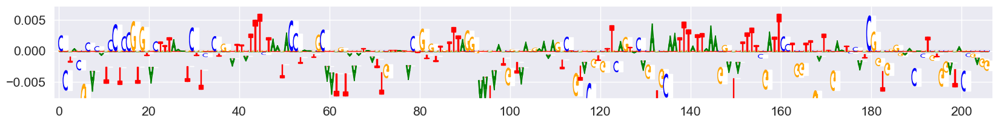

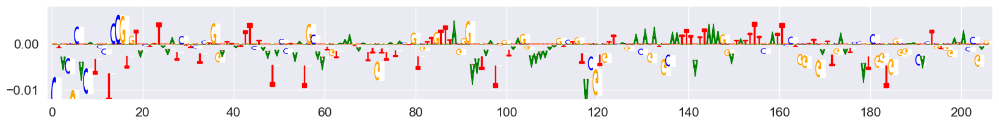

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

C T
ENSG00000132357.13
            motif_id    gene_name
5_40835525  MA0838.1        CEBPG
5_40835525  MA0689.1        TBX20
5_40835525  MA1565.2        TBX18
5_40835525  MA0690.3        TBX21
5_40835525  MA1566.3         TBX3
5_40835525  MA0802.2         TBR1
5_40835525  MA0800.2        EOMES
5_40835525  MA0688.2         TBX2
5_40835525  MA0632.3        TCFL5
5_40835525  MA0801.1          MGA
5_40835525  MA0803.1        TBX15
5_40835525  MA0805.1         TBX1
5_40835525  MA0806.1         TBX4
5_40835525  MA0807.1         TBX5
5_40835525  MA1099.3         HES1
5_40835525  MA2325.1        EPAS1
5_40835525  MA0636.1      BHLHE41
5_40835525  MA1464.2        ARNT2
5_40835525  MA1099.3         HES1
5_40835525  MA0616.3         HES2
5_40835525  MA0649.2         HEY2
5_40835525  MA1560.2       SOHLH2
5_40835525  MA1560.2       SOHLH2
5_40835525  MA0632.3        TCFL5
5_40835525  MA0464.3      BHLHE40
5_40835525  MA0464.3      BHLHE40
5_40835525  MA0819.3        CLOCK
5_40835525  MA1106.2     

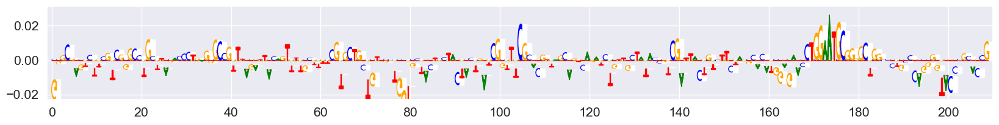

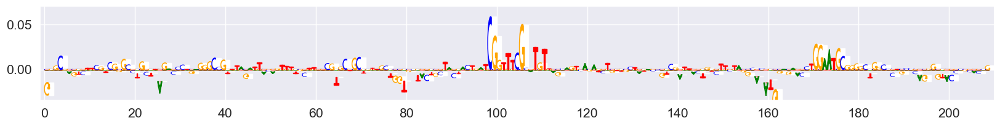

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

C A
ENSG00000152684.10
            motif_id    gene_name
5_52800100  MA0884.2         DUXA
5_52800100  MA1133.2    JUN::JUNB
5_52800100  MA1536.2        NR2C2
5_52800100  MA1127.1    FOSB::JUN
5_52800100  MA0492.2         JUND
5_52800100  MA1636.2        CEBPG
5_52800100  MA1145.2  FOSL2::JUND
5_52800100  MA1139.2  FOSL2::JUNB
5_52800100  MA1139.2  FOSL2::JUNB
5_52800100  MA1136.1   FOSB::JUNB
5_52800100  MA1136.1   FOSB::JUNB
5_52800100  MA1131.2   FOSL2::JUN
5_52800100  MA1131.2   FOSL2::JUN
5_52800100  MA1129.1   FOSL1::JUN
5_52800100  MA1129.1   FOSL1::JUN
5_52800100  MA1126.2     FOS::JUN
5_52800100  MA0838.1        CEBPG
5_52800100  MA1471.2        BARX2
5_52800100  MA1475.2      CREB3L4
5_52800100  MA0488.2          JUN
5_52800100  MA0605.3         ATF3
5_52800100  MA0605.3         ATF3
5_52800100  MA0639.2          DBP
5_52800100  MA0639.2          DBP
5_52800100  MA0656.2         JDP2
5_52800100  MA0656.2         JDP2
5_52800100  MA0833.3         ATF4
5_52800100  MA0834.2     

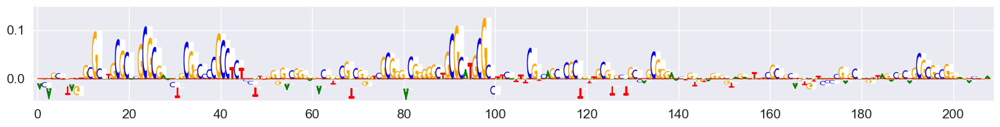

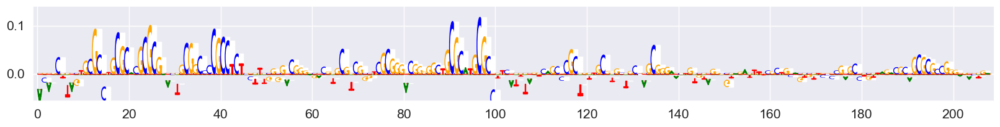

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

G GC
ENSG00000145882.10
             motif_id gene_name
5_149345662  MA1987.2    ZNF701
5_149345662  MA2328.1     ZBED4
5_149345662  MA0807.1      TBX5
5_149345662  MA1982.2    ZNF574


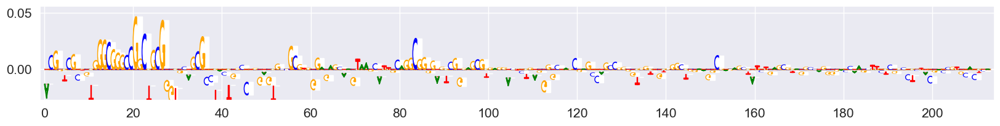

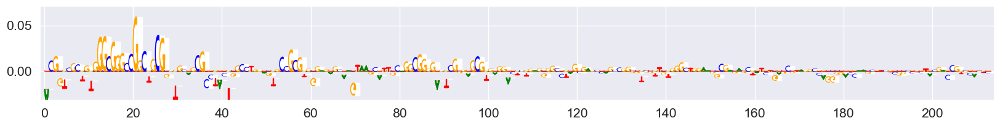

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

C T
ENSG00000113721.13
             motif_id   gene_name
5_150144550  MA1563.2       SOX18
5_150144550  MA1936.2  ERF::FOXO1
5_150144550  MA0258.2        ESR2
5_150144550  MA1545.2       OVOL2
5_150144550  MA1496.2       HOXA4
5_150144550  MA0594.3       HOXA9
5_150144550  MA1106.2       HIF1A
5_150144550  MA0595.1      SREBF1
5_150144550  MA0596.1      SREBF2
5_150144550  MA0671.2        NFIX


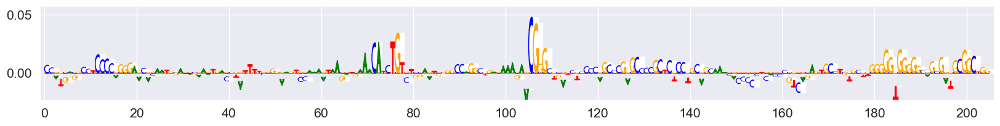

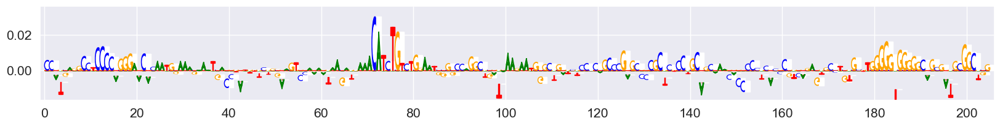

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

G C
ENSG00000196670.13
             motif_id gene_name
5_180861455  MA1587.1    ZNF135
5_180861455  MA1972.1     ZFP14
5_180861455  MA0747.2       SP8
5_180861455  MA1512.2     KLF11
5_180861455  MA1564.2       SP9
...               ...       ...
5_180861455  MA0738.2      HIC2
5_180861455  MA1656.2    ZNF449
5_180861455  MA0471.3      E2F6
5_180861455  MA1578.2     VEZF1
5_180861455  MA1122.2     TFDP1

[73 rows x 2 columns]


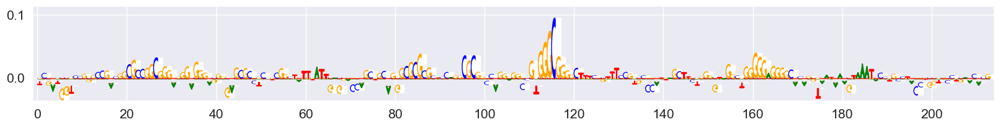

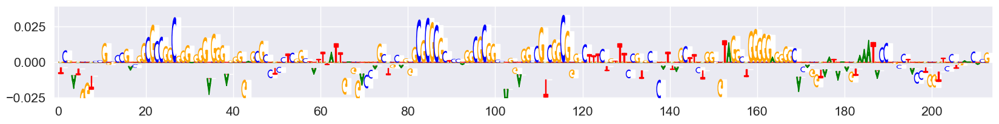

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

A AGTTGTCACGGCGCTGGTGGGAG
ENSG00000244041.7
           motif_id    gene_name
6_2989885  MA0749.2        ZBED1
6_2989885  MA1126.2     FOS::JUN
6_2989885  MA1133.2    JUN::JUNB
6_2989885  MA0492.2         JUND
6_2989885  MA1145.2  FOSL2::JUND
6_2989885  MA1136.1   FOSB::JUNB
6_2989885  MA1136.1   FOSB::JUNB
6_2989885  MA1131.2   FOSL2::JUN
6_2989885  MA1129.1   FOSL1::JUN
6_2989885  MA1129.1   FOSL1::JUN
6_2989885  MA1126.2     FOS::JUN
6_2989885  MA0834.2         ATF7
6_2989885  MA0656.2         JDP2
6_2989885  MA0488.2          JUN
6_2989885  MA0488.2          JUN
6_2989885  MA1651.2        ZFP42
6_2989885  MA1475.2      CREB3L4
6_2989885  MA1143.2  FOSL1::JUND
6_2989885  MA0775.2        MEIS3
6_2989885  MA0623.2      NEUROG1
6_2989885  MA1468.1        ATOH7
6_2989885  MA1568.2        TCF21
6_2989885  MA1570.1        TFAP4
6_2989885  MA1570.1        TFAP4
6_2989885  MA1536.2        NR2C2
6_2989885  MA1535.2        NR2C1
6_2989885  MA1105.3        GRHL2
6_2989885  MA1105.3        GRHL2

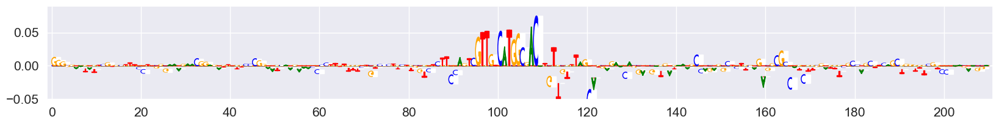

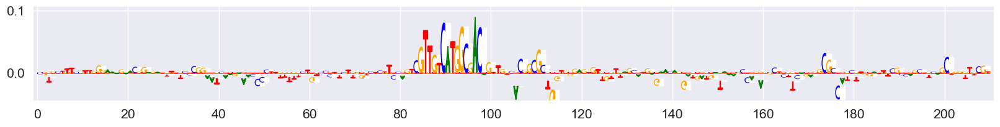

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

C T
ENSG00000158373.8
            motif_id gene_name
6_26171991  MA0162.5      EGR1
6_26171991  MA1721.2     ZNF93
6_26171991  MA1961.2     PATZ1
6_26171991  MA0810.2    TFAP2A
6_26171991  MA0733.2      EGR4
6_26171991  MA0732.2      EGR3
6_26171991  MA0472.2      EGR2
6_26171991  MA1554.2      RFX7
6_26171991  MA0079.5       SP1
6_26171991  MA0812.2    TFAP2B
6_26171991  MA1569.2    TFAP2E
6_26171991  MA1569.2    TFAP2E
6_26171991  MA0748.3       YY2
6_26171991  MA0599.1      KLF5
6_26171991  MA1713.2    ZNF610
6_26171991  MA1961.2     PATZ1
6_26171991  MA1653.2    ZNF148
6_26171991  MA1512.2     KLF11
6_26171991  MA0493.3      KLF1
6_26171991  MA1564.2       SP9
6_26171991  MA1517.2      KLF6
6_26171991  MA1511.2     KLF10
6_26171991  MA0742.2     KLF12
6_26171991  MA0740.2     KLF14
6_26171991  MA0685.2       SP4
6_26171991  MA0516.3       SP2
6_26171991  MA0079.5       SP1
6_26171991  MA1959.2      KLF7
6_26171991  MA1728.2    ZNF549
6_26171991  MA1522.2       MAZ
6_26171991  MA151

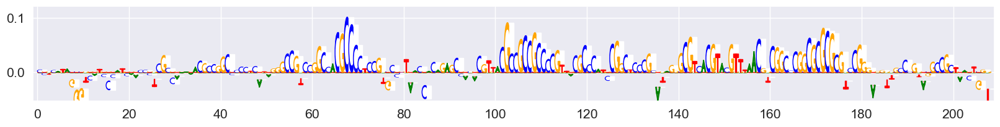

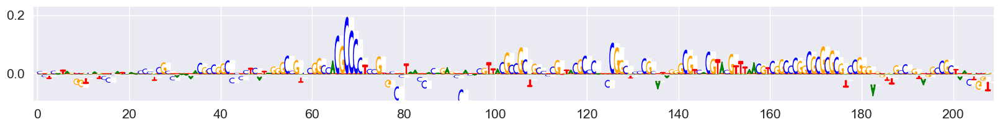

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

C T
ENSG00000137310.11
            motif_id gene_name
6_31158455  MA1985.1    ZNF669
6_31158455  MA0774.1     MEIS2
6_31158455  MA0775.2     MEIS3
6_31158455  MA2324.1    BCL11A
6_31158455  MA0671.2      NFIX
6_31158455  MA0502.3      NFYB
6_31158455  MA0077.2      SOX9
6_31158455  MA1530.2    NKX6-3
6_31158455  MA0912.2     HOXD3
6_31158455  MA0158.2     HOXA5
6_31158455  MA0060.4      NFYA
6_31158455  MA2119.1     HOXA3
6_31158455  MA2093.1     HOXB1
6_31158455  MA1644.2      NFYC
6_31158455  MA1152.2     SOX15
6_31158455  MA1120.2     SOX13
6_31158455  MA0893.3      GSX2
6_31158455  MA0722.2      VAX1
6_31158455  MA0701.3      LHX9
6_31158455  MA1500.2     HOXB6
6_31158455  MA0143.5      SOX2
6_31158455  MA1505.2     HOXC8
6_31158455  MA1505.2     HOXC8
6_31158455  MA0642.3       EN2
6_31158455  MA0661.2     MEOX1
6_31158455  MA0706.2     MEOX2
6_31158455  MA0893.3      GSX2
6_31158455  MA0910.3     HOXD8
6_31158455  MA1496.2     HOXA4
6_31158455  MA1497.2     HOXA6
6_31158455  MA15

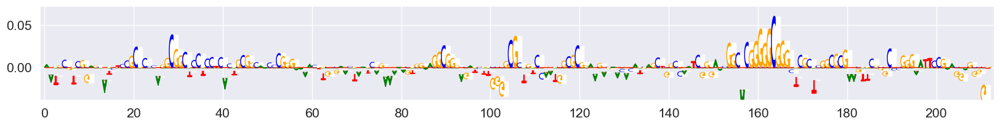

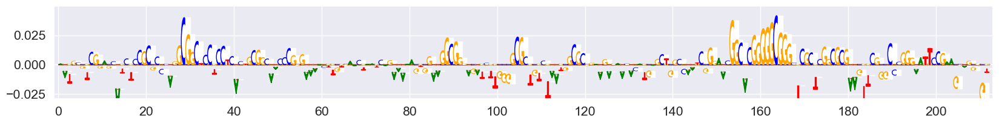

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

C T
ENSG00000231500.6
            motif_id gene_name
6_33272092  MA0751.2      ZIC4
6_33272092  MA2099.1    ZNF770
6_33272092  MA1986.2    ZNF692
6_33272092  MA0719.2    RHOXF1
6_33272092  MA1602.2   ZSCAN29
6_33272092  MA0599.1      KLF5
6_33272092  MA1517.2      KLF6
6_33272092  MA1515.2      KLF2
6_33272092  MA0130.1   ZNF354C
6_33272092  MA0751.2      ZIC4
6_33272092  MA2099.1    ZNF770
6_33272092  MA1986.2    ZNF692
6_33272092  MA0719.2    RHOXF1
6_33272092  MA1602.2   ZSCAN29
6_33272092  MA0599.1      KLF5
6_33272092  MA1517.2      KLF6
6_33272092  MA1515.2      KLF2
6_33272092  MA0130.1   ZNF354C


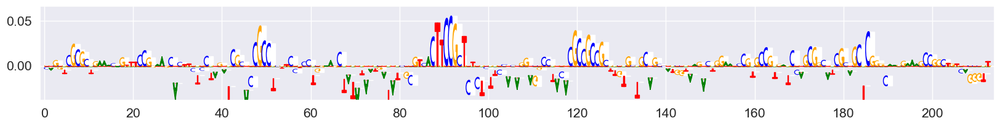

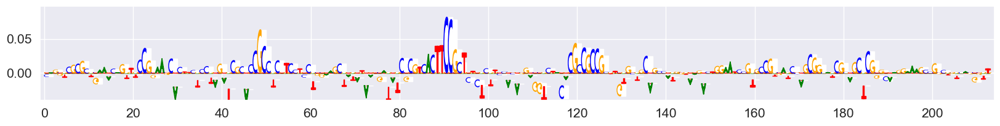

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

G A
ENSG00000146232.15
            motif_id   gene_name
6_44265666  MA1972.1       ZFP14
6_44265666  MA0641.1        ELF4
6_44265666  MA0686.2       SPDEF
6_44265666  MA1483.3        ELF2
6_44265666  MA1484.2        ETS2
6_44265666  MA0765.4        ETV5
6_44265666  MA0764.4        ETV4
6_44265666  MA0763.2        ETV3
6_44265666  MA0762.2        ETV2
6_44265666  MA0761.3        ETV1
6_44265666  MA0759.3        ELK3
6_44265666  MA0475.3        FLI1
6_44265666  MA0156.4         FEV
6_44265666  MA0098.4        ETS1
6_44265666  MA0028.3        ELK1
6_44265666  MA0760.2         ERF
6_44265666  MA1935.2  ERF::FOXI1
6_44265666  MA1935.2  ERF::FOXI1
6_44265666  MA0144.3       STAT3
6_44265666  MA1483.3        ELF2
6_44265666  MA0144.3       STAT3
6_44265666  MA0137.4       STAT1
6_44265666  MA1579.2      ZBTB26
6_44265666  MA1579.2      ZBTB26
6_44265666  MA0144.3       STAT3
6_44265666  MA1484.2        ETS2
6_44265666  MA0765.4        ETV5
6_44265666  MA0764.4        ETV4
6_44265666  MA0763.2

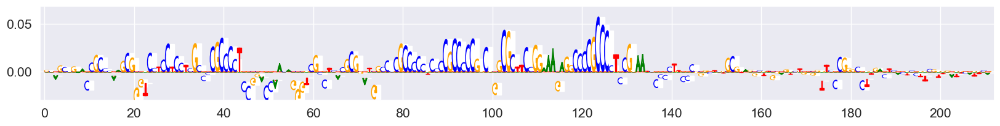

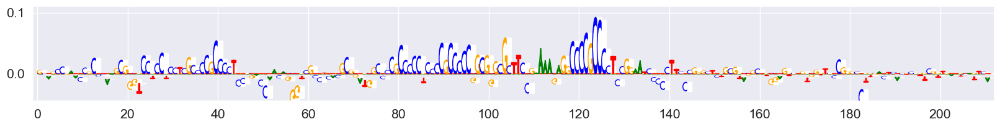

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

C CG
ENSG00000051620.10
             motif_id gene_name
6_138404180  MA1723.2     PRDM9
6_138404180  MA1721.2     ZNF93
6_138404180  MA1723.2     PRDM9
6_138404180  MA0810.2    TFAP2A
6_138404180  MA0472.2      EGR2
...               ...       ...
6_138404180  MA2003.2    NKX2-4
6_138404180  MA0673.2    NKX2-8
6_138404180  MA1558.2     SNAI1
6_138404180  MA1523.2   MSANTD3
6_138404180  MA0672.2    NKX2-3

[73 rows x 2 columns]


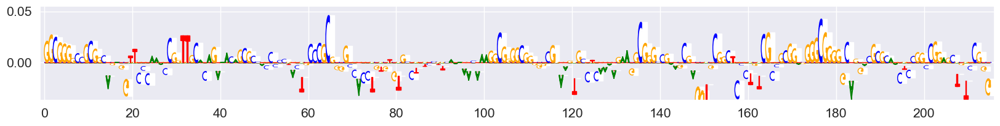

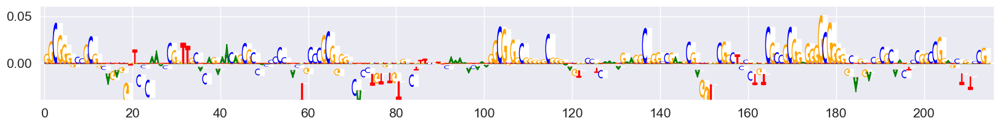

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

C CG
ENSG00000078399.17
            motif_id gene_name
7_27165540  MA1723.2     PRDM9
7_27165540  MA1972.1     ZFP14
7_27165540  MA1584.2      ZIC5
7_27165540  MA1554.2      RFX7
7_27165540  MA0806.1      TBX4
7_27165540  MA0810.2    TFAP2A
7_27165540  MA0696.1      ZIC1
7_27165540  MA0751.2      ZIC4
7_27165540  MA0524.3    TFAP2C
7_27165540  MA0810.2    TFAP2A
7_27165540  MA1569.2    TFAP2E
7_27165540  MA1569.2    TFAP2E
7_27165540  MA1100.3     ASCL1
7_27165540  MA1100.3     ASCL1
7_27165540  MA0830.3      TCF4
7_27165540  MA0103.4      ZEB1
7_27165540  MA0820.2     FIGLA
7_27165540  MA1569.2    TFAP2E
7_27165540  MA1569.2    TFAP2E
7_27165540  MA0524.3    TFAP2C
7_27165540  MA0810.2    TFAP2A
7_27165540  MA0810.2    TFAP2A
7_27165540  MA0811.2    TFAP2B
7_27165540  MA0524.3    TFAP2C
7_27165540  MA0811.2    TFAP2B
7_27165540  MA0810.2    TFAP2A
7_27165540  MA1569.2    TFAP2E
7_27165540  MA1569.2    TFAP2E
7_27165540  MA1569.2    TFAP2E
7_27165540  MA1569.2    TFAP2E
7_27165540  MA1

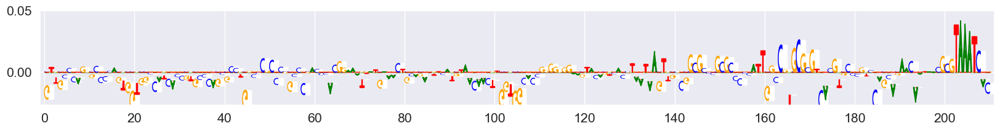

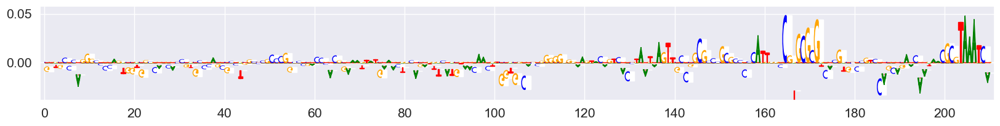

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

C G
ENSG00000106628.10
            motif_id gene_name
7_44123530  MA0808.1     TEAD3
7_44123530  MA0764.4      ETV4
7_44123530  MA1484.2      ETS2
7_44123530  MA0625.3    NFATC3
7_44123530  MA0471.3      E2F6
7_44123530  MA1122.2     TFDP1
7_44123530  MA0865.3      E2F8
7_44123530  MA0599.1      KLF5
7_44123530  MA1513.2     KLF15
7_44123530  MA0516.3       SP2
7_44123530  MA0740.2     KLF14
7_44123530  MA1578.2     VEZF1
7_44123530  MA0748.3       YY2
7_44123530  MA0775.2     MEIS3
7_44123530  MA1516.2      KLF3
7_44123530  MA1599.2    ZNF682
7_44123530  MA0502.3      NFYB
7_44123530  MA0670.2      NFIA
7_44123530  MA0671.2      NFIX
7_44123530  MA0498.3     MEIS1
7_44123530  MA0599.1      KLF5
7_44123530  MA0741.1     KLF16


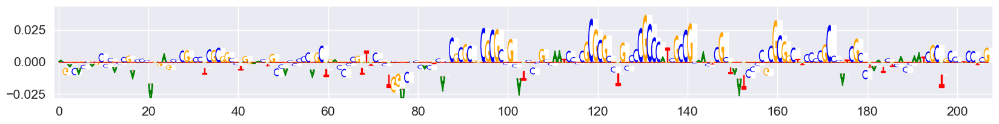

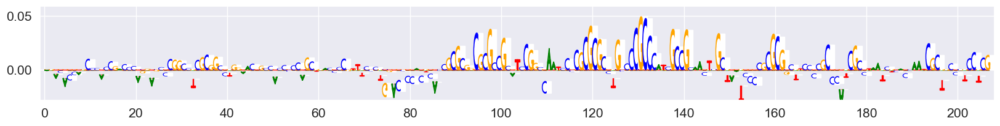

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

C A
ENSG00000001630.15
            motif_id gene_name
7_92134814  MA0511.2     RUNX2
7_92134814  MA0527.2    ZBTB33
7_92134814  MA1099.3      HES1
7_92134814  MA0632.3     TCFL5
7_92134814  MA0632.3     TCFL5
7_92134814  MA1099.3      HES1
7_92134814  MA0632.3     TCFL5
7_92134814  MA0632.3     TCFL5
7_92134814  MA1099.3      HES1
7_92134814  MA1713.2    ZNF610


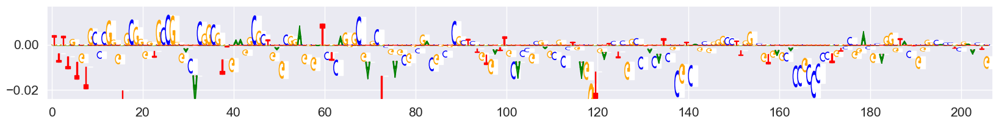

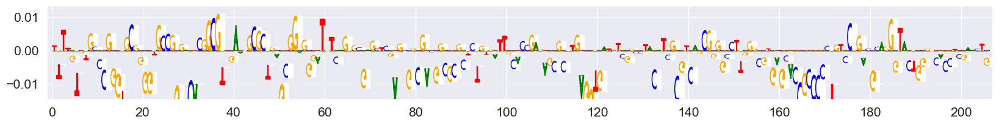

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

C T
ENSG00000197157.10
             motif_id gene_name
7_127651950  MA1587.1    ZNF135
7_127651950  MA1653.2    ZNF148
7_127651950  MA2329.1    ZBTB11
7_127651950  MA0685.2       SP4
7_127651950  MA1717.2    ZNF784
7_127651950  MA0625.3    NFATC3
7_127651950  MA0471.3      E2F6
7_127651950  MA1579.2    ZBTB26
7_127651950  MA0865.3      E2F8
7_127651950  MA1964.2     SMAD2
7_127651950  MA0748.3       YY2
7_127651950  MA0160.3     NR4A2
7_127651950  MA1536.2     NR2C2
7_127651950  MA1535.2     NR2C1
7_127651950  MA0498.3     MEIS1
7_127651950  MA1500.2     HOXB6
7_127651950  MA1563.2     SOX18
7_127651950  MA0158.2     HOXA5
7_127651950  MA0158.2     HOXA5
7_127651950  MA2119.1     HOXA3
7_127651950  MA2093.1     HOXB1
7_127651950  MA1549.2    POU6F1
7_127651950  MA1502.2     HOXB8
7_127651950  MA1501.2     HOXB7
7_127651950  MA1497.2     HOXA6
7_127651950  MA1496.2     HOXA4
7_127651950  MA0910.3     HOXD8
7_127651950  MA0893.3      GSX2
7_127651950  MA0710.2      NOTO
7_127651950  MA07

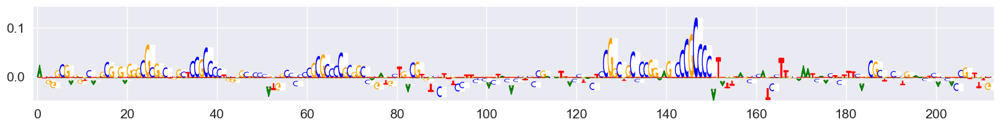

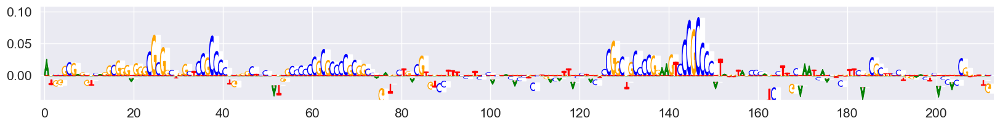

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

A G
ENSG00000188707.5
             motif_id gene_name
7_150323206  MA2121.1    ZNF213
7_150323206  MA0738.2      HIC2
7_150323206  MA1730.2    ZNF708
7_150323206  MA1584.2      ZIC5
7_150323206  MA0511.2     RUNX2
7_150323206  MA0751.2      ZIC4
7_150323206  MA0696.1      ZIC1
7_150323206  MA0684.3     RUNX3
7_150323206  MA1717.2    ZNF784


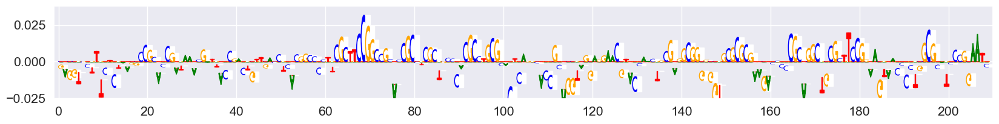

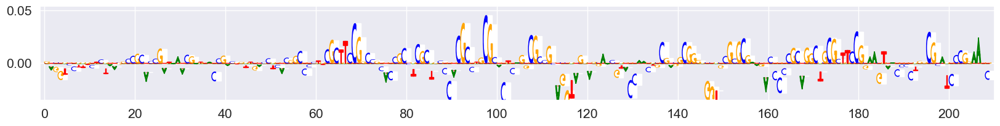

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

C G
ENSG00000196584.2
             motif_id gene_name
7_152676167  MA2096.1    ZNF524
7_152676167  MA0801.1       MGA
7_152676167  MA0719.2    RHOXF1
7_152676167  MA1516.2      KLF3
7_152676167  MA0511.2     RUNX2
7_152676167  MA1107.3      KLF9
7_152676167  MA0746.3       SP3
7_152676167  MA0741.1     KLF16
7_152676167  MA0599.1      KLF5
7_152676167  MA0865.3      E2F8
7_152676167  MA0747.2       SP8
7_152676167  MA1564.2       SP9
7_152676167  MA1512.2     KLF11
7_152676167  MA0753.3    ZNF740
7_152676167  MA1517.2      KLF6
7_152676167  MA1511.2     KLF10
7_152676167  MA0742.2     KLF12
7_152676167  MA0740.2     KLF14
7_152676167  MA0685.2       SP4
7_152676167  MA0079.5       SP1
7_152676167  MA1959.2      KLF7
7_152676167  MA1515.2      KLF2
7_152676167  MA1513.2     KLF15
7_152676167  MA0767.2      GCM2
7_152676167  MA0493.3      KLF1
7_152676167  MA0039.5      KLF4
7_152676167  MA0516.3       SP2
7_152676167  MA1578.2     VEZF1
7_152676167  MA0753.3    ZNF740
7_152676167  MA198

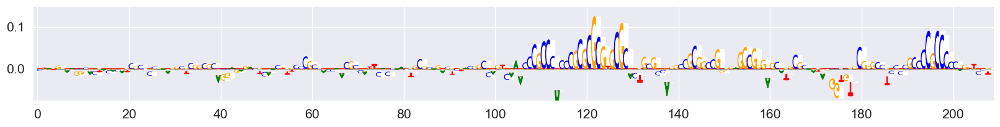

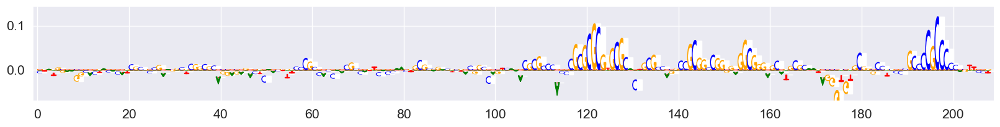

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

C A
ENSG00000154328.15
            motif_id gene_name
8_11769705  MA2328.1     ZBED4
8_11769705  MA0719.2    RHOXF1
8_11769705  MA0516.3       SP2
8_11769705  MA1710.2    ZNF257
8_11769705  MA0137.4     STAT1
8_11769705  MA0865.3      E2F8
8_11769705  MA0144.3     STAT3
8_11769705  MA0471.3      E2F6
8_11769705  MA1122.2     TFDP1
8_11769705  MA1483.3      ELF2
8_11769705  MA0098.4      ETS1
8_11769705  MA0475.3      FLI1
8_11769705  MA0764.4      ETV4
8_11769705  MA1708.2      ETV7
8_11769705  MA0105.4     NFKB1
8_11769705  MA0105.4     NFKB1
8_11769705  MA0645.2      ETV6
8_11769705  MA0076.3      ELK4
8_11769705  MA1116.2      RBPJ
8_11769705  MA0625.3    NFATC3


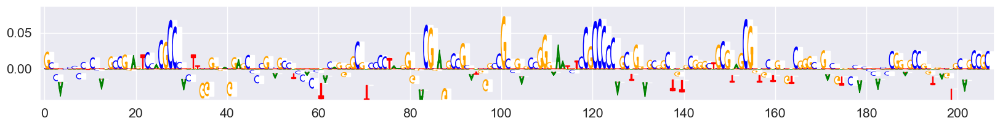

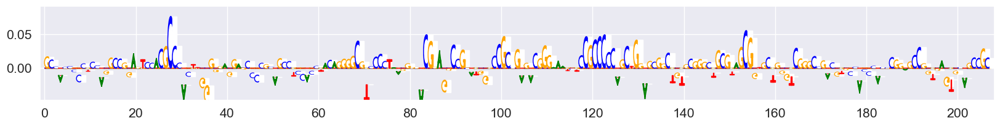

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

A G
ENSG00000215114.8
            motif_id    gene_name
8_58411252  MA1950.2  FLI1::FOXI1
8_58411252  MA1721.2        ZNF93
8_58411252  MA1935.2   ERF::FOXI1
8_58411252  MA1715.1       ZNF707
8_58411252  MA0641.1         ELF4
8_58411252  MA1952.2  FOXJ2::ELF1
8_58411252  MA1942.2  ETV2::FOXI1
8_58411252  MA0686.2        SPDEF
8_58411252  MA1483.3         ELF2
8_58411252  MA1945.2  ETV5::FIGLA
8_58411252  MA0764.4         ETV4
8_58411252  MA0765.4         ETV5
8_58411252  MA1484.2         ETS2
8_58411252  MA2332.1       ZNF175
8_58411252  MA0062.4        GABPA
8_58411252  MA0760.2          ERF
8_58411252  MA0762.2         ETV2
8_58411252  MA0761.3         ETV1
8_58411252  MA0759.3         ELK3
8_58411252  MA0475.3         FLI1
8_58411252  MA0156.4          FEV
8_58411252  MA0098.4         ETS1
8_58411252  MA0028.3         ELK1
8_58411252  MA0763.2         ETV3
8_58411252  MA2329.1       ZBTB11
8_58411252  MA1966.2  TFAP4::ETV1
8_58411252  MA1941.2  ETV2::FIGLA
8_58411252  MA1934.2   ERF

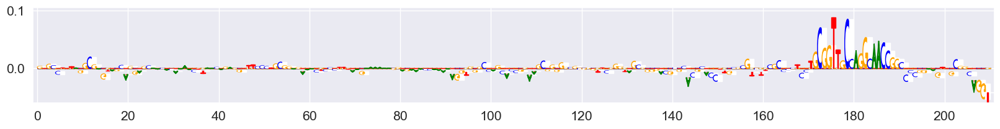

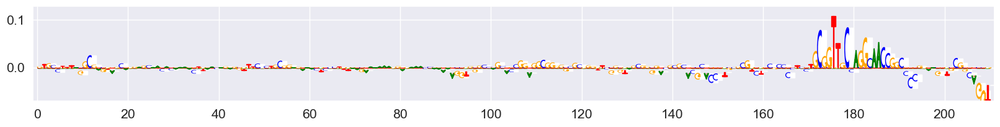

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

A G
ENSG00000245149.3
             motif_id gene_name
8_124474526  MA0468.1      DUX4
8_124474526  MA0686.2     SPDEF
8_124474526  MA1509.1      IRF6
8_124474526  MA1971.2     ZBED2
8_124474526  MA0035.5     GATA1
8_124474526  MA0048.3     NHLH1
8_124474526  MA1100.3     ASCL1
8_124474526  MA0719.2    RHOXF1
8_124474526  MA1638.2     HAND2


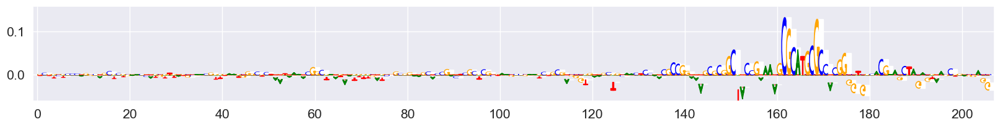

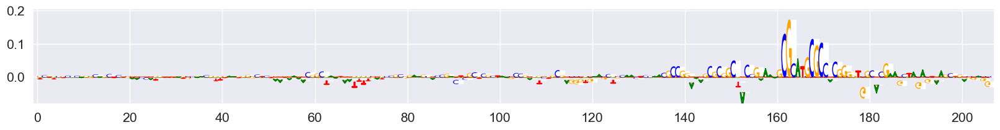

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

C G
ENSG00000170631.14
             motif_id gene_name
8_144950882  MA1961.2     PATZ1
8_144950882  MA0746.3       SP3
8_144950882  MA0741.1     KLF16
8_144950882  MA1710.2    ZNF257
8_144950882  MA0599.1      KLF5
8_144950882  MA0740.2     KLF14
8_144950882  MA1511.2     KLF10
8_144950882  MA1517.2      KLF6
8_144950882  MA1512.2     KLF11
8_144950882  MA1564.2       SP9
8_144950882  MA1630.3    ZNF281
8_144950882  MA0747.2       SP8
8_144950882  MA0742.2     KLF12
8_144950882  MA0516.3       SP2
8_144950882  MA0685.2       SP4
8_144950882  MA0079.5       SP1
8_144950882  MA2328.1     ZBED4
8_144950882  MA1535.2     NR2C1
8_144950882  MA1536.2     NR2C2
8_144950882  MA1578.2     VEZF1
8_144950882  MA1151.2      RORC
8_144950882  MA0068.2      PAX4
8_144950882  MA0068.2      PAX4


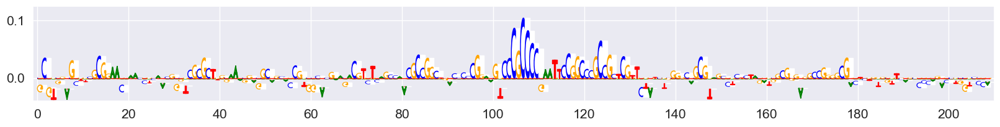

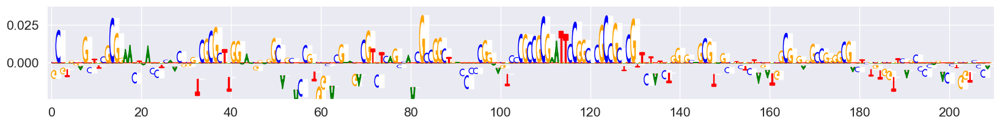

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

A C
ENSG00000155158.20
            motif_id gene_name
9_15306294  MA0041.3     FOXD3
9_15306294  MA0873.2    HOXD12
9_15306294  MA0070.2      PBX1
9_15306294  MA0485.3     HOXC9
9_15306294  MA0899.2    HOXA10
...              ...       ...
9_15306294  MA2117.1     FOXP4
9_15306294  MA0481.4     FOXP1
9_15306294  MA0042.2     FOXI1
9_15306294  MA0033.2     FOXL1
9_15306294  MA0130.1   ZNF354C

[90 rows x 2 columns]


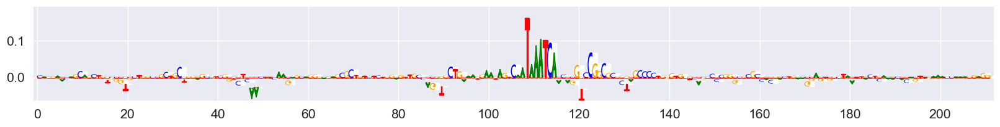

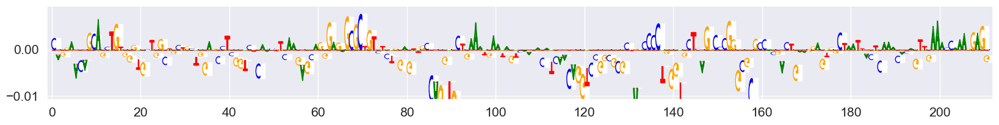

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

A T
ENSG00000137154.12
            motif_id    gene_name
9_19380241  MA1986.2       ZNF692
9_19380241  MA0671.2         NFIX
9_19380241  MA0670.2         NFIA
9_19380241  MA1536.2        NR2C2
9_19380241  MA0081.3         SPIB
9_19380241  MA0673.2       NKX2-8
9_19380241  MA0893.3         GSX2
9_19380241  MA0100.4          MYB
9_19380241  MA0687.2         SPIC
9_19380241  MA0641.1         ELF4
9_19380241  MA0062.4        GABPA
9_19380241  MA2329.1       ZBTB11
9_19380241  MA1708.2         ETV7
9_19380241  MA0750.3       ZBTB7A
9_19380241  MA0645.2         ETV6
9_19380241  MA0640.3         ELF3
9_19380241  MA0598.4          EHF
9_19380241  MA0473.4         ELF1
9_19380241  MA0076.3         ELK4
9_19380241  MA1954.2  FOXO1::ELK1
9_19380241  MA1952.2  FOXJ2::ELF1
9_19380241  MA1942.2  ETV2::FOXI1
9_19380241  MA1483.3         ELF2
9_19380241  MA0686.2        SPDEF
9_19380241  MA2332.1       ZNF175
9_19380241  MA1484.2         ETS2
9_19380241  MA0765.4         ETV5
9_19380241  MA0764.4     

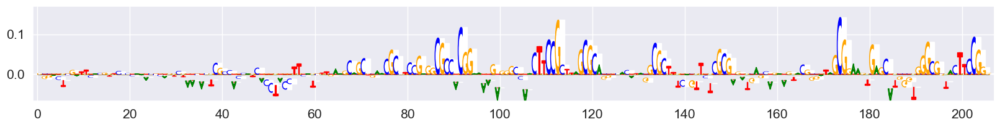

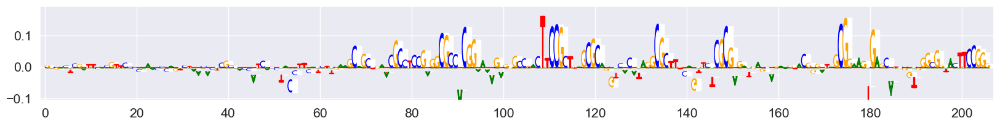

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_3538/2049889197.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will al

A C
ENSG00000119446.13
             motif_id gene_name
9_122264840  MA2094.1      PAX8
9_122264840  MA0810.2    TFAP2A
9_122264840  MA1547.2     PITX2
9_122264840  MA0648.2       GSC
9_122264840  MA0682.3     PITX1
9_122264840  MA0711.2      OTX1
9_122264840  MA0714.2     PITX3
9_122264840  MA0719.2    RHOXF1
9_122264840  MA0891.2      GSC2
9_122264840  MA0712.3      OTX2
9_122264840  MA2341.1     FEZF2
9_122264840  MA0131.3     HINFP
9_122264840  MA0812.2    TFAP2B
9_122264840  MA0812.2    TFAP2B
9_122264840  MA0814.3    TFAP2C
9_122264840  MA1569.2    TFAP2E
9_122264840  MA1569.2    TFAP2E


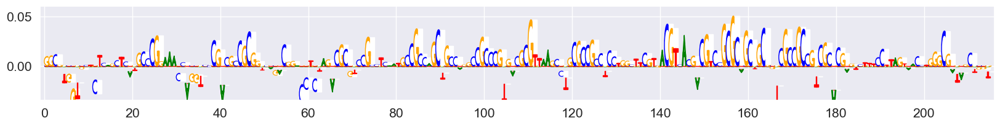

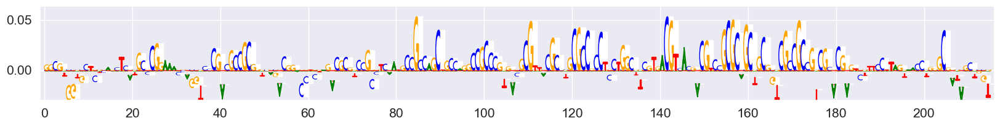

In [112]:
for i, id_seq in enumerate(idx_seq):
    #Get where variant/ motifs is 
    seq_motifs = overlap.loc[id_seq]
    min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]

    print(seq_motifs.ref[0], seq_motifs.alt[0])
    print(seq_motifs.phenotype_id[0])
    print(seq_motifs[["motif_id", "gene_name"]])
    #visualize_sequence_imp(proj_score_ref[[i],:4,:] , 1000, 3000)
    #visualize_sequence_imp(proj_score_alt[[i],:4,:] , 1000, 3000)

    visualize_sequence_imp(proj_score_ref[[i],:4,:] , 2048 + (min_motif-100), 2048 + (max_motif+100))
    visualize_sequence_imp(proj_score_alt[[i],:4,:] , 2048 + (min_motif-100), 2048 + (max_motif+100))


/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_9174/3356962886.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_9174/3356962886.py:9: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_9174/3356962886.py:10: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will a

C T
ENSG00000196743.8
             motif_id gene_name
5_151239432  MA0472.2      EGR2
5_151239432  MA1564.2       SP9
5_151239432  MA0732.2      EGR3
5_151239432  MA0733.2      EGR4
5_151239432  MA1930.2      CTCF
5_151239432  MA0139.2      CTCF
5_151239432  MA0162.5      EGR1
5_151239432  MA0753.3    ZNF740
5_151239432  MA1548.2    PLAGL2
5_151239432  MA1982.2    ZNF574
5_151239432  MA0695.2    ZBTB7C
5_151239432  MA1102.3     CTCFL
5_151239432  MA1536.2     NR2C2
5_151239432  MA1578.2     VEZF1
5_151239432  MA1961.2     PATZ1
5_151239432  MA1578.2     VEZF1
5_151239432  MA1522.2       MAZ
5_151239432  MA1653.2    ZNF148
5_151239432  MA0810.2    TFAP2A
5_151239432  MA0672.2    NKX2-3
5_151239432  MA0673.2    NKX2-8
5_151239432  MA2003.2    NKX2-4
5_151239432  MA0470.3      E2F4
5_151239432  MA0864.3      E2F2


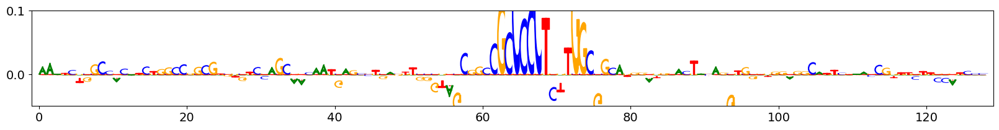

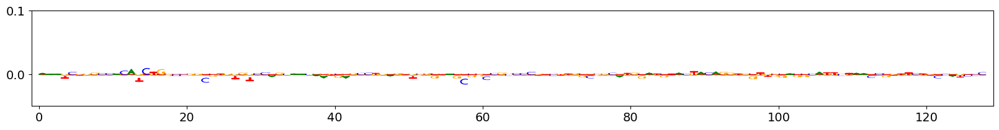

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_9174/3356962886.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_9174/3356962886.py:9: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_9174/3356962886.py:10: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will a

A T
ENSG00000070882.12
            motif_id gene_name
7_24883216  MA0836.3     CEBPD
7_24883216  MA0047.4     FOXA2
7_24883216  MA0593.2     FOXP2
7_24883216  MA2118.1     FOXS1
7_24883216  MA0047.4     FOXA2
...              ...       ...
7_24883216  MA0500.3      MYOG
7_24883216  MA0745.3     SNAI2
7_24883216  MA0830.3      TCF4
7_24883216  MA1100.3     ASCL1
7_24883216  MA1109.2   NEUROD1

[61 rows x 2 columns]


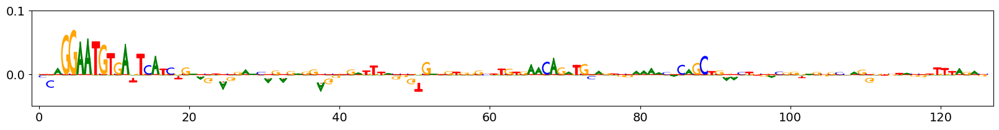

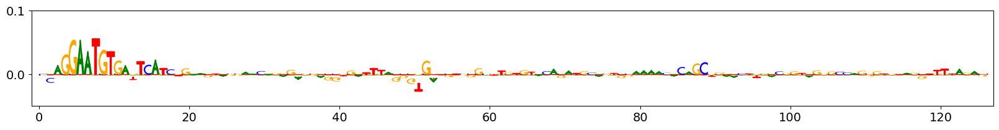

/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_9174/3356962886.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_9174/3356962886.py:9: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  print(seq_motifs.ref[0], seq_motifs.alt[0])
/var/folders/nx/fx90wvl146lcdkglfty5_wr4qnvn43/T/ipykernel_9174/3356962886.py:10: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will a

C A
ENSG00000225377.5
           motif_id gene_name
20_324557  MA0472.2      EGR2
20_324557  MA0732.2      EGR3
20_324557  MA0733.2      EGR4
20_324557  MA1552.2      RARB
20_324557  MA0657.2     KLF13
...             ...       ...
20_324557  MA1569.2    TFAP2E
20_324557  MA0524.3    TFAP2C
20_324557  MA0811.2    TFAP2B
20_324557  MA1569.2    TFAP2E
20_324557  MA1569.2    TFAP2E

[78 rows x 2 columns]


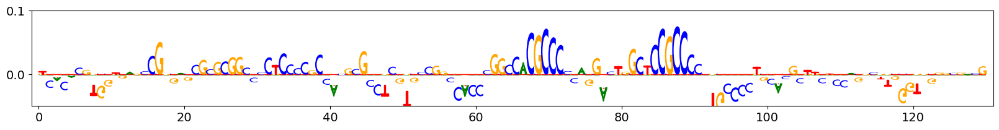

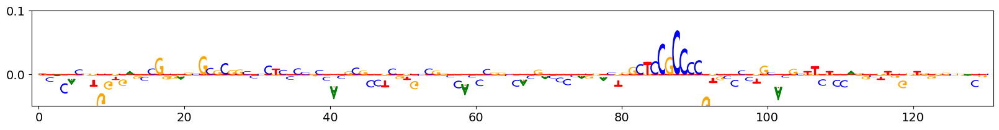

In [21]:
selection_idx = ["5_151239432","7_24883216","20_324557"]

for id_seq in selection_idx:
    #Get where variant/ motifs is 
    seq_motifs = overlap.loc[id_seq]
    i = np.where([x == id_seq for x in idx_seq])[0][0]
    min_motif, max_motif = seq_motifs.start_motif.min() - seq_motifs.middle[0], seq_motifs.start_motif.max() - seq_motifs.middle[0]

    print(seq_motifs.ref[0], seq_motifs.alt[0])
    print(seq_motifs.phenotype_id[0])
    print(seq_motifs[["motif_id", "gene_name"]])
    #visualize_sequence_imp(proj_score_ref[[i],:4,:] , 1000, 3000)
    #visualize_sequence_imp(proj_score_alt[[i],:4,:] , 1000, 3000)

    visualize_sequence_imp(proj_score_ref[[i],:4,:] , 2048 + (min_motif-60), 2048 + (max_motif+60))
    visualize_sequence_imp(proj_score_alt[[i],:4,:] , 2048 + (min_motif-60), 2048 + (max_motif+60))


In [101]:
active_enhancer = pd.read_csv("../data/active_enhancers_all_days.bed", header=None, sep='\t')
rep_enhancer = pd.read_csv("../data/repressed_enhancers_all_days.bed", header=None, sep='\t')
promoter = pd.read_csv("../data/active_promoters_all_days.bed", header=None, sep='\t')

active_enhancer

,0,1,2
0,1,909800,924400
1,1,934800,946800
2,1,996800,999200
3,1,1001400,1007600
4,1,1012600,1016600
...,...,...,...
45475,Y,12525600,12528000
45476,Y,12546200,12547400
45477,Y,13877600,13879400
45478,Y,15347200,15349800


In [105]:
active_enhancer[np.logical_and(active_enhancer[0]=="11", active_enhancer[1] > 17600000)]

,0,1,2
6072,11,17633400,17636000
6073,11,17649200,17654200
6074,11,17686200,17688400
6075,11,17697400,17701600
6076,11,17764000,17765400
...,...,...,...
7742,11,134120000,134123400
7743,11,134561000,134563600
7744,11,134730200,134732400
7745,11,134913800,134917800


## Overlap with actual TF binding